# Anciallry services data analysis 

- Author: Yassin Alnuaimee
-  Date: 24/09/2024

---
# Table of Contents
- [1. Library imports](#-Library-imports)
- [2. Data 2015](#Data-2015)
    - [2.1. Primary control auction 2015](##Primary-control-auction-2015)
    - [2.2. Secondary control auction 2015](##Secondary-control-auction-2015)
    - [2.3. Tertiary control auction 2015](##Tertiary-control-auction-2015)
- [3. Data 2016](#Data-2016)
    - [3.1. Primary control auction 2016](##Primary-control-auction-2016)
    - [3.2. Secondary control auction 2016](##Secondary-control-auction-2016)
    - [3.3. Tertiary control auction 2016](##Tertiary-control-auction-2016)
- [4. Data 2017](#Data-2017)
    - [4.1. Primary control auction 2017](##Primary-control-auction-2017)
    - [4.2. Secondary control auction 2017](##Secondary-control-auction-2017)
    - [4.3. Tertiary control auction 2017](##Tertiary-control-auction-2017)
- [5. Data 2018](#Data-2018)
    - [5.1. Primary control auction 2018](##Primary-control-auction-2018)
    - [5.2. Secondary control auction 2018](##Secondary-control-auction-2018)
    - [5.3. Tertiary control auction  auction 2018](##Tertiary-control-auction-2018)
- [6. Data 2019](#Data-2019)
    - [6.1. Primary control auction 2019](##Primary-control-auction-2019)
    - [6.2. Secondary control auction 2019](##Secondary-control-auction-2019)
    - [6.3. Tertiary control auction 2019](##Tertiary-control-auction-2019)
- [7. Data 2020](#Data-2020)
    - [7.1. Primary control auction 2020](##Primary-control-auction-2020)
    - [7.2. Secondary control auction 2020](##Secondary-control-auction-2020)
    - [7.3. Tertiary control auction 2020](##Tertiary-control-auction-2020)
- [8. Data 2021](#Data-2021)
    - [8.1. Primary control auction 2021](##Primary-control-auction-2021)
    - [8.2. Secondary control auction 2021](##Secondary-control-auction-2021)
    - [8.3. Tertiary control auction 2021](##Tertiary-control-auction-2021)
- [9. Data 2022](#Data-2022)
    - [9.1. Primary control auction 2022](##Primary-control-auction-2022)
    - [9.2. Secondary control auction 2022](##Secondary-control-auction-2022)
    - [9.3. Tertiary control auction control auction 2022](##Tertiary-control-auction-2022)
- [10. Data 2023](#Data-2023)
    - [10.1. Primary control auction 2023](##Primary-control-auction-2023)
    - [10.2. Secondary control auction 2023](##Secondary-control-auction-2023)
    - [10.3. Tertiary control auction 2023](##Tertiary-control-auction-2023)
- [11. Data 2024](#Data-2024)
    - [11.1. Primary control auction 2024](##Primary-control-auction-2024)
    - [11.2. Secondary control auction 2024](##Secondary-control-auction-2024)
    - [11.3. Tertiary control auction 2024](##Tertiary-control-auction-2024)
- [12. Grouped analysis](#Grouped-analysis)
---

# Library imports


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#set data path
DATA='./data/'

---

# Data 2015

In [16]:
res15=pd.read_csv(DATA+'2015_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5'])

print(res15.Description.unique())
res15

['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5
0,PRL_15_KW01,Primary control Auction,20,MW,20,MW,6395.00,EUR/MW,127900.00,EUR,38.07,EUR/MWh*
1,PRL_15_KW01,Primary control Auction,20,MW,20,MW,4896.00,EUR/MW,97920.00,EUR,29.14,EUR/MWh*
2,PRL_15_KW01,Primary control Auction,6,MW,6,MW,7682.64,EUR/MW,46095.84,EUR,45.73,EUR/MWh*
3,PRL_15_KW02,Primary control Auction,24,MW,24,MW,3535.00,EUR/MW,84840.00,EUR,21.04,EUR/MWh*
4,PRL_15_KW02,Primary control Auction,23,MW,1,MW,4348.00,EUR/MW,4348.00,EUR,25.88,EUR/MWh*
...,...,...,...,...,...,...,...,...,...,...,...,...
26552,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,15,MW,15,MW,4.00,CHF/MW,60.00,CHF,1.00,CHF/MWh*
26553,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,5,MW,5,MW,3.00,CHF/MW,15.00,CHF,0.75,CHF/MWh*
26554,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,15,MW,15,MW,2.70,CHF/MW,40.50,CHF,0.68,CHF/MWh*
26555,TRL-_15_06_04,Tertiary Power DOWN 00:00 bis 04:00,5,MW,5,MW,3.10,CHF/MW,15.50,CHF,0.78,CHF/MWh*


## Primary control auction 2015

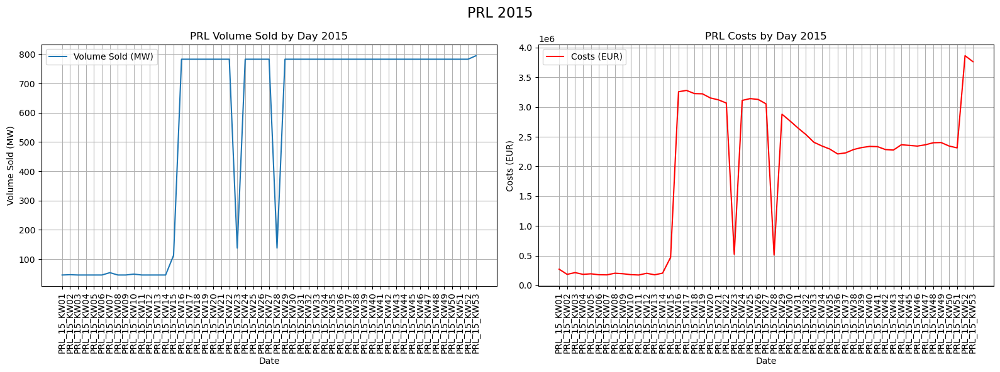

In [17]:
res15_p=res15[res15['Description'].str.contains('Primary control')].copy()

res15_p['Week'] = res15_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p15 = res15_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p15.index, grouped_p15['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2015')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p15.index, grouped_p15['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2015')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control  2015

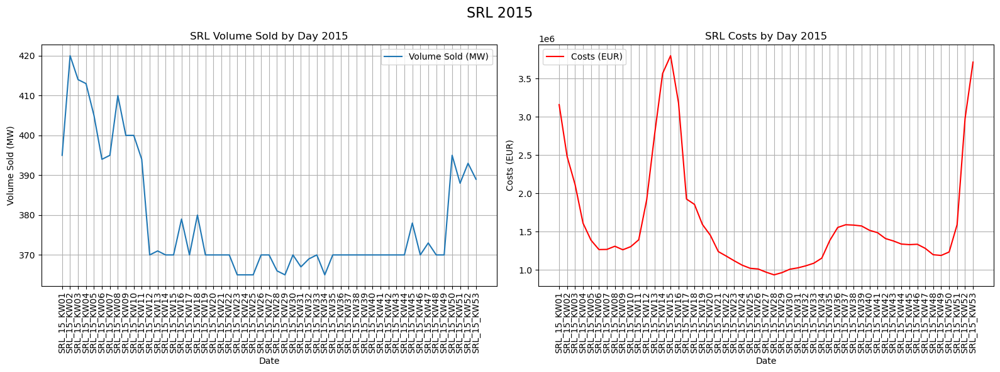

In [18]:
res15_s=res15[res15['Description'].str.contains('Secondary control')].copy()

res15_s['Week'] = res15_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_s15 = res15_s.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_s15.index, grouped_s15['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('SRL Volume Sold by Day 2015')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_s15.index, grouped_s15['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('SRL Costs by Day 2015')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('SRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction  2015

In [19]:
# Create DataFrame for Tertiary control
res15_CH_t = res15[res15['Description'].str.contains('Tertiary Power')].copy()

TPDW15=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW15=res15_CH_t[res15_CH_t.Description=='Tertiary Power UP'].copy()
TPD15_00_04=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD15_04_08=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD15_08_12=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD15_12_16=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD15_16_20=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD15_20_24=res15_CH_t[res15_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPDW15['Week']=TPDW15['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW15['Week']=TPUW15['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW15=TPDW15.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW15=TPUW15.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD15_00_04['date'] = pd.to_datetime(TPD15_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_04_08['date'] = pd.to_datetime(TPD15_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_08_12['date'] = pd.to_datetime(TPD15_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_12_16['date'] = pd.to_datetime(TPD15_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_16_20['date'] = pd.to_datetime(TPD15_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD15_20_24['date'] = pd.to_datetime(TPD15_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')


grouped_TPD15_00_04=TPD15_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_04_08=TPD15_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_08_12=TPD15_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_12_16=TPD15_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_16_20=TPD15_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD15_20_24=TPD15_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD15 = [grouped_TPD15_00_04, grouped_TPD15_04_08, grouped_TPD15_08_12, grouped_TPD15_12_16, grouped_TPD15_16_20, grouped_TPD15_20_24]

grouped_TPW15=[grouped_TPDW15, grouped_TPUW15]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

min_volume=0, max_volume=308
min_cost=0.0, max_cost=27699.0


KeyboardInterrupt: 

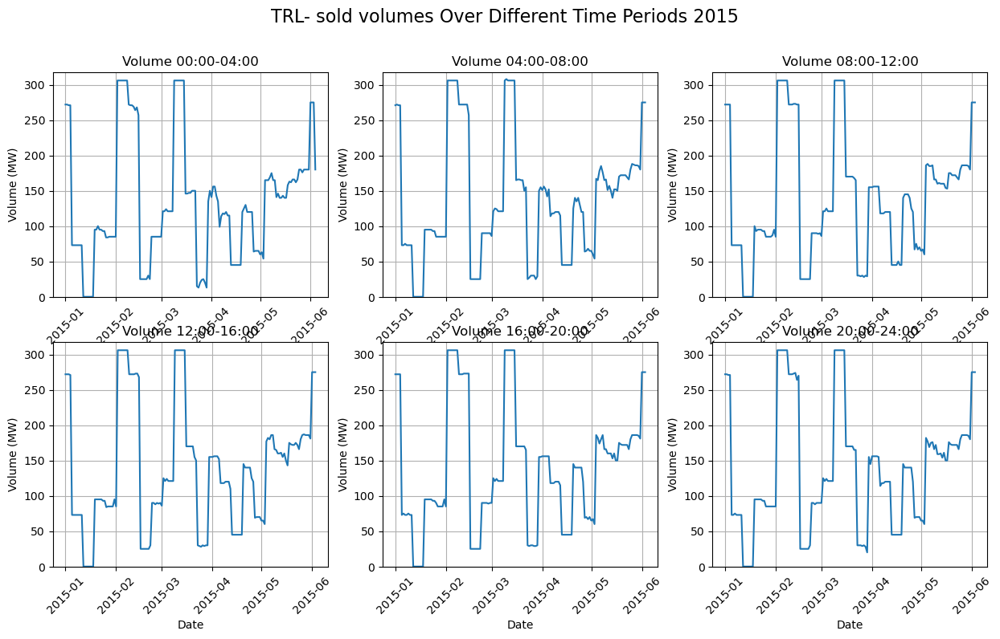

In [20]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD15])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD15])  # Get the maximum cost across all time periods
min_cost=min([data['Coûts'].min() for data in grouped_TPD15])
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD15])

print(f'min_volume={min_volume}, max_volume={max_volume}')
print(f'min_cost={min_cost}, max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD15):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2015', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD15):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2015', fontsize=16)
plt.tight_layout()
plt.show()


min volume: 0, max volume: 401
min cost: 0.0, max cost: 544562.0


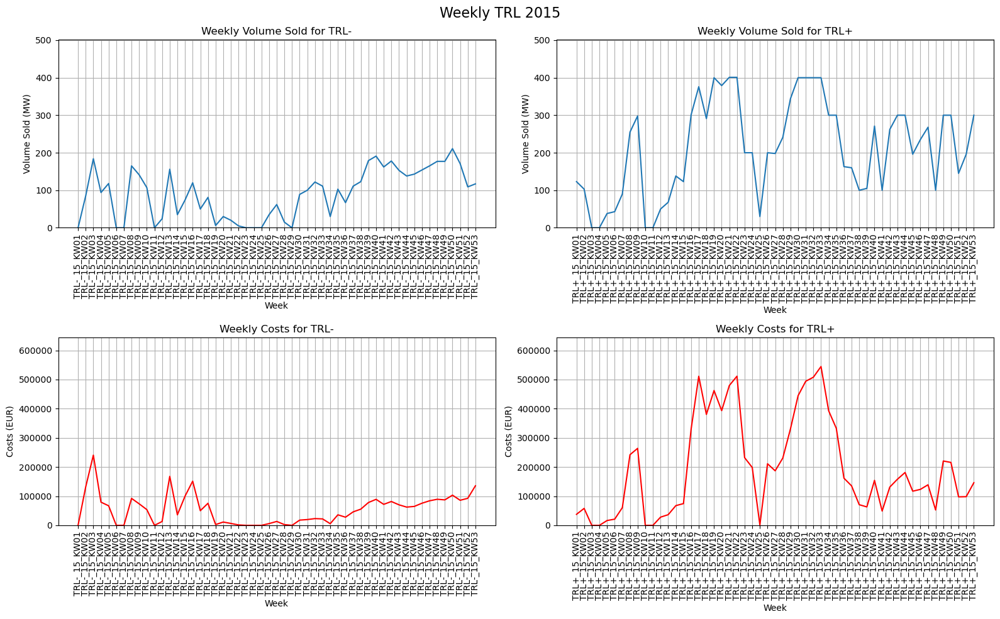

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW15])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW15])  # Get the maximum cost across all time periods
min_cost=min([data['Coûts'].min() for data in grouped_TPW15])
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW15])

print(f'min volume: {min_volume}, max volume: {max_volume}')
print(f'min cost: {min_cost}, max cost: {max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW15.index, grouped_TPDW15['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW15.index, grouped_TPUW15['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW15.index, grouped_TPDW15['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW15.index, grouped_TPUW15['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2015', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2016

In [ ]:
res16=pd.read_csv(DATA+'2016_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5', ])

print(res16.Description.unique())
res16


['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5
0,PRL_15_KW53,Primary control Auction,1,MW,1,MW,5001.0,EUR/MW,5001.0,EUR,29.77,EUR/MWh*
1,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4280.0,EUR/MW,21400.0,EUR,25.48,EUR/MWh*
2,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4305.0,EUR/MW,21525.0,EUR,25.62,EUR/MWh*
3,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4330.0,EUR/MW,21650.0,EUR,25.77,EUR/MWh*
4,PRL_15_KW53,Primary control Auction,5,MW,5,MW,4355.0,EUR/MW,21775.0,EUR,25.92,EUR/MWh*
...,...,...,...,...,...,...,...,...,...,...,...,...
106236,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,15,MW,0,MW,1.8,CHF/MW,0.0,CHF,0.45,CHF/MWh*
106237,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,2.3,CHF/MW,0.0,CHF,0.58,CHF/MWh*
106238,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,2.7,CHF/MW,0.0,CHF,0.68,CHF/MWh*
106239,TRL+_17_01_02,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,9.0,CHF/MW,0.0,CHF,2.25,CHF/MWh*


## Primary control auction 2016

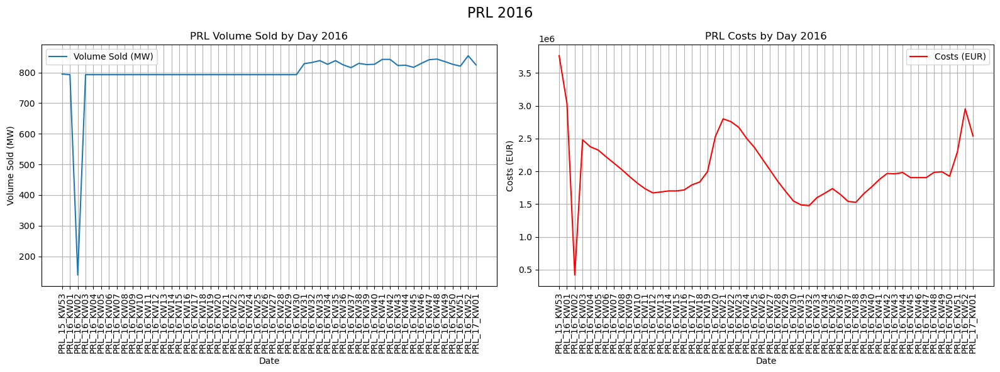

In [ ]:
res16_p=res16[res16['Description'].str.contains('Primary control')].copy()

res16_p['Week'] = res16_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p16 = res16_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p16.index, grouped_p16['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2016')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p16.index, grouped_p16['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2016')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2016

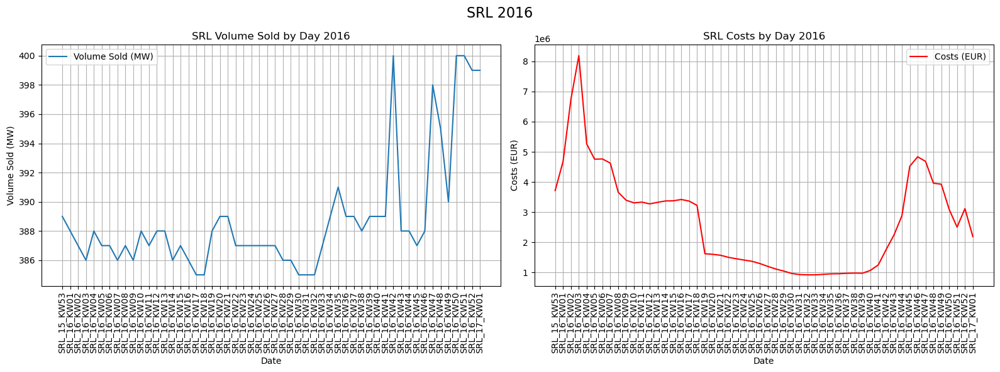

In [ ]:
res16_s=res16[res16['Description'].str.contains('Secondary control')].copy()

res16_s['Week'] = res16_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_s16 = res16_s.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_s16.index, grouped_s16['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('SRL Volume Sold by Day 2016')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_s16.index, grouped_s16['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('SRL Costs by Day 2016')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('SRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2016

In [ ]:
# Create DataFrame for Tertiary control
res16_CH_t = res16[res16['Description'].str.contains('Tertiary Power')].copy()

TPDW16=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW16=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP'].copy()
TPD16_00_04=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD16_04_08=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD16_08_12=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD16_12_16=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD16_16_20=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD16_20_24=res16_CH_t[res16_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU16_00_04=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU16_04_08=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU16_08_12=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU16_12_16=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU16_16_20=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU16_20_24=res16_CH_t[res16_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW16['Week']=TPDW16['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW16['Week']=TPUW16['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW16=TPDW16.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW16=TPUW16.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD16_00_04['date'] = pd.to_datetime(TPD16_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_04_08['date'] = pd.to_datetime(TPD16_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_08_12['date'] = pd.to_datetime(TPD16_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_12_16['date'] = pd.to_datetime(TPD16_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_16_20['date'] = pd.to_datetime(TPD16_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD16_20_24['date'] = pd.to_datetime(TPD16_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU16_00_04['date'] = pd.to_datetime(TPU16_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_04_08['date'] = pd.to_datetime(TPU16_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_08_12['date'] = pd.to_datetime(TPU16_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_12_16['date'] = pd.to_datetime(TPU16_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_16_20['date'] = pd.to_datetime(TPU16_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU16_20_24['date'] = pd.to_datetime(TPU16_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD16_00_04=TPD16_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_04_08=TPD16_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_08_12=TPD16_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_12_16=TPD16_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_16_20=TPD16_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD16_20_24=TPD16_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU16_00_04=TPU16_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_04_08=TPU16_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_08_12=TPU16_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_12_16=TPU16_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_16_20=TPU16_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU16_20_24=TPU16_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD16 = [grouped_TPD16_00_04, grouped_TPD16_04_08, grouped_TPD16_08_12, grouped_TPD16_12_16, grouped_TPD16_16_20, grouped_TPD16_20_24]

grouped_TPU16 = [grouped_TPU16_00_04, grouped_TPU16_04_08, grouped_TPU16_08_12, grouped_TPU16_12_16, grouped_TPU16_16_20, grouped_TPU16_20_24]

grouped_TPW16=[grouped_TPDW16, grouped_TPUW16]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=280
max_cost=28930.0


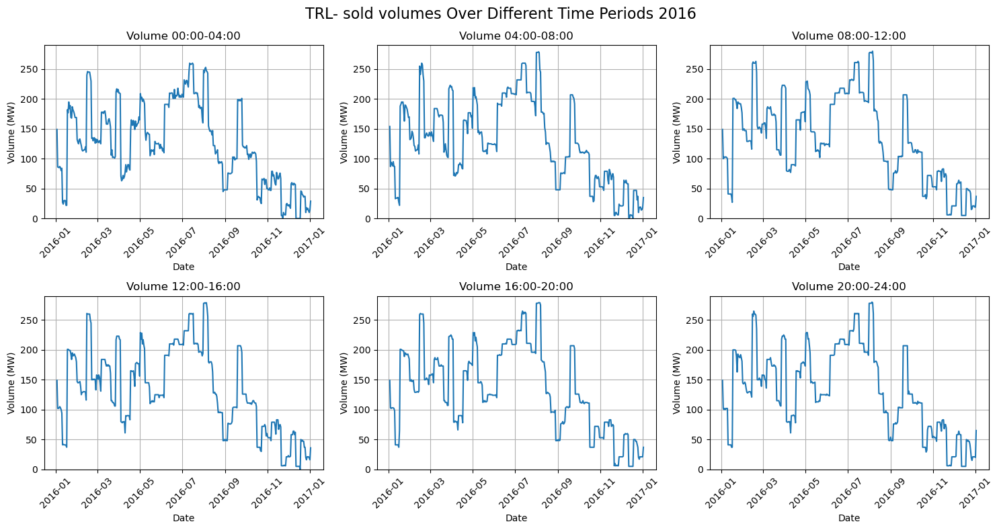

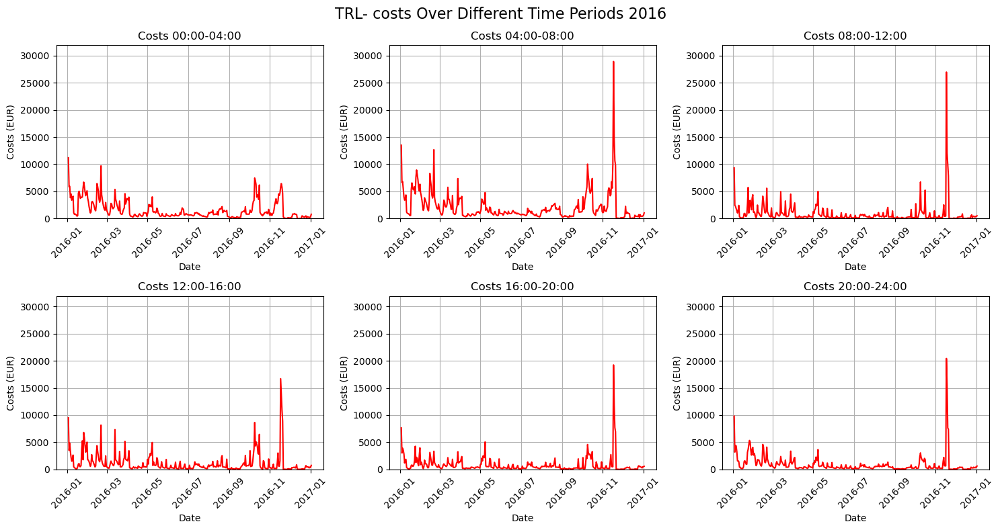

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD16):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD16):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=720
max_cost=53753.0


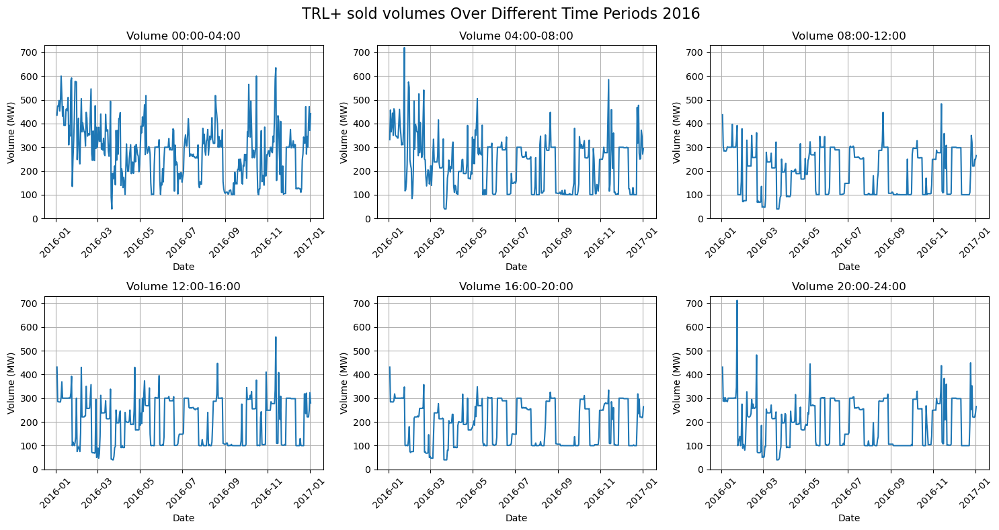

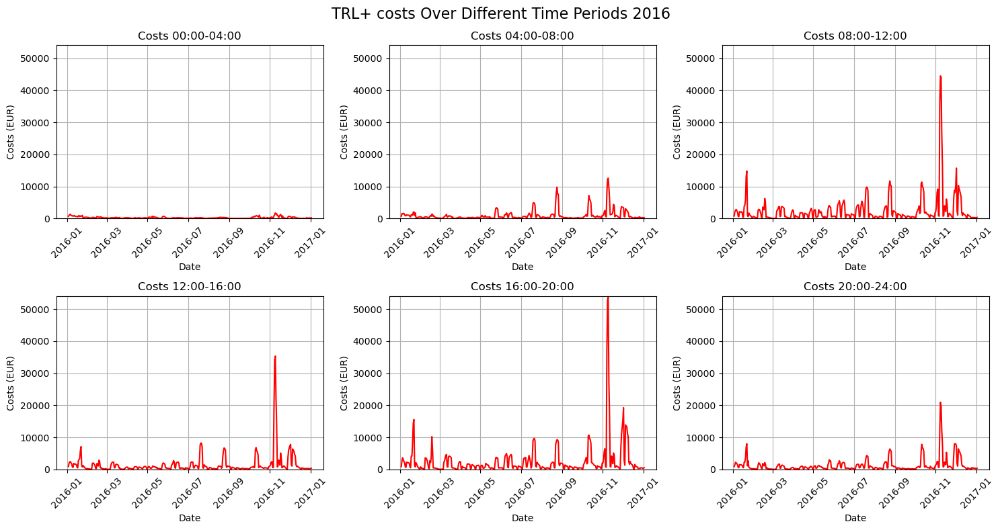

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU16):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU16):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2016', fontsize=16)
plt.tight_layout()
plt.show()

max_volume=360
max_cost=370192.0


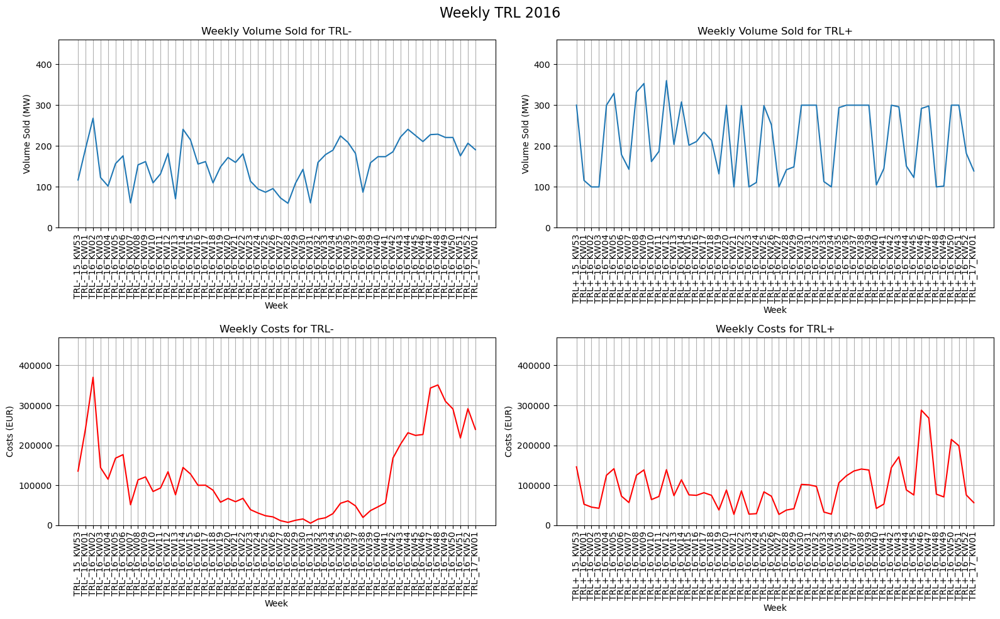

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW16])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW16])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW16.index, grouped_TPDW16['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW16.index, grouped_TPUW16['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW16.index, grouped_TPDW16['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW16.index, grouped_TPUW16['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2016', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2017

In [ ]:
res17=pd.read_csv(DATA+'2017_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])

res17_CH=res17[res17.Pays=='CH']
print(res17_CH.Description.unique())
res17_CH

['Primary control Auction' 'Secondary control Auction'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
0,PRL_16_KW52,Primary control Auction,1,MW,1,MW,2750.0,EUR/MW,2750.0,EUR,16.37,EUR/MWh*,CH
1,PRL_16_KW52,Primary control Auction,1,MW,1,MW,3250.0,EUR/MW,3250.0,EUR,19.35,EUR/MWh*,CH
2,PRL_16_KW52,Primary control Auction,6,MW,6,MW,3199.0,EUR/MW,19194.0,EUR,19.04,EUR/MWh*,CH
3,PRL_16_KW52,Primary control Auction,6,MW,6,MW,2999.0,EUR/MW,17994.0,EUR,17.85,EUR/MWh*,CH
4,PRL_16_KW52,Primary control Auction,3,MW,3,MW,3828.0,EUR/MW,11484.0,EUR,22.79,EUR/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
127530,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,175.0,CHF/MW,0.0,CHF,43.75,CHF/MWh*,CH
127531,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,20,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH
127532,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH
127533,TRL+_17_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,0.0,CHF/MW,0.0,CHF,0.00,CHF/MWh*,CH


## Primary control auction 2017

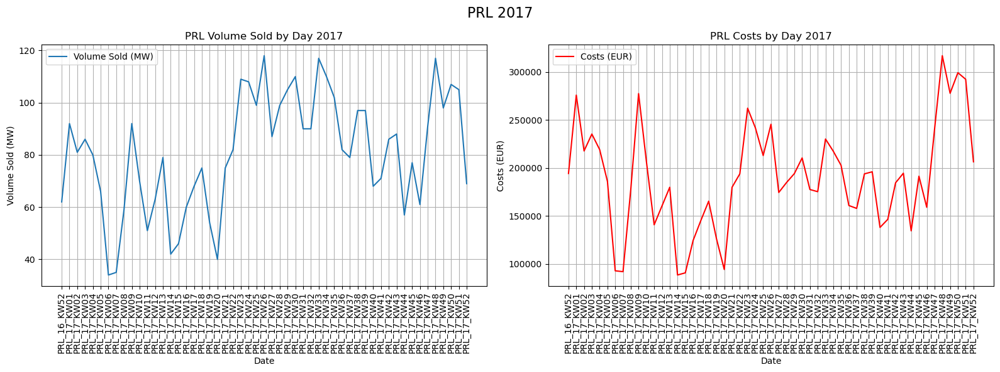

In [ ]:
res17_CH_p=res17_CH[res17_CH['Description'].str.contains('Primary control')].copy()

res17_CH_p['Week'] = res17_CH_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

# Grouping by 'date' and summing the volume sold and costs
grouped_p17 = res17_CH_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p17.index, grouped_p17['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2017')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p17.index, grouped_p17['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2017')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2017

In [ ]:
# Create DataFrame for Secondary control
res17_CH_s = res17_CH[res17_CH['Description'].str.contains('Secondary control')].copy()
res17_CH_s

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
38263,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,7499.00,CHF/MW,224970.00,CHF,44.64,CHF/MWh*,CH
38264,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,8099.00,CHF/MW,242970.00,CHF,48.21,CHF/MWh*,CH
38265,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,8499.00,CHF/MW,84990.00,CHF,50.59,CHF/MWh*,CH
38266,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,9422.00,CHF/MW,94220.00,CHF,56.08,CHF/MWh*,CH
38267,SRL_16_KW52,Secondary control Auction,5,MW,5,MW,9240.00,CHF/MW,46200.00,CHF,55.00,CHF/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39210,SRL_17_KW52,Secondary control Auction,10,MW,10,MW,6830.00,CHF/MW,68300.00,CHF,40.65,CHF/MWh*,CH
39211,SRL_17_KW52,Secondary control Auction,30,MW,30,MW,4827.00,CHF/MW,144810.00,CHF,28.73,CHF/MWh*,CH
39212,SRL_17_KW52,Secondary control Auction,22,MW,22,MW,4347.84,CHF/MW,95652.48,CHF,25.88,CHF/MWh*,CH
39213,SRL_17_KW52,Secondary control Auction,5,MW,5,MW,5439.84,CHF/MW,27199.20,CHF,32.38,CHF/MWh*,CH


In [ ]:
SRL17=res17_CH_s[res17_CH_s.Description=='Secondary control Auction'].copy()
SRL17['Week'] = SRL17['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

grouped_SRL17=SRL17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

In [ ]:
SRL17

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Week
38263,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,7499.00,CHF/MW,224970.00,CHF,44.64,CHF/MWh*,CH,SRL_16_KW52
38264,SRL_16_KW52,Secondary control Auction,30,MW,30,MW,8099.00,CHF/MW,242970.00,CHF,48.21,CHF/MWh*,CH,SRL_16_KW52
38265,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,8499.00,CHF/MW,84990.00,CHF,50.59,CHF/MWh*,CH,SRL_16_KW52
38266,SRL_16_KW52,Secondary control Auction,10,MW,10,MW,9422.00,CHF/MW,94220.00,CHF,56.08,CHF/MWh*,CH,SRL_16_KW52
38267,SRL_16_KW52,Secondary control Auction,5,MW,5,MW,9240.00,CHF/MW,46200.00,CHF,55.00,CHF/MWh*,CH,SRL_16_KW52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39210,SRL_17_KW52,Secondary control Auction,10,MW,10,MW,6830.00,CHF/MW,68300.00,CHF,40.65,CHF/MWh*,CH,SRL_17_KW52
39211,SRL_17_KW52,Secondary control Auction,30,MW,30,MW,4827.00,CHF/MW,144810.00,CHF,28.73,CHF/MWh*,CH,SRL_17_KW52
39212,SRL_17_KW52,Secondary control Auction,22,MW,22,MW,4347.84,CHF/MW,95652.48,CHF,25.88,CHF/MWh*,CH,SRL_17_KW52
39213,SRL_17_KW52,Secondary control Auction,5,MW,5,MW,5439.84,CHF/MW,27199.20,CHF,32.38,CHF/MWh*,CH,SRL_17_KW52


In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = grouped_SRL17['Volume_attribué'].max() 
max_cost = grouped_SRL17['Coûts'].max() 
min_volume=grouped_SRL17['Volume_attribué'].min() 
min_cost = grouped_SRL17['Coûts'].min() 

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

max_volume=400, min volume= 383
max_cost=6007845.48, min cost= 795742.72


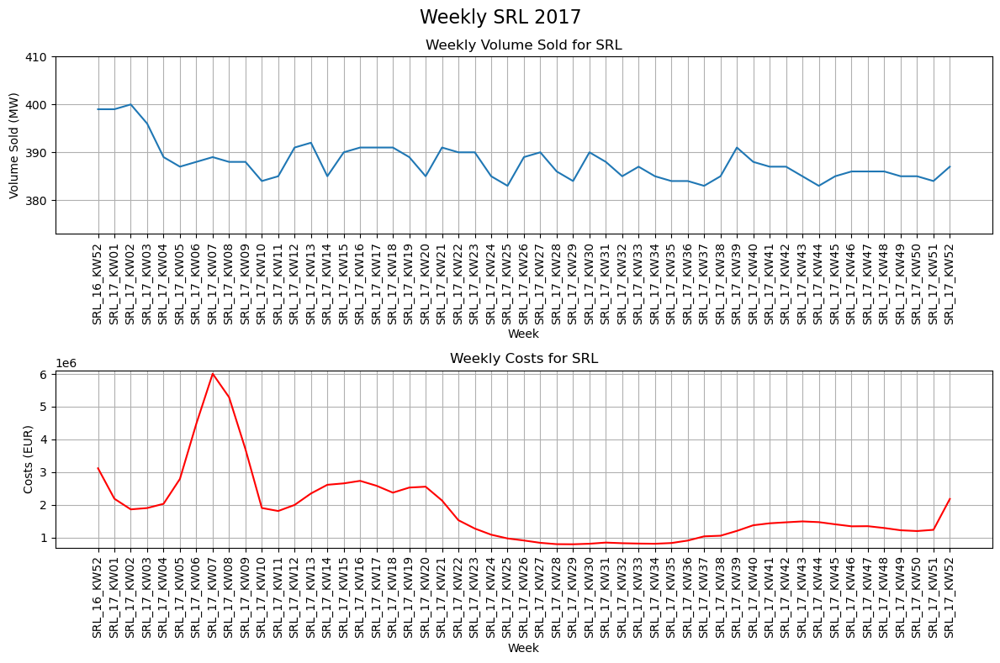

In [ ]:
# Define dynamic y-limits
volume_ylim = (min_volume-10, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost-100000, max_cost + 100000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 1, figsize=(12, 8))  # Adjust figure size as needed

axes[0].plot(grouped_SRL17.index, grouped_SRL17['Volume_attribué'], label='SRL Volume Sold')
axes[0].set_title(f'Weekly Volume Sold for SRL')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Volume Sold (MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)
axes[0].set_ylim(volume_ylim)

axes[1].plot(grouped_SRL17.index, grouped_SRL17['Coûts'], label='SRL Costs', color='red')
axes[1].set_title(f'Weekly Costs for SRL')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Costs (EUR)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)
axes[1].set_ylim(cost_ylim)

plt.suptitle('Weekly SRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2017

In [ ]:
# Create DataFrame for Tertiary control
res17_CH_t = res17_CH[res17_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW17=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW17=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP'].copy()
TPD17_00_04=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD17_04_08=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD17_08_12=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD17_12_16=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD17_16_20=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD17_20_24=res17_CH_t[res17_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU17_00_04=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU17_04_08=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU17_08_12=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU17_12_16=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU17_16_20=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU17_20_24=res17_CH_t[res17_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW17['Week']=TPDW17['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW17['Week']=TPUW17['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW17=TPDW17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW17=TPUW17.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD17_00_04['date'] = pd.to_datetime(TPD17_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_04_08['date'] = pd.to_datetime(TPD17_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_08_12['date'] = pd.to_datetime(TPD17_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_12_16['date'] = pd.to_datetime(TPD17_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_16_20['date'] = pd.to_datetime(TPD17_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD17_20_24['date'] = pd.to_datetime(TPD17_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU17_00_04['date'] = pd.to_datetime(TPU17_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_04_08['date'] = pd.to_datetime(TPU17_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_08_12['date'] = pd.to_datetime(TPU17_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_12_16['date'] = pd.to_datetime(TPU17_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_16_20['date'] = pd.to_datetime(TPU17_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU17_20_24['date'] = pd.to_datetime(TPU17_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD17_00_04=TPD17_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_04_08=TPD17_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_08_12=TPD17_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_12_16=TPD17_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_16_20=TPD17_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD17_20_24=TPD17_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU17_00_04=TPU17_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_04_08=TPU17_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_08_12=TPU17_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_12_16=TPU17_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_16_20=TPU17_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU17_20_24=TPU17_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD17 = [grouped_TPD17_00_04, grouped_TPD17_04_08, grouped_TPD17_08_12, grouped_TPD17_12_16, grouped_TPD17_16_20, grouped_TPD17_20_24]

grouped_TPU17 = [grouped_TPU17_00_04, grouped_TPU17_04_08, grouped_TPU17_08_12, grouped_TPU17_12_16, grouped_TPU17_16_20, grouped_TPU17_20_24]

grouped_TPW17=[grouped_TPDW17, grouped_TPUW17]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=243
max_cost=9235.0


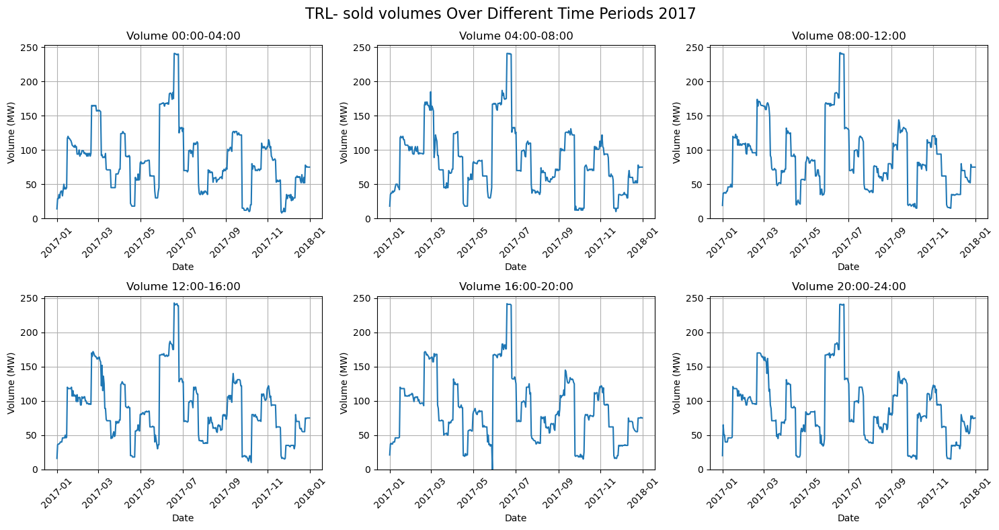

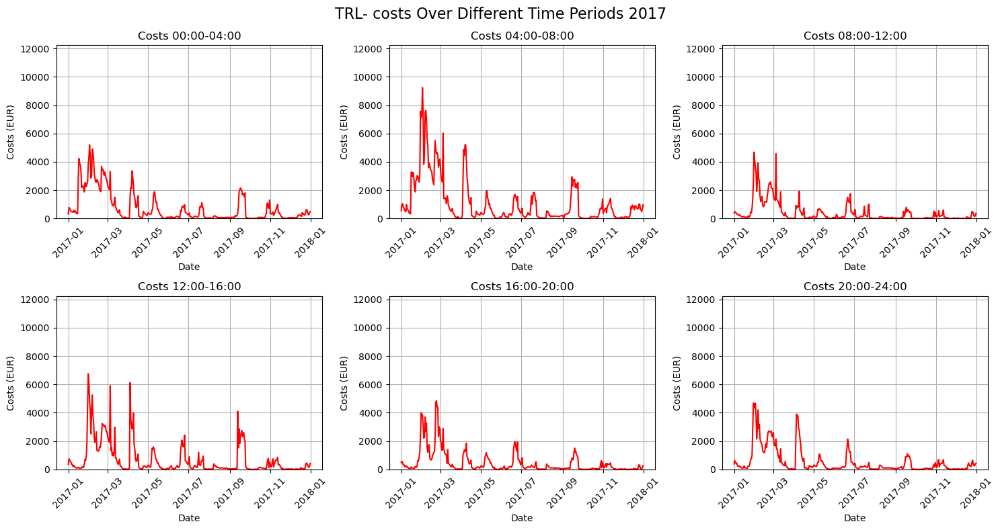

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD17):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD17):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=462
max_cost=22541.699999999997


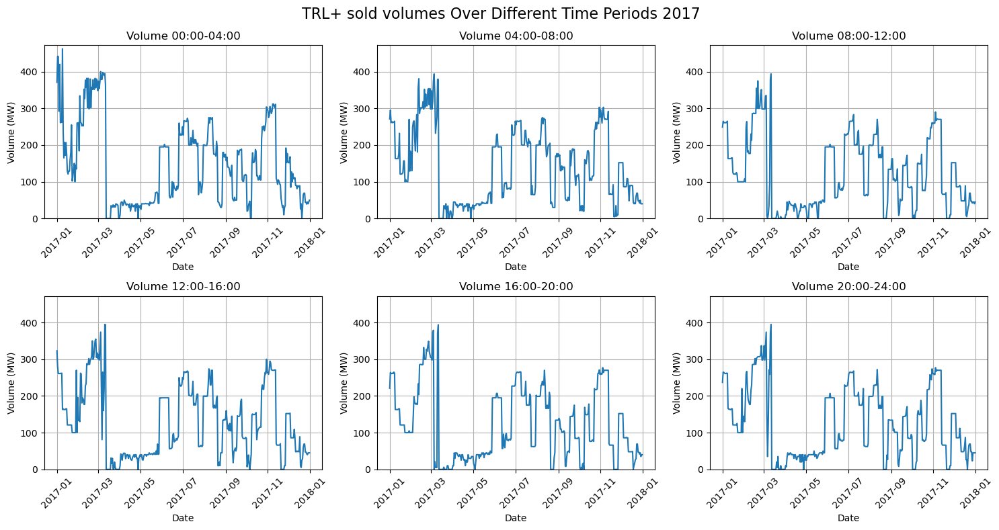

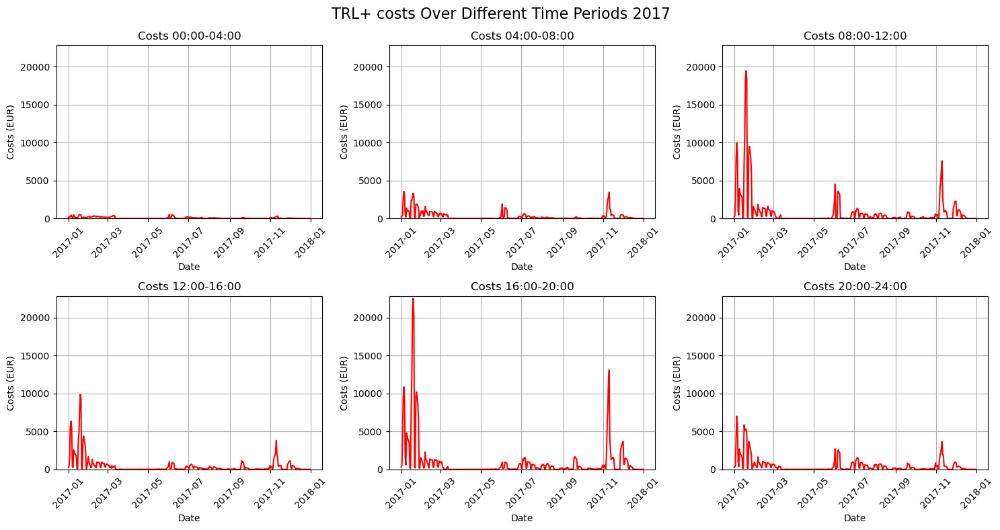

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU17):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU17):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2017', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=499
max_cost=398394.6


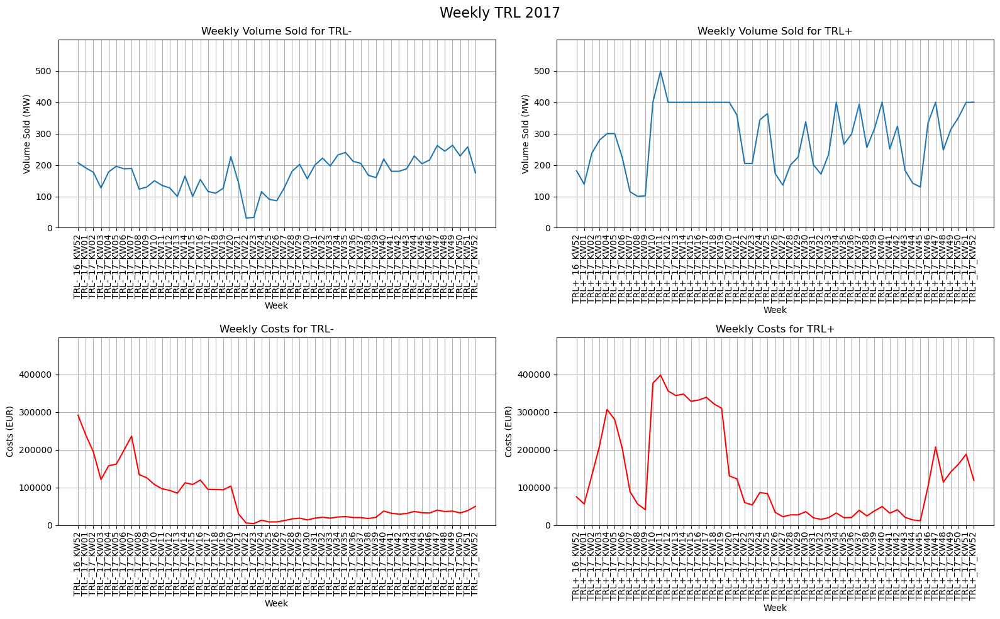

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW17])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW17])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW17.index, grouped_TPDW17['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW17.index, grouped_TPUW17['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW17.index, grouped_TPDW17['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW17.index, grouped_TPUW17['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2017', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2018

In [ ]:
res18 = pd.read_csv(DATA+'2018-PRL-SRL-TRL-Ergebnis.csv', encoding='ISO-8859-1', sep=';',header=None, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])

columns_to_convert = ['Volume_offert', 'Volume_attribué', 'Prix_prestation', 'Coûts', 'Prix']

for col in columns_to_convert:
    res18[col] = pd.to_numeric(res18[col], errors='coerce')

res18.dtypes

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_29464\1506348686.py:1: DtypeWarning: Columns (2,4,6,8,10) have mixed types. Specify dtype option on import or set low_memory=False.
  res18 = pd.read_csv(DATA+'2018-PRL-SRL-TRL-Ergebnis.csv', encoding='ISO-8859-1', sep=';',header=None, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays'])


Appel_offres        object
Description         object
Volume_offert      float64
Unité1              object
Volume_attribué    float64
Unité2              object
Prix_prestation    float64
Unité3              object
Coûts              float64
Unité4              object
Prix               float64
Unité5              object
Pays                object
dtype: object

## Primary control auction 2018

In [ ]:
res18_CH=res18[res18.Pays=='CH']
print(res18_CH.Description.unique())
res18_CH

res18_CH_p=res18_CH[res18_CH['Description'].str.contains('Primary control')].copy()
res18_CH_p.dtypes

['Primary control Auction' 'Secondary control Auction'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


Appel_offres        object
Description         object
Volume_offert      float64
Unité1              object
Volume_attribué    float64
Unité2              object
Prix_prestation    float64
Unité3              object
Coûts              float64
Unité4              object
Prix               float64
Unité5              object
Pays                object
dtype: object

In [ ]:
res18_CH_p['Week'] = res18_CH_p['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
res18_CH_p

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Week
1,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3587.0,EUR/MW,3587.0,EUR,21.35,EUR/MWh*,CH,18_KW01
2,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,18_KW01
3,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,18_KW01
4,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3142.0,EUR/MW,3142.0,EUR,18.70,EUR/MWh*,CH,18_KW01
5,PRL_18_KW01,Primary control Auction,1.0,MW,1.0,MW,3175.0,EUR/MW,3175.0,EUR,18.90,EUR/MWh*,CH,18_KW01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37876,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,2974.0,EUR/MW,2974.0,EUR,17.70,EUR/MWh*,CH,19_KW01
37877,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,2999.0,EUR/MW,2999.0,EUR,17.85,EUR/MWh*,CH,19_KW01
37878,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,3049.0,EUR/MW,3049.0,EUR,18.15,EUR/MWh*,CH,19_KW01
37879,PRL_19_KW01,Primary control Auction,1.0,MW,1.0,MW,3100.0,EUR/MW,3100.0,EUR,18.45,EUR/MWh*,CH,19_KW01


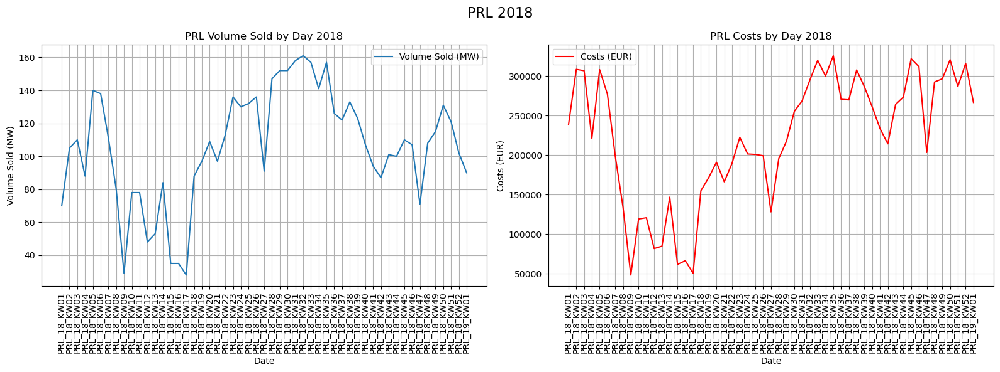

In [ ]:
# Grouping by 'date' and summing the volume sold and costs
grouped_p18 = res18_CH_p.groupby('Appel_offres').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p18.index, grouped_p18['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2018')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=90)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p18.index, grouped_p18['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2018')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=90)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

## Secondary control auction 2018

In [ ]:
# Create DataFrame for Secondary control
res18_CH_s = res18_CH[res18_CH['Description'].str.contains('Secondary control')].copy()
res18_CH_s

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays
38551,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5030.0,CHF/MW,150900.0,CHF,29.94,CHF/MWh*,CH
38552,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5231.0,CHF/MW,156930.0,CHF,31.14,CHF/MWh*,CH
38553,SRL_18_KW01,Secondary control Auction,30.0,MW,30.0,MW,5318.0,CHF/MW,159540.0,CHF,31.65,CHF/MWh*,CH
38554,SRL_18_KW01,Secondary control Auction,10.0,MW,10.0,MW,4935.0,CHF/MW,49350.0,CHF,29.38,CHF/MWh*,CH
38555,SRL_18_KW01,Secondary control Auction,10.0,MW,10.0,MW,5034.0,CHF/MW,50340.0,CHF,29.96,CHF/MWh*,CH
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39660,SRL_19_KW01,Secondary control Auction SRL-,20.0,MW,20.0,MW,3968.0,CHF/MW,79360.0,CHF,23.62,CHF/MWh*,CH
39661,SRL_19_KW01,Secondary control Auction SRL-,20.0,MW,20.0,MW,4291.0,CHF/MW,85820.0,CHF,25.54,CHF/MWh*,CH
39662,SRL_19_KW01,Secondary control Auction SRL-,100.0,MW,100.0,MW,4490.0,CHF/MW,449000.0,CHF,26.73,CHF/MWh*,CH
39663,SRL_19_KW01,Secondary control Auction SRL-,50.0,MW,50.0,MW,3834.0,CHF/MW,191700.0,CHF,22.82,CHF/MWh*,CH


In [ ]:
tmp=res18_CH_s.groupby('Description').agg({'Volume_attribué': 'count'})
tmp

,Volume_attribué
Description,
Secondary control Auction,361
Secondary control Auction SRL+,373
Secondary control Auction SRL-,380


In [ ]:

res18_CH_s['Week'] = res18_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL18=res18_CH_s[res18_CH_s.Description=='Secondary control Auction'].copy()
SRL18m=res18_CH_s[res18_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL18p=res18_CH_s[res18_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL18=SRL18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_SRL18m=SRL18m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_SRL18p=SRL18p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_SRL18=[grouped_SRL18m, grouped_SRL18p, grouped_SRL18]
SRL_labels=['SRL-','SRL+','SRL']

max_volume=425.0, min volume= 366.0
max_cost=2391539.4, min cost= 235038.0


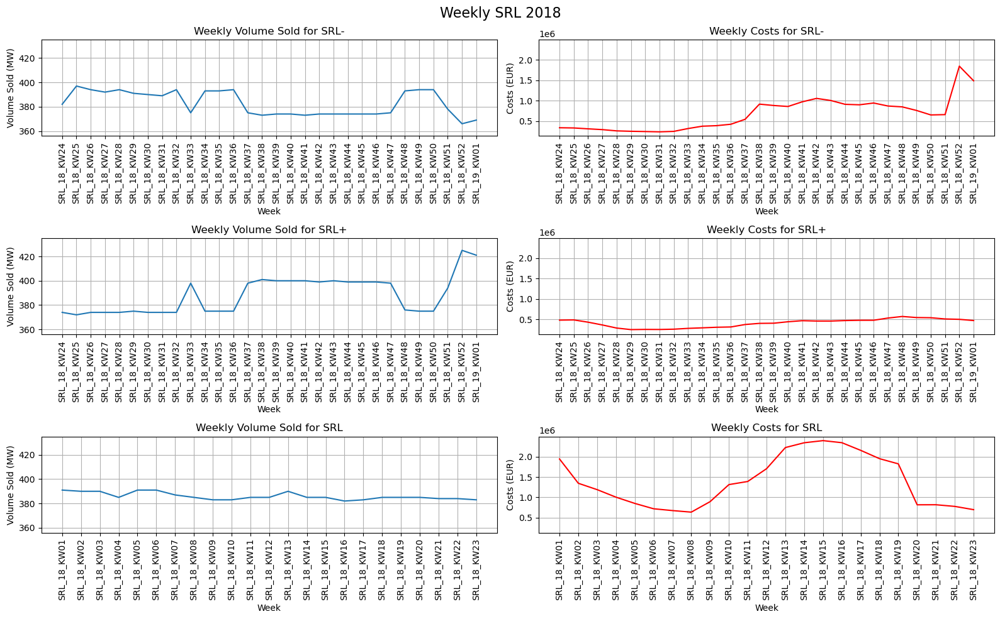

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL18])
min_cost = min([data['Coûts'].min() for data in grouped_SRL18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (min_volume-10, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost-100000, max_cost + 100000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(3, 2, figsize=(16, 10))  # Adjust figure size as needed

for i, data in enumerate(grouped_SRL18):
    
    axes[i, 0].plot(data.index, data['Volume_attribué'], label=f'{SRL_labels[i]} Volume Sold')
    axes[i, 0].set_title(f'Weekly Volume Sold for {SRL_labels[i]}')
    axes[i, 0].set_xlabel('Week')
    axes[i, 0].set_ylabel('Volume Sold (MW)')
    axes[i, 0].grid(True)
    axes[i, 0].tick_params(axis='x', rotation=90)
    axes[i, 0].set_ylim(volume_ylim)
    
    axes[i, 1].plot(data.index, data['Coûts'], label=f'{SRL_labels[i]} Costs', color='red')
    axes[i, 1].set_title(f'Weekly Costs for {SRL_labels[i]}')
    axes[i, 1].set_xlabel('Week')
    axes[i, 1].set_ylabel('Costs (EUR)')
    axes[i, 1].grid(True)
    axes[i, 1].tick_params(axis='x', rotation=90)
    axes[i, 1].set_ylim(cost_ylim)
    
plt.suptitle('Weekly SRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

## Tertiary control auction 2018

In [ ]:
# Create DataFrame for Tertiary control
res18_CH_t = res18_CH[res18_CH['Description'].str.contains('Tertiary Power')].copy()

TPDW18=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW18=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP'].copy()
TPD18_00_04=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD18_04_08=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD18_08_12=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD18_12_16=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD18_16_20=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD18_20_24=res18_CH_t[res18_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU18_00_04=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU18_04_08=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU18_08_12=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU18_12_16=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU18_16_20=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU18_20_24=res18_CH_t[res18_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW18['Week']=TPDW18['Appel_offres'].str.extract(r'(TRL-_\d{2}_KW\d{2})')[0]
TPUW18['Week']=TPUW18['Appel_offres'].str.extract(r'(TRL\+_\d{2}_KW\d{2})')[0]

grouped_TPDW18=TPDW18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPUW18=TPUW18.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

TPD18_00_04['date'] = pd.to_datetime(TPD18_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_04_08['date'] = pd.to_datetime(TPD18_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_08_12['date'] = pd.to_datetime(TPD18_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_12_16['date'] = pd.to_datetime(TPD18_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_16_20['date'] = pd.to_datetime(TPD18_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD18_20_24['date'] = pd.to_datetime(TPD18_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU18_00_04['date'] = pd.to_datetime(TPU18_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_04_08['date'] = pd.to_datetime(TPU18_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_08_12['date'] = pd.to_datetime(TPU18_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_12_16['date'] = pd.to_datetime(TPU18_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_16_20['date'] = pd.to_datetime(TPU18_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU18_20_24['date'] = pd.to_datetime(TPU18_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD18_00_04=TPD18_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_04_08=TPD18_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_08_12=TPD18_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_12_16=TPD18_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_16_20=TPD18_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPD18_20_24=TPD18_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

grouped_TPU18_00_04=TPU18_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_04_08=TPU18_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_08_12=TPU18_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_12_16=TPU18_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_16_20=TPU18_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})
grouped_TPU18_20_24=TPU18_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum'})

# Grouped data list and labels
grouped_TPD18 = [grouped_TPD18_00_04, grouped_TPD18_04_08, grouped_TPD18_08_12, grouped_TPD18_12_16, grouped_TPD18_16_20, grouped_TPD18_20_24]

grouped_TPU18 = [grouped_TPU18_00_04, grouped_TPU18_04_08, grouped_TPU18_08_12, grouped_TPU18_12_16, grouped_TPU18_16_20, grouped_TPU18_20_24]

grouped_TPW18=[grouped_TPDW18, grouped_TPUW18]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

max_volume=222.0, min volume= 0.0
max_cost=8294.19, min cost= 0.0


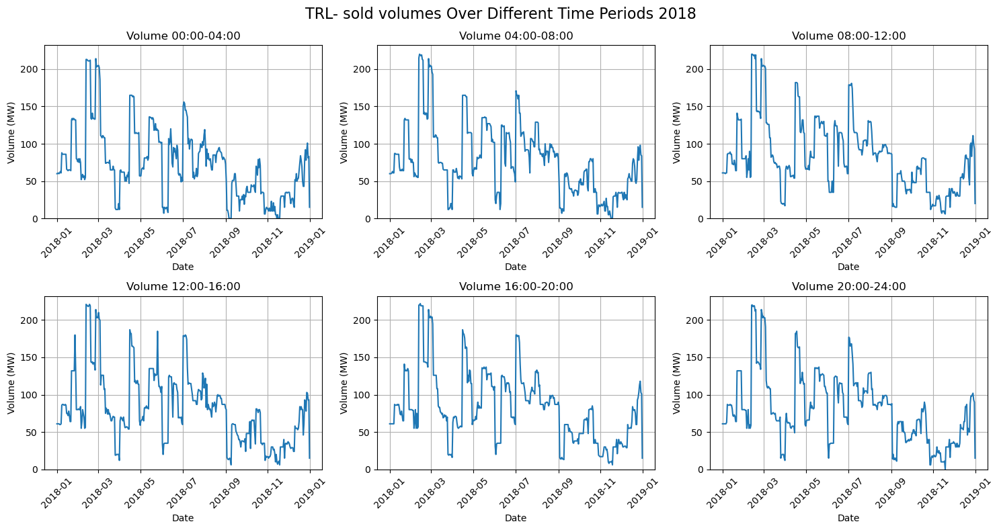

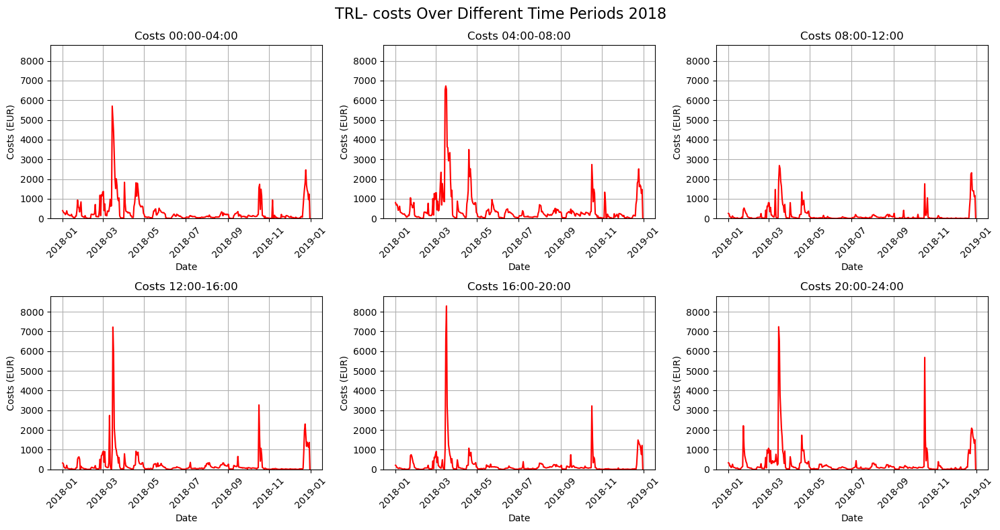

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD18])
min_cost = min([data['Coûts'].min() for data in grouped_TPD18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 500)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD18):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD18):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=397.0, min volume= 0.0
max_cost=33059.88, min cost= 0.0


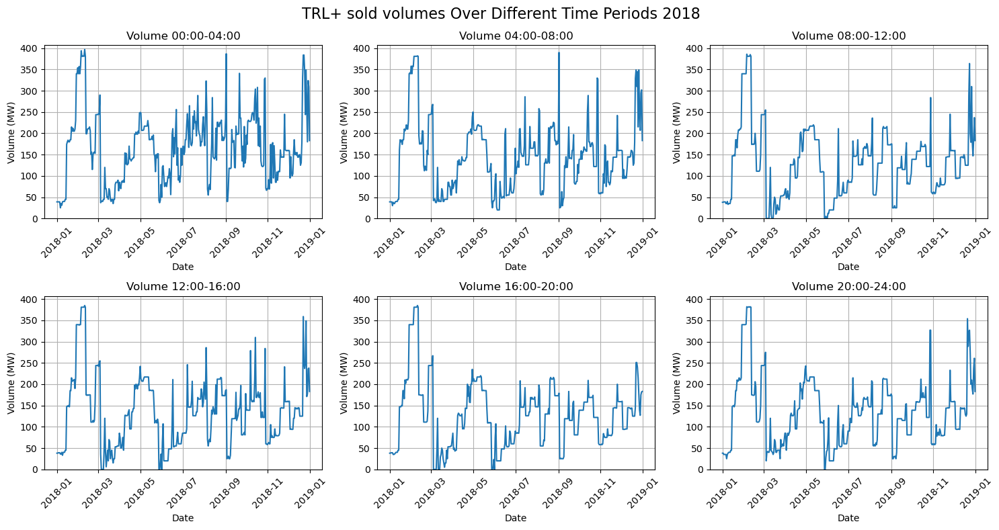

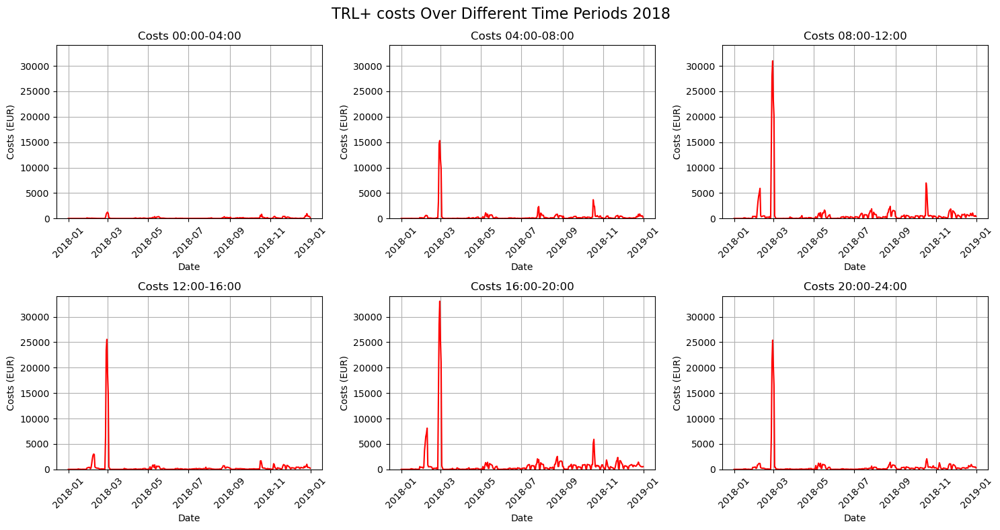

In [ ]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPU18])
min_cost = min([data['Coûts'].min() for data in grouped_TPU18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 1000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU18):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU18):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2018', fontsize=16)
plt.tight_layout()
plt.show()


max_volume=400.0, min volume= 19.0
max_cost=143120.36, min cost= 1825.0


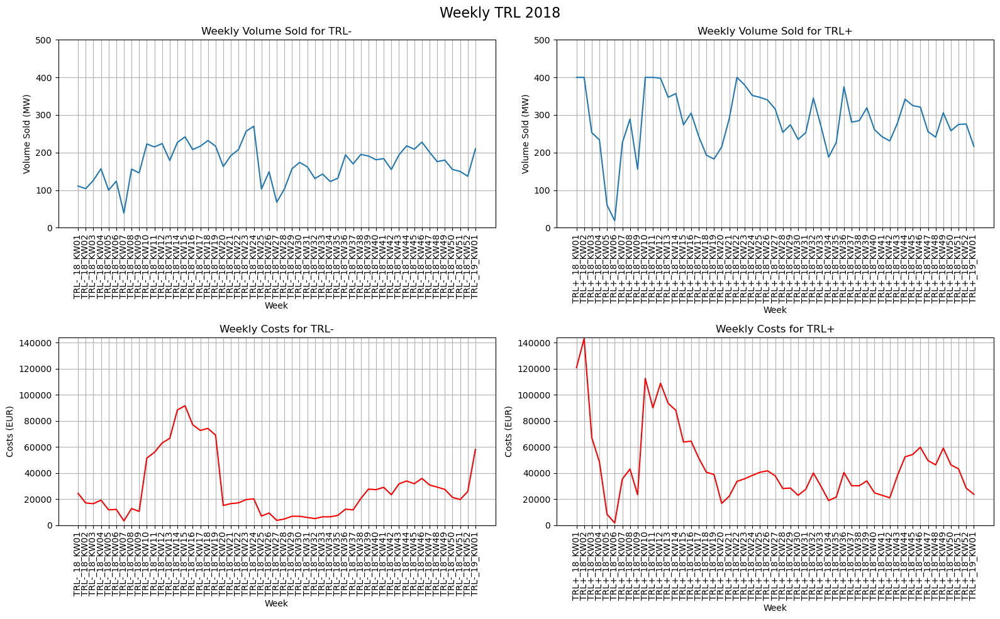

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW18])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW18])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW18])
min_cost = min([data['Coûts'].min() for data in grouped_TPW18])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 1000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW18.index, grouped_TPDW18['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW18.index, grouped_TPUW18['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW18.index, grouped_TPDW18['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (EUR)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW18.index, grouped_TPUW18['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (EUR)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2018', fontsize=16)
plt.tight_layout()
plt.show()

---
# Data 2019

In [4]:
res19=pd.read_csv(DATA+'2019_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res19_CH=res19[res19.Pays=='CH']
print(res19_CH.Description.unique())
res19_CH

['Primary control Auction' 'Secondary control Auction SRL+'
 'Secondary control Auction SRL-' 'Tertiary Power DOWN'
 'Tertiary Power UP' 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1514265379.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res19=pd.read_csv(DATA+'2019_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_19_07_01,Primary control Auction,17,MW,17,MW,50.00,EUR/MW,850.00,EUR,7.50,EUR/MWh*,CH,2.08,EUR/MWh*,Ja
1,PRL_19_07_01,Primary control Auction,3,MW,3,MW,84.00,EUR/MW,252.00,EUR,7.50,EUR/MWh*,CH,3.50,EUR/MWh*,Nein
2,PRL_19_07_01,Primary control Auction,25,MW,25,MW,123.95,EUR/MW,3098.75,EUR,7.50,EUR/MWh*,CH,5.16,EUR/MWh*,Nein
3,PRL_19_07_01,Primary control Auction,9,MW,9,MW,49.00,EUR/MW,441.00,EUR,7.50,EUR/MWh*,CH,2.04,EUR/MWh*,Nein
4,PRL_19_07_01,Primary control Auction,2,MW,2,MW,51.75,EUR/MW,103.50,EUR,7.50,EUR/MWh*,CH,2.16,EUR/MWh*,Nein
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219392,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,0.80,CHF/MW,8.00,CHF,0.20,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
219393,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,20,MW,0.90,CHF/MW,18.00,CHF,0.22,CHF/MWh*,CH,0.22,CHF/MWh*,NaN
219394,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,8,MW,8,MW,1.20,CHF/MW,9.60,CHF,0.30,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
219395,TRL+_19_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,2.20,CHF/MW,0.00,CHF,0.55,CHF/MWh*,CH,0.55,CHF/MWh*,NaN


## Primary control auction 2019

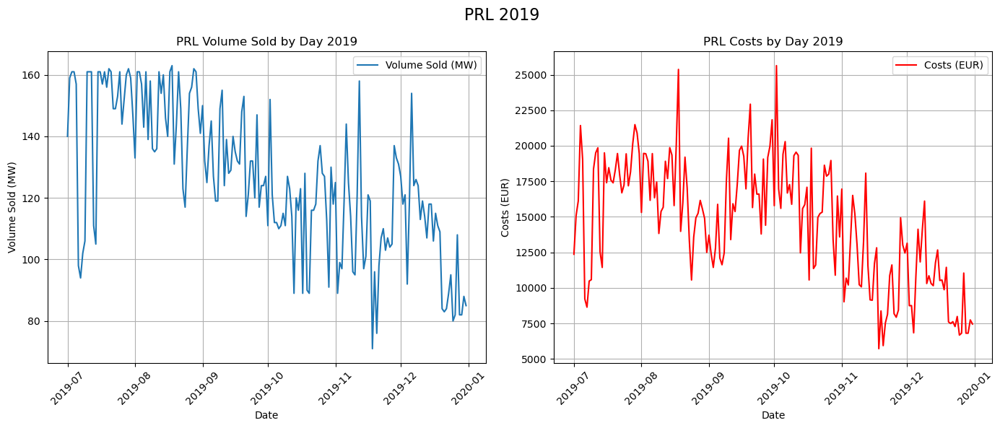

In [5]:
res19_CH_p=res19_CH[res19_CH['Description'].str.contains('Primary control')].copy()

res19_CH_p['date'] = pd.to_datetime(res19_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p19 = res19_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p19.index, grouped_p19['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2019')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p19.index, grouped_p19['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2019')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2019', fontsize=16)
plt.tight_layout()
plt.show()

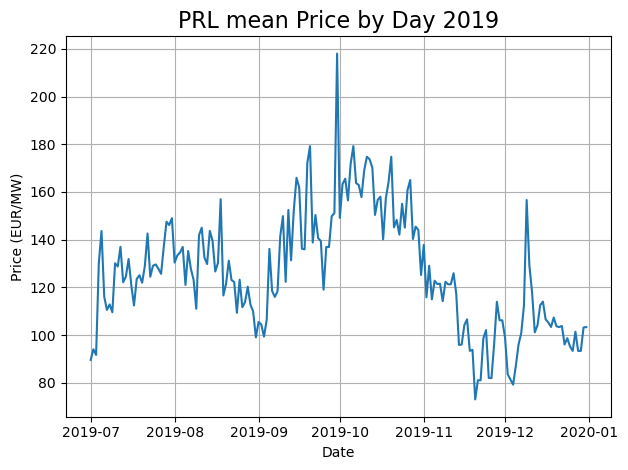

In [6]:
plt.plot(grouped_p19.index, grouped_p19['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2019', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2019/PRL_mean_price_2019.pdf', format='pdf')

plt.show()

In [7]:
grouped_p19['Prix_prestation'].describe()

count    184.000000
mean     126.238761
std       24.825659
min       73.020000
25%      106.551649
50%      123.989681
75%      142.864624
max      218.022500
Name: Prix_prestation, dtype: float64

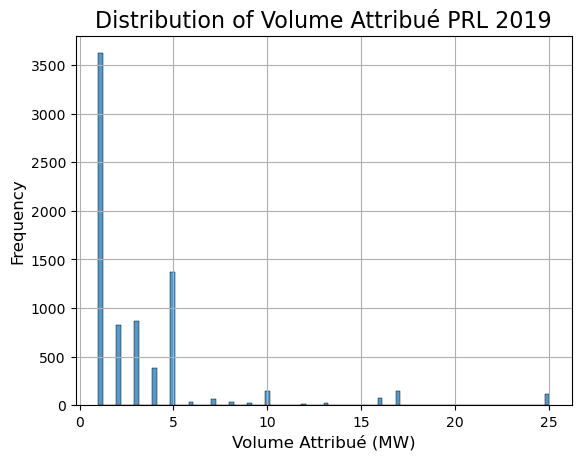

In [8]:
#plt.figure(figsize=(10, 6))
sns.histplot(res19_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2019', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2019/PRL_volume_dist_2019.pdf', format='pdf')
plt.show()

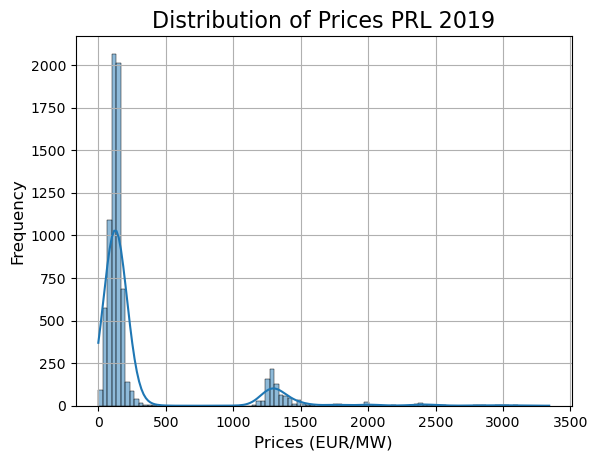

In [9]:
#plt.figure(figsize=(10, 6))
sns.histplot(res19_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2019', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2019/PRL_price_dist_2019.pdf', format='pdf')
plt.show()

In [10]:
tmp=res19_CH_p.groupby('Prix_prestation').agg({'Prix_prestation': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Prix_prestation,
120.0,234
50.0,224
144.0,183
134.0,95
48.0,86
132.0,81
139.0,73
96.0,73
154.0,67


In [11]:
tmp.describe()

,count
count,1751.000000
mean,4.421473
std,11.853220
min,1.000000
25%,1.000000
50%,2.000000
75%,3.000000
max,234.000000


## Secondary control auction 2019

In [12]:
# Create DataFrame for Secondary control
res19_CH_s = res19_CH[res19_CH['Description'].str.contains('Secondary control')].copy()

res19_CH_s['Week'] = res19_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL19m=res19_CH_s[res19_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL19p=res19_CH_s[res19_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL19m=SRL19m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation': 'mean'})
grouped_SRL19p=SRL19p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation': 'mean'})

grouped_SRL19=[grouped_SRL19m, grouped_SRL19p]

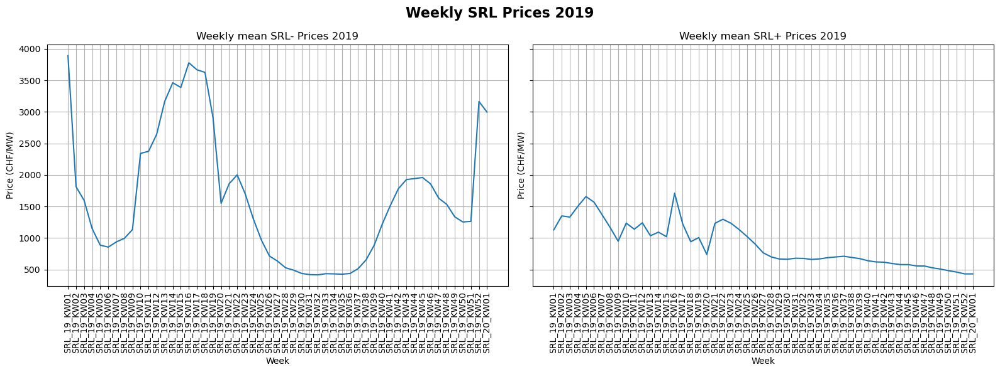

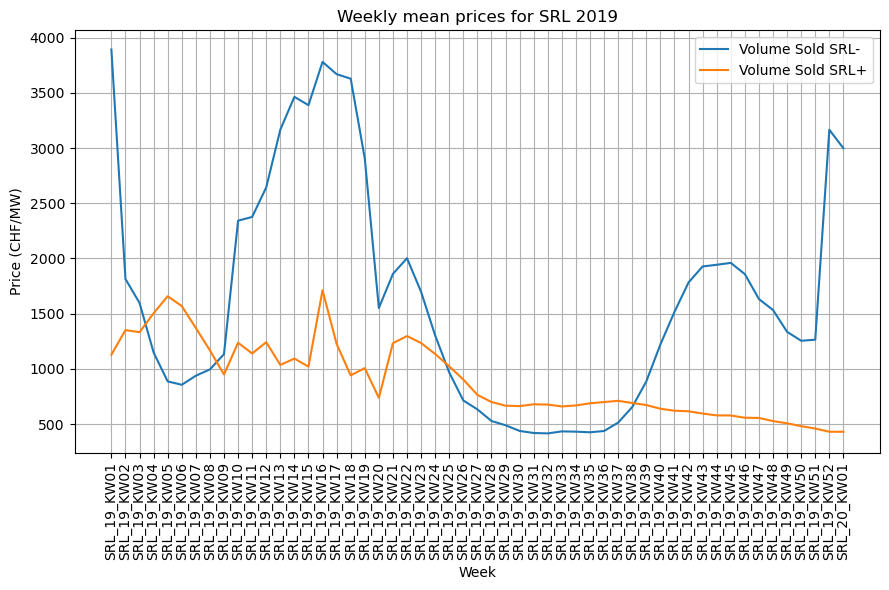

desription of SRL- prices:
 count      53.000000
mean     1638.217664
std      1038.045631
min       416.094545
25%       856.228571
50%      1516.068421
75%      2002.083200
max      3891.666667
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean      901.547592
std       345.144279
min       431.050769
25%       639.423333
50%       738.023529
75%      1167.500000
max      1712.257143
Name: Prix_prestation, dtype: float64


In [13]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL19m.index, grouped_SRL19m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2019')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL19p.index, grouped_SRL19p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2019')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2019', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig('./gfx/2019/Weekly_SRL_Prices_2019.pdf', format='pdf')
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL19m.index, grouped_SRL19m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL19p.index, grouped_SRL19p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2019')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2019/Weekly_SRL_Prices_combined_2019.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL19m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL19p["Prix_prestation"].describe()}')


max_volume=449, min volume= 363
max_cost=1587900.6, min cost= 165303.52


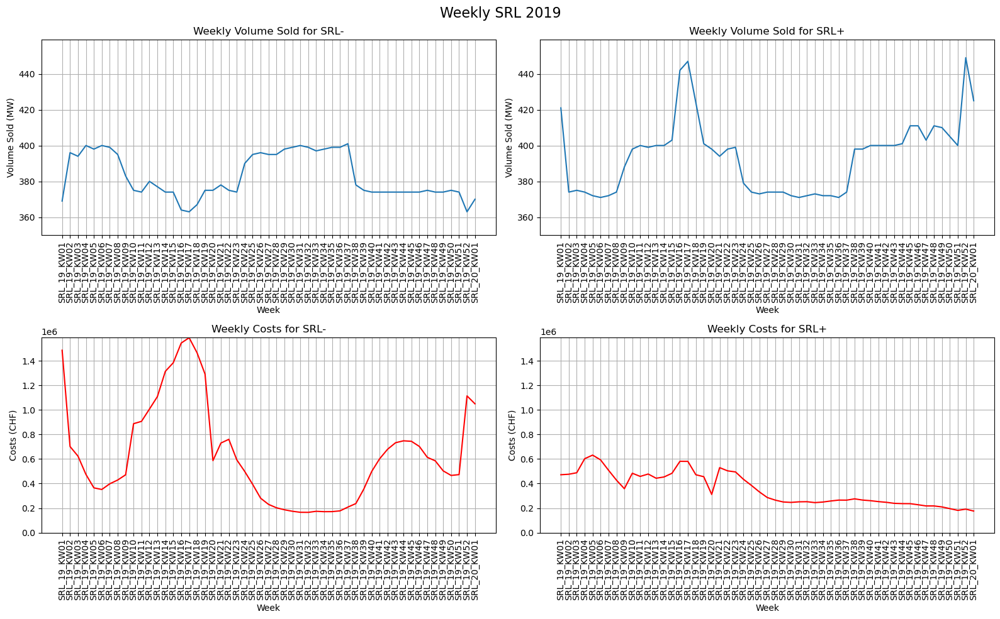

In [14]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL19])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL19])
min_cost = min([data['Coûts'].min() for data in grouped_SRL19])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL19m.index, grouped_SRL19m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL19p.index, grouped_SRL19p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL19m.index, grouped_SRL19m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL19p.index, grouped_SRL19p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2019', fontsize=16)
plt.tight_layout()
plt.show()


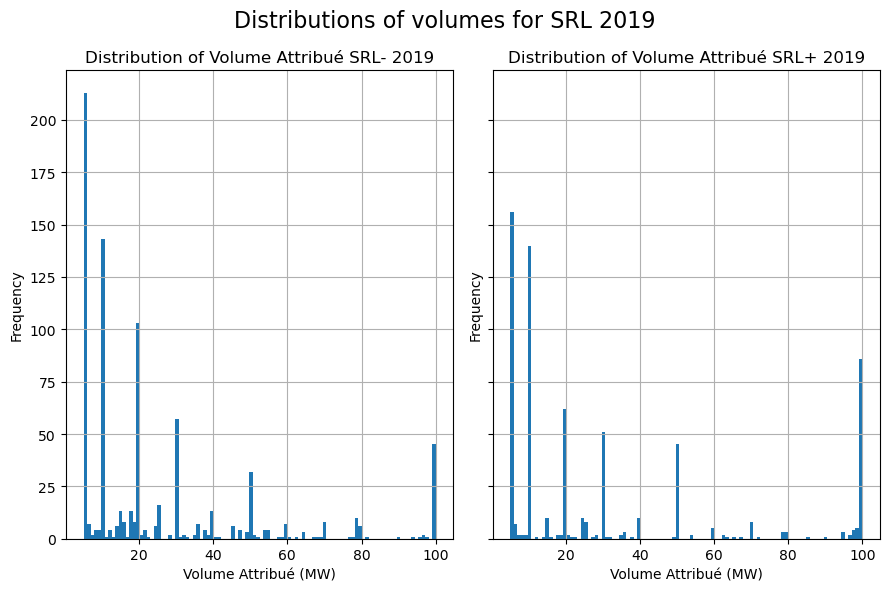

In [15]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True) #
axes[0].hist(SRL19m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2019')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL19p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2019')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/SRL_dist_2019.pdf', format='pdf')
plt.show()

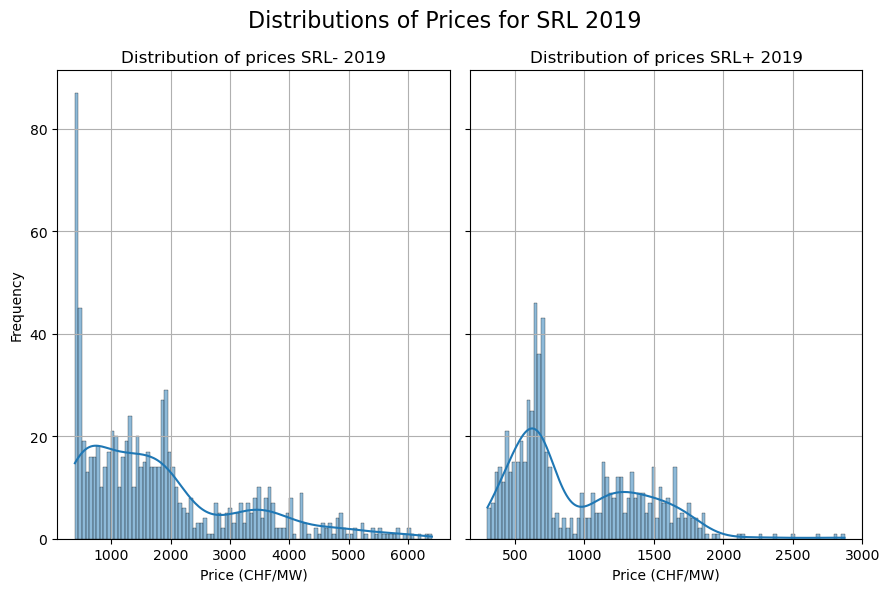

In [16]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL19m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2019')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL19p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2019')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/SRL_dist_prices_2019.pdf', format='pdf')
plt.show()

In [17]:
tmp=SRL19m.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,213
10,143
20,103
30,57
100,45
50,32
25,16
40,13
15,13


In [18]:
tmp=SRL19p.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,156
10,140
100,86
20,62
30,51
50,45
40,10
15,10
24,10


## Tertiary control auction 2019

In [19]:
# Create DataFrame for Tertiary control
res19_CH_t = res19_CH[res19_CH['Description'].str.contains('Tertiary Power')].copy()
res19_CH_t= res19_CH_t[res19_CH_t['Volume_attribué'] != 0]

TPDW19=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW19=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP'].copy()
TPD19_00_04=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD19_04_08=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD19_08_12=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD19_12_16=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD19_16_20=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD19_20_24=res19_CH_t[res19_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU19_00_04=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU19_04_08=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU19_08_12=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU19_12_16=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU19_16_20=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU19_20_24=res19_CH_t[res19_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW19['Week']=TPDW19['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW19['Week']=TPUW19['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW19=TPDW19.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPUW19=TPUW19.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

TPD19_00_04['date'] = pd.to_datetime(TPD19_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_04_08['date'] = pd.to_datetime(TPD19_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_08_12['date'] = pd.to_datetime(TPD19_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_12_16['date'] = pd.to_datetime(TPD19_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_16_20['date'] = pd.to_datetime(TPD19_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD19_20_24['date'] = pd.to_datetime(TPD19_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU19_00_04['date'] = pd.to_datetime(TPU19_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_04_08['date'] = pd.to_datetime(TPU19_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_08_12['date'] = pd.to_datetime(TPU19_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_12_16['date'] = pd.to_datetime(TPU19_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_16_20['date'] = pd.to_datetime(TPU19_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU19_20_24['date'] = pd.to_datetime(TPU19_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD19_00_04=TPD19_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD19_04_08=TPD19_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD19_08_12=TPD19_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD19_12_16=TPD19_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD19_16_20=TPD19_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD19_20_24=TPD19_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_TPU19_00_04=TPU19_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU19_04_08=TPU19_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU19_08_12=TPU19_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU19_12_16=TPU19_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU19_16_20=TPU19_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU19_20_24=TPU19_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD19 = [grouped_TPD19_00_04, grouped_TPD19_04_08, grouped_TPD19_08_12, grouped_TPD19_12_16, grouped_TPD19_16_20, grouped_TPD19_20_24]

grouped_TPU19 = [grouped_TPU19_00_04, grouped_TPU19_04_08, grouped_TPU19_08_12, grouped_TPU19_12_16, grouped_TPU19_16_20, grouped_TPU19_20_24]

grouped_TPW19=[grouped_TPDW19, grouped_TPUW19]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

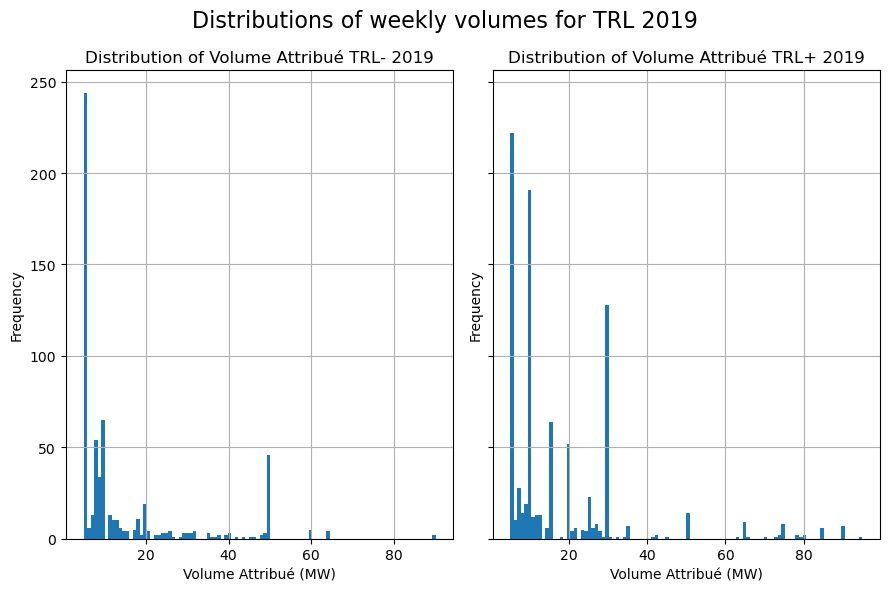

In [20]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)  

axes[0].hist(TPDW19['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2019')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW19['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2019')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL_dist_2019.pdf', format='pdf')
plt.show()


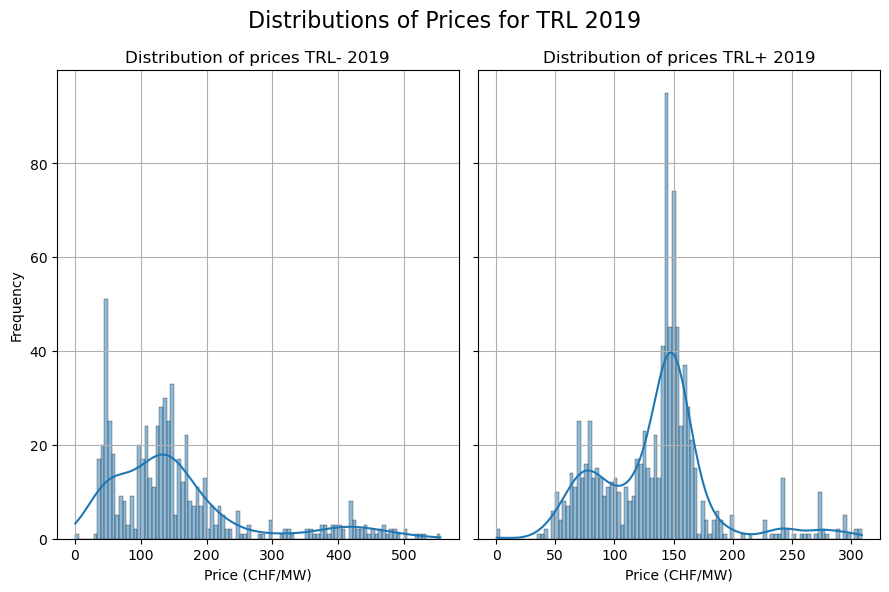

In [21]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW19['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2019')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW19['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2019')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL_dist_prices_2019.pdf', format='pdf')
plt.show()

In [22]:
tmp=TPDW19.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)


,count
Volume_attribué,
5,244
10,65
8,54
50,46
9,34
20,19
11,13
7,13
18,11


In [23]:
tmp=TPUW19.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,222
10,191
30,128
15,64
20,52
7,28
25,23
9,19
8,14


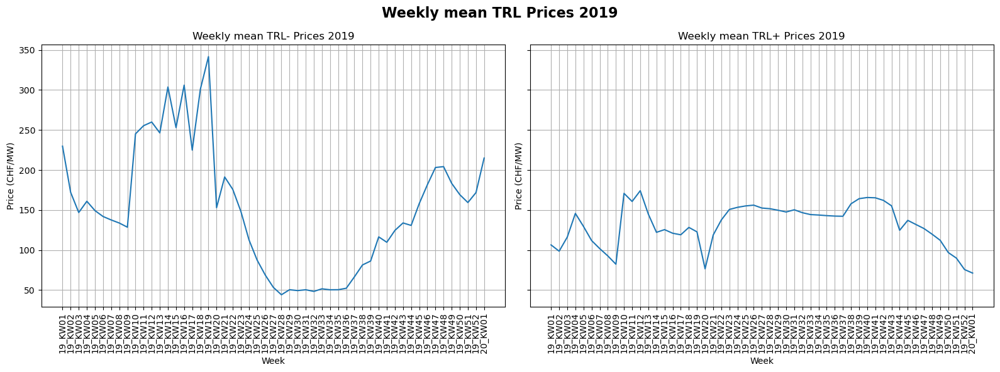

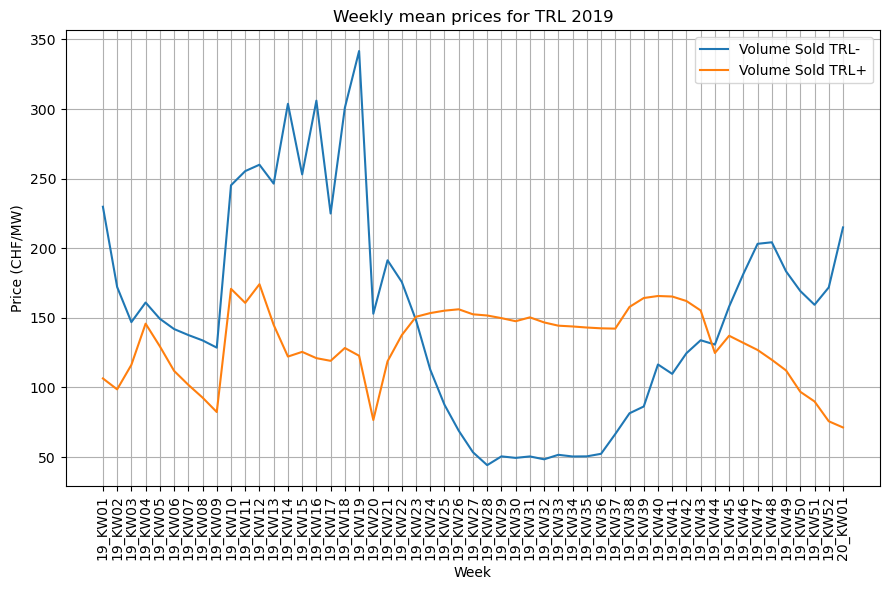

desription of TRL- prices:
 count     53.000000
mean     152.304135
std       78.436459
min       44.150769
25%       86.285714
50%      148.266667
75%      203.161429
max      341.658333
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count     53.000000
mean     131.963616
std       26.313168
min       71.220000
25%      118.778261
50%      137.570435
75%      151.660870
max      174.130000
Name: Prix_prestation, dtype: float64


In [24]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW19.index, grouped_TPDW19['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2019')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW19.index, grouped_TPUW19['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2019')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2019', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW19.index, grouped_TPDW19['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW19.index, grouped_TPUW19['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2019')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2019/Weekly_TRL_Prices_combined_2019.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW19["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW19["Prix_prestation"].describe()}')

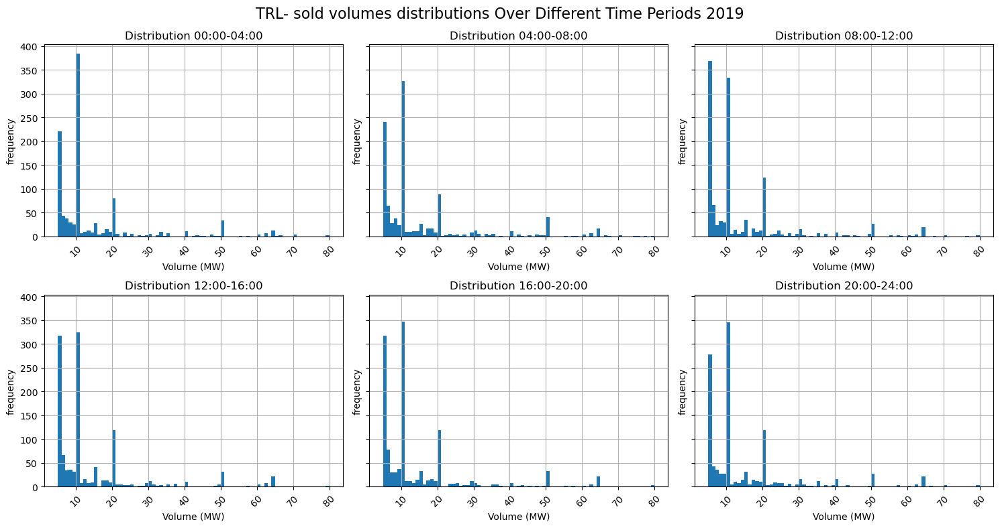

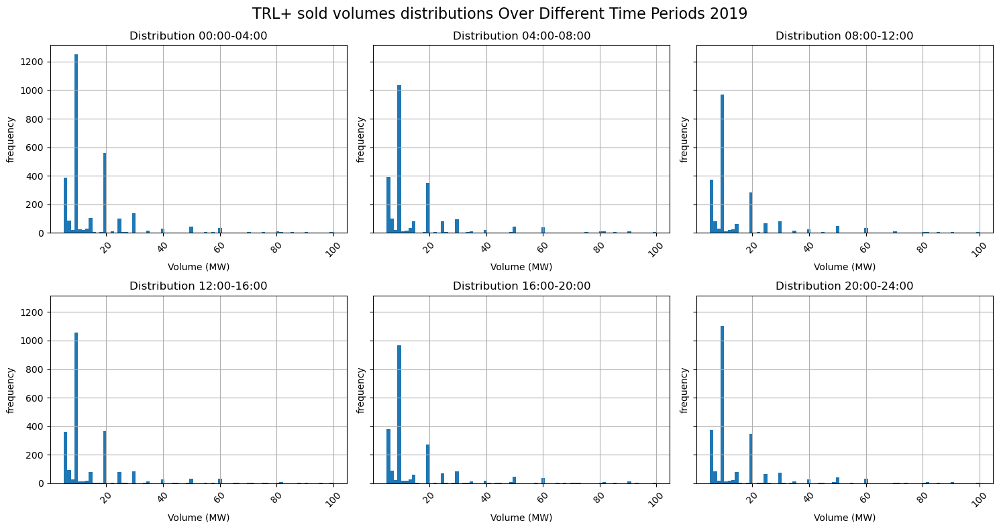

In [25]:
list_TPD19 = [TPD19_00_04, TPD19_04_08, TPD19_08_12, TPD19_12_16, TPD19_16_20, TPD19_20_24]

list_TPU19 = [TPU19_00_04, TPU19_04_08, TPU19_08_12, TPU19_12_16, TPU19_16_20, TPU19_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL-_dist_daily_2019.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL+_dist_daily_2019.pdf', format='pdf')
plt.show()

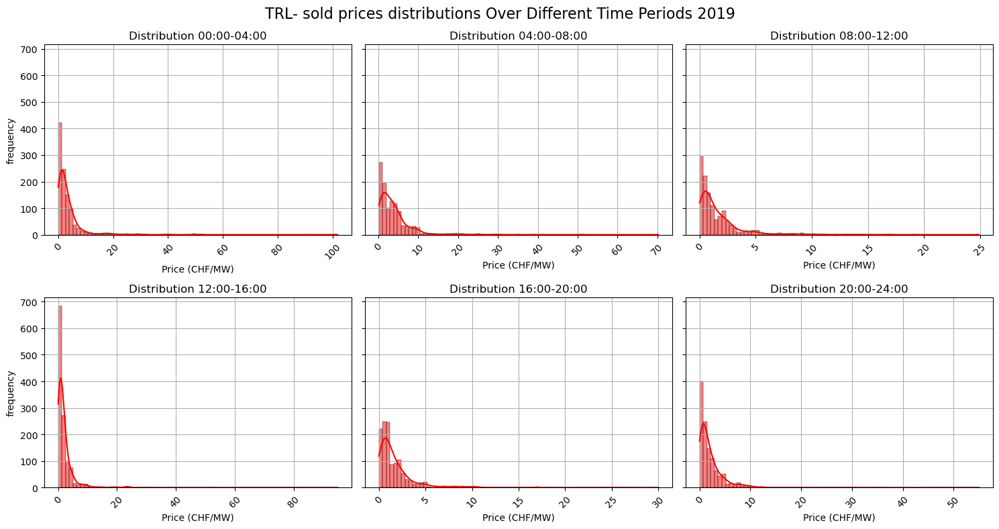

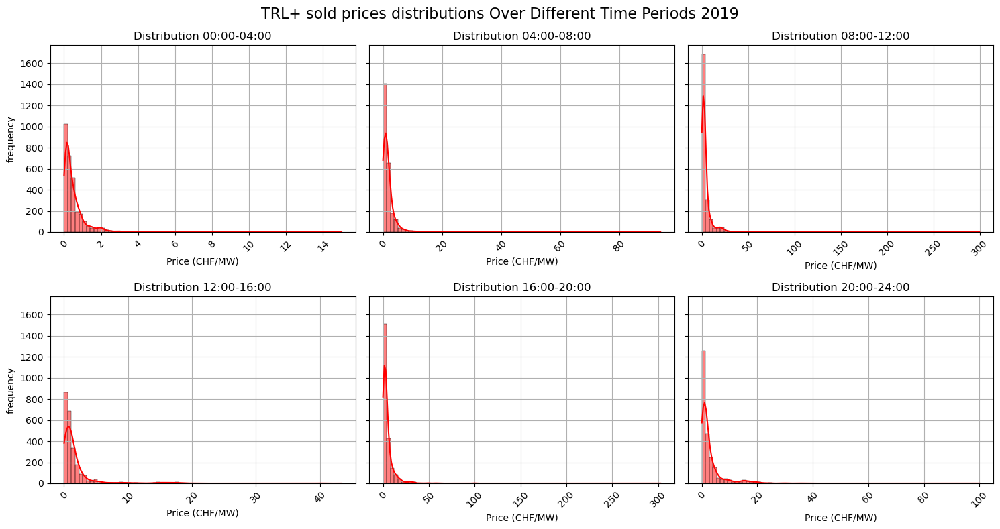

In [26]:
list_TPD19 = [TPD19_00_04, TPD19_04_08, TPD19_08_12, TPD19_12_16, TPD19_16_20, TPD19_20_24]

list_TPU19 = [TPU19_00_04, TPU19_04_08, TPU19_08_12, TPU19_12_16, TPU19_16_20, TPU19_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL-_dist_prices_daily_2019.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL+_dist_prices_daily_2019.pdf', format='pdf')
plt.show()

max_volume=145
max_cost=6238.6


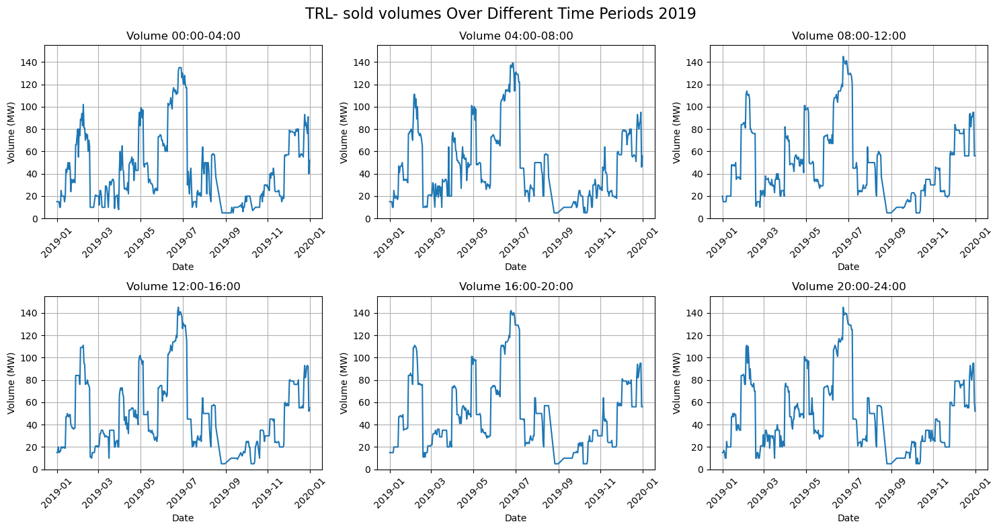

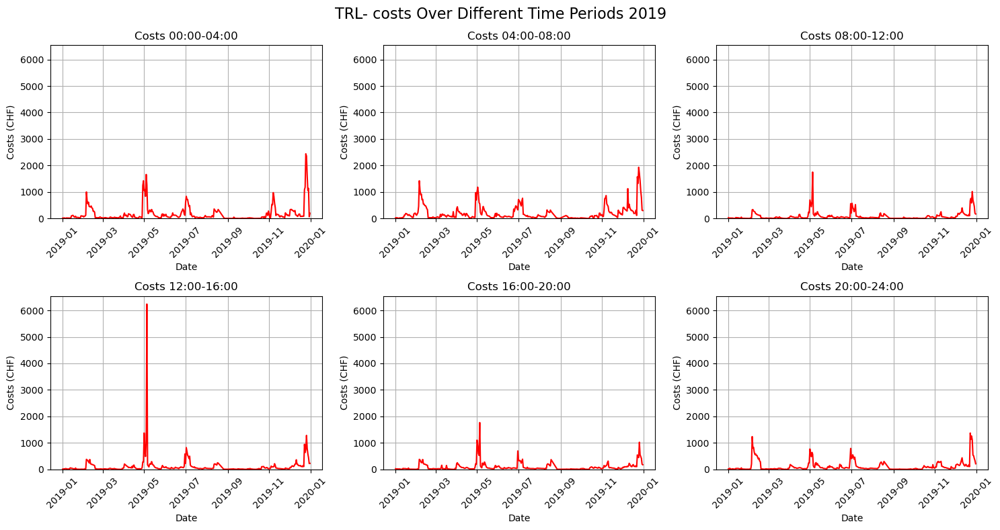

In [27]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()


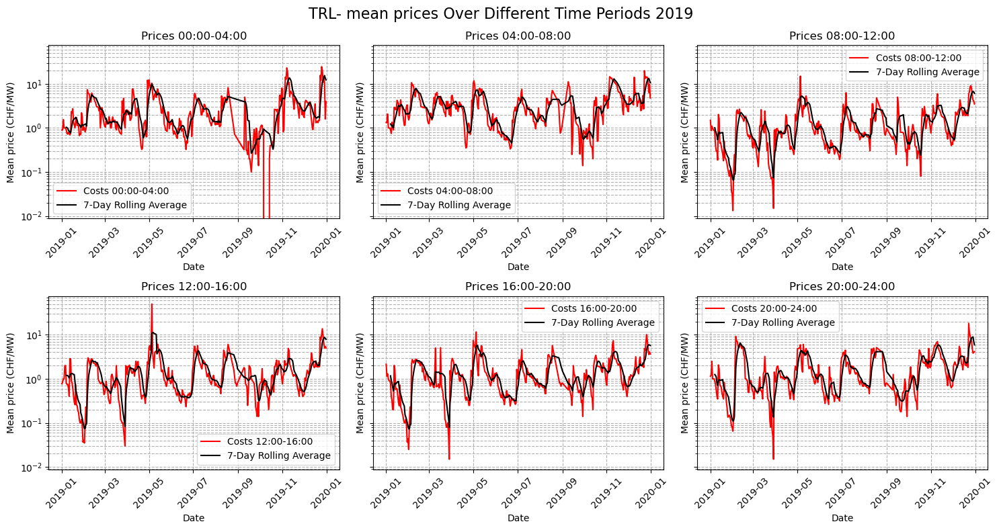

count    334.000000
mean       2.948132
std        3.368244
min        0.000000
25%        0.990000
50%        1.716667
75%        3.777500
max       24.506667
Name: Prix_prestation, dtype: float64

count    347.000000
mean       3.551646
std        3.105282
min        0.140000
25%        1.371000
50%        2.880000
75%        4.595833
max       19.921667
Name: Prix_prestation, dtype: float64

count    349.000000
mean       1.379294
std        1.545804
min        0.013333
25%        0.450000
50%        0.855000
75%        1.900000
max       14.980000
Name: Prix_prestation, dtype: float64

count    347.000000
mean       1.715893
std        3.081103
min        0.030000
25%        0.557500
50%        1.016667
75%        2.043333
max       49.950000
Name: Prix_prestation, dtype: float64

count    349.000000
mean       1.496850
std        1.494632
min        0.015000
25%        0.590000
50%        1.080000
75%        1.900000
max       11.603333
Name: Prix_prestation, dtype: float64

count

In [28]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPD19):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL-_mean_prices_periods_2019.pdf', format='pdf')
plt.show()

for group in grouped_TPD19:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=331
max_cost=11074.1


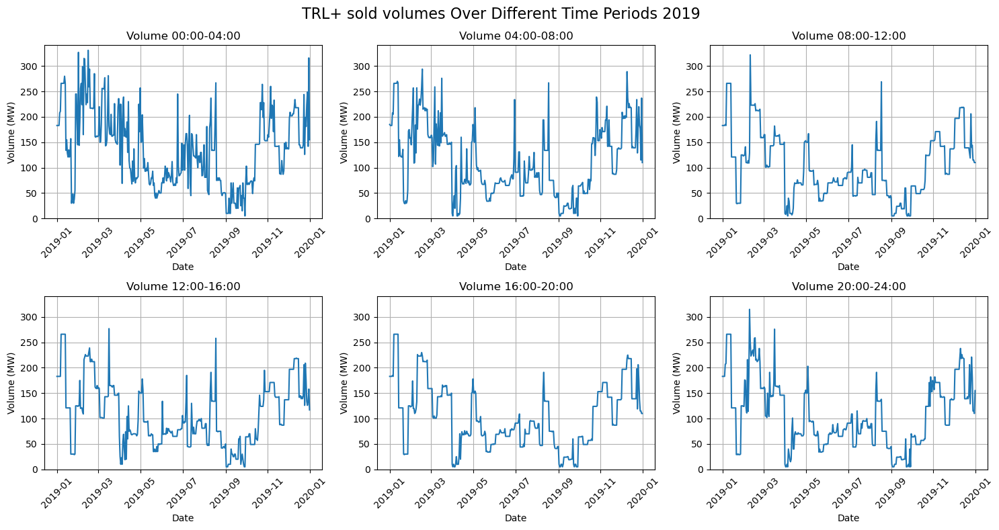

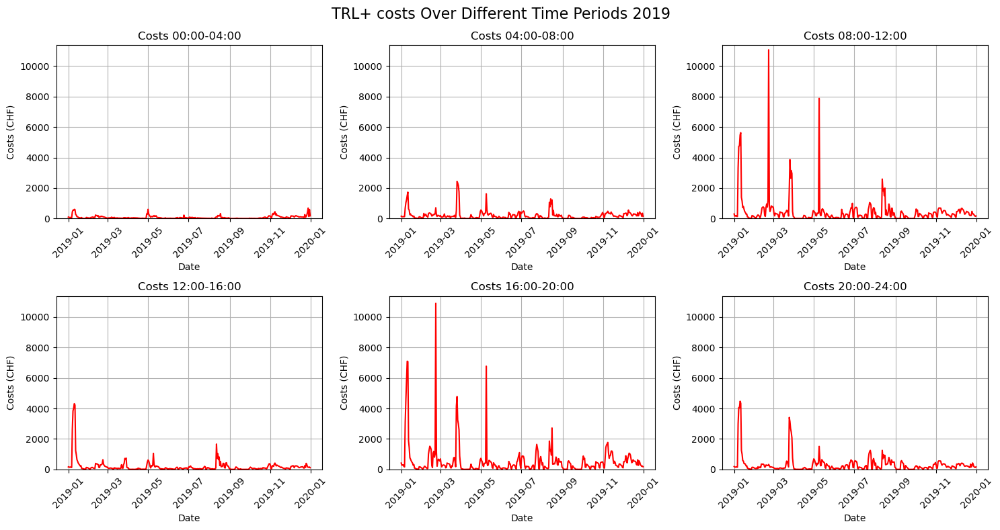

In [29]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU19):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8))

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU19):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.show()


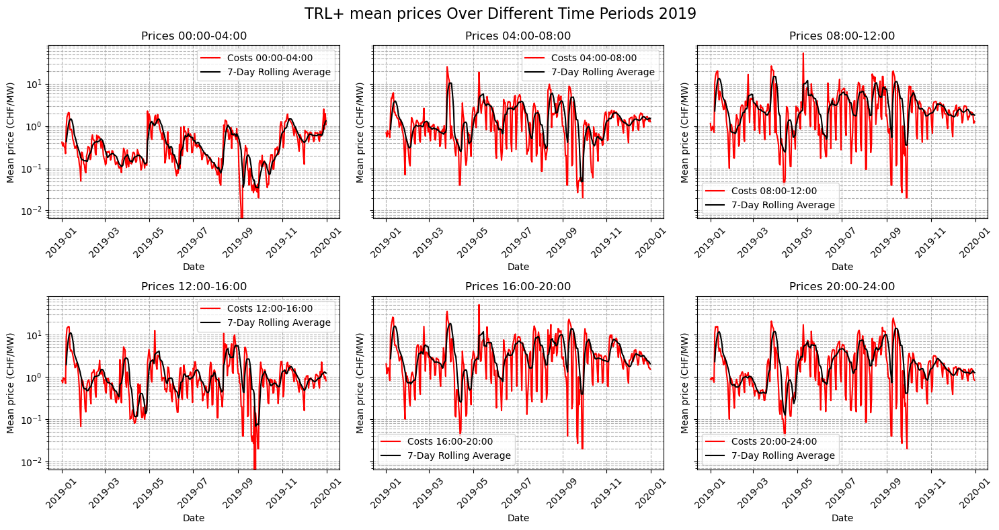

count    365.000000
mean       0.444474
std        0.444245
min        0.000000
25%        0.140000
50%        0.270000
75%        0.617273
max        2.526429
Name: Prix_prestation, dtype: float64

count    365.000000
mean       1.788777
std        2.512227
min        0.020000
25%        0.490000
50%        1.100000
75%        2.010000
max       25.325556
Name: Prix_prestation, dtype: float64

count    365.000000
mean       3.687867
std        4.959297
min        0.020000
25%        0.853333
50%        2.333333
75%        3.973333
max       53.068571
Name: Prix_prestation, dtype: float64

count    365.000000
mean       1.425458
std        2.115523
min        0.000000
25%        0.430000
50%        0.852222
75%        1.481250
max       15.592500
Name: Prix_prestation, dtype: float64

count    365.000000
mean       4.345339
std        5.464759
min        0.020000
25%        1.037500
50%        2.781667
75%        5.041250
max       51.212500
Name: Prix_prestation, dtype: float64

count

In [30]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPU19):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2019', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2019/TRL+_mean_prices_periods_2019.pdf', format='pdf')
plt.show()

for group in grouped_TPU19:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=399
max_cost=69196.20999999999


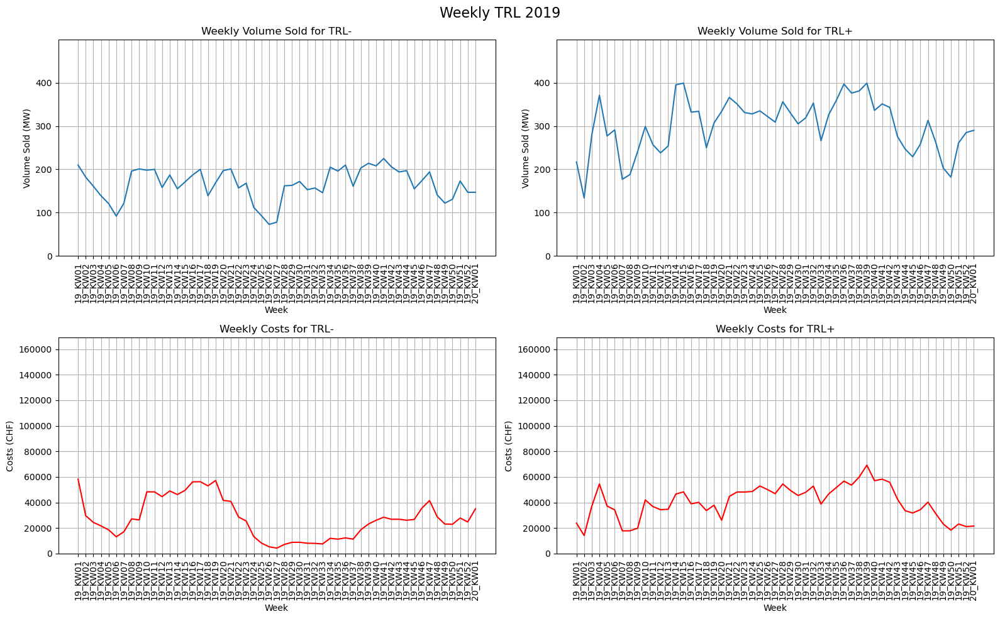

In [31]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW19])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW19])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW19.index, grouped_TPDW19['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW19.index, grouped_TPUW19['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW19.index, grouped_TPDW19['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW19.index, grouped_TPUW19['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2019', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2020

In [32]:
res20=pd.read_csv(DATA+'2020_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res20_CH=res20[res20.Pays=='CH']
print(res20_CH.Description.unique())
res20_CH

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\40055532.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res20=pd.read_csv(DATA+'2020_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


['Primary control Auction' 'Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_20_01_01,Primary control Auction,16,MW,16,MW,50.00,EUR/MW,800.0,EUR,6.21,EUR/MWh*,CH,2.08,EUR/MWh*,Ja
1,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
2,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
3,PRL_20_01_01,Primary control Auction,1,MW,1,MW,80.00,EUR/MW,80.0,EUR,6.21,EUR/MWh*,CH,3.33,EUR/MWh*,Ja
4,PRL_20_01_01,Primary control Auction,1,MW,1,MW,120.00,EUR/MW,120.0,EUR,6.21,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
882783,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,14.00,CHF/MW,0.0,CHF,3.50,CHF/MWh*,CH,3.50,CHF/MWh*,NaN
882784,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,20.00,CHF/MW,0.0,CHF,5.00,CHF/MWh*,CH,5.00,CHF/MWh*,NaN
882785,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,10,MW,2.16,CHF/MW,21.6,CHF,0.54,CHF/MWh*,CH,0.54,CHF/MWh*,NaN
882786,TRL+_20_12_31,Tertiary Power UP 20:00 bis 24:00,50,MW,0,MW,25.00,CHF/MW,0.0,CHF,6.25,CHF/MWh*,CH,6.25,CHF/MWh*,NaN


## Primary control Auction 2020

In [33]:
res20_CH_p=res20_CH[res20_CH['Description'].str.contains('Primary control')].copy()

res20_CH_p['date'] = pd.to_datetime(res20_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p20 = res20_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean', 'Prix_offert':'mean'})

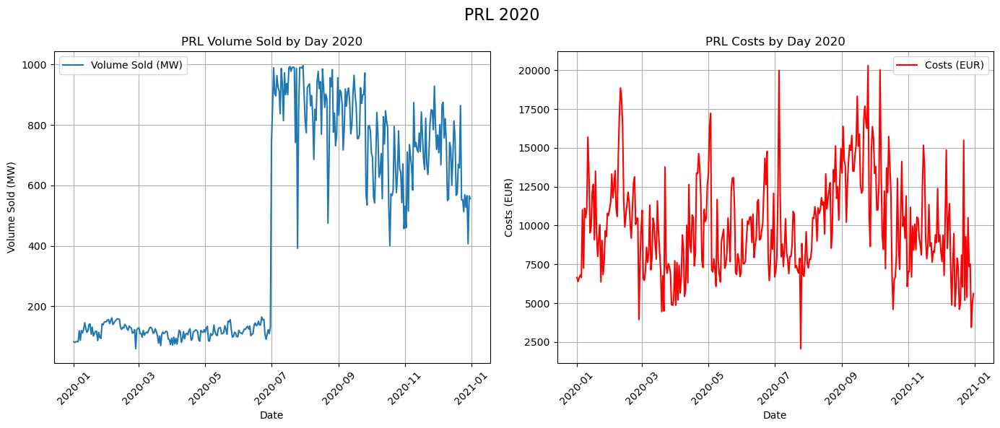

In [34]:

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p20.index, grouped_p20['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2020')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p20.index, grouped_p20['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2020')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2020', fontsize=16)
plt.tight_layout()
plt.show()

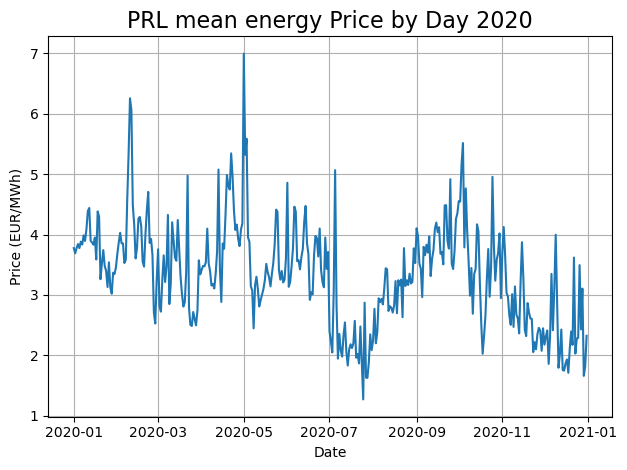

In [35]:
plt.plot(grouped_p20.index, grouped_p20['Prix_offert'])
plt.title('PRL mean energy Price by Day 2020', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Price (EUR/MWh)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
#plt.savefig('./gfx/2020/PRL_mean_price_2020.pdf', format='pdf')

plt.show()



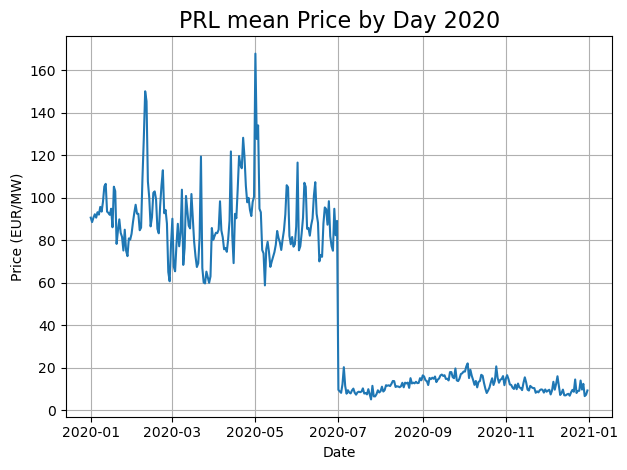

In [36]:
plt.plot(grouped_p20.index, grouped_p20['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2020', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2020/PRL_mean_price_2020.pdf', format='pdf')

plt.show()

In [37]:
grouped_p20['Prix_offert'].describe()

count    366.000000
mean       3.346270
std        0.851116
min        1.272081
25%        2.747324
50%        3.395344
75%        3.852059
max        6.993137
Name: Prix_offert, dtype: float64

In [38]:
grouped_p20['Prix_prestation'].describe()

count    366.000000
mean      50.321159
std       40.486072
min        5.087919
25%       11.741109
50%       21.351217
75%       86.756365
max      167.831373
Name: Prix_prestation, dtype: float64

In [39]:
PRL20_0_4=res20_CH_p[res20_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL20_4_8=res20_CH_p[res20_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL20_8_12=res20_CH_p[res20_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL20_12_16=res20_CH_p[res20_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL20_16_20=res20_CH_p[res20_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL20_20_24=res20_CH_p[res20_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL20_0_4=PRL20_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_4_8=PRL20_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_8_12=PRL20_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_12_16=PRL20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_16_20=PRL20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL20_20_24=PRL20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

max_volume=180, min volume= 47
max_cost=6525.5, min cost= 203.8


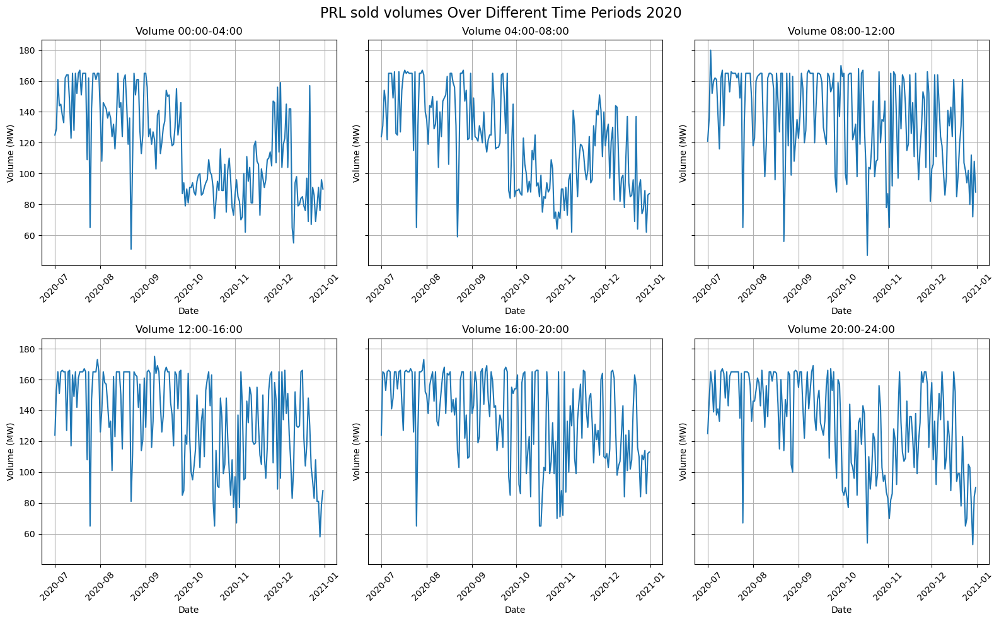

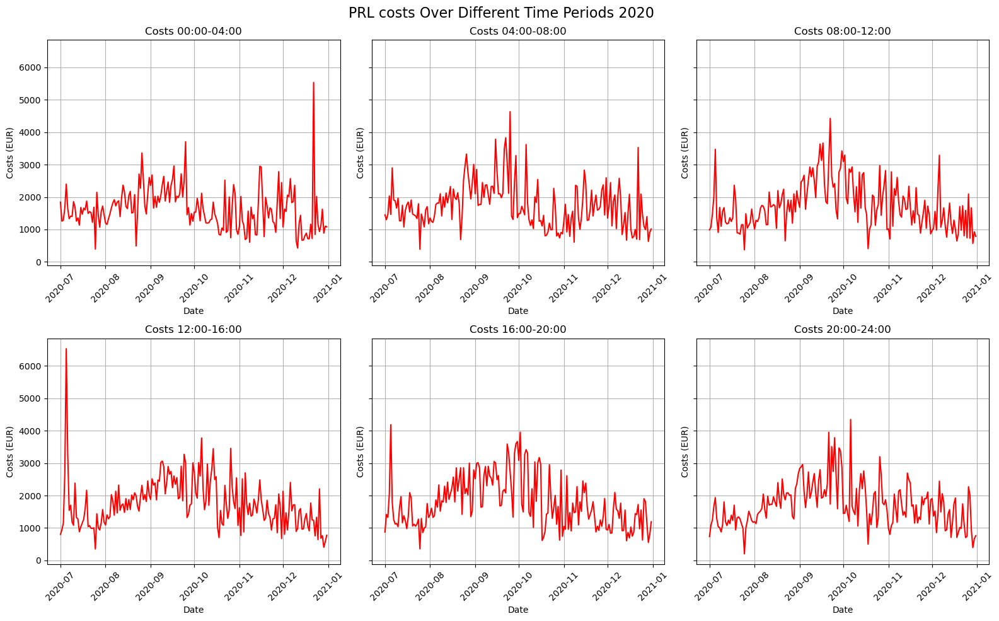

In [40]:
# Grouped data list and labels
grouped_p20 = [grouped_PRL20_0_4, grouped_PRL20_4_8, grouped_PRL20_8_12, grouped_PRL20_12_16, grouped_PRL20_16_20, grouped_PRL20_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p20])
min_cost = min([data['Coûts'].min() for data in grouped_p20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

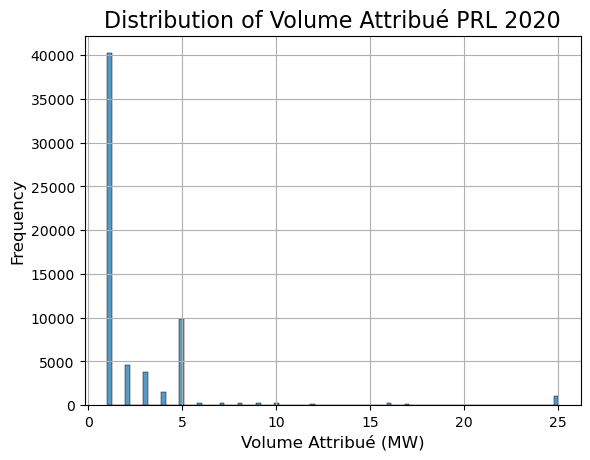

In [41]:
#plt.figure(figsize=(10, 6))
sns.histplot(res20_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2020', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2020/PRL_volume_2020.pdf', format='pdf')
plt.show()

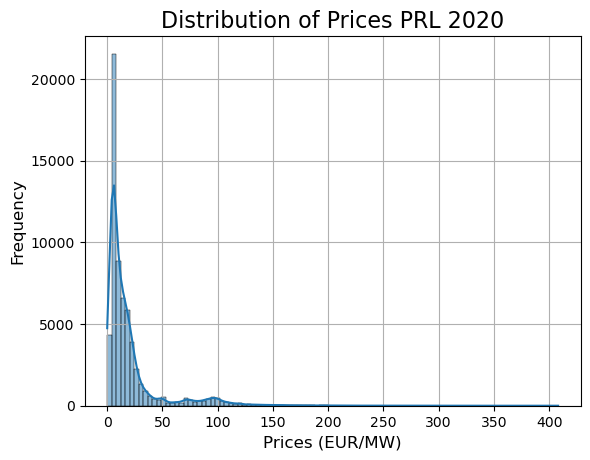

In [42]:
#plt.figure(figsize=(10, 6))
sns.histplot(res20_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2020', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2020/PRL_price_dist_2020.pdf', format='pdf')
plt.show()

In [43]:
tmp=res20_CH_p.groupby('Prix_prestation').agg({'Prix_prestation': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Prix_prestation,
5.0,18282
10.0,1828
0.4,960
12.0,920
20.0,874
0.0,855
8.0,788
16.0,698
1.0,656


In [44]:
tmp.describe()

,count
count,4035.000000
mean,15.619827
std,293.114162
min,1.000000
25%,1.000000
50%,2.000000
75%,4.000000
max,18282.000000


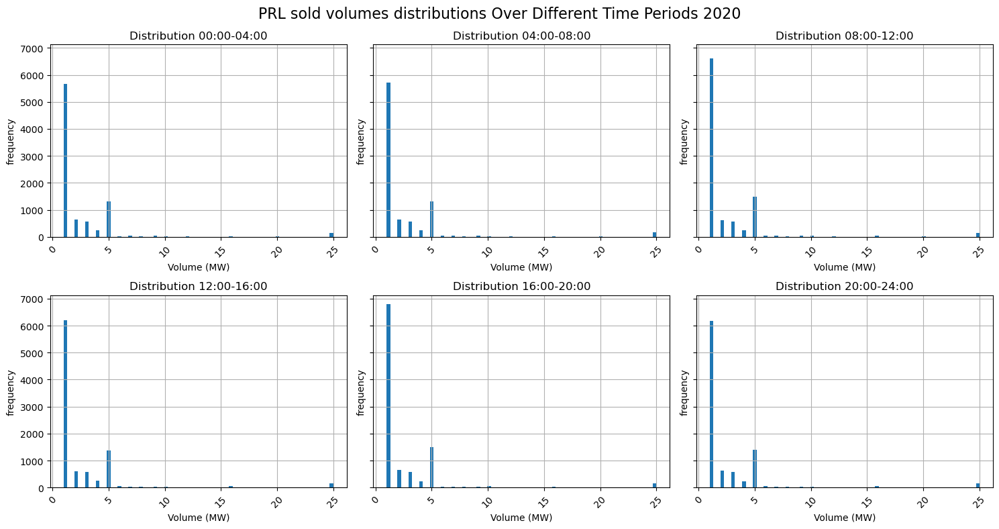

In [45]:

list_PRL20 = [PRL20_0_4, PRL20_4_8, PRL20_8_12, PRL20_12_16, PRL20_16_20, PRL20_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/PRL_volume_distributions_2020.pdf', format='pdf')
plt.show()

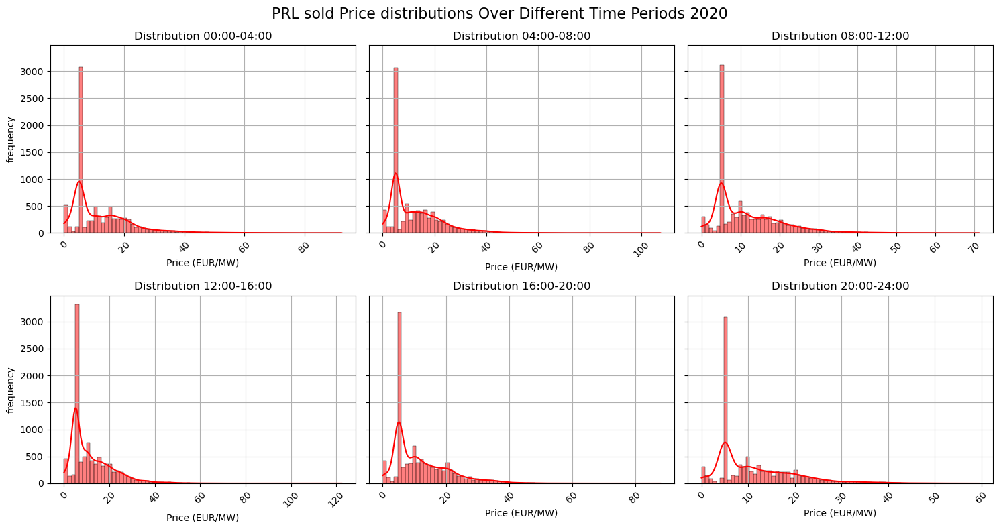

In [46]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, ax=ax, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (EUR/MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold Price distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/PRL_prices_distributions_2020.pdf', format='pdf')
plt.show()

In [47]:
for i, data in enumerate(list_PRL20):
    print(f'{time_labels[i]}:\n{data["Prix_prestation"].value_counts()}\n')

00:00-04:00:
Prix_prestation
5.00     3045
10.00     297
0.40      224
20.00     170
12.00     150
         ... 
18.07       1
18.17       1
18.27       1
18.37       1
18.44       1
Name: count, Length: 945, dtype: int64

04:00-08:00:
Prix_prestation
5.00     3042
10.00     284
12.00     166
20.00     165
0.40      144
         ... 
14.13       1
14.03       1
13.93       1
13.83       1
47.30       1
Name: count, Length: 880, dtype: int64

08:00-12:00:
Prix_prestation
5.00     3042
10.00     313
8.00      149
20.00     145
12.00     145
         ... 
7.11        1
7.21        1
7.31        1
7.41        1
13.05       1
Name: count, Length: 1219, dtype: int64

12:00-16:00:
Prix_prestation
5.00     3062
10.00     333
8.00      176
0.40      144
12.00     131
         ... 
9.75        1
10.05       1
10.15       1
10.25       1
50.44       1
Name: count, Length: 1228, dtype: int64

16:00-20:00:
Prix_prestation
5.00     3057
10.00     303
8.00      161
12.00     158
0.40      146
       

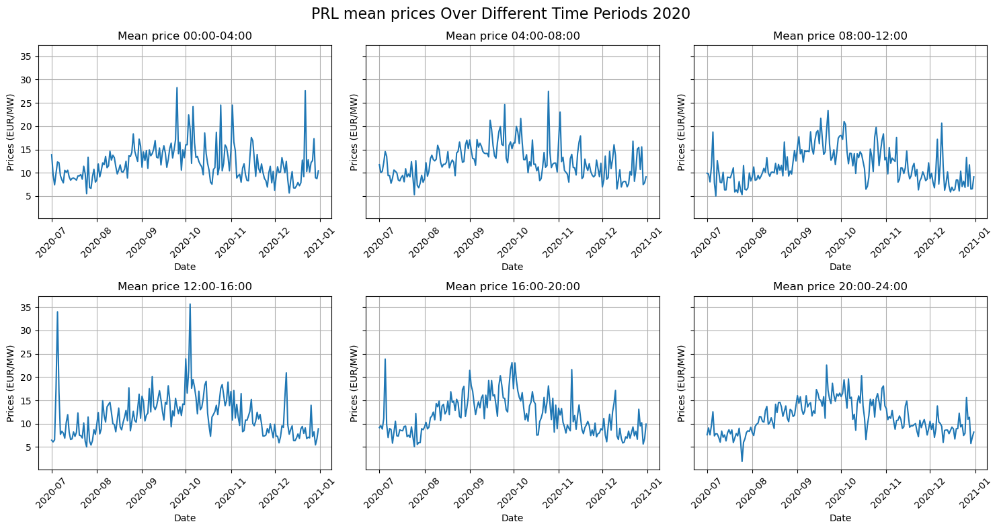

count    184.000000
mean      12.039250
std        3.794585
min        5.510345
25%        9.392648
50%       11.366174
75%       13.800259
max       28.263731
Name: Prix_prestation, dtype: float64
count    184.000000
mean      12.400135
std        3.585600
min        5.296429
25%        9.520629
50%       12.098718
75%       14.552670
max       27.484848
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.531120
std        3.865965
min        5.032222
25%        8.675246
50%       10.815997
75%       14.111130
max       23.340806
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.707434
std        4.508391
min        5.021429
25%        8.270978
50%       10.954441
75%       14.112469
max       35.670769
Name: Prix_prestation, dtype: float64
count    184.000000
mean      11.771464
std        4.028880
min        5.064286
25%        8.687725
50%       11.165206
75%       14.519839
max       23.869481
Name: Prix_prestation, dtype: float64
count    1

In [48]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/2020/PRL_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_p20:
    print(group['Prix_prestation'].describe())

## Secondary control auction 2020

In [49]:
# Create DataFrame for Secondary control
res20_CH_s = res20_CH[res20_CH['Description'].str.contains('Secondary control')].copy()

res20_CH_s['Week'] = res20_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL20m=res20_CH_s[res20_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL20p=res20_CH_s[res20_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL20m=SRL20m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation': 'mean'})
grouped_SRL20p=SRL20p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation': 'mean'})

grouped_SRL20=[grouped_SRL20m, grouped_SRL20p]

In [50]:
SRL20m

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,Week
817545,SRL_20_KW01,Secondary control Auction SRL-,20,MW,20,MW,3025.0,CHF/MW,60500.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817546,SRL_20_KW01,Secondary control Auction SRL-,10,MW,10,MW,3025.0,CHF/MW,30250.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817547,SRL_20_KW01,Secondary control Auction SRL-,6,MW,6,MW,3025.0,CHF/MW,18150.0,CHF,18.01,CHF/MWh*,CH,18.01,CHF/MWh*,NaN,SRL_20_KW01
817548,SRL_20_KW01,Secondary control Auction SRL-,5,MW,5,MW,3192.0,CHF/MW,15960.0,CHF,19.00,CHF/MWh*,CH,19.00,CHF/MWh*,NaN,SRL_20_KW01
817549,SRL_20_KW01,Secondary control Auction SRL-,5,MW,5,MW,2688.0,CHF/MW,13440.0,CHF,16.00,CHF/MWh*,CH,16.00,CHF/MWh*,NaN,SRL_20_KW01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
819111,SRL_20_KW53,Secondary control Auction SRL-,10,MW,10,MW,2455.0,CHF/MW,24550.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819112,SRL_20_KW53,Secondary control Auction SRL-,10,MW,10,MW,2455.0,CHF/MW,24550.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819113,SRL_20_KW53,Secondary control Auction SRL-,6,MW,6,MW,2455.0,CHF/MW,14730.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53
819114,SRL_20_KW53,Secondary control Auction SRL-,5,MW,5,MW,2455.0,CHF/MW,12275.0,CHF,14.61,CHF/MWh*,CH,14.61,CHF/MWh*,NaN,SRL_20_KW53


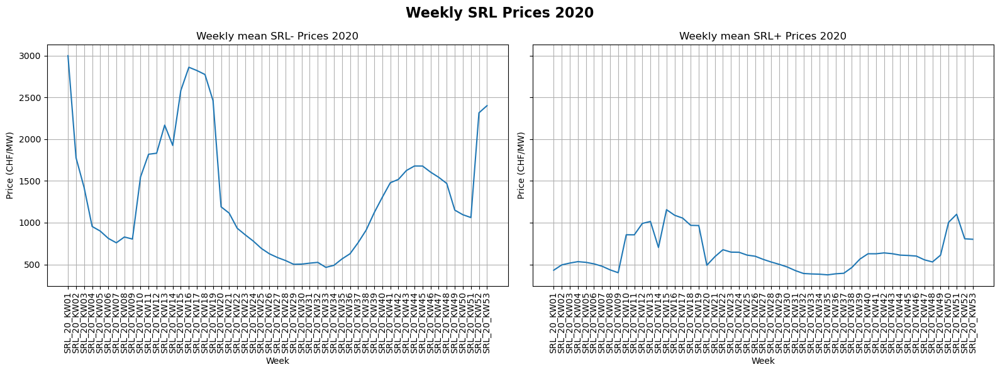

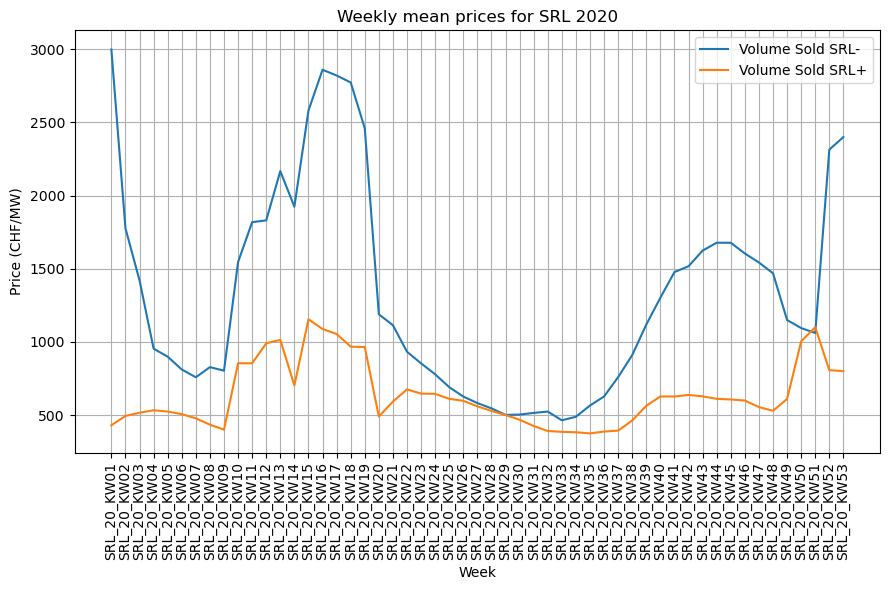

desription of SRL- prices:
 count      53.000000
mean     1325.482764
std       719.201391
min       464.923077
25%       760.218182
50%      1119.095238
75%      1678.178000
max      2997.866667
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean      638.068242
std       216.870369
min       375.480000
25%       490.438571
50%       598.120000
75%       703.363636
max      1155.240000
Name: Prix_prestation, dtype: float64


In [51]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL20m.index, grouped_SRL20m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2020')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL20p.index, grouped_SRL20p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2020')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2020', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig('./gfx/2020/Weekly_SRL_Prices_2020.pdf', format='pdf')
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL20m.index, grouped_SRL20m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL20p.index, grouped_SRL20p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2020')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2020/Weekly_SRL_Prices_combined_2020.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL20m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL20p["Prix_prestation"].describe()}')


max_volume=446, min volume= 361
max_cost=1234101.5, min cost= 139319.72


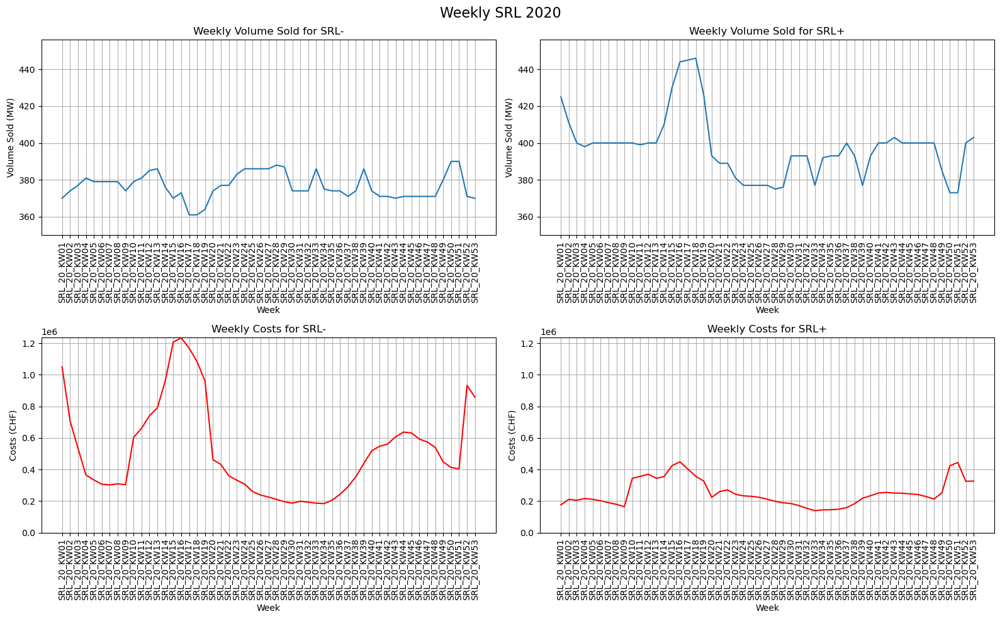

In [52]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL20])
min_cost = min([data['Coûts'].min() for data in grouped_SRL20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL20m.index, grouped_SRL20m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL20p.index, grouped_SRL20p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL20m.index, grouped_SRL20m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL20p.index, grouped_SRL20p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2020', fontsize=16)
plt.tight_layout()
plt.show()


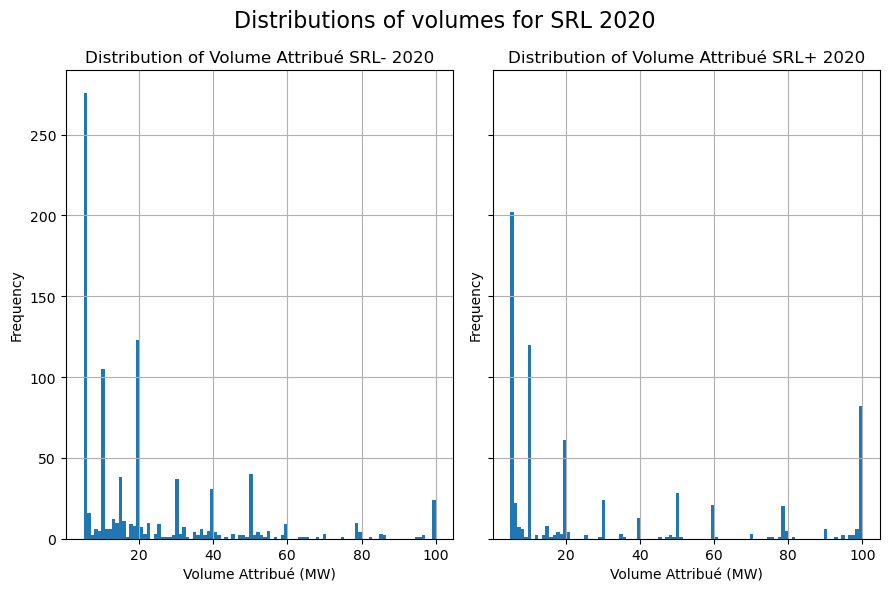

In [53]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True) #
axes[0].hist(SRL20m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2020')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL20p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2020')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/SRL_dist_2020.pdf', format='pdf')
plt.show()

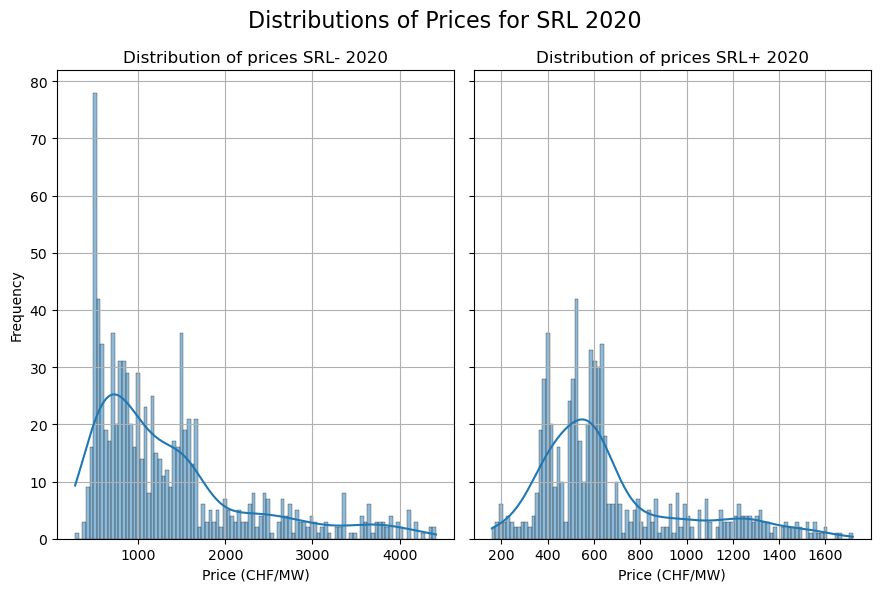

In [54]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL20m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2020')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL20p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2020')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/SRL_dist_prices_2020.pdf', format='pdf')
plt.show()

In [55]:
tmp=SRL20m.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,276
20,123
10,105
50,40
15,38
30,37
40,31
100,24
6,16


In [56]:
tmp=SRL20p.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,202
10,120
100,82
20,61
50,28
30,24
6,22
60,21
79,20


In [57]:
SRL20m['Volume_attribué'].describe()

count    906.000000
mean      22.033113
std       22.297759
min        5.000000
25%        5.000000
50%       15.000000
75%       30.000000
max      100.000000
Name: Volume_attribué, dtype: float64

In [58]:
SRL20p['Volume_attribué'].describe()

count    678.000000
mean      31.089971
std       34.278499
min        5.000000
25%        5.000000
50%       10.000000
75%       50.000000
max      100.000000
Name: Volume_attribué, dtype: float64

## Tertiary control auction 2020

In [59]:
# Create DataFrame for Tertiary control
res20_CH_t = res20_CH[res20_CH['Description'].str.contains('Tertiary Power')].copy()
res20_CH_t= res20_CH_t[res20_CH_t['Volume_attribué'] != 0]

TPDW20=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW20=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP'].copy()
TPD20_00_04=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD20_04_08=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD20_08_12=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD20_12_16=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD20_16_20=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD20_20_24=res20_CH_t[res20_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU20_00_04=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU20_04_08=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU20_08_12=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU20_12_16=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU20_16_20=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU20_20_24=res20_CH_t[res20_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW20['Week']=TPDW20['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW20['Week']=TPUW20['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW20=TPDW20.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPUW20=TPUW20.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

TPD20_00_04['date'] = pd.to_datetime(TPD20_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_04_08['date'] = pd.to_datetime(TPD20_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_08_12['date'] = pd.to_datetime(TPD20_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_12_16['date'] = pd.to_datetime(TPD20_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_16_20['date'] = pd.to_datetime(TPD20_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD20_20_24['date'] = pd.to_datetime(TPD20_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU20_00_04['date'] = pd.to_datetime(TPU20_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_04_08['date'] = pd.to_datetime(TPU20_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_08_12['date'] = pd.to_datetime(TPU20_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_12_16['date'] = pd.to_datetime(TPU20_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_16_20['date'] = pd.to_datetime(TPU20_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU20_20_24['date'] = pd.to_datetime(TPU20_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD20_00_04=TPD20_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_04_08=TPD20_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_08_12=TPD20_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_12_16=TPD20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_16_20=TPD20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD20_20_24=TPD20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_TPU20_00_04=TPU20_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_04_08=TPU20_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_08_12=TPU20_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_12_16=TPU20_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_16_20=TPU20_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU20_20_24=TPU20_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD20 = [grouped_TPD20_00_04, grouped_TPD20_04_08, grouped_TPD20_08_12, grouped_TPD20_12_16, grouped_TPD20_16_20, grouped_TPD20_20_24]

grouped_TPU20 = [grouped_TPU20_00_04, grouped_TPU20_04_08, grouped_TPU20_08_12, grouped_TPU20_12_16, grouped_TPU20_16_20, grouped_TPU20_20_24]

grouped_TPW20=[grouped_TPDW20, grouped_TPUW20]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

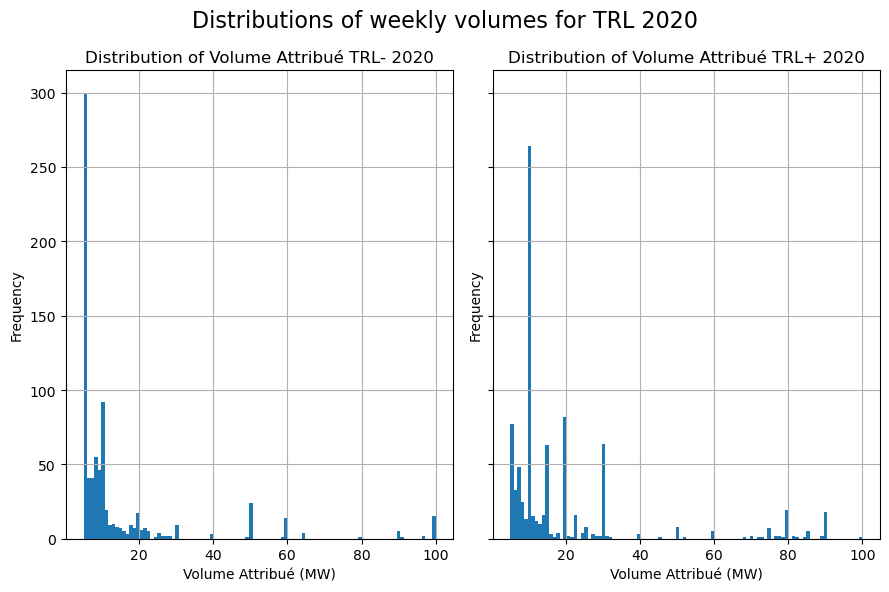

In [60]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)  

axes[0].hist(TPDW20['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2020')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW20['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2020')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL_dist_2020.pdf', format='pdf')
plt.show()


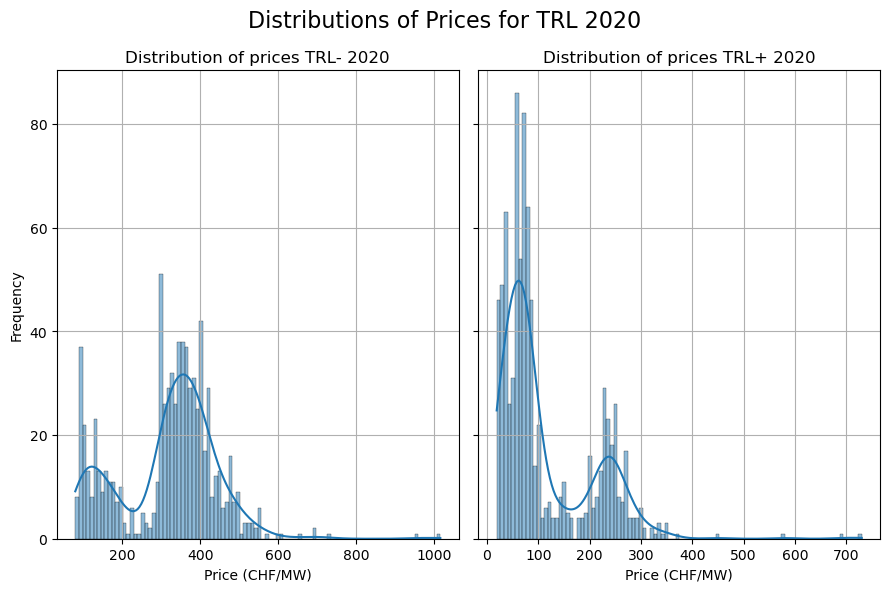

In [61]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW20['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2020')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW20['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2020')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL_dist_prices_2020.pdf', format='pdf')
plt.show()

In [62]:
tmp=TPDW20.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)


,count
Volume_attribué,
5,300
10,92
8,55
9,46
7,41
6,41
50,24
11,19
20,17


In [63]:
tmp=TPUW20.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
10,264
20,82
5,77
30,64
15,63
7,48
6,33
8,25
80,19


In [64]:
TPUW20['Volume_attribué'].describe()

count    855.000000
mean      19.360234
std       20.337868
min        5.000000
25%       10.000000
50%       10.000000
75%       20.000000
max      100.000000
Name: Volume_attribué, dtype: float64

In [65]:
TPDW20['Volume_attribué'].describe()

count    778.000000
mean      14.173522
std       18.971481
min        5.000000
25%        5.000000
50%        8.000000
75%       11.000000
max      100.000000
Name: Volume_attribué, dtype: float64

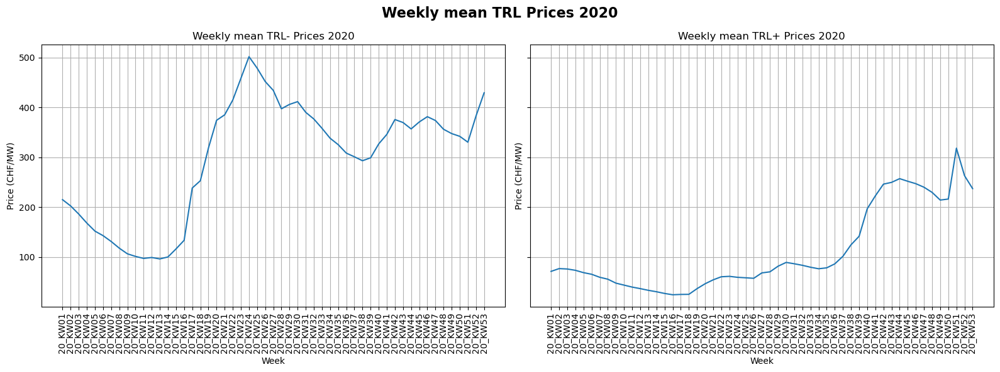

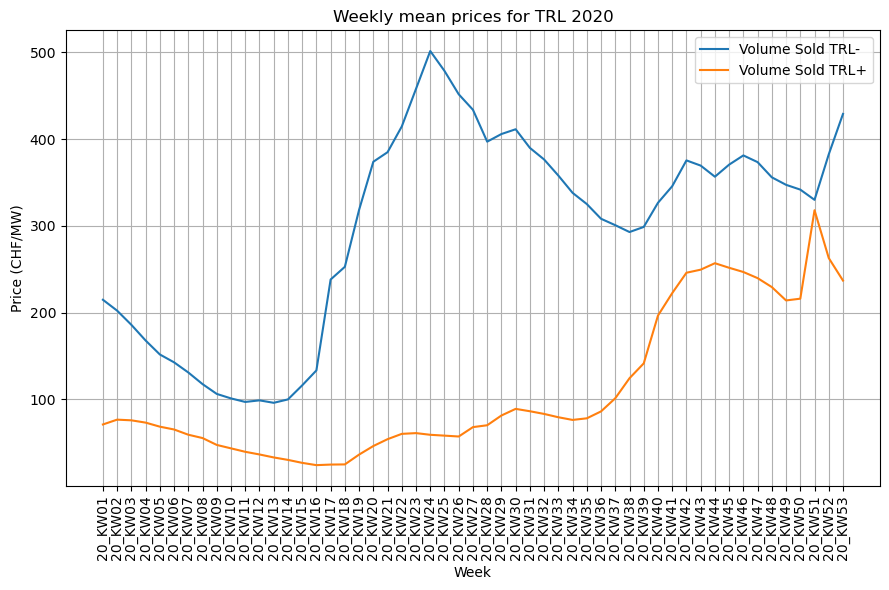

desription of TRL- prices:
 count     53.000000
mean     297.403949
std      119.702979
min       96.175556
25%      186.051667
50%      338.156000
75%      381.280000
max      501.573684
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count     53.000000
mean     110.736826
std       83.750816
min       24.346250
25%       55.570000
50%       75.992500
75%      196.723913
max      318.128235
Name: Prix_prestation, dtype: float64


In [66]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW20.index, grouped_TPDW20['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2020')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW20.index, grouped_TPUW20['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2020')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2020', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW20.index, grouped_TPDW20['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW20.index, grouped_TPUW20['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2020')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2020/Weekly_TRL_Prices_combined_2020.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW20["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW20["Prix_prestation"].describe()}')

In [67]:
grouped_TPU20_00_04#.head(30)

,Volume_attribué,Coûts,Prix_prestation
date,,,
2020-01-01,207,191.82,0.930833
2020-01-02,224,182.42,0.748333
2020-01-03,224,152.46,0.635000
2020-01-04,247,132.75,0.693333
2020-01-05,273,223.75,0.815625
...,...,...,...
2020-12-27,40,0.30,0.007500
2020-12-28,136,58.74,0.270833
2020-12-29,131,58.54,0.291818


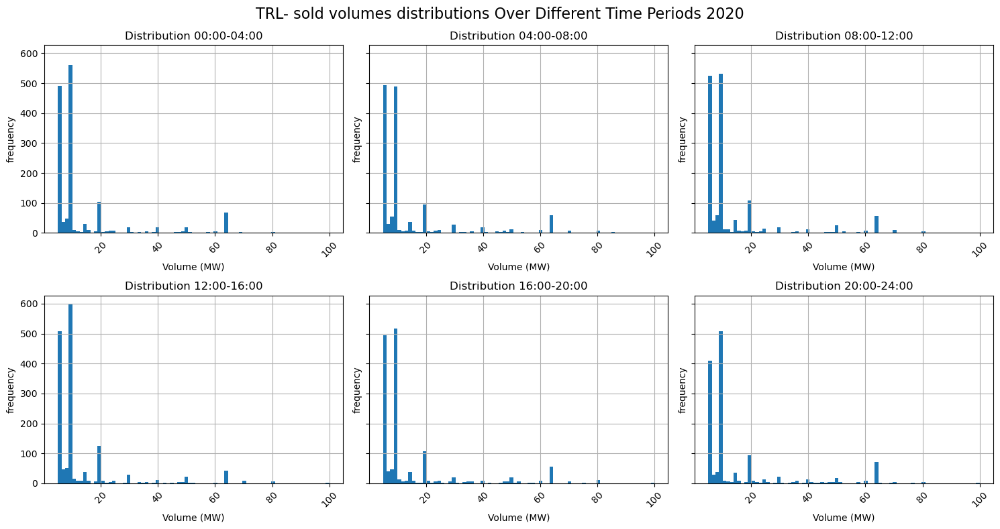

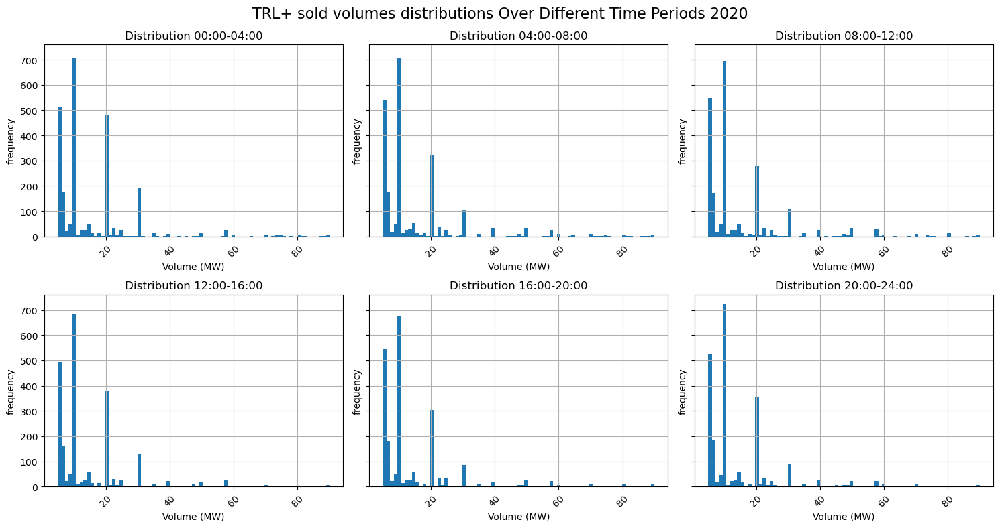

In [68]:
list_TPD20 = [TPD20_00_04, TPD20_04_08, TPD20_08_12, TPD20_12_16, TPD20_16_20, TPD20_20_24]

list_TPU20 = [TPU20_00_04, TPU20_04_08, TPU20_08_12, TPU20_12_16, TPU20_16_20, TPU20_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL-_dist_daily_2020.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL+_dist_daily_2020.pdf', format='pdf')
plt.show()

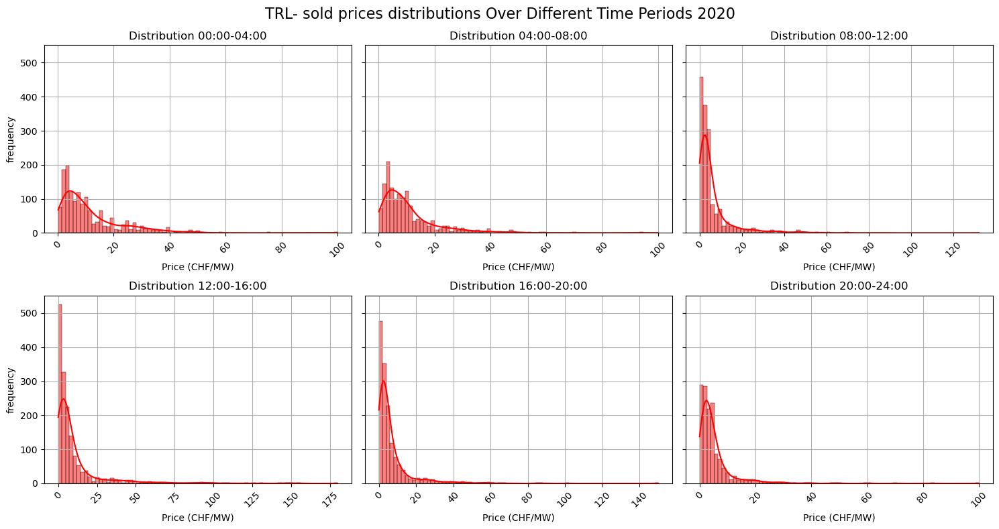

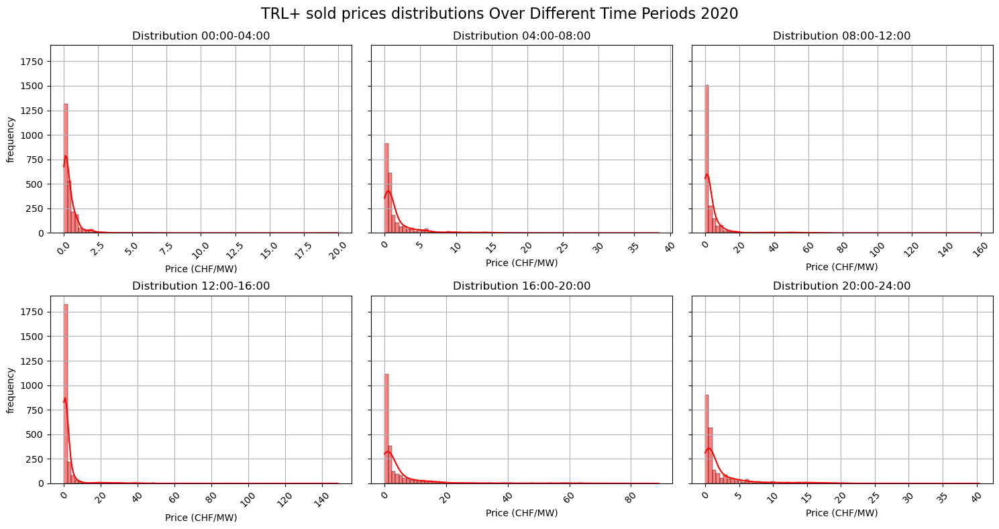

In [69]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL-_dist_prices_daily_2020.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL+_dist_prices_daily_2020.pdf', format='pdf')
plt.show()

max_volume=214, min volume= 5
max_cost=20027.7, min cost= 0.0


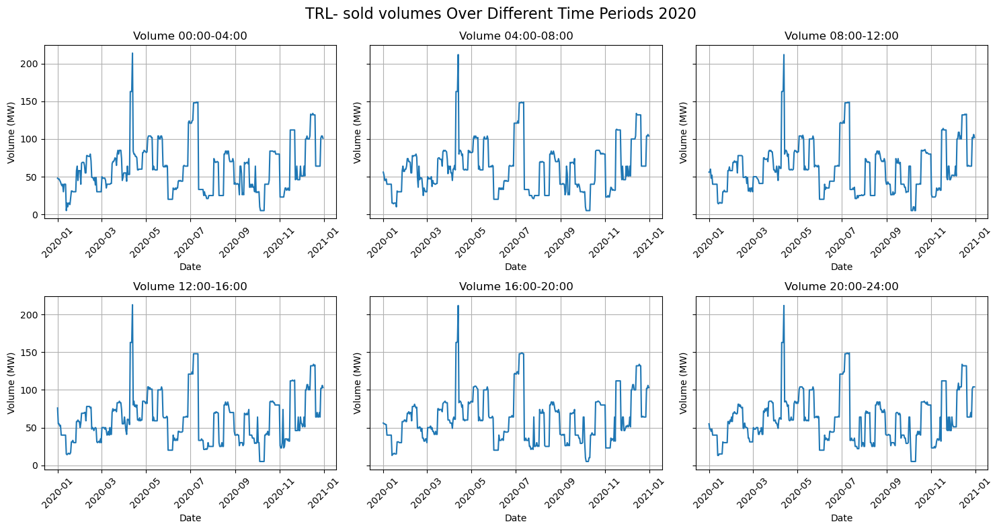

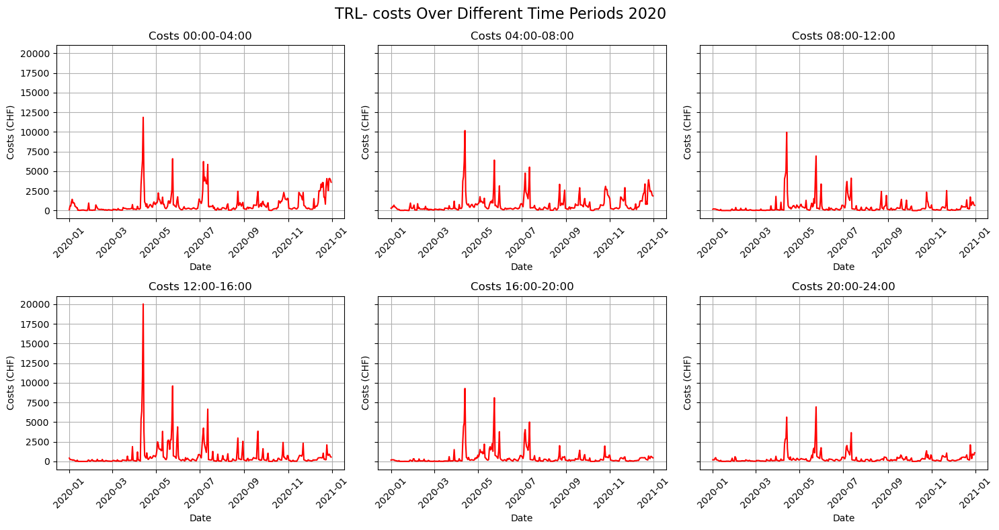

In [70]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPD20])
min_cost = min([data['Coûts'].min() for data in grouped_TPD20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()


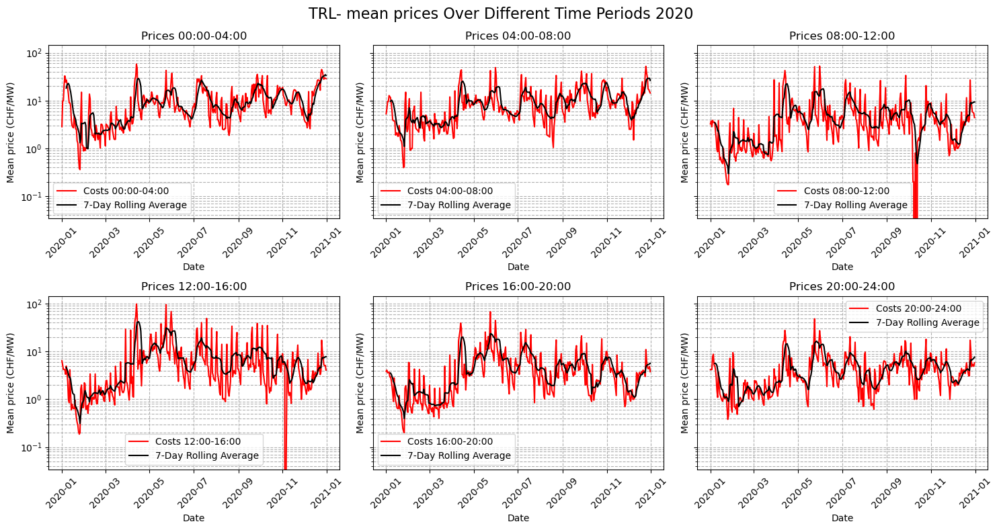

count    365.000000
mean      10.263161
std        8.941240
min        0.360000
25%        3.900000
50%        8.000000
75%       13.393333
max       58.086923
Name: Prix_prestation, dtype: float64

count    366.000000
mean       9.578795
std        8.437356
min        0.396667
25%        3.908222
50%        7.355500
75%       11.824722
max       52.200000
Name: Prix_prestation, dtype: float64

count    366.000000
mean       5.012307
std        6.811026
min        0.000000
25%        1.253333
50%        3.144667
75%        5.548452
max       52.800000
Name: Prix_prestation, dtype: float64

count    366.000000
mean       7.490698
std       11.609799
min        0.000000
25%        1.698125
50%        3.933333
75%        7.727500
max       98.710000
Name: Prix_prestation, dtype: float64

count    366.000000
mean       5.086239
std        6.638892
min        0.200000
25%        1.291500
50%        3.265000
75%        6.000000
max       68.028750
Name: Prix_prestation, dtype: float64

count

In [71]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPD20):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL-_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_TPD20:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=390, min volume= 5
max_cost=17154.13, min cost= 0.0


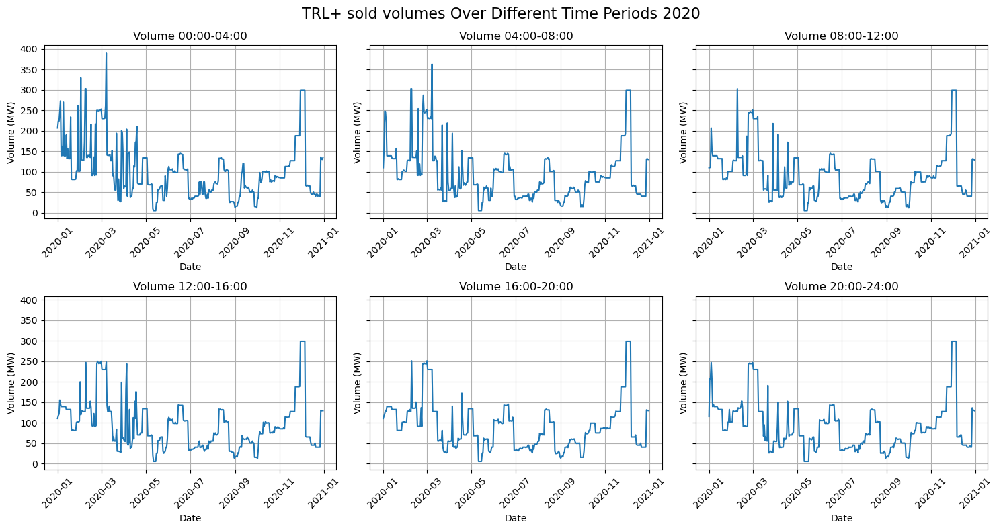

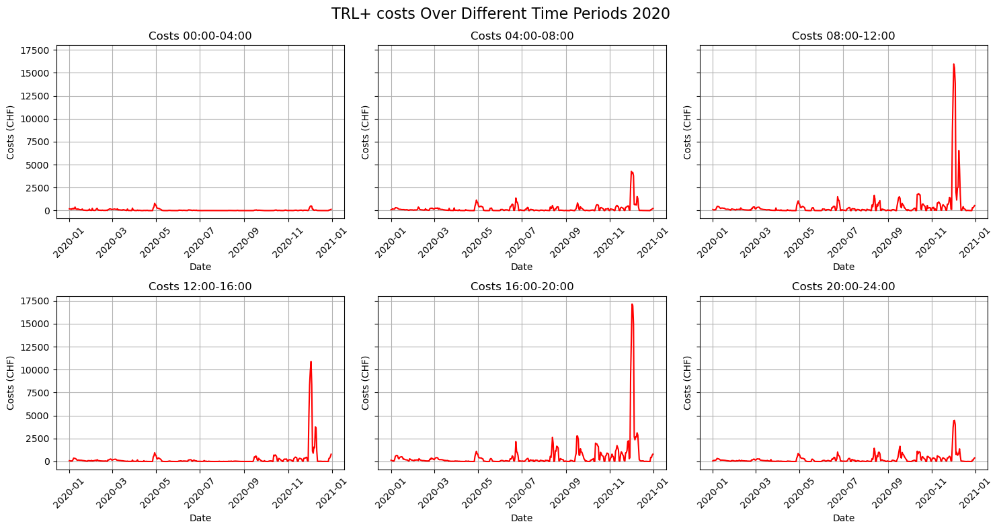

In [72]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPU20])
min_cost = min([data['Coûts'].min() for data in grouped_TPU20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU20):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU20):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.show()


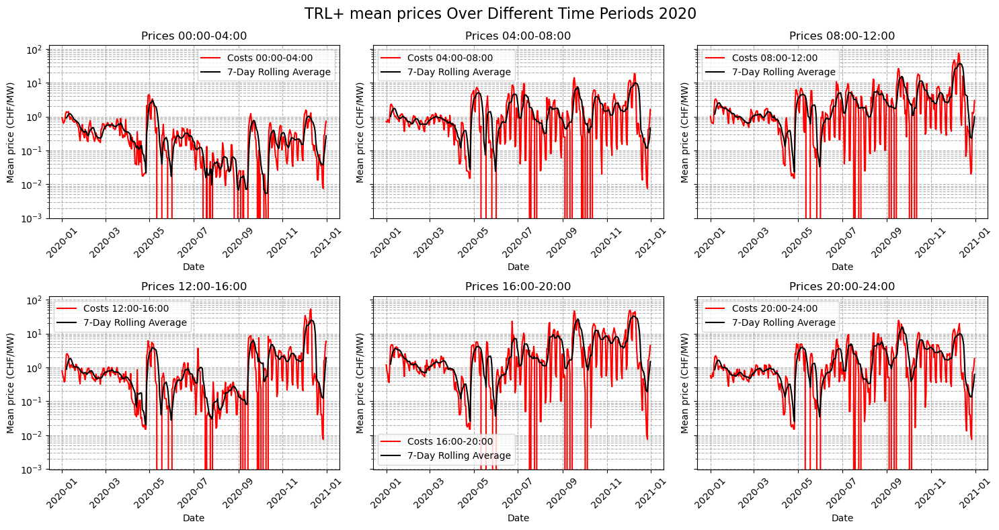

count    366.000000
mean       0.352855
std        0.554614
min        0.000000
25%        0.040000
50%        0.189333
75%        0.455417
max        4.477500
Name: Prix_prestation, dtype: float64

count    366.000000
mean       1.673871
std        2.574234
min        0.000000
25%        0.235000
50%        0.782167
75%        1.860000
max       18.830000
Name: Prix_prestation, dtype: float64

count    366.000000
mean       3.703482
std        7.836412
min        0.000000
25%        0.460938
50%        1.328173
75%        3.764583
max       74.875714
Name: Prix_prestation, dtype: float64

count    366.000000
mean       1.763714
std        5.154615
min        0.000000
25%        0.160000
50%        0.485833
75%        1.015312
max       53.565000
Name: Prix_prestation, dtype: float64

count    366.000000
mean       4.363426
std        7.968356
min        0.000000
25%        0.530357
50%        1.412500
75%        4.445786
max       49.459333
Name: Prix_prestation, dtype: float64

count

In [73]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True) 

for i, data in enumerate(grouped_TPU20):
    ax = axes_costs[i // 3, i % 3]  
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2020', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2020/TRL+_mean_prices_periods_2020.pdf', format='pdf')
plt.show()

for group in grouped_TPU20:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=396, min volume= 81
max_cost=144086.3, min cost= 6233.66


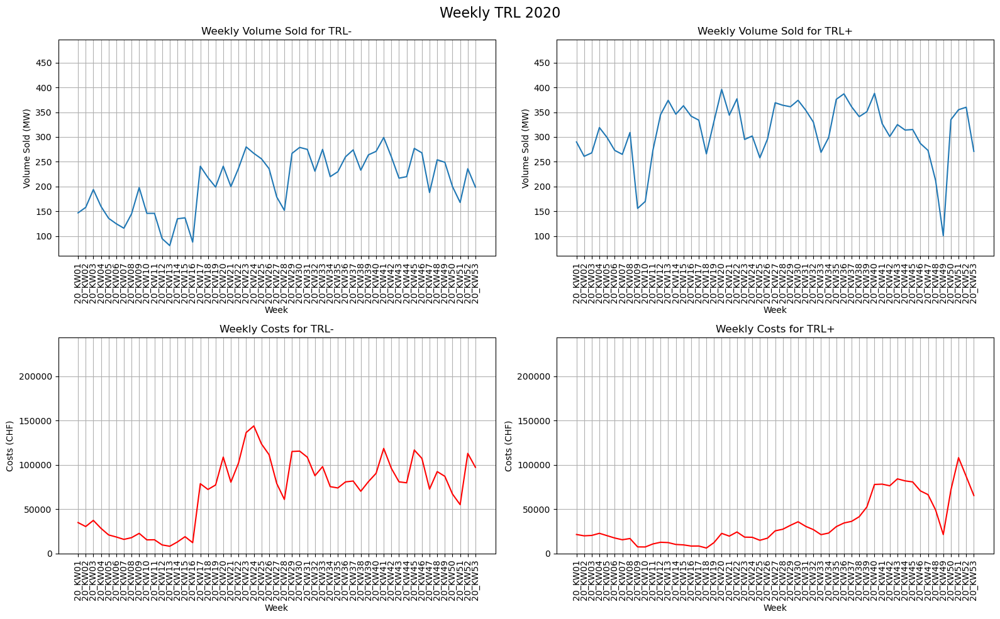

In [74]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW20])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW20])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_TPW20])
min_cost = min([data['Coûts'].min() for data in grouped_TPW20])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (60, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW20.index, grouped_TPDW20['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW20.index, grouped_TPUW20['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW20.index, grouped_TPDW20['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW20.index, grouped_TPUW20['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2020', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2021

In [75]:
res21=pd.read_csv(DATA+'2021_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
print(res21.Description.unique())   
res21

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1096773413.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res21=pd.read_csv(DATA+'2021_PRL_SRL_TRL_Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
1,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
2,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
3,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
4,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
827223,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.68,CHF/MW,0.0,CHF,1.42,CHF/MWh*,CH,1.42,CHF/MWh*,NaN
827224,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN
827225,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,6.88,CHF/MW,0.0,CHF,1.72,CHF/MWh*,CH,1.72,CHF/MWh*,NaN
827226,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN


In [76]:
res21_CH=res21[res21.Pays=='CH']
res21_CH

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
1,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
2,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
3,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
4,PRL_21_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,5.00,EUR/MW,5.0,EUR,5.75,EUR/MWh*,CH,1.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
827223,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.68,CHF/MW,0.0,CHF,1.42,CHF/MWh*,CH,1.42,CHF/MWh*,NaN
827224,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN
827225,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,10,MW,0,MW,6.88,CHF/MW,0.0,CHF,1.72,CHF/MWh*,CH,1.72,CHF/MWh*,NaN
827226,TRL+_21_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,5.92,CHF/MW,0.0,CHF,1.48,CHF/MWh*,CH,1.48,CHF/MWh*,NaN


## primary control auction 2021

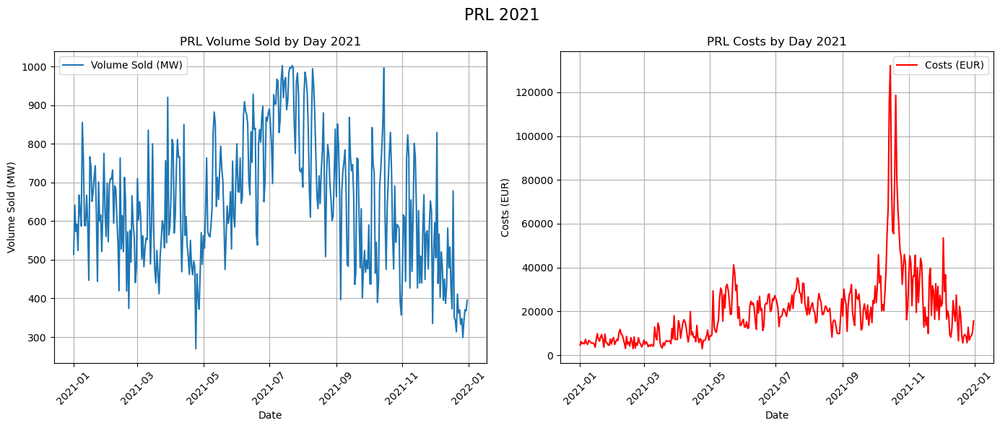

In [77]:
res21_CH_p=res21_CH[res21_CH['Description'].str.contains('Primary control')].copy()

res21_CH_p['date'] = pd.to_datetime(res21_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p21 = res21_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p21.index, grouped_p21['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2021')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p21.index, grouped_p21['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2021')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2021', fontsize=16)
plt.tight_layout()
plt.show()

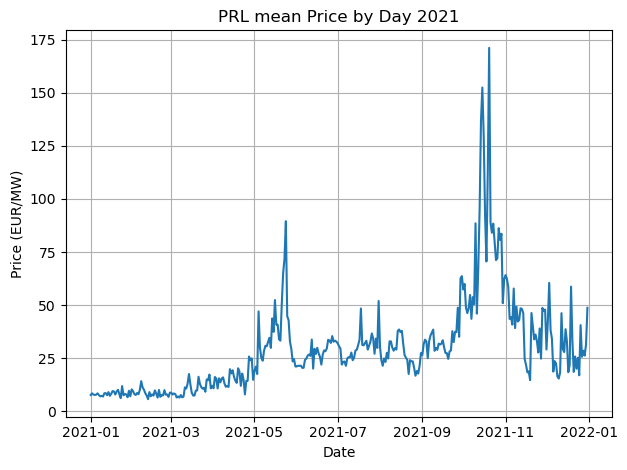

desription of PRL prices:
 count    365.000000
mean      29.311067
std       22.394273
min        5.786590
25%       13.208427
50%       25.712125
75%       34.352359
max      171.095449
Name: Prix_prestation, dtype: float64



In [78]:
plt.plot(grouped_p21.index, grouped_p21['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2021')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2021/PRL_mean_price_2021.pdf', format='pdf')
plt.show()


print(f'desription of PRL prices:\n {grouped_p21["Prix_prestation"].describe()}\n')

In [79]:
PRL21_0_4=res21_CH_p[res21_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL21_4_8=res21_CH_p[res21_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL21_8_12=res21_CH_p[res21_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL21_12_16=res21_CH_p[res21_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL21_16_20=res21_CH_p[res21_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL21_20_24=res21_CH_p[res21_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL21_0_4=PRL21_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_4_8=PRL21_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_8_12=PRL21_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_12_16=PRL21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_16_20=PRL21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL21_20_24=PRL21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

max_volume=176, min volume= 23
max_cost=43154.8, min cost= 167.5


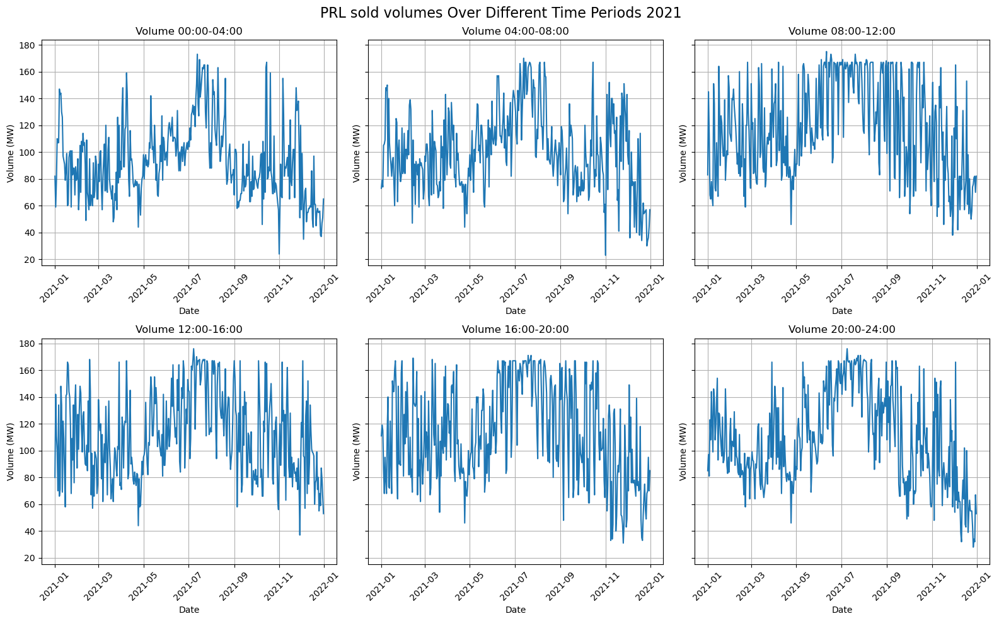

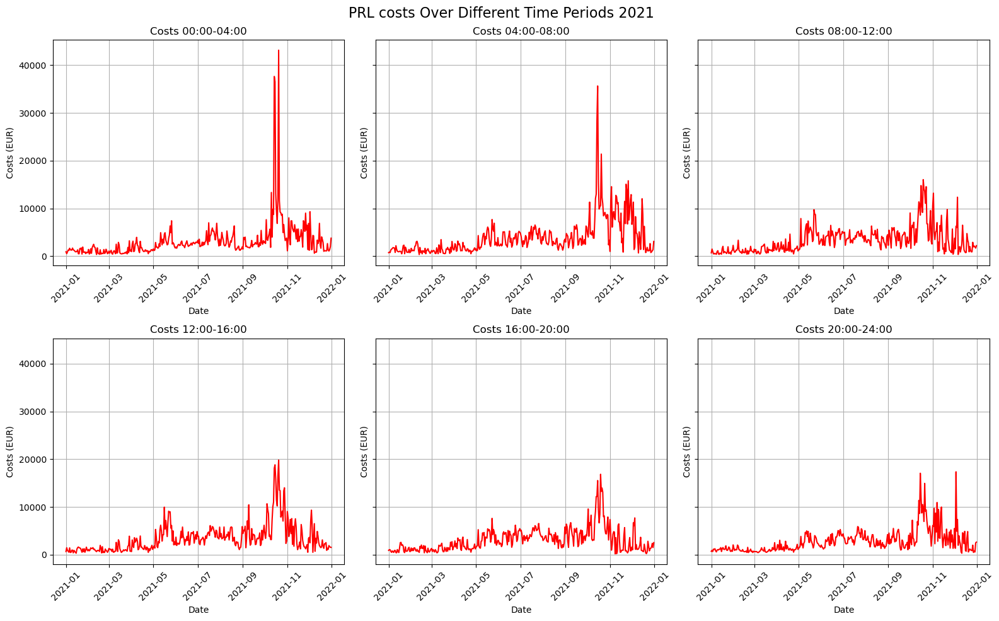

In [80]:
# Grouped data list and labels
grouped_p21 = [grouped_PRL21_0_4, grouped_PRL21_4_8, grouped_PRL21_8_12, grouped_PRL21_12_16, grouped_PRL21_16_20, grouped_PRL21_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p21])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p21])
min_cost = min([data['Coûts'].min() for data in grouped_p21])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

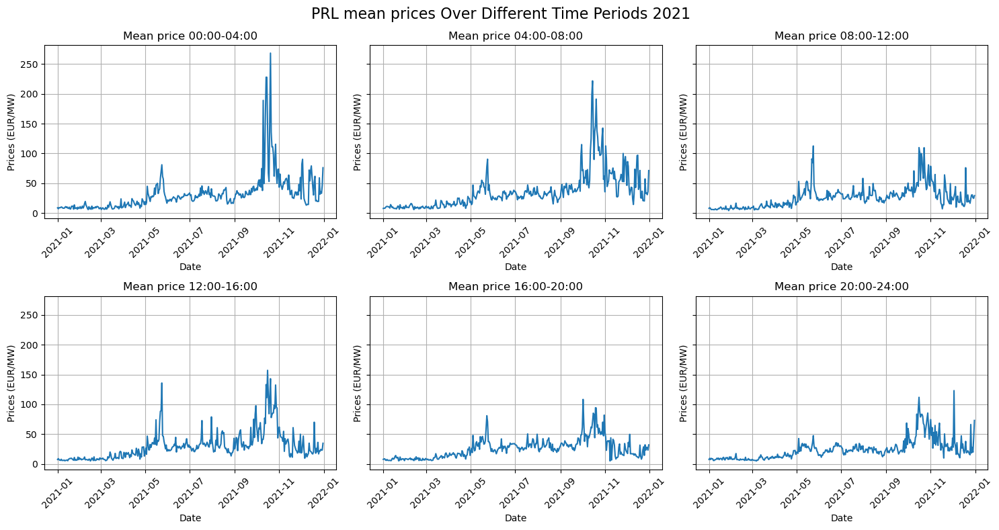

count    365.000000
mean      31.690213
std       31.110518
min        5.676923
25%       13.037778
50%       25.867188
75%       37.420000
max      268.394565
Name: Prix_prestation, dtype: float64
count    365.000000
mean      36.196112
std       31.172015
min        5.633333
25%       14.193750
50%       28.539394
75%       43.350000
max      221.756481
Name: Prix_prestation, dtype: float64
count    365.000000
mean      26.066145
std       18.351732
min        4.011522
25%       11.735091
50%       23.814615
75%       33.243478
max      112.491071
Name: Prix_prestation, dtype: float64
count    365.000000
mean      29.884737
std       24.557017
min        4.848846
25%       11.801316
50%       24.933333
75%       35.610000
max      157.093793
Name: Prix_prestation, dtype: float64
count    365.000000
mean      25.574314
std       16.846257
min        4.911111
25%       12.041584
50%       24.420615
75%       33.433704
max      108.240571
Name: Prix_prestation, dtype: float64
count    3

In [81]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/2021/PRL_mean_prices_periods_2021.pdf', format='pdf')
plt.show()

for group in grouped_p21:
    print(group['Prix_prestation'].describe())

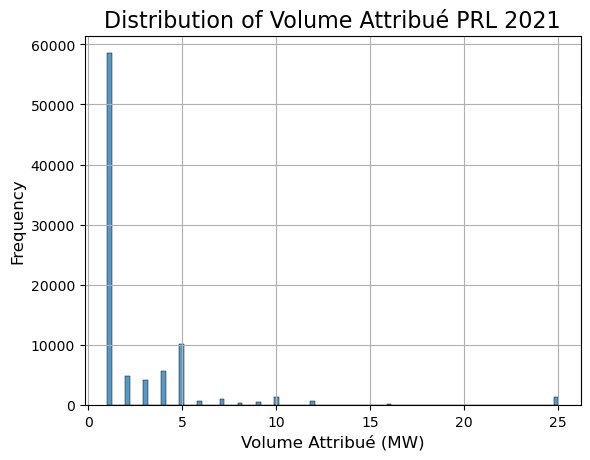

In [82]:

sns.histplot(res21_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2021', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2021/PRL_volume_2021.pdf', format='pdf')
plt.show()

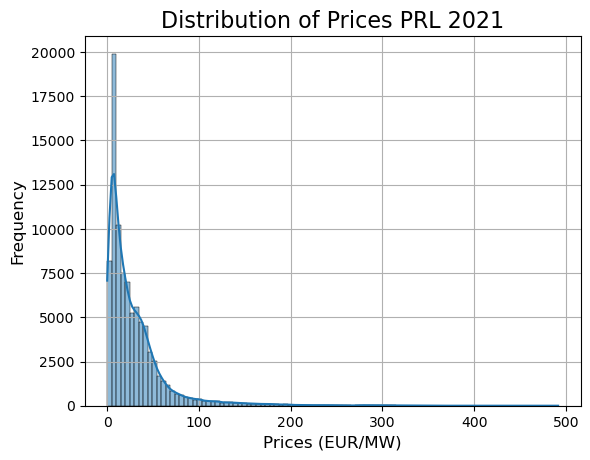

In [83]:
#plt.figure(figsize=(10, 6))
sns.histplot(res21_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2021', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2021/PRL_price_dist_2021.pdf', format='pdf')
plt.show()

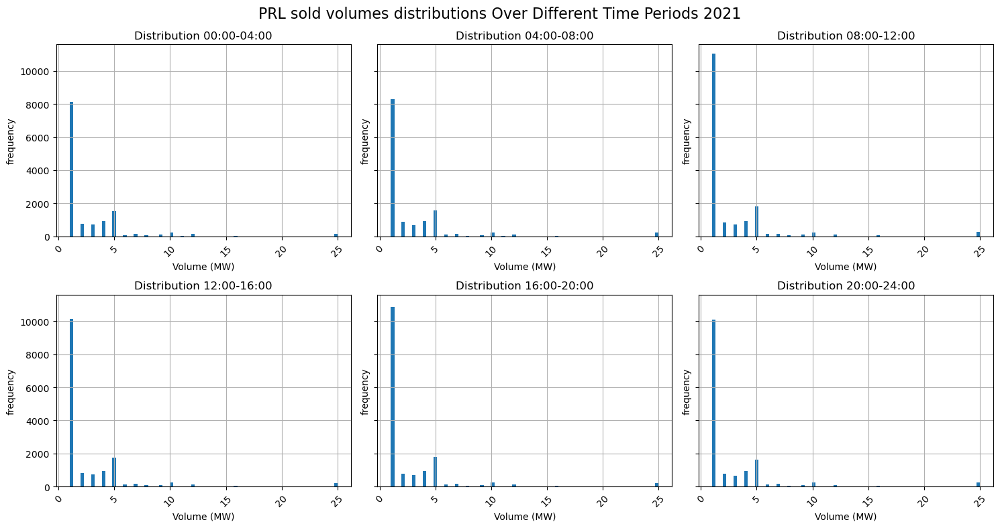

In [84]:

list_PRL21 = [PRL21_0_4, PRL21_4_8, PRL21_8_12, PRL21_12_16, PRL21_16_20, PRL21_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/PRL_volume_distributions_2021.pdf', format='pdf')
plt.show()

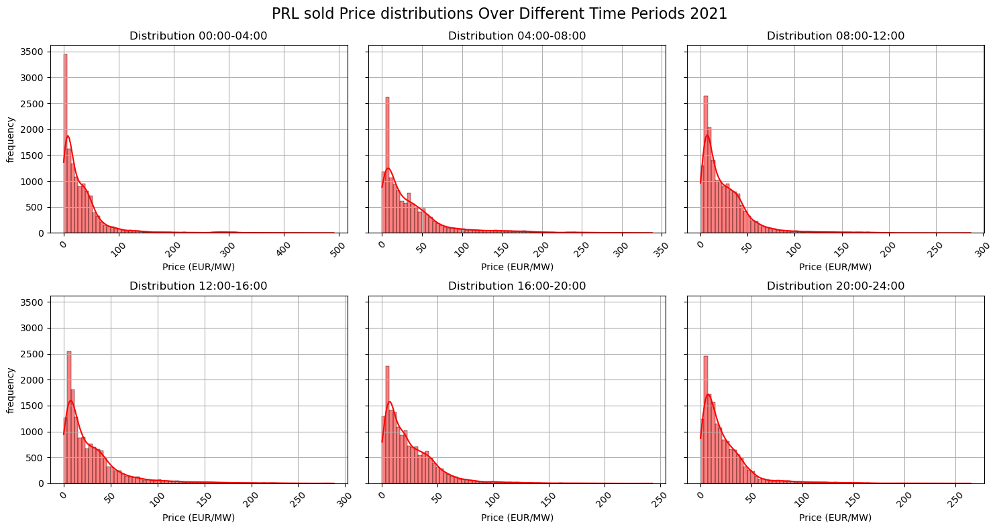

In [85]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, ax=ax, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (EUR/MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold Price distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/PRL_prices_distributions_2021.pdf', format='pdf')
plt.show()

In [86]:
# plot(res21_CH_p, 'PRL', '2021', 'PRL 2021', 'daily', figure_size=(14,6))

## Secondary control Auction 2021

In [87]:
# Create DataFrame for Secondary control
res21_CH_s = res21_CH[res21_CH['Description'].str.contains('Secondary control')].copy()

res21_CH_s['Week'] = res21_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL21m=res21_CH_s[res21_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL21p=res21_CH_s[res21_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL21m=SRL21m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL21p=SRL21p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL21=[grouped_SRL21m, grouped_SRL21p]

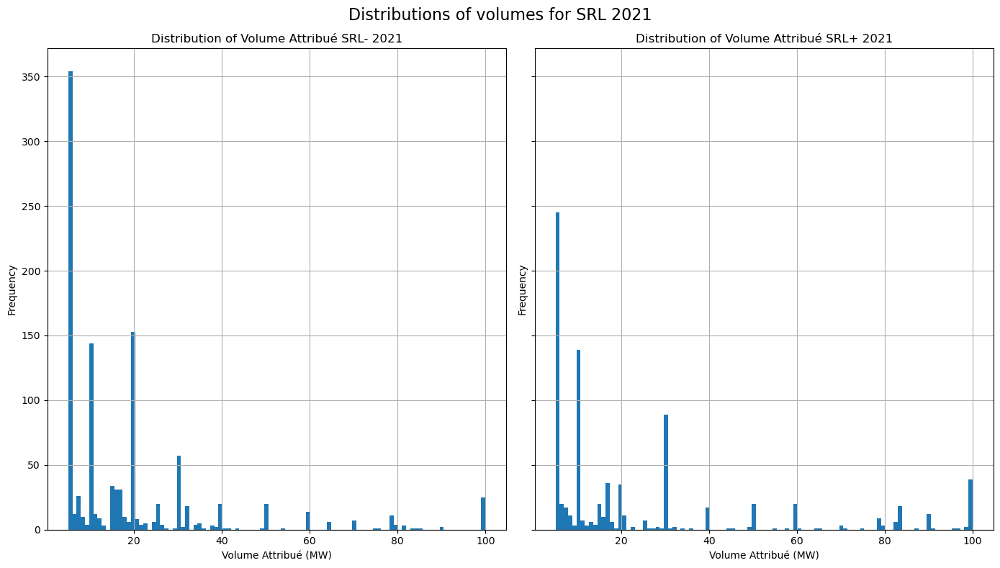

In [88]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL21m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2021')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL21p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2021')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/SRL_dist_2021.pdf', format='pdf')
plt.show()

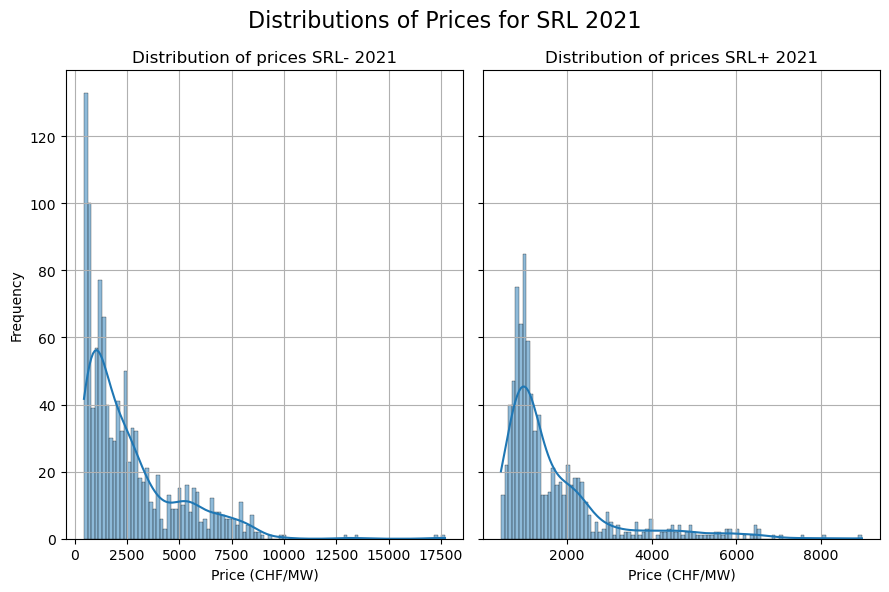

In [89]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL21m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2021')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL21p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2021')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/SRL_dist_prices_2021.pdf', format='pdf')
plt.show()

In [90]:
tmp=SRL21m.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,354
20,153
10,144
30,57
15,34
17,31
16,31
7,26
100,25


In [91]:
tmp=SRL21p.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,245
10,139
30,89
100,39
17,36
20,35
50,20
60,20
6,20


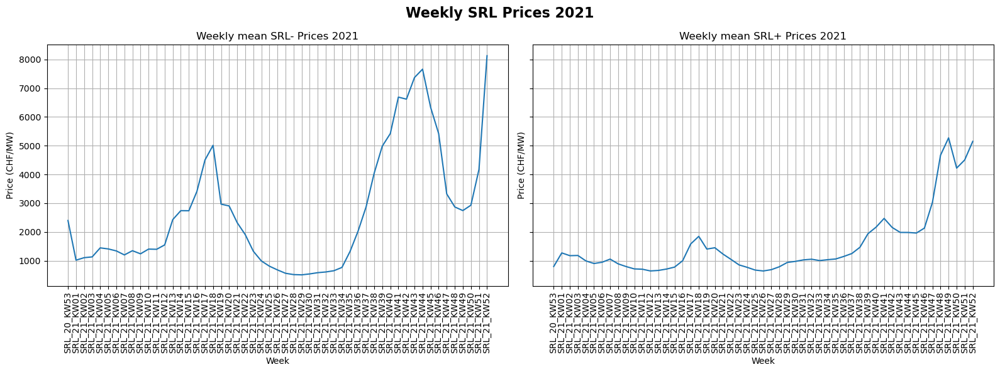

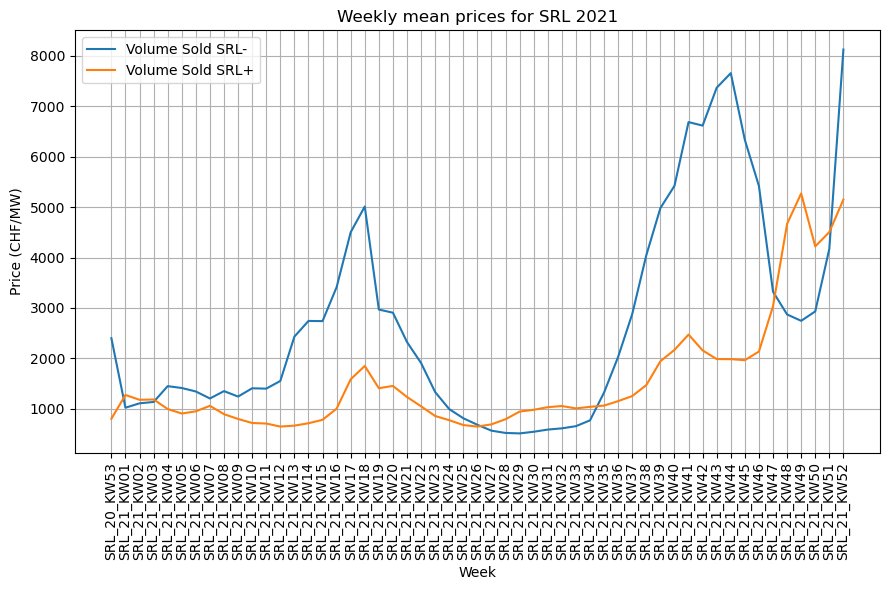

desription of SRL- prices:
 count      53.000000
mean     2688.627712
std      2098.616876
min       510.942667
25%      1134.841818
50%      2031.316923
75%      3412.619231
max      8128.352941
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean     1564.760997
std      1175.103388
min       645.875556
25%       856.290909
50%      1058.147368
75%      1942.523810
max      5272.637500
Name: Prix_prestation, dtype: float64


In [92]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL21m.index, grouped_SRL21m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2021')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL21p.index, grouped_SRL21p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2021')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2021', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL21m.index, grouped_SRL21m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL21p.index, grouped_SRL21p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2021')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2021/Weekly_SRL_Prices_combined_2021.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL21m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL21p["Prix_prestation"].describe()}')


max_volume=500, min volume= 367
max_cost=3562446.2, min cost= 223684.4


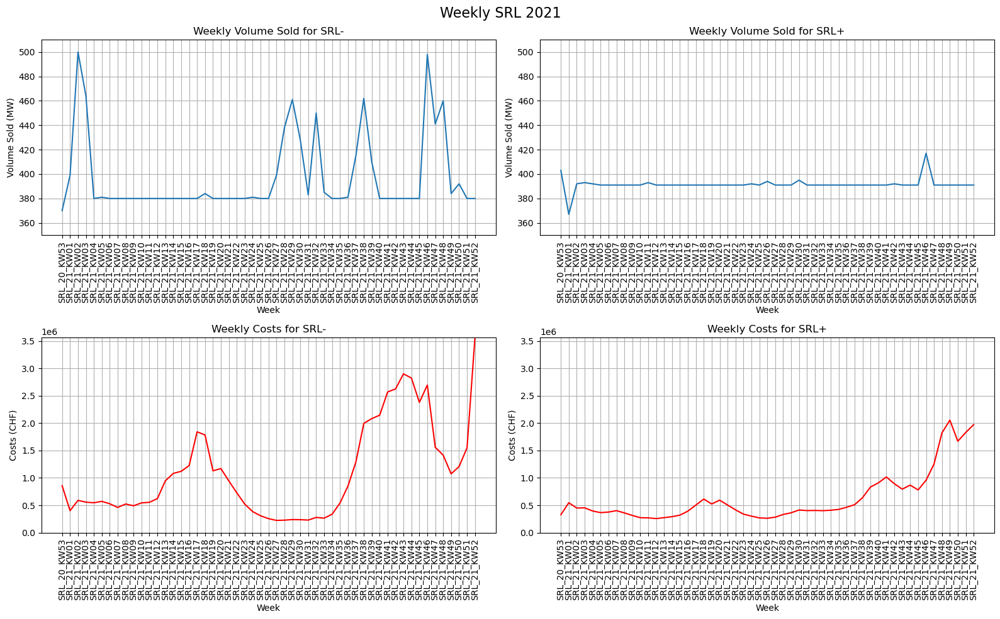

In [93]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL21])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL21])
min_cost = min([data['Coûts'].min() for data in grouped_SRL21])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL21m.index, grouped_SRL21m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL21p.index, grouped_SRL21p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL21m.index, grouped_SRL21m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL21p.index, grouped_SRL21p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2021', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2021

In [94]:
# Create DataFrame for Tertiary control
res21_CH_t = res21_CH[res21_CH['Description'].str.contains('Tertiary Power')].copy()
res21_CH_t= res21_CH_t[res21_CH_t['Volume_attribué'] != 0]

TPDW21=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW21=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP'].copy()
TPD21_00_04=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD21_04_08=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD21_08_12=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD21_12_16=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD21_16_20=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD21_20_24=res21_CH_t[res21_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU21_00_04=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU21_04_08=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU21_08_12=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU21_12_16=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU21_16_20=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU21_20_24=res21_CH_t[res21_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW21['Week']=TPDW21['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW21['Week']=TPUW21['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW21=TPDW21.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW21=TPUW21.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD21_00_04['date'] = pd.to_datetime(TPD21_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_04_08['date'] = pd.to_datetime(TPD21_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_08_12['date'] = pd.to_datetime(TPD21_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_12_16['date'] = pd.to_datetime(TPD21_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_16_20['date'] = pd.to_datetime(TPD21_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD21_20_24['date'] = pd.to_datetime(TPD21_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU21_00_04['date'] = pd.to_datetime(TPU21_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_04_08['date'] = pd.to_datetime(TPU21_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_08_12['date'] = pd.to_datetime(TPU21_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_12_16['date'] = pd.to_datetime(TPU21_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_16_20['date'] = pd.to_datetime(TPU21_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU21_20_24['date'] = pd.to_datetime(TPU21_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD21_00_04=TPD21_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_04_08=TPD21_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_08_12=TPD21_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_12_16=TPD21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_16_20=TPD21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD21_20_24=TPD21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU21_00_04=TPU21_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_04_08=TPU21_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_08_12=TPU21_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_12_16=TPU21_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_16_20=TPU21_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU21_20_24=TPU21_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD21 = [grouped_TPD21_00_04, grouped_TPD21_04_08, grouped_TPD21_08_12, grouped_TPD21_12_16, grouped_TPD21_16_20, grouped_TPD21_20_24]

grouped_TPU21 = [grouped_TPU21_00_04, grouped_TPU21_04_08, grouped_TPU21_08_12, grouped_TPU21_12_16, grouped_TPU21_16_20, grouped_TPU21_20_24]

grouped_TPW21=[grouped_TPDW21, grouped_TPUW21]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

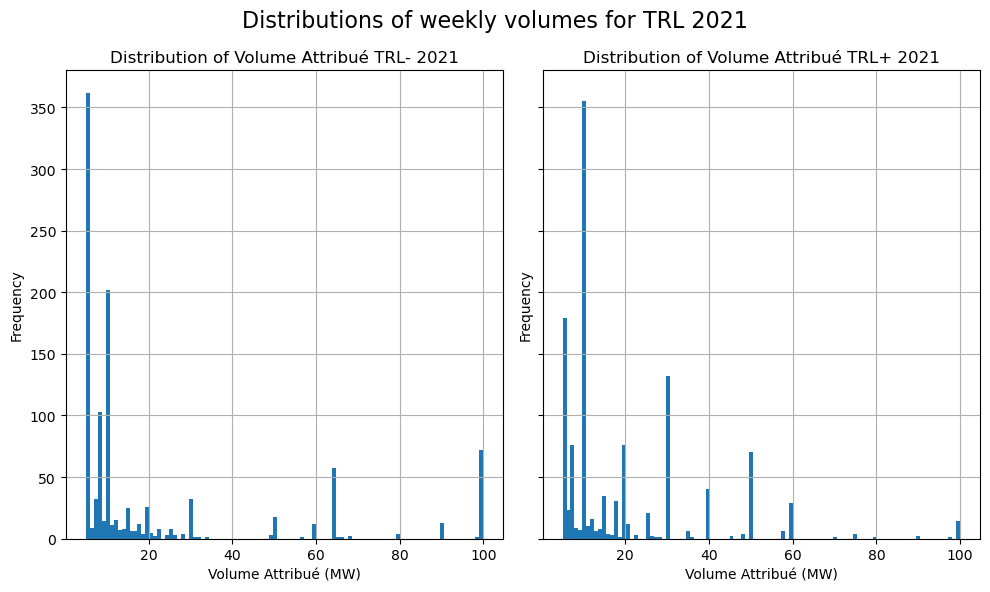

In [95]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW21['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2021')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW21['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2021')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL_dist_2021.pdf', format='pdf')
plt.show()


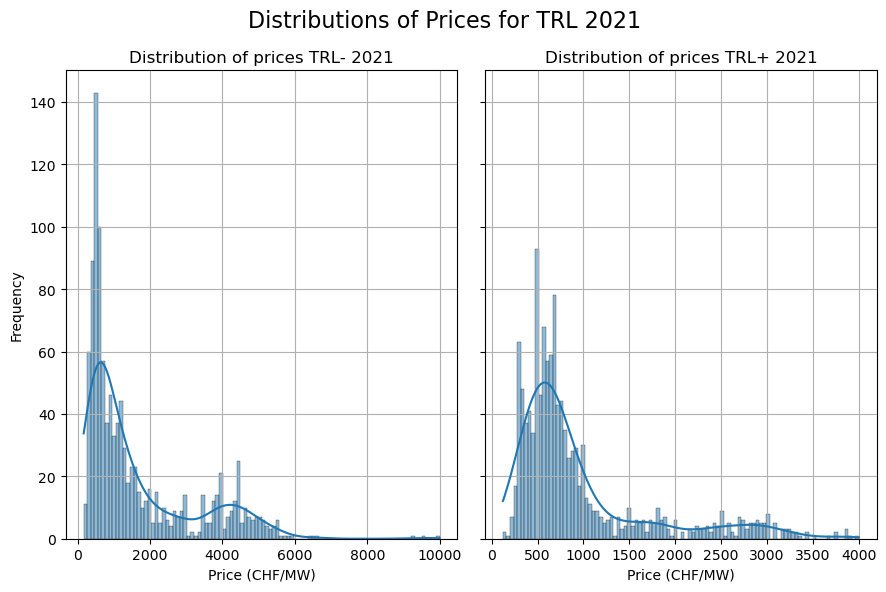

In [96]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW21['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2021')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW21['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2021')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL_dist_prices_2021.pdf', format='pdf')
plt.show()

In [97]:
tmp=TPDW21.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)


,count
Volume_attribué,
5,362
10,202
8,103
100,72
64,57
30,32
7,32
20,26
15,25


In [98]:
tmp=TPUW21.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
10,355
5,179
30,132
7,76
20,76
50,70
40,40
15,35
18,31


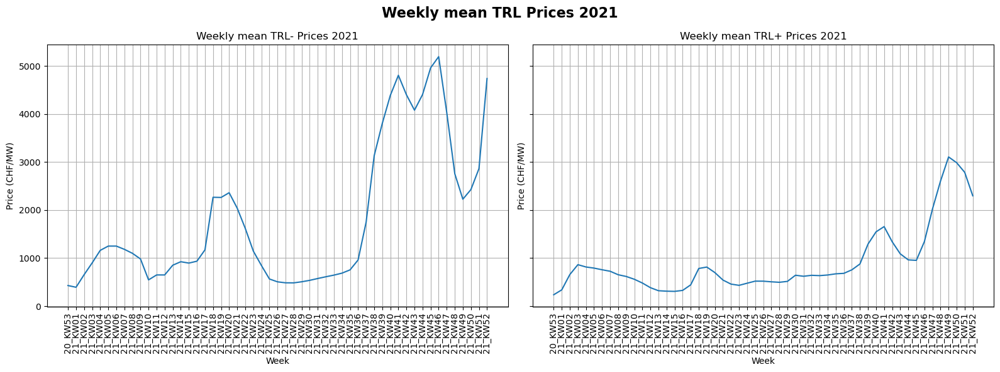

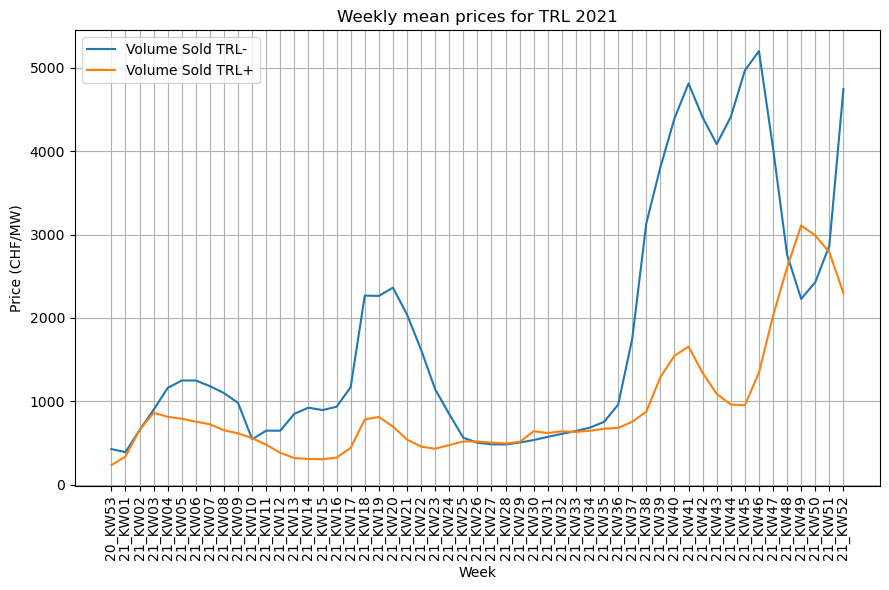

desription of TRL- prices:
 count      53.000000
mean     1808.150658
std      1480.363300
min       393.192857
25%       650.000000
50%      1146.515789
75%      2428.795000
max      5198.262500
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean      916.370336
std       702.293790
min       237.049375
25%       506.760000
50%       658.390000
75%       953.863077
max      3108.807742
Name: Prix_prestation, dtype: float64


In [99]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW21.index, grouped_TPDW21['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2021')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW21.index, grouped_TPUW21['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2021')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2021', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW21.index, grouped_TPDW21['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW21.index, grouped_TPUW21['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2021')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2021/Weekly_TRL_Prices_combined_2021.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW21["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW21["Prix_prestation"].describe()}')

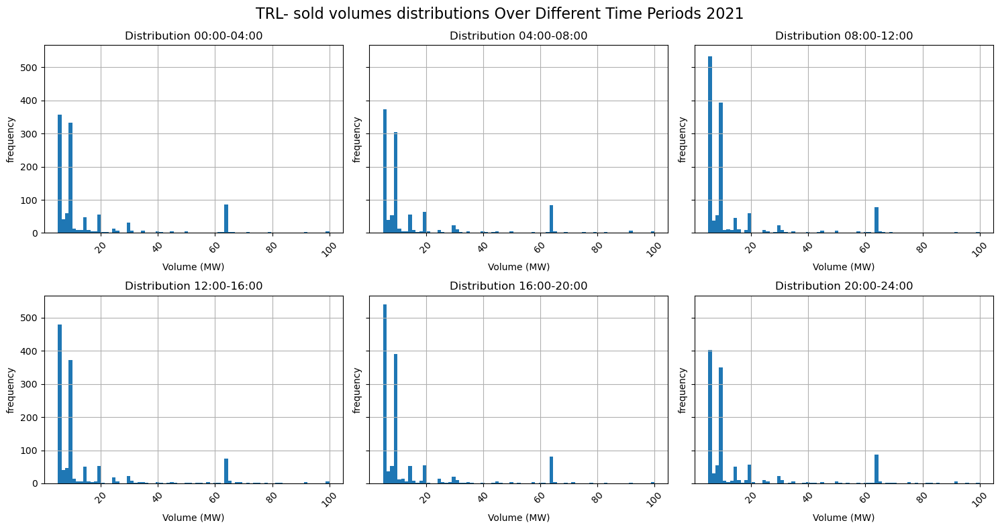

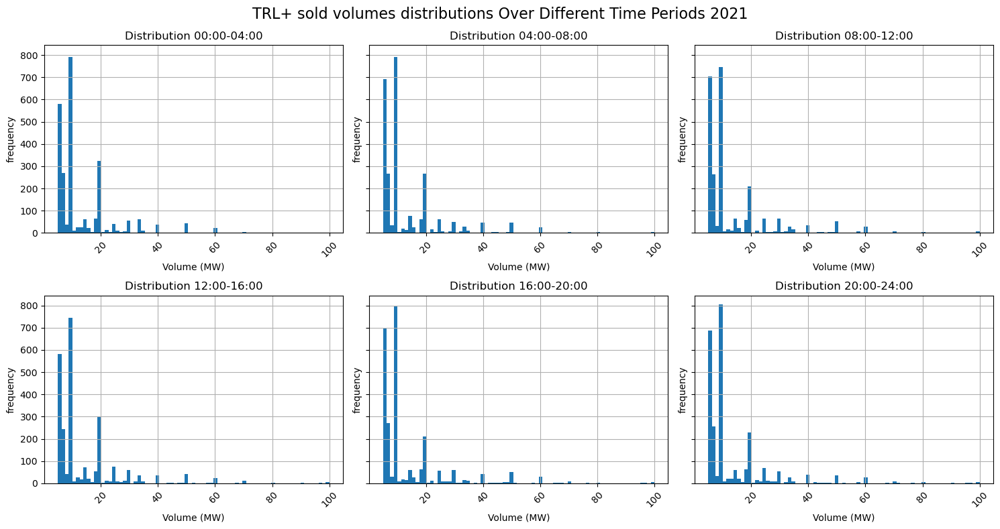

In [100]:
list_TPD21 = [TPD21_00_04, TPD21_04_08, TPD21_08_12, TPD21_12_16, TPD21_16_20, TPD21_20_24]

list_TPU21 = [TPU21_00_04, TPU21_04_08, TPU21_08_12, TPU21_12_16, TPU21_16_20, TPU21_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL-_dist_daily_2021.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL+_dist_daily_2021.pdf', format='pdf')
plt.show()

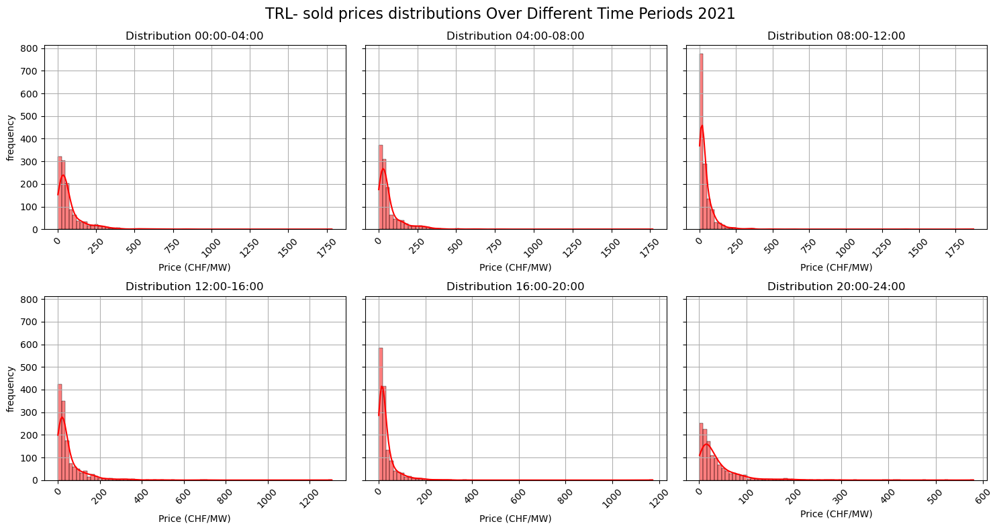

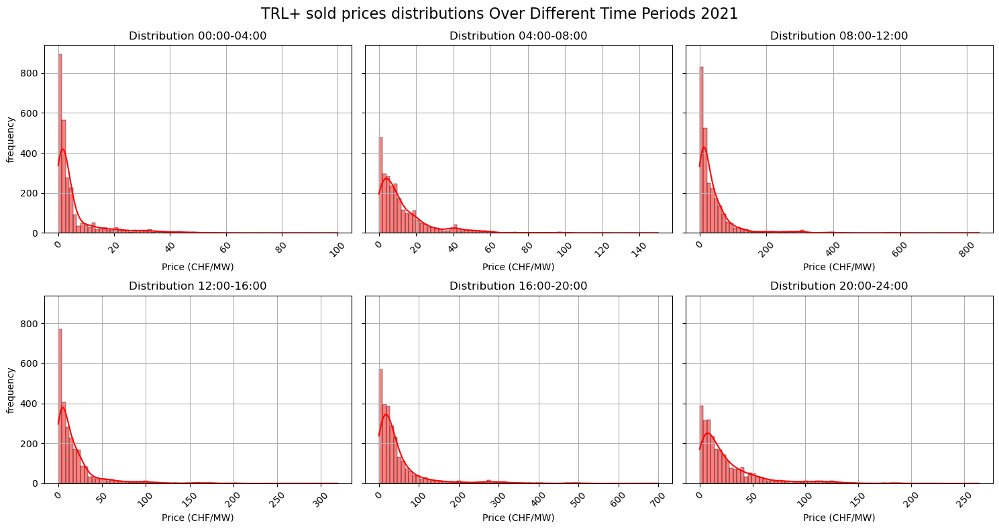

In [101]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL-_dist_prices_daily_2021.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL+_dist_prices_daily_2021.pdf', format='pdf')
plt.show()

max_volume=144
max_cost=71236.0


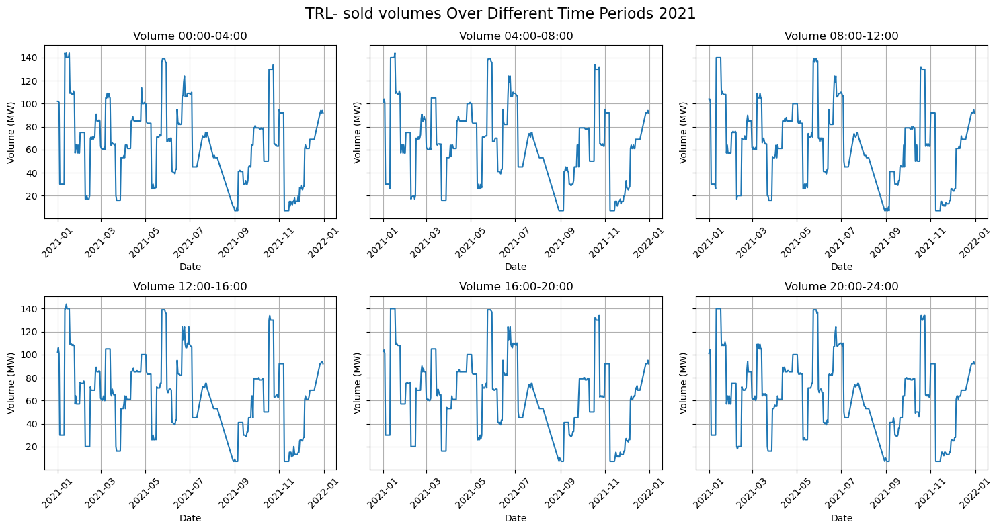

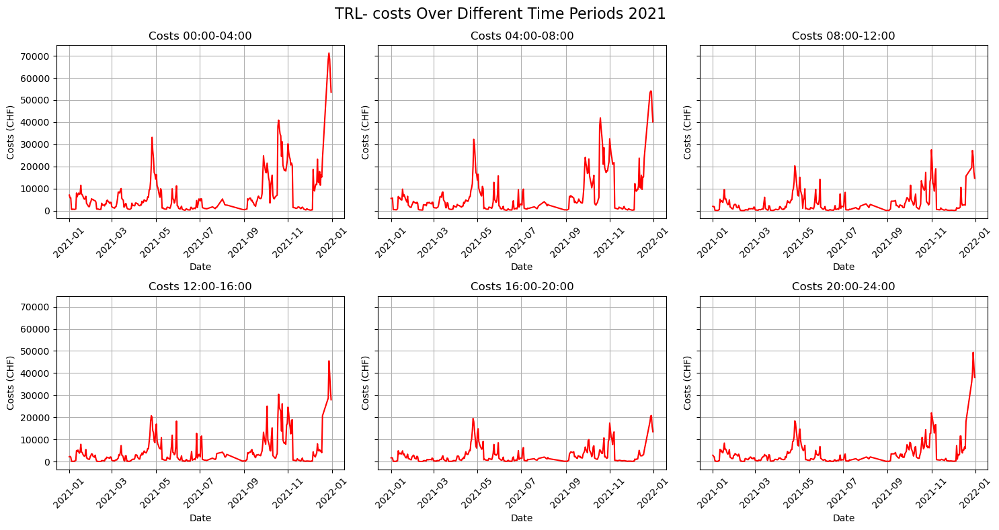

In [102]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()


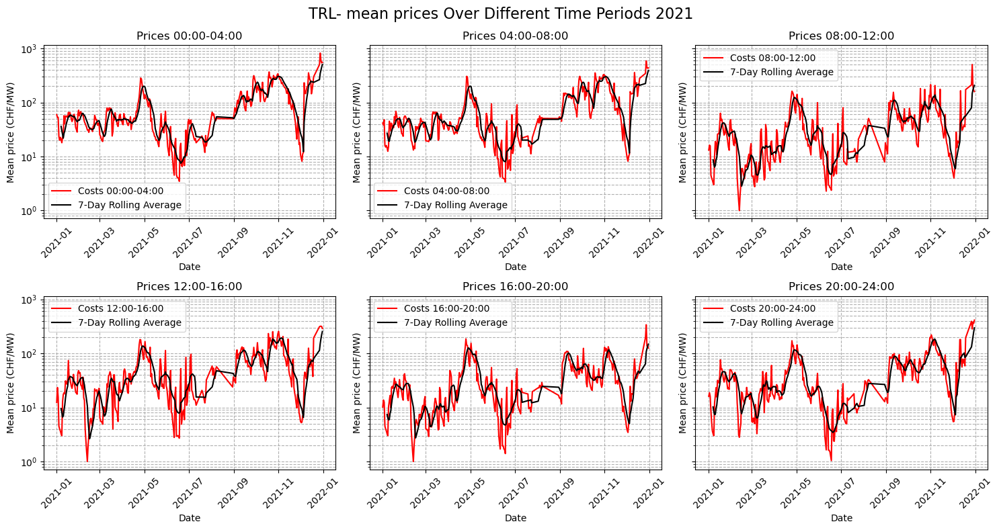

count    323.000000
mean      94.823416
std      104.649518
min        3.480000
25%       30.096250
50%       54.160000
75%      121.300000
max      819.500000
Name: Prix_prestation, dtype: float64

count    323.000000
mean      86.292654
std       92.486982
min        3.357500
25%       25.962500
50%       48.595000
75%      123.300000
max      588.000000
Name: Prix_prestation, dtype: float64

count    323.000000
mean      40.170974
std       49.753768
min        1.000000
25%        9.833571
50%       23.783000
75%       49.015231
max      504.500000
Name: Prix_prestation, dtype: float64

count    323.000000
mean      54.989676
std       59.608120
min        1.000000
25%       16.510000
50%       32.753333
75%       75.255556
max      318.000000
Name: Prix_prestation, dtype: float64

count    323.000000
mean      34.842356
std       38.761640
min        1.000000
25%        9.877262
50%       22.038333
75%       45.019048
max      337.870000
Name: Prix_prestation, dtype: float64

count

In [103]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL-_mean_prices_periods_2021.pdf', format='pdf')
plt.show()

for group in grouped_TPD21:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=263
max_cost=91375.4


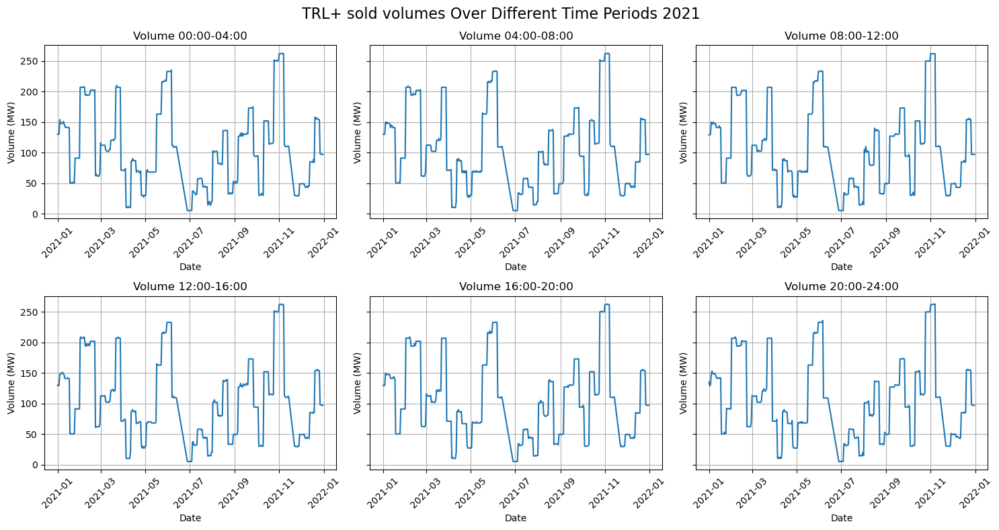

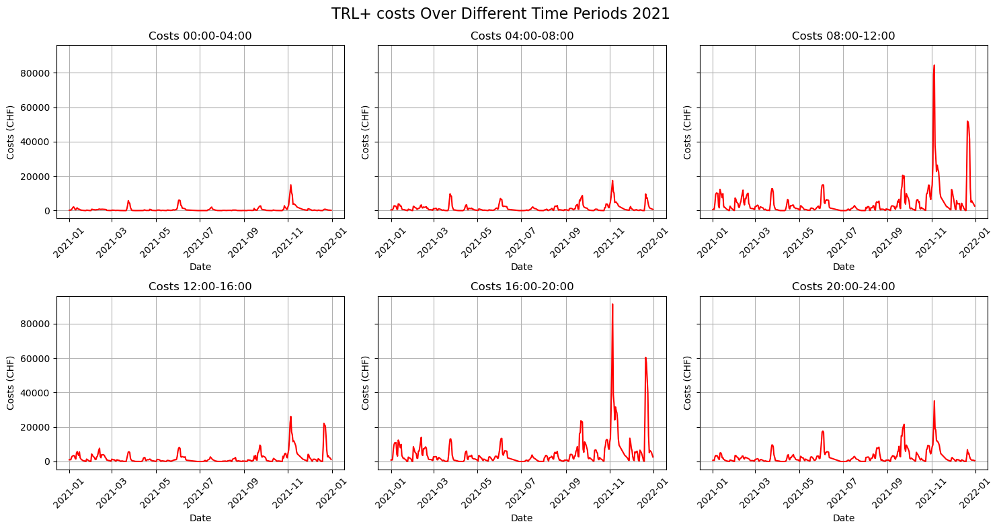

In [104]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.show()


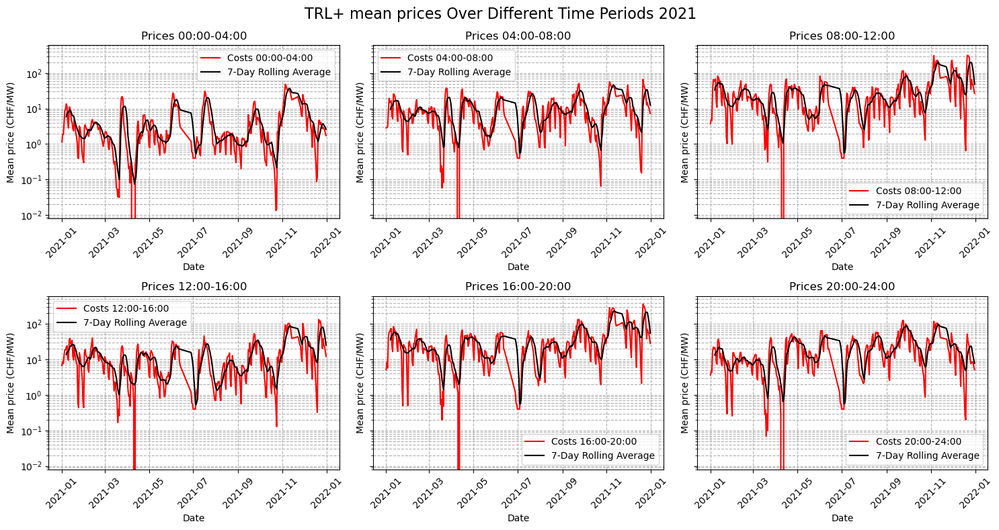

count    344.000000
mean       4.903768
std        7.416328
min        0.000000
25%        0.922667
50%        2.042000
75%        4.571676
max       48.343810
Name: Prix_prestation, dtype: float64

count    344.000000
mean      10.994669
std       11.175642
min        0.000000
25%        3.307121
50%        7.594286
75%       15.181719
max       66.634000
Name: Prix_prestation, dtype: float64

count    344.000000
mean      35.808580
std       50.101987
min        0.000000
25%        8.225000
50%       20.219000
75%       41.905526
max      316.627500
Name: Prix_prestation, dtype: float64

count    344.000000
mean      15.303309
std       20.522662
min        0.000000
25%        3.160000
50%        8.710000
75%       19.082750
max      134.095833
Name: Prix_prestation, dtype: float64

count    344.000000
mean      40.599020
std       54.790007
min        0.000000
25%       10.323438
50%       23.064000
75%       46.593269
max      367.313636
Name: Prix_prestation, dtype: float64

count

In [105]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU21):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')
    
# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2021', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2021/TRL+_mean_prices_periods_2021.pdf', format='pdf')
plt.show()

for group in grouped_TPU21:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=545
max_cost=2844930.12


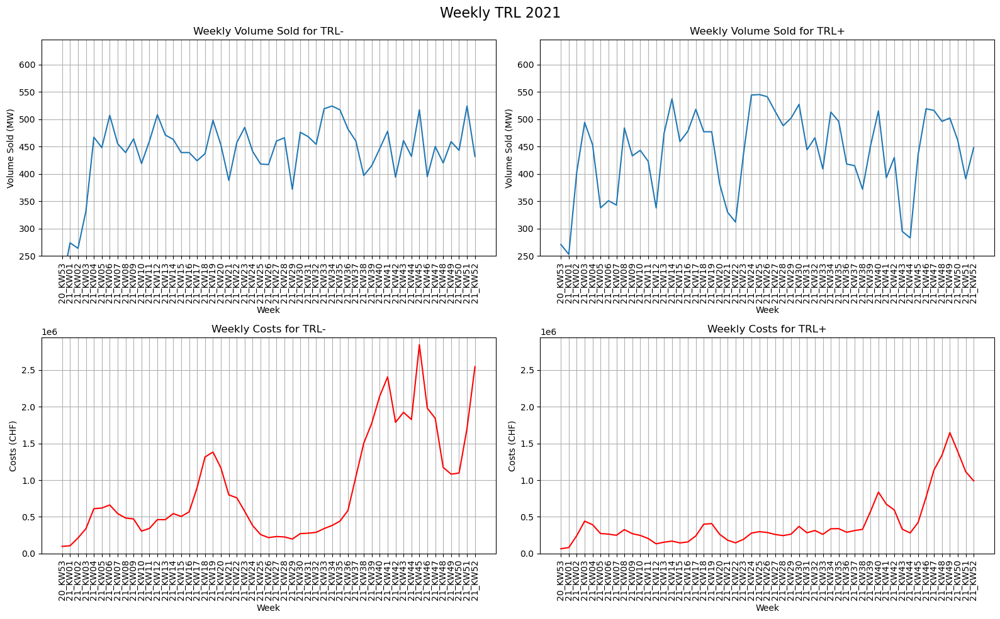

In [106]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW21])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW21])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW21.index, grouped_TPDW21['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW21.index, grouped_TPUW21['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW21.index, grouped_TPDW21['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW21.index, grouped_TPUW21['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2021', fontsize=16)
plt.tight_layout()
plt.show()


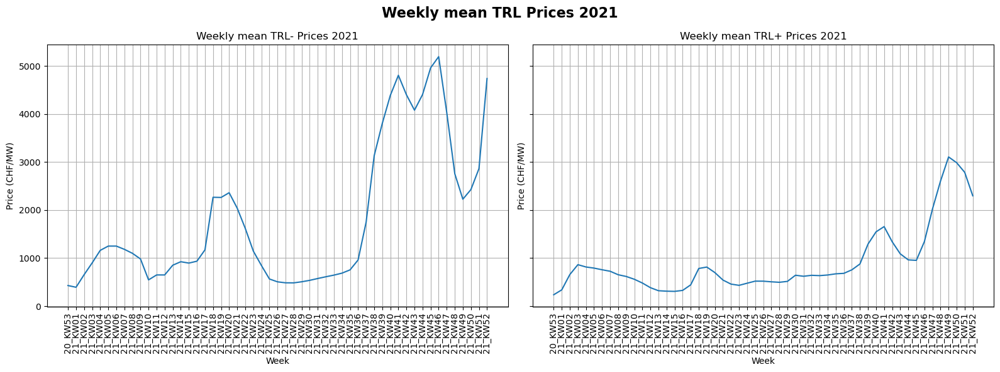

desription of TRL- prices:
 count      53.000000
mean     1808.150658
std      1480.363300
min       393.192857
25%       650.000000
50%      1146.515789
75%      2428.795000
max      5198.262500
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean      916.370336
std       702.293790
min       237.049375
25%       506.760000
50%       658.390000
75%       953.863077
max      3108.807742
Name: Prix_prestation, dtype: float64


In [107]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW21.index, grouped_TPDW21['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2021')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW21.index, grouped_TPUW21['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2021')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2021', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW21["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW21["Prix_prestation"].describe()}')

---
# Data 2022

In [108]:
res22=pd.read_csv(DATA + '2022-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
print(res22.Description.unique())
res22

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\713130675.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res22=pd.read_csv(DATA + '2022-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,0.9,EUR/MW,2.7,EUR,47.0,EUR/MWh*,CH,0.22,EUR/MWh*,Ja
1,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,0.5,EUR/MW,1.0,EUR,47.0,EUR/MWh*,CH,0.12,EUR/MWh*,Ja
2,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,4,MW,4,MW,20.0,EUR/MW,80.0,EUR,47.0,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
3,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,12.0,EUR/MW,60.0,EUR,47.0,EUR/MWh*,CH,3.00,EUR/MWh*,Ja
4,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,22.3,EUR/MW,22.3,EUR,47.0,EUR/MWh*,CH,5.58,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586606,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,0.8,CHF/MW,0.0,CHF,0.2,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
586607,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,9,MW,0,MW,18.0,CHF/MW,0.0,CHF,4.5,CHF/MWh*,CH,4.50,CHF/MWh*,NaN
586608,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,1.2,CHF/MW,6.0,CHF,0.3,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
586609,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,40,MW,0,MW,100.0,CHF/MW,0.0,CHF,25.0,CHF/MWh*,CH,25.00,CHF/MWh*,NaN


In [109]:
res22_CH=res22[res22.Pays=='CH']
res22_CH

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,0.9,EUR/MW,2.7,EUR,47.0,EUR/MWh*,CH,0.22,EUR/MWh*,Ja
1,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,0.5,EUR/MW,1.0,EUR,47.0,EUR/MWh*,CH,0.12,EUR/MWh*,Ja
2,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,4,MW,4,MW,20.0,EUR/MW,80.0,EUR,47.0,EUR/MWh*,CH,5.00,EUR/MWh*,Ja
3,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,12.0,EUR/MW,60.0,EUR,47.0,EUR/MWh*,CH,3.00,EUR/MWh*,Ja
4,PRL_22_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,22.3,EUR/MW,22.3,EUR,47.0,EUR/MWh*,CH,5.58,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586606,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,20,MW,0,MW,0.8,CHF/MW,0.0,CHF,0.2,CHF/MWh*,CH,0.20,CHF/MWh*,NaN
586607,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,9,MW,0,MW,18.0,CHF/MW,0.0,CHF,4.5,CHF/MWh*,CH,4.50,CHF/MWh*,NaN
586608,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,5,MW,1.2,CHF/MW,6.0,CHF,0.3,CHF/MWh*,CH,0.30,CHF/MWh*,NaN
586609,TRL+_22_12_31,Tertiary Power UP 20:00 bis 24:00,40,MW,0,MW,100.0,CHF/MW,0.0,CHF,25.0,CHF/MWh*,CH,25.00,CHF/MWh*,NaN


## Primary control auction 2022

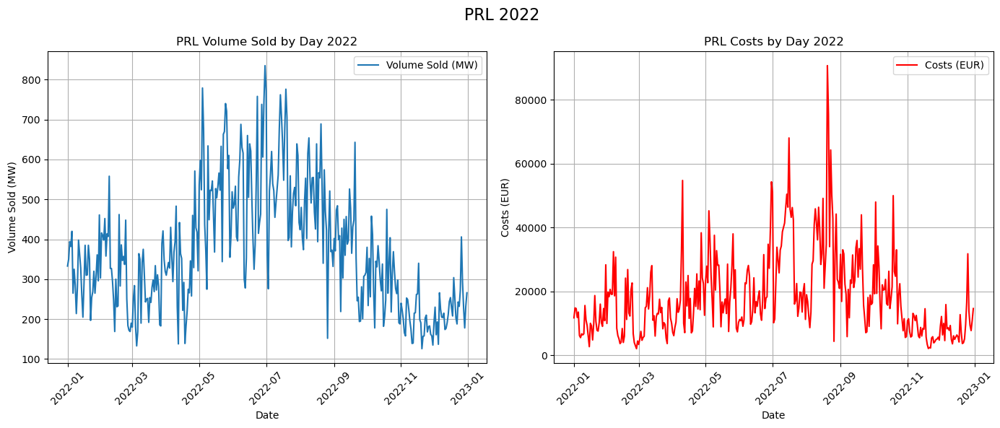

In [110]:
res22_CH_p=res22_CH[res22_CH['Description'].str.contains('Primary control')].copy()

res22_CH_p['date'] = pd.to_datetime(res22_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p22 = res22_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p22.index, grouped_p22['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2022')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p22.index, grouped_p22['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2022')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2022', fontsize=16)
plt.tight_layout()
plt.show()

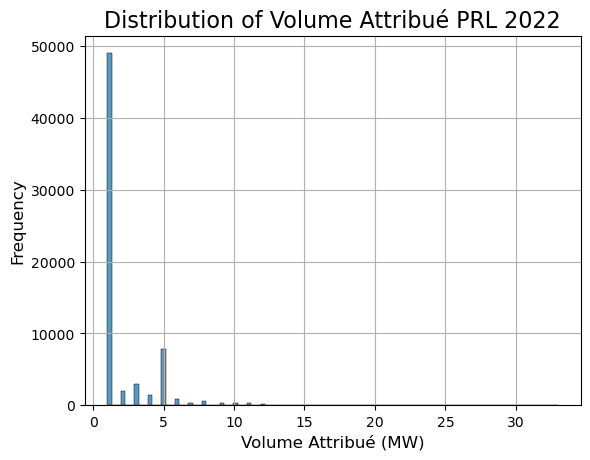

In [111]:
#plt.figure(figsize=(10, 6))
sns.histplot(res22_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2022', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2022/PRL_volume_2022.pdf', format='pdf')
plt.show()

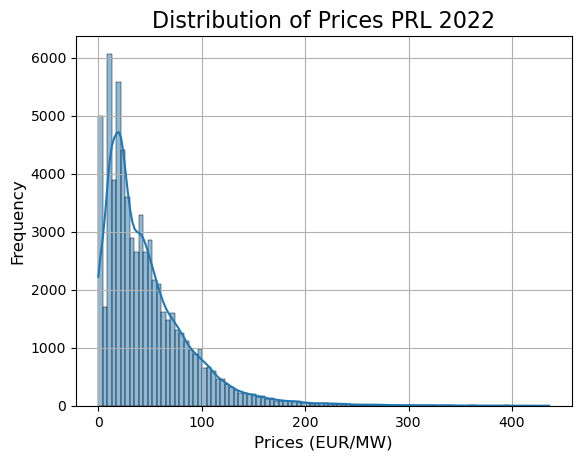

In [112]:
#plt.figure(figsize=(10, 6))
sns.histplot(res22_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2022', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2022/PRL_price_dist_2022.pdf', format='pdf')
plt.show()

In [113]:
PRL22_0_4=res22_CH_p[res22_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL22_4_8=res22_CH_p[res22_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL22_8_12=res22_CH_p[res22_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL22_12_16=res22_CH_p[res22_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL22_16_20=res22_CH_p[res22_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL22_20_24=res22_CH_p[res22_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL22_0_4=PRL22_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_4_8=PRL22_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_8_12=PRL22_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_12_16=PRL22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_16_20=PRL22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL22_20_24=PRL22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

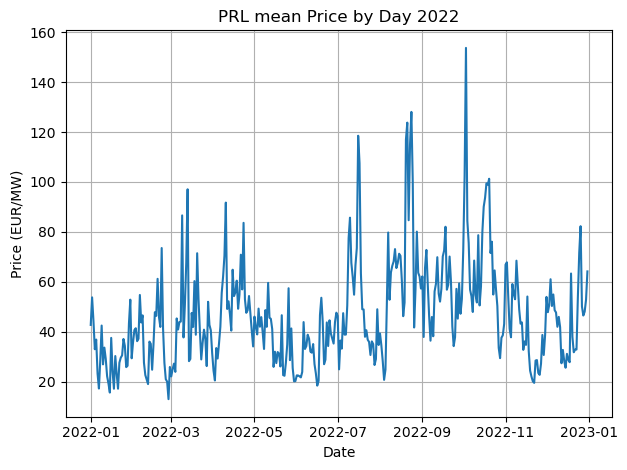

desription of PRL 2022 prices:
 count    365.000000
mean      46.771372
std       20.825134
min       12.925773
25%       31.977686
50%       43.179630
75%       56.705354
max      153.709405
Name: Prix_prestation, dtype: float64



In [114]:
plt.plot(grouped_p22.index, grouped_p22['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2022')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2022/PRL_mean_price_2022.pdf', format='pdf')
plt.show()

print(f'desription of PRL 2022 prices:\n {grouped_p22["Prix_prestation"].describe()}\n')

max_volume=164, min volume= 20
max_cost=26060.01, min cost= 134.7


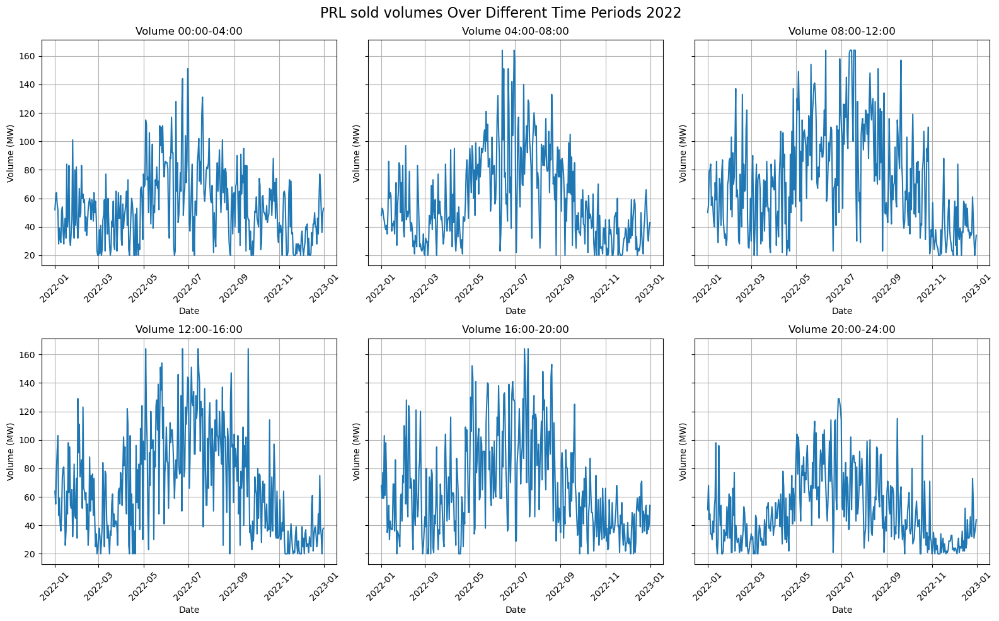

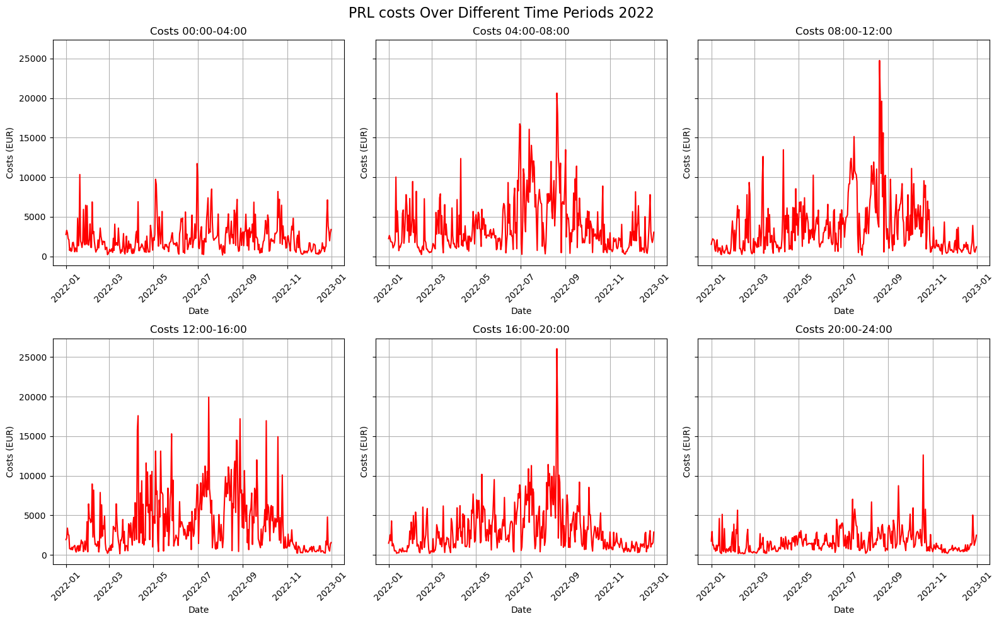

In [115]:
# Grouped data list and labels
grouped_p22 = [grouped_PRL22_0_4, grouped_PRL22_4_8, grouped_PRL22_8_12, grouped_PRL22_12_16, grouped_PRL22_16_20, grouped_PRL22_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p22])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p22])
min_cost = min([data['Coûts'].min() for data in grouped_p22])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


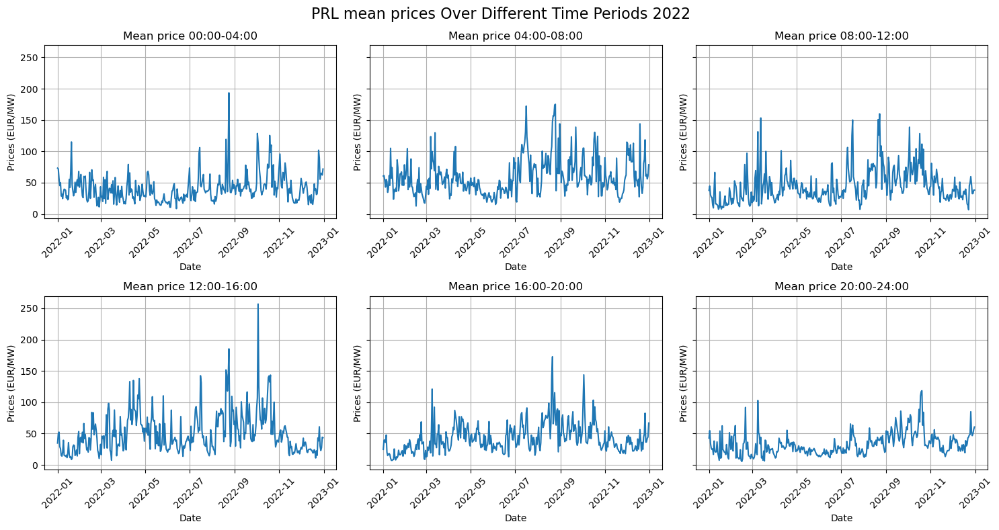

count    365.000000
mean      41.073516
std       21.878965
min        8.568333
25%       26.539394
50%       37.088462
75%       49.063158
max      193.444444
Name: Prix_prestation, dtype: float64

count    365.000000
mean      59.820098
std       29.413792
min       12.662500
25%       38.919000
50%       53.746429
75%       73.877059
max      175.103125
Name: Prix_prestation, dtype: float64

count    365.000000
mean      44.948562
std       26.676362
min        6.620000
25%       26.586471
50%       39.029412
75%       55.914412
max      159.901944
Name: Prix_prestation, dtype: float64

count    365.000000
mean      51.008417
std       32.417957
min        7.350000
25%       26.740625
50%       43.413924
75%       65.930455
max      256.785833
Name: Prix_prestation, dtype: float64

count    365.000000
mean      43.039033
std       23.009681
min        7.048387
25%       26.300000
50%       37.953333
75%       55.066250
max      172.709444
Name: Prix_prestation, dtype: float64

count

In [116]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/2022/PRL_mean_prices_periods_2022.pdf', format='pdf')
plt.show()

for group in grouped_p22:
    print(f'{group["Prix_prestation"].describe()}\n')

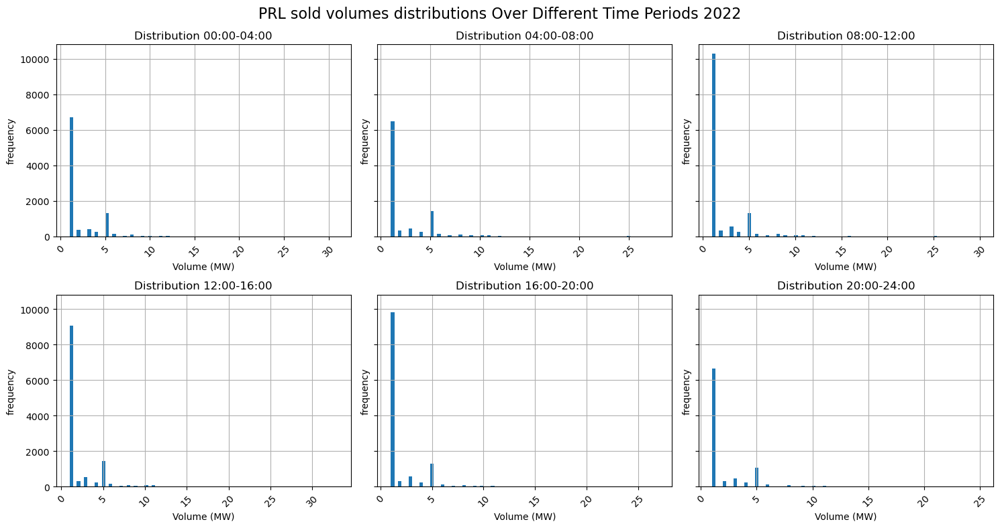

In [117]:

list_PRL22 = [PRL22_0_4, PRL22_4_8, PRL22_8_12, PRL22_12_16, PRL22_16_20, PRL22_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/PRL_volume_distributions_2022.pdf', format='pdf')
plt.show()

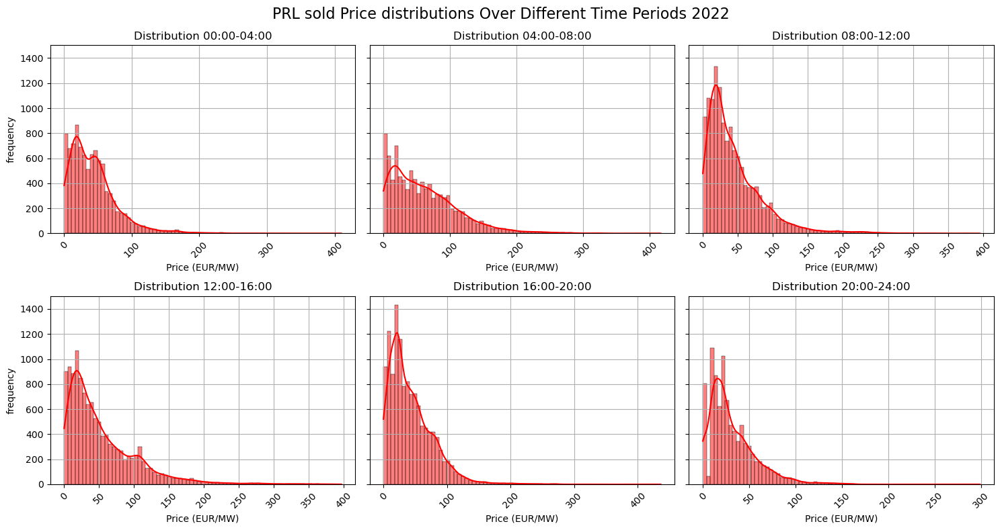

In [118]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, ax=ax, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (EUR/MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold Price distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/PRL_prices_distributions_2022.pdf', format='pdf')
plt.show()

## Secondary control Auction 2022

In [119]:
# Create DataFrame for Secondary control
res22_CH_s = res22_CH[res22_CH['Description'].str.contains('Secondary control')].copy()

res22_CH_s['Week'] = res22_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL22m=res22_CH_s[res22_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL22p=res22_CH_s[res22_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL22m=SRL22m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_SRL22p=SRL22p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_SRL22=[grouped_SRL22m, grouped_SRL22p]

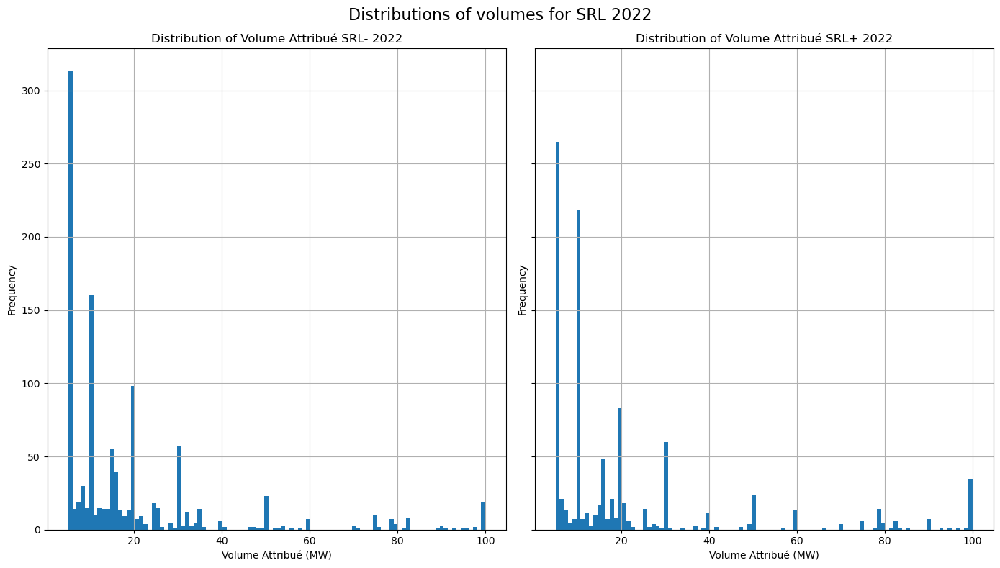

In [120]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL22m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2022')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL22p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2022')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of volumes for SRL 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/SRL_dist_2022.pdf', format='pdf')
plt.show()

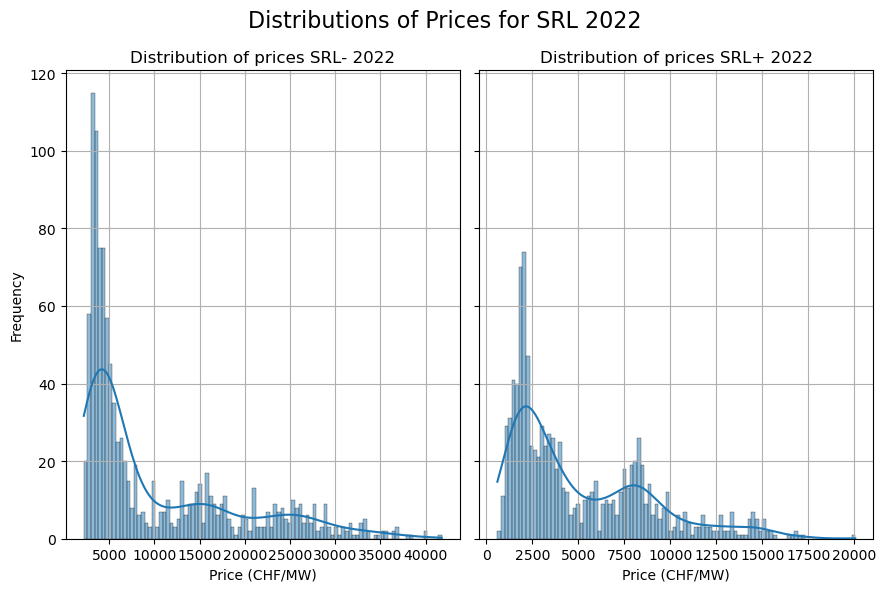

In [121]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL22m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2022')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL22p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2022')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/SRL_dist_prices_2022.pdf', format='pdf')
plt.show()

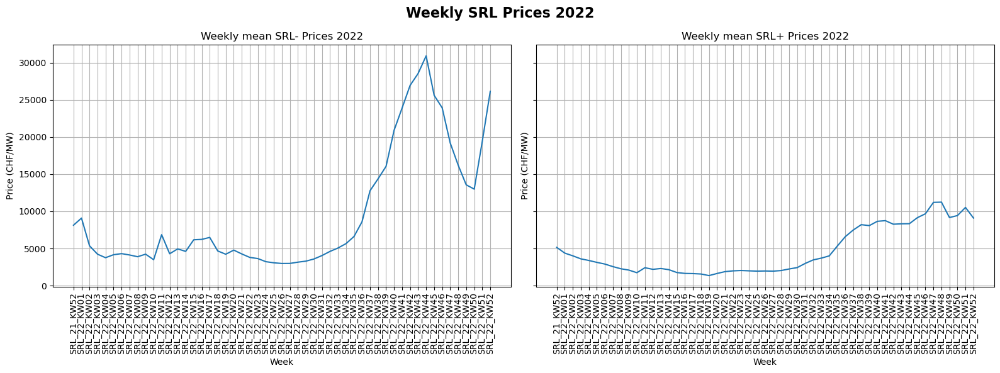

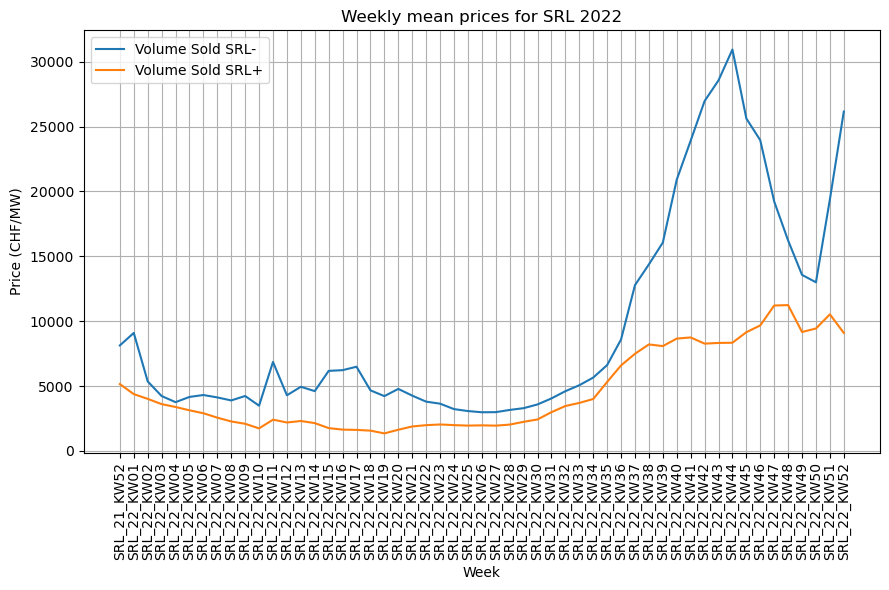

desription of SRL- prices:
 count       53.000000
mean      9587.273723
std       8169.101034
min       2977.370000
25%       4120.628571
50%       5060.792727
75%      13568.308519
max      30940.350000
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count       53.000000
mean      4638.285977
std       3179.682867
min       1346.877333
25%       2025.253333
50%       3127.720000
75%       8206.068571
max      11239.028095
Name: Prix_prestation, dtype: float64


In [122]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL22m.index, grouped_SRL22m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2022')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL22p.index, grouped_SRL22p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2022')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2022', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL22m.index, grouped_SRL22m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL22p.index, grouped_SRL22p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2022')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2022/Weekly_SRL_Prices_combined_2022.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL22m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL22p["Prix_prestation"].describe()}')

In [123]:
tmp=SRL22m.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,313
10,160
20,98
30,57
15,55
16,39
8,30
50,23
100,19


In [124]:
tmp=SRL22p.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
5,265
10,218
20,83
30,60
16,48
100,35
50,24
18,21
6,21


max_volume=482, min volume= 380
max_cost=12353083.65, min cost= 543683.6


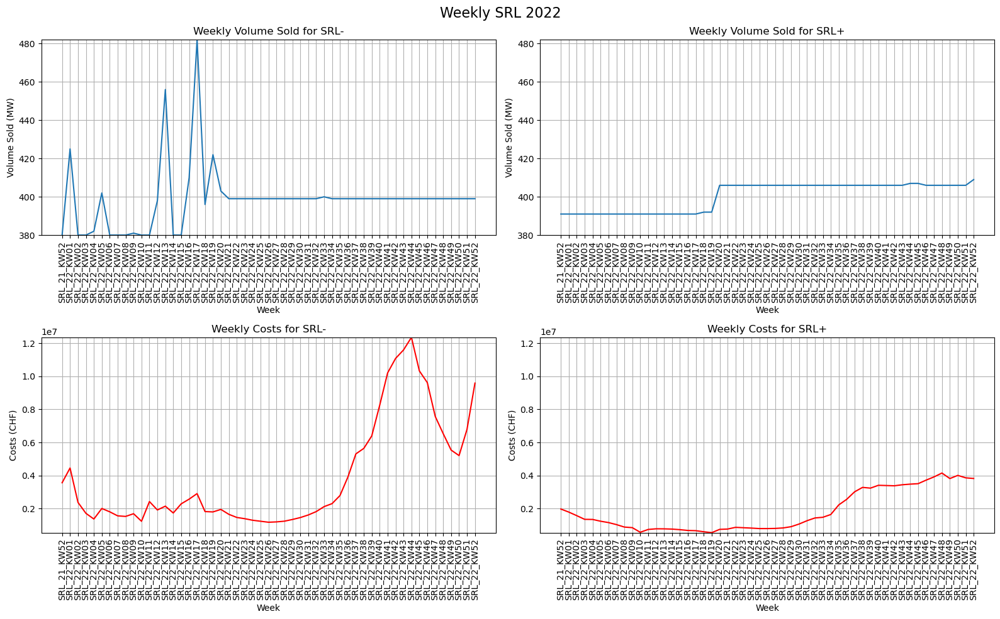

In [125]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL22])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL22])
min_cost = min([data['Coûts'].min() for data in grouped_SRL22])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (min_volume, max_volume )  # Add a small buffer to the max value for clarity
cost_ylim = (min_cost, max_cost)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL22m.index, grouped_SRL22m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL22p.index, grouped_SRL22p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL22m.index, grouped_SRL22m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL22p.index, grouped_SRL22p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2022', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2022

In [126]:
# Create DataFrame for Tertiary control
res22_CH_t = res22_CH[res22_CH['Description'].str.contains('Tertiary Power')].copy()
res22_CH_t= res22_CH_t[res22_CH_t['Volume_attribué'] != 0]

TPDW22=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW22=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP'].copy()
TPD22_00_04=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD22_04_08=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD22_08_12=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD22_12_16=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD22_16_20=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD22_20_24=res22_CH_t[res22_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU22_00_04=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU22_04_08=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU22_08_12=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU22_12_16=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU22_16_20=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU22_20_24=res22_CH_t[res22_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW22['Week']=TPDW22['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW22['Week']=TPUW22['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW22=TPDW22.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW22=TPUW22.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD22_00_04['date'] = pd.to_datetime(TPD22_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_04_08['date'] = pd.to_datetime(TPD22_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_08_12['date'] = pd.to_datetime(TPD22_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_12_16['date'] = pd.to_datetime(TPD22_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_16_20['date'] = pd.to_datetime(TPD22_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD22_20_24['date'] = pd.to_datetime(TPD22_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU22_00_04['date'] = pd.to_datetime(TPU22_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_04_08['date'] = pd.to_datetime(TPU22_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_08_12['date'] = pd.to_datetime(TPU22_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_12_16['date'] = pd.to_datetime(TPU22_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_16_20['date'] = pd.to_datetime(TPU22_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU22_20_24['date'] = pd.to_datetime(TPU22_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD22_00_04=TPD22_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_04_08=TPD22_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_08_12=TPD22_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_12_16=TPD22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_16_20=TPD22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD22_20_24=TPD22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU22_00_04=TPU22_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_04_08=TPU22_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_08_12=TPU22_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_12_16=TPU22_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_16_20=TPU22_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU22_20_24=TPU22_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD22 = [grouped_TPD22_00_04, grouped_TPD22_04_08, grouped_TPD22_08_12, grouped_TPD22_12_16, grouped_TPD22_16_20, grouped_TPD22_20_24]

grouped_TPU22 = [grouped_TPU22_00_04, grouped_TPU22_04_08, grouped_TPU22_08_12, grouped_TPU22_12_16, grouped_TPU22_16_20, grouped_TPU22_20_24]

grouped_TPW22=[grouped_TPDW22, grouped_TPUW22]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

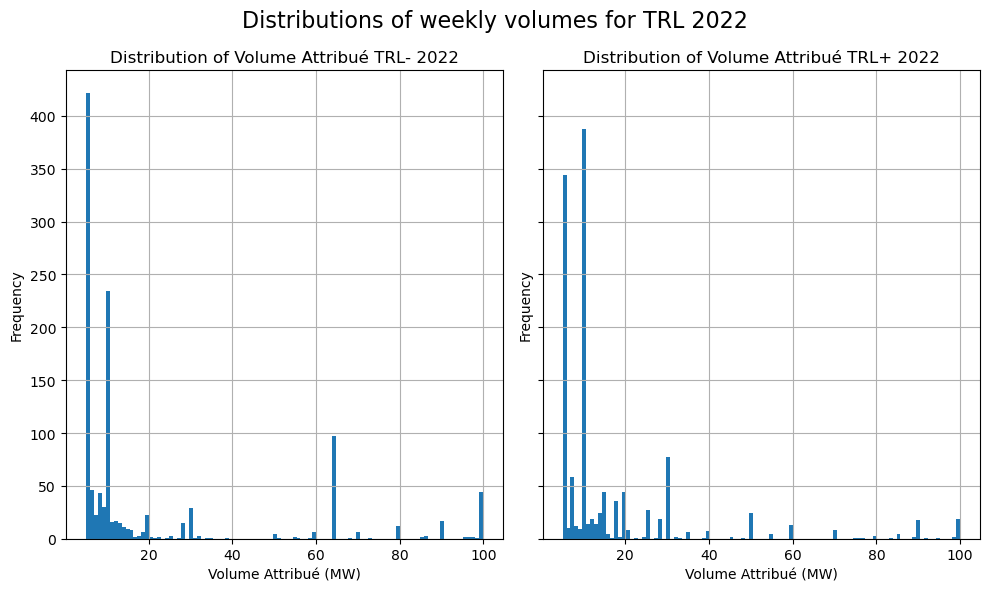

In [127]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW22['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2022')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(TPUW22['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2022')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of weekly volumes for TRL 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL_dist_2022.pdf', format='pdf')
plt.show()


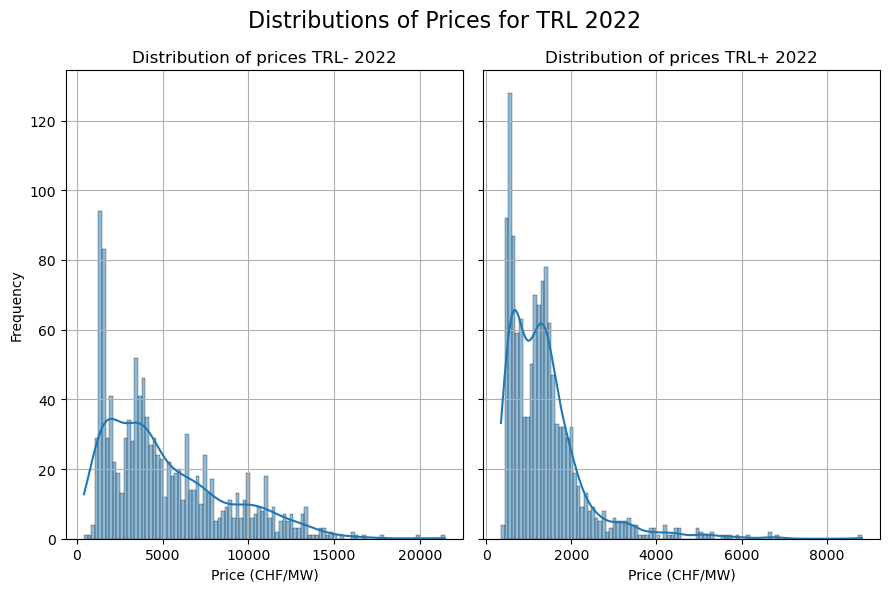

In [128]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW22['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2022')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW22['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2022')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL_dist_prices_2022.pdf', format='pdf')
plt.show()

In [129]:
tmp=TPDW22.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)


,count
Volume_attribué,
5,422
10,234
64,97
6,46
100,44
8,43
9,30
30,29
7,22


In [130]:
tmp=TPUW22.groupby('Volume_attribué').agg({'Volume_attribué': 'count'})
tmp.columns=['count']
tmp.sort_values(by='count', ascending=False).head(10)

,count
Volume_attribué,
10,388
5,344
30,77
7,58
20,44
15,44
18,36
25,27
50,24


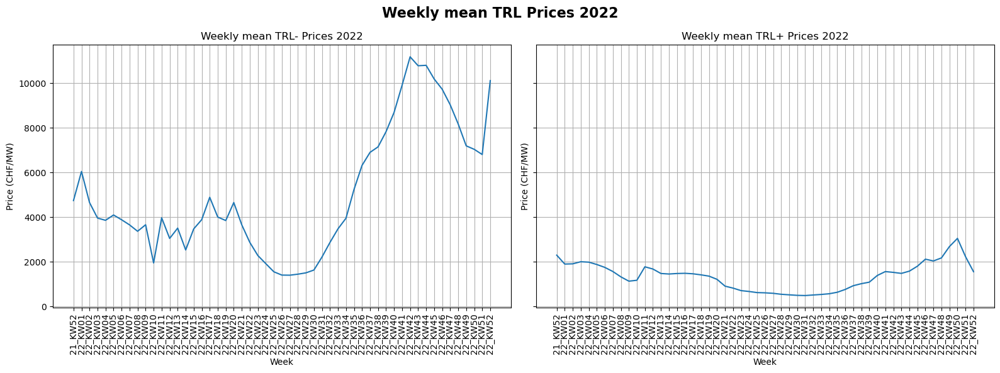

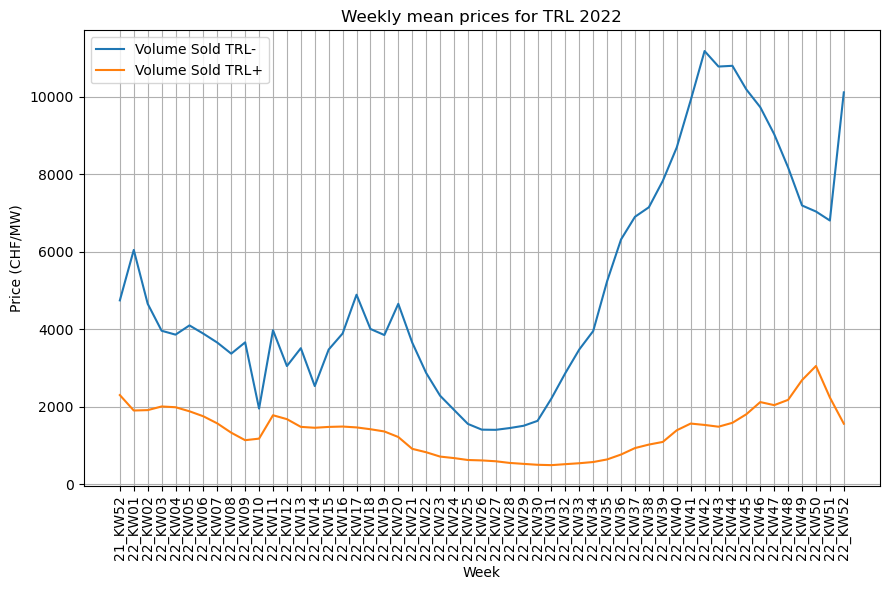

desription of TRL- prices:
 count       53.000000
mean      5035.411470
std       2867.827454
min       1402.665000
25%       3047.966522
50%       3958.766667
75%       7034.825000
max      11174.729600
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean     1360.031410
std       617.368965
min       491.676800
25%       765.453793
50%      1456.065455
75%      1778.678571
max      3049.269524
Name: Prix_prestation, dtype: float64


In [131]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW22.index, grouped_TPDW22['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2022')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW22.index, grouped_TPUW22['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2022')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2022', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW22.index, grouped_TPDW22['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW22.index, grouped_TPUW22['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2022')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2022/Weekly_TRL_Prices_combined_2022.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW22["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW22["Prix_prestation"].describe()}')

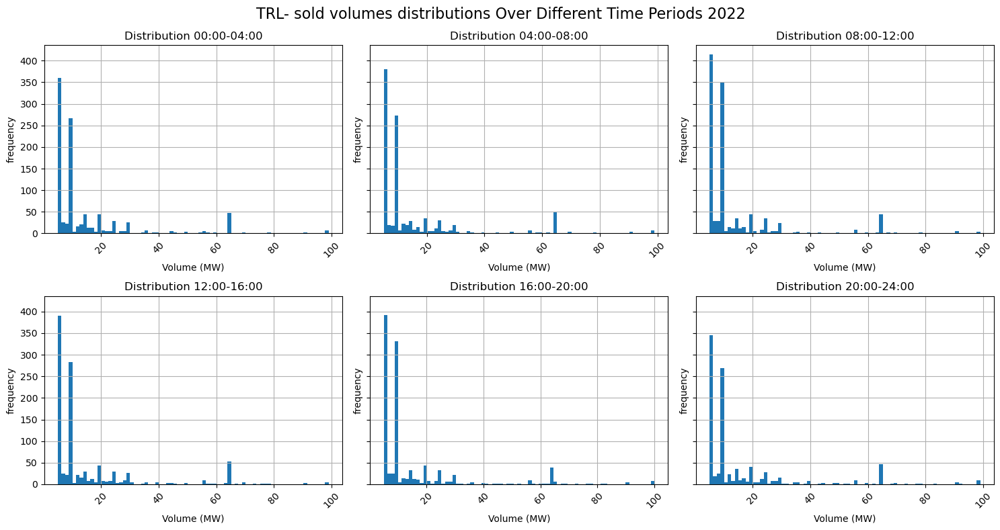

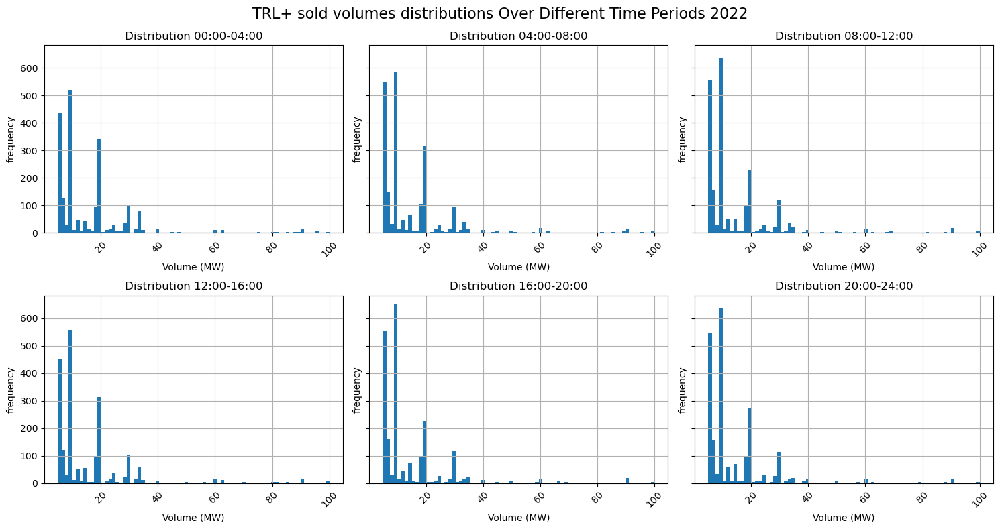

In [132]:
list_TPD22 = [TPD22_00_04, TPD22_04_08, TPD22_08_12, TPD22_12_16, TPD22_16_20, TPD22_20_24]

list_TPU22 = [TPU22_00_04, TPU22_04_08, TPU22_08_12, TPU22_12_16, TPU22_16_20, TPU22_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL-_dist_daily_2022.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL+_dist_daily_2022.pdf', format='pdf')
plt.show()

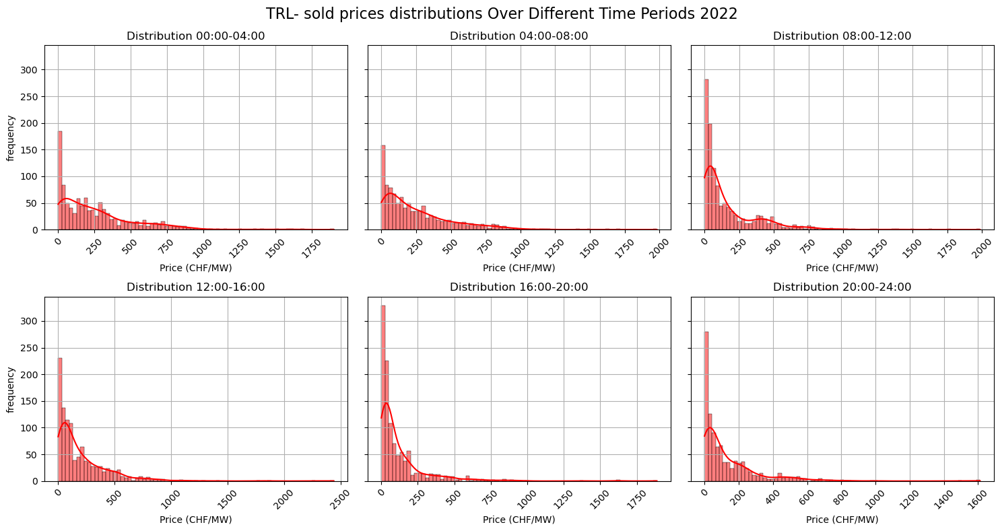

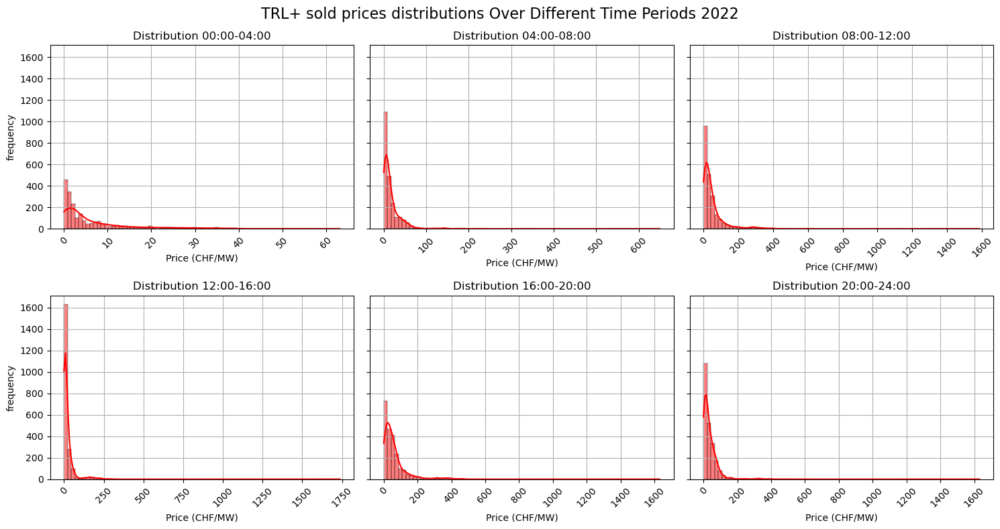

In [133]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL-_dist_prices_daily_2022.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL+_dist_prices_daily_2022.pdf', format='pdf')
plt.show()

max_volume=145
max_cost=195860.2


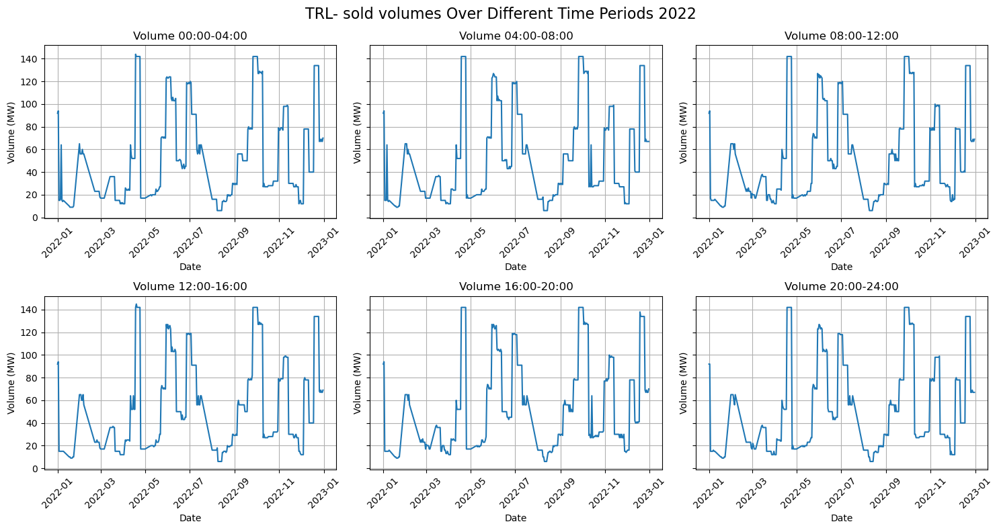

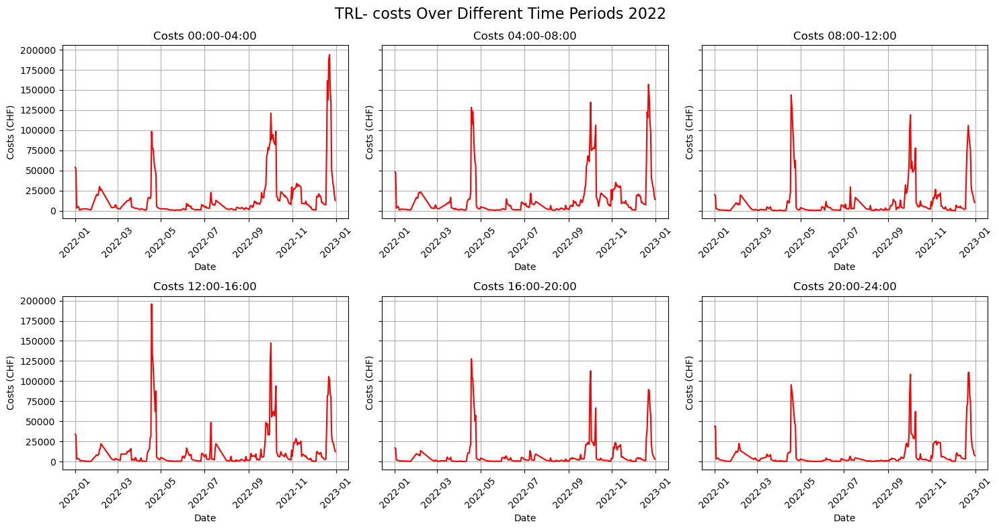

In [134]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


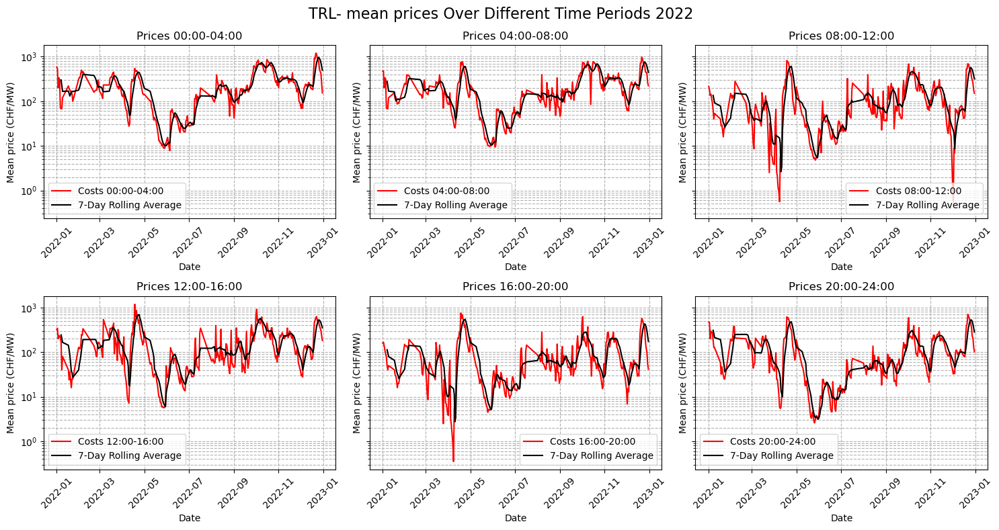

count     309.000000
mean      242.091672
std       215.553514
min         7.806667
25%        85.000000
50%       188.666667
75%       316.000000
max      1202.666667
Name: Prix_prestation, dtype: float64

count    309.000000
mean     219.203733
std      196.245417
min        9.400000
25%       71.350000
50%      157.105000
75%      300.000000
max      982.000000
Name: Prix_prestation, dtype: float64

count    309.000000
mean     122.926608
std      149.866761
min        0.560000
25%       28.000000
50%       64.460000
75%      166.000000
max      820.635556
Name: Prix_prestation, dtype: float64

count     309.000000
mean      168.302926
std       169.301917
min         5.700000
25%        46.000000
50%       111.000000
75%       239.000000
max      1184.455000
Name: Prix_prestation, dtype: float64

count    309.000000
mean      92.118775
std      117.934169
min        0.353333
25%       23.600000
50%       52.000000
75%      119.250000
max      753.508571
Name: Prix_prestation, dtype

In [135]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')
    
# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL-_mean_prices_periods_2022.pdf', format='pdf')

plt.show()

for group in grouped_TPD22:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=285
max_cost=111633.8


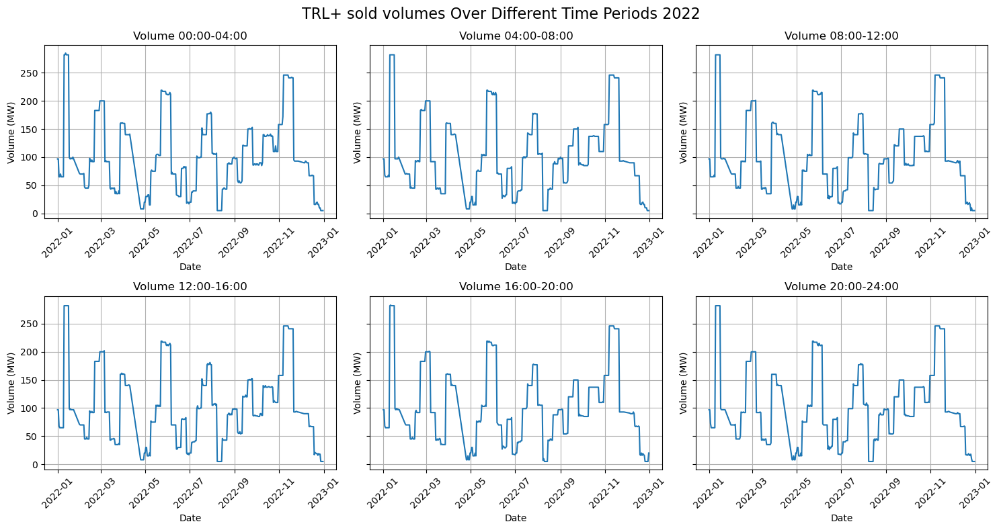

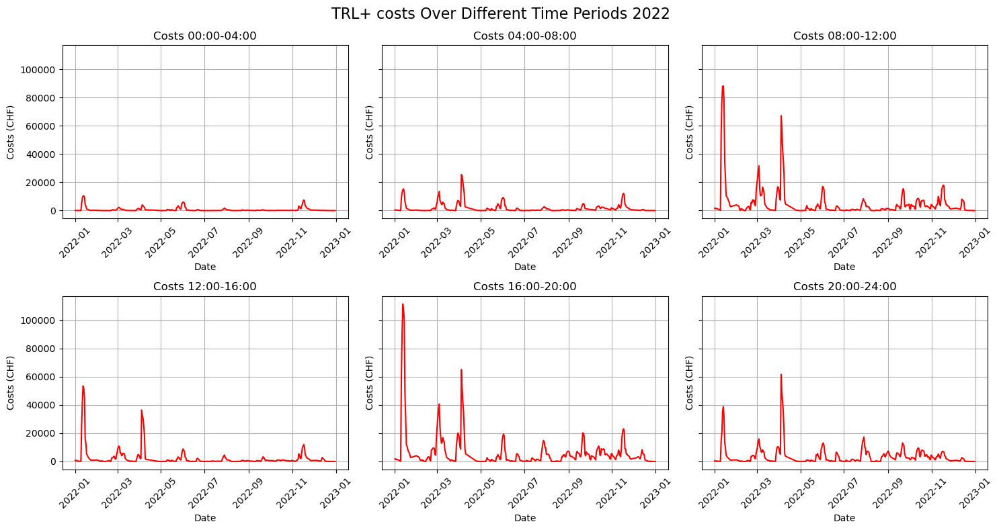

In [136]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.show()


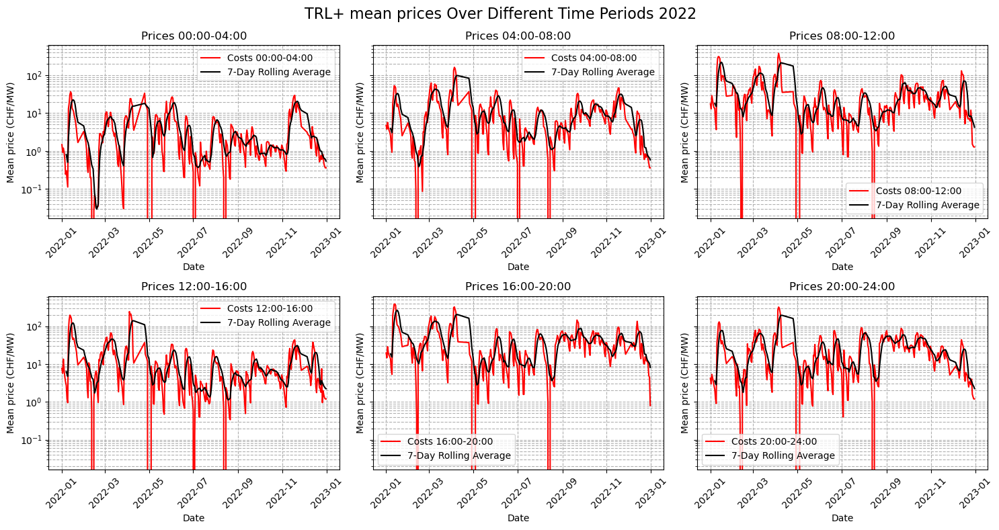

count    337.000000
mean       4.317327
std        6.342766
min        0.000000
25%        0.697500
50%        1.652222
75%        5.466667
max       36.672727
Name: Prix_prestation, dtype: float64

count    337.000000
mean      12.089880
std       18.894719
min        0.000000
25%        2.226667
50%        6.486667
75%       14.300000
max      162.727692
Name: Prix_prestation, dtype: float64

count    337.000000
mean      35.056492
std       52.207760
min        0.000000
25%        8.110000
50%       16.654000
75%       40.875000
max      379.538462
Name: Prix_prestation, dtype: float64

count    337.000000
mean      14.893924
std       30.593791
min        0.000000
25%        2.520000
50%        6.368889
75%       13.535000
max      243.034545
Name: Prix_prestation, dtype: float64

count    337.000000
mean      44.827054
std       56.213777
min        0.000000
25%       12.400000
50%       30.988889
75%       55.533333
max      386.250000
Name: Prix_prestation, dtype: float64

count

In [137]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU22):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
     # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')
    
# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2022', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2022/TRL+_mean_prices_periods_2022.pdf', format='pdf')
plt.show()

for group in grouped_TPU22:
    print(f'{group["Prix_prestation"].describe()}\n')

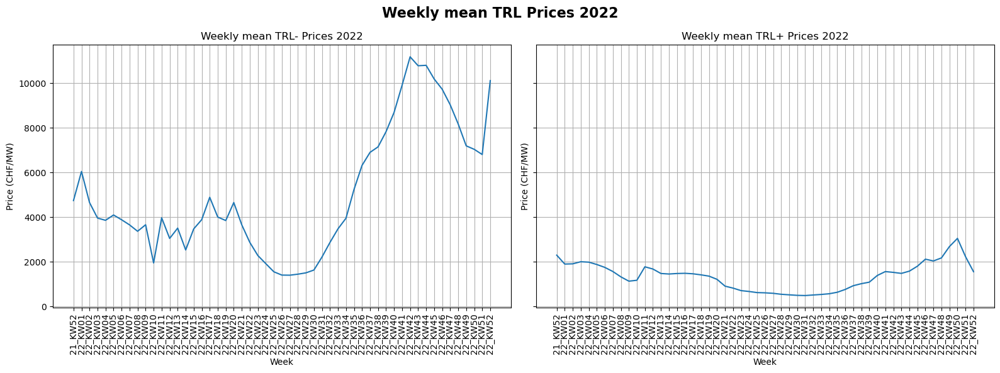

desription of TRL- prices:
 count       53.000000
mean      5035.411470
std       2867.827454
min       1402.665000
25%       3047.966522
50%       3958.766667
75%       7034.825000
max      11174.729600
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean     1360.031410
std       617.368965
min       491.676800
25%       765.453793
50%      1456.065455
75%      1778.678571
max      3049.269524
Name: Prix_prestation, dtype: float64


In [138]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW22.index, grouped_TPDW22['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2022')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW22.index, grouped_TPUW22['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2022')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2022', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW22["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW22["Prix_prestation"].describe()}')

max_volume=545
max_cost=5874582.5


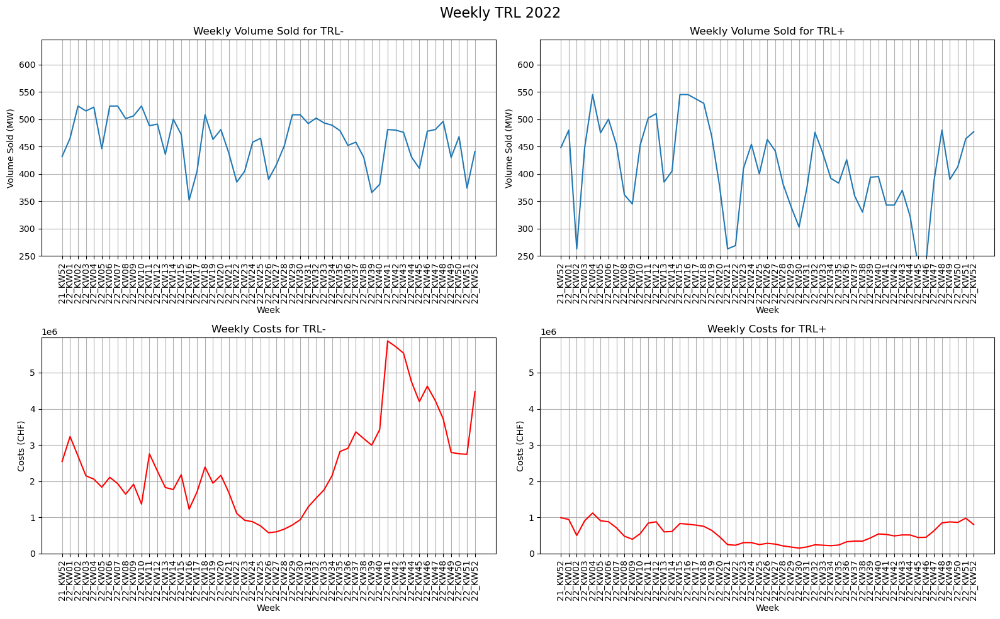

In [139]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW22])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW22])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW22.index, grouped_TPDW22['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW22.index, grouped_TPUW22['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW22.index, grouped_TPDW22['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW22.index, grouped_TPUW22['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2022', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2023

In [140]:
res23=pd.read_csv('./data/2023-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])
res23

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1258441169.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res23=pd.read_csv('./data/2023-PRL-SRL-TRL-Ergebnis.csv', sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'])


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.00,EUR/MW,400.00,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja
1,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.40,EUR/MW,54.40,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja
2,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.20,EUR/MW,51.20,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja
3,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.10,EUR/MW,66.10,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja
4,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.00,EUR/MW,425.00,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577553,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577554,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577555,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577556,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN


### keeping only the swiss data

In [141]:
res23_CH=res23[res23.Pays=='CH']

In [142]:
# res23_CH[res23_CH.Coûts==0]

In [143]:
res23_CH.Description.unique()

array(['Primary control Auction 00:00 bis 04:00',
       'Primary control Auction 04:00 bis 08:00',
       'Primary control Auction 08:00 bis 12:00',
       'Primary control Auction 12:00 bis 16:00',
       'Primary control Auction 16:00 bis 20:00',
       'Primary control Auction 20:00 bis 24:00',
       'Secondary control Auction SRL+', 'Secondary control Auction SRL-',
       'Tertiary Power DOWN', 'Tertiary Power UP',
       'Tertiary Power DOWN 00:00 bis 04:00',
       'Tertiary Power DOWN 04:00 bis 08:00',
       'Tertiary Power DOWN 08:00 bis 12:00',
       'Tertiary Power DOWN 12:00 bis 16:00',
       'Tertiary Power DOWN 16:00 bis 20:00',
       'Tertiary Power DOWN 20:00 bis 24:00',
       'Tertiary Power UP 00:00 bis 04:00',
       'Tertiary Power UP 04:00 bis 08:00',
       'Tertiary Power UP 08:00 bis 12:00',
       'Tertiary Power UP 12:00 bis 16:00',
       'Tertiary Power UP 16:00 bis 20:00',
       'Tertiary Power UP 20:00 bis 24:00'], dtype=object)

## Primary control Auction 2023

In [144]:
# Create DataFrame for Primary control
res23_CH_p = res23_CH[res23_CH['Description'].str.contains('Primary control')].copy()

print(res23_CH_p['Description'].unique())

['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00']


In [145]:
res23_CH_p


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.0,EUR/MW,400.0,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja
1,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.4,EUR/MW,54.4,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja
2,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.2,EUR/MW,51.2,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja
3,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.1,EUR/MW,66.1,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja
4,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.0,EUR/MW,425.0,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
525077,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,50.0,EUR/MW,150.0,EUR,15.00,EUR/MWh*,CH,12.50,EUR/MWh*,Ja
525078,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,42.0,EUR/MW,126.0,EUR,15.00,EUR/MWh*,CH,10.50,EUR/MWh*,Ja
525079,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,48.0,EUR/MW,144.0,EUR,15.00,EUR/MWh*,CH,12.00,EUR/MWh*,Ja
525080,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,52.0,EUR/MW,156.0,EUR,15.00,EUR/MWh*,CH,13.00,EUR/MWh*,Ja


In [146]:
res23_CH_p['date'] = pd.to_datetime(res23_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
# Set the date column as the index
#res23_CH_p.set_index('date', inplace=True)

res23_CH_p

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,date
0,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,80.0,EUR/MW,400.0,EUR,34.82,EUR/MWh*,CH,20.00,EUR/MWh*,Ja,2023-01-01
1,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,54.4,EUR/MW,54.4,EUR,34.82,EUR/MWh*,CH,13.60,EUR/MWh*,Ja,2023-01-01
2,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,51.2,EUR/MW,51.2,EUR,34.82,EUR/MWh*,CH,12.80,EUR/MWh*,Ja,2023-01-01
3,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,66.1,EUR/MW,66.1,EUR,34.82,EUR/MWh*,CH,16.52,EUR/MWh*,Ja,2023-01-01
4,PRL_23_01_01,Primary control Auction 00:00 bis 04:00,5,MW,5,MW,85.0,EUR/MW,425.0,EUR,34.82,EUR/MWh*,CH,21.25,EUR/MWh*,Ja,2023-01-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
525077,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,50.0,EUR/MW,150.0,EUR,15.00,EUR/MWh*,CH,12.50,EUR/MWh*,Ja,2023-12-31
525078,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,42.0,EUR/MW,126.0,EUR,15.00,EUR/MWh*,CH,10.50,EUR/MWh*,Ja,2023-12-31
525079,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,48.0,EUR/MW,144.0,EUR,15.00,EUR/MWh*,CH,12.00,EUR/MWh*,Ja,2023-12-31
525080,PRL_23_12_31,Primary control Auction 20:00 bis 24:00,3,MW,3,MW,52.0,EUR/MW,156.0,EUR,15.00,EUR/MWh*,CH,13.00,EUR/MWh*,Ja,2023-12-31


In [147]:
freq_2023_p = res23_CH_p['Volume_attribué'].value_counts()
freq_2023_p



Volume_attribué
1     29531
2      4869
5      3878
3      3843
4      2717
10     1576
6      1302
9       641
12      530
11      522
8       466
7       329
15      209
25      184
20       63
14       44
16       35
13       29
18       26
17       22
24       17
22       12
23        9
30        9
19        8
28        4
21        3
60        3
Name: count, dtype: int64

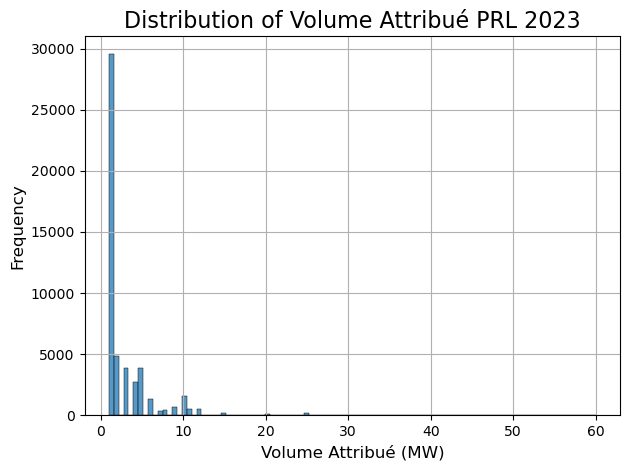

In [148]:
#plt.figure(figsize=(10, 6))
sns.histplot(res23_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2023', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.tight_layout()
plt.savefig('./gfx/2023/PRL_volume_2023.pdf', format='pdf')
plt.show()

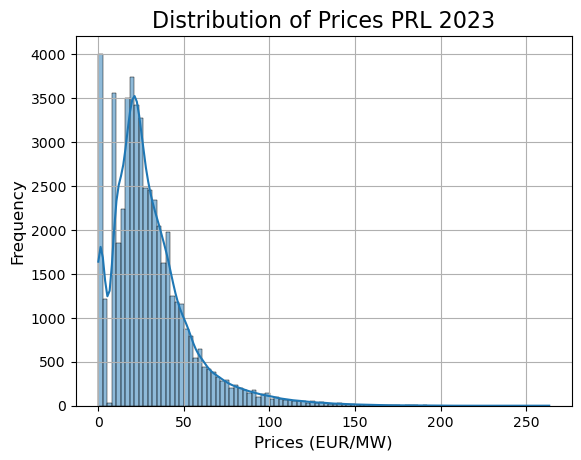

In [149]:
#plt.figure(figsize=(10, 6))
sns.histplot(res23_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2023', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2023/PRL_price_dist_2023.pdf', format='pdf')
plt.show()

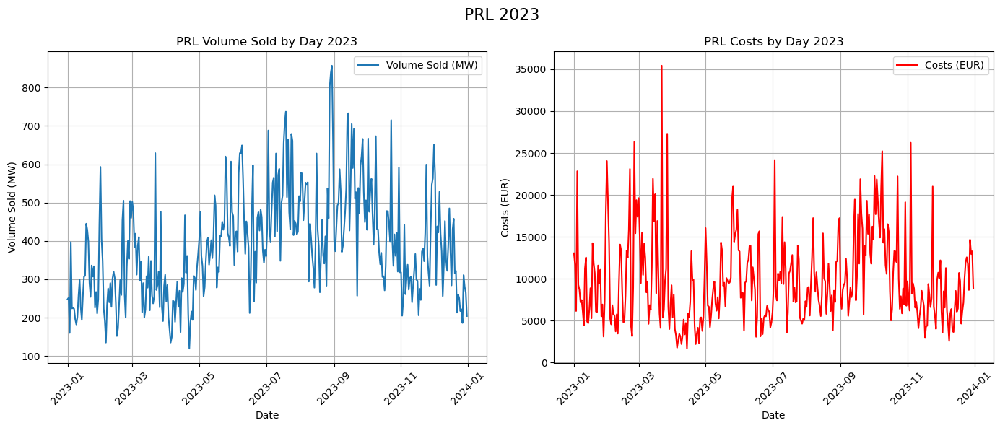

In [150]:
# Grouping by 'date' and summing the volume sold and costs
grouped_p23 = res23_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p23.index, grouped_p23['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2023')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p23.index, grouped_p23['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2023')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2023', fontsize=16)
plt.tight_layout()
plt.show()

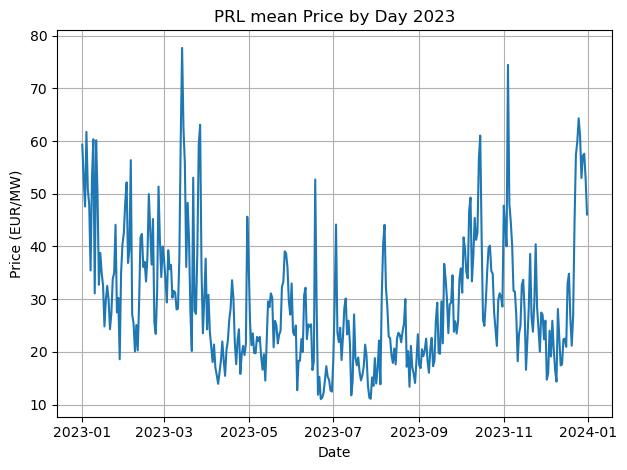

desription of PRL 2023 prices:
 count    365.000000
mean      29.440003
std       12.340130
min       11.039216
25%       20.502297
50%       26.642373
75%       35.557083
max       77.662761
Name: Prix_prestation, dtype: float64



In [151]:
plt.plot(grouped_p23.index, grouped_p23['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2023')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2023/PRL_mean_price_2023.pdf', format='pdf')
plt.show()

print(f'desription of PRL 2023 prices:\n {grouped_p23["Prix_prestation"].describe()}\n')

In [152]:
PRL23_0_4=res23_CH_p[res23_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL23_4_8=res23_CH_p[res23_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL23_8_12=res23_CH_p[res23_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL23_12_16=res23_CH_p[res23_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL23_16_20=res23_CH_p[res23_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL23_20_24=res23_CH_p[res23_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL23_0_4=PRL23_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_4_8=PRL23_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_8_12=PRL23_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_12_16=PRL23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_16_20=PRL23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_PRL23_20_24=PRL23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

# Grouped data list and labels
grouped_p23 = [grouped_PRL23_0_4, grouped_PRL23_4_8, grouped_PRL23_8_12, grouped_PRL23_12_16, grouped_PRL23_16_20, grouped_PRL23_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


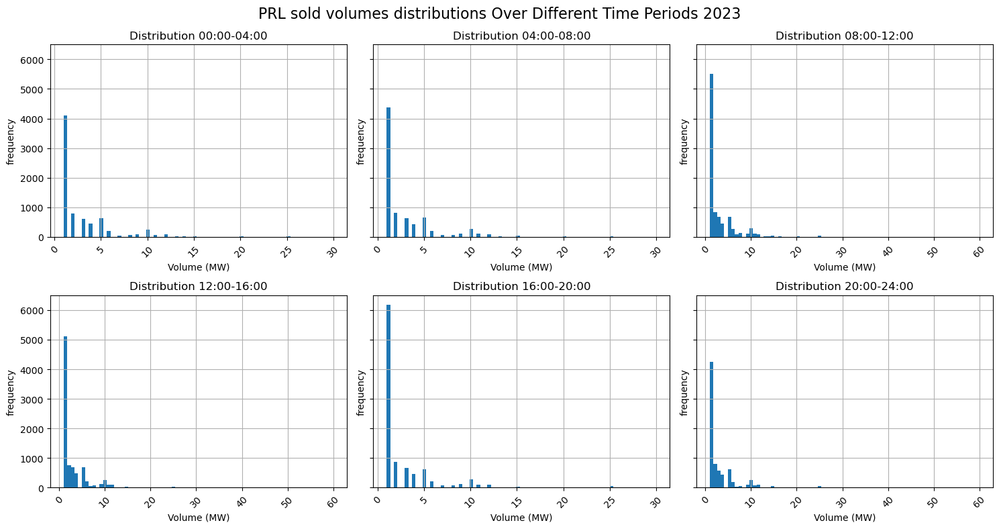

In [153]:

list_PRL23 = [PRL23_0_4, PRL23_4_8, PRL23_8_12, PRL23_12_16, PRL23_16_20, PRL23_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/PRL_volume_distributions_2023.pdf', format='pdf')
plt.show()

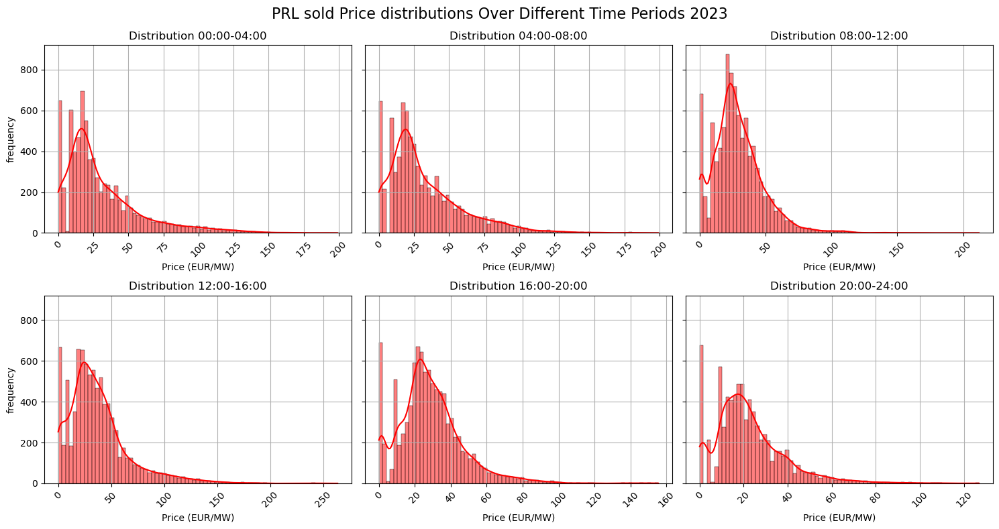

In [154]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, ax=ax, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (EUR/MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold Price distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/PRL_prices_distributions_2023.pdf', format='pdf')
plt.show()

max_volume=162, min volume= 19
max_cost=8926.36, min cost= 48.94


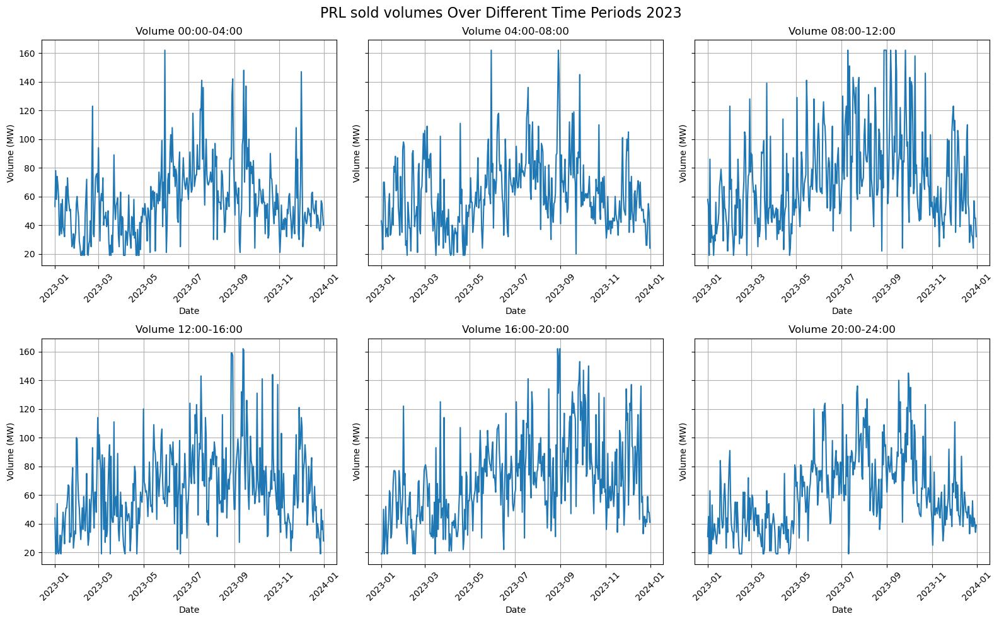

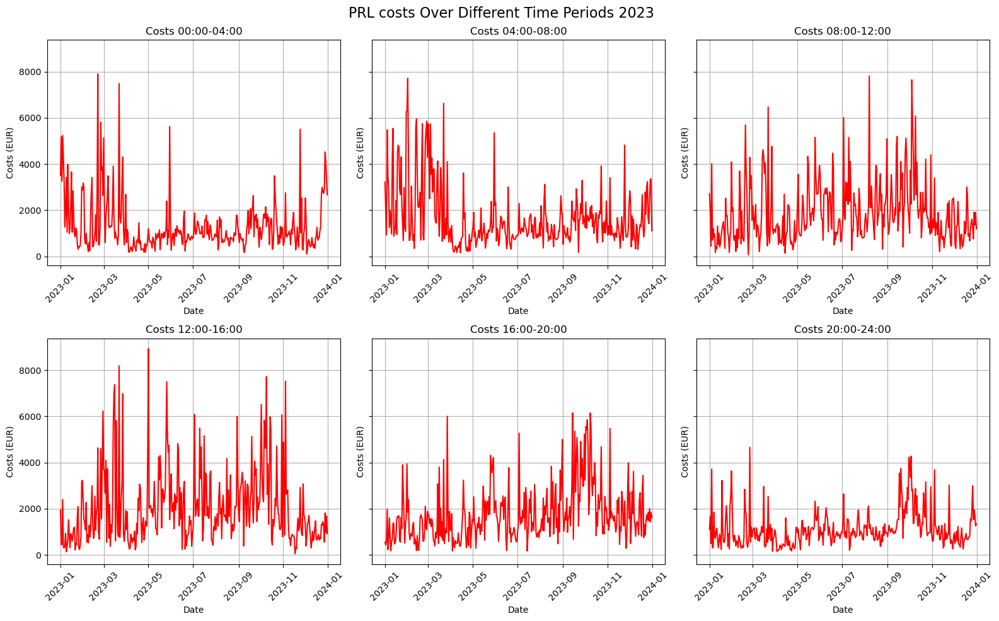

In [155]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p23])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p23])
min_cost = min([data['Coûts'].min() for data in grouped_p23])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


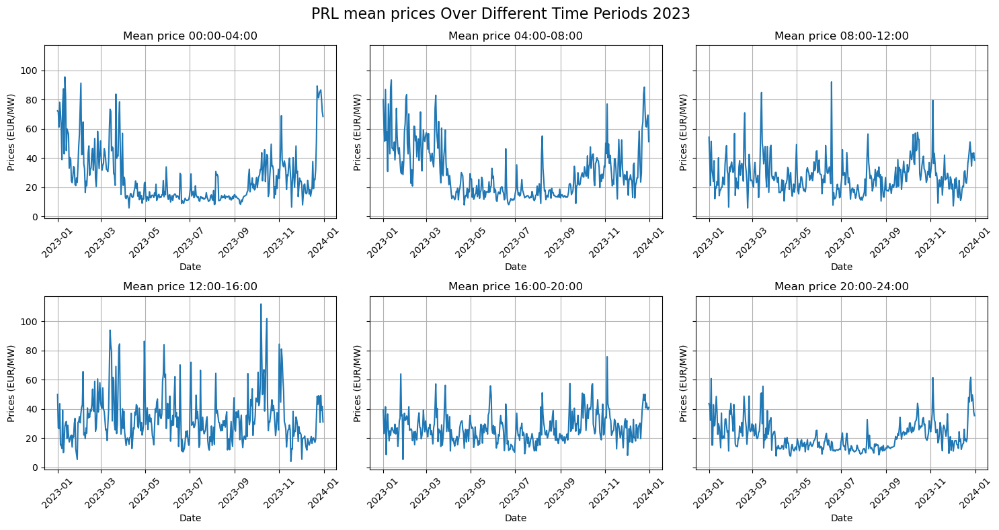

count    365.000000
mean      27.092312
std       18.738497
min        5.850000
25%       13.533333
50%       20.675000
75%       33.985849
max       95.515789
Name: Prix_prestation, dtype: float64
count    365.000000
mean      30.189493
std       18.040214
min        7.975000
25%       15.683810
50%       25.308421
75%       40.234118
max       93.466429
Name: Prix_prestation, dtype: float64
count    365.000000
mean      28.116474
std       11.843947
min        5.850000
25%       20.013667
50%       26.570588
75%       33.425357
max       92.121212
Name: Prix_prestation, dtype: float64
count    365.000000
mean      33.705799
std       16.974300
min        4.078333
25%       21.815000
50%       30.661111
75%       39.642857
max      111.832353
Name: Prix_prestation, dtype: float64
count    365.000000
mean      27.061688
std       10.010759
min        5.450000
25%       20.426471
50%       25.592000
75%       32.028000
max       75.783134
Name: Prix_prestation, dtype: float64
count    3

In [156]:
fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/2023/PRL_mean_prices_periods_2023.pdf', format='pdf')
plt.show()

for group in grouped_p23:
    print(group['Prix_prestation'].describe())

## Secondary control auction 2023

In [157]:
# Create DataFrame for Secondary control
res23_CH_s = res23_CH[res23_CH['Description'].str.contains('Secondary control')].copy()

print(res23_CH_s['Description'].unique())
print(res23_CH_s.Appel_offres.unique())

['Secondary control Auction SRL+' 'Secondary control Auction SRL-']
['SRL_22_KW52' 'SRL_22_KW52_S1' 'SRL_22_KW52_S2' 'SRL_22_KW52_S3'
 'SRL_22_KW52_S4' 'SRL_23_KW01' 'SRL_23_KW01_S1' 'SRL_23_KW01_S2'
 'SRL_23_KW01_S3' 'SRL_23_KW01_S4' 'SRL_23_KW02' 'SRL_23_KW02_S1'
 'SRL_23_KW02_S2' 'SRL_23_KW02_S3' 'SRL_23_KW02_S4' 'SRL_23_KW03'
 'SRL_23_KW03_S1' 'SRL_23_KW03_S2' 'SRL_23_KW03_S3' 'SRL_23_KW03_S4'
 'SRL_23_KW04_S1' 'SRL_23_KW04_S2' 'SRL_23_KW04_S3' 'SRL_23_KW04_S4'
 'SRL_23_KW04_S5' 'SRL_23_KW05_S1' 'SRL_23_KW05_S2' 'SRL_23_KW05_S3'
 'SRL_23_KW05_S4' 'SRL_23_KW05_S5' 'SRL_23_KW06_S1' 'SRL_23_KW06_S2'
 'SRL_23_KW06_S3' 'SRL_23_KW06_S4' 'SRL_23_KW06_S5' 'SRL_23_KW07_S1'
 'SRL_23_KW07_S2' 'SRL_23_KW07_S3' 'SRL_23_KW07_S4' 'SRL_23_KW07_S5'
 'SRL_23_KW08_S1' 'SRL_23_KW08_S2' 'SRL_23_KW08_S3' 'SRL_23_KW08_S4'
 'SRL_23_KW08_S5' 'SRL_23_KW09_S1' 'SRL_23_KW09_S2' 'SRL_23_KW09_S3'
 'SRL_23_KW09_S4' 'SRL_23_KW09_S5' 'SRL_23_KW10_S1' 'SRL_23_KW10_S2'
 'SRL_23_KW10_S3' 'SRL_23_KW10_S4' 'SRL_23_KW10

In [158]:
res23_CH_s['Week'] = res23_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

### grouping the data

In [159]:
SRL23m=res23_CH_s[res23_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL23p=res23_CH_s[res23_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL23m=SRL23m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL23p=SRL23p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL23=[grouped_SRL23m, grouped_SRL23p]

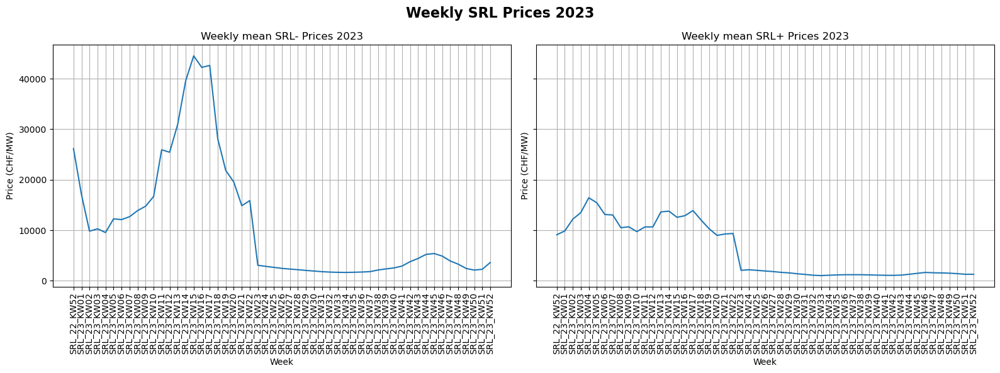

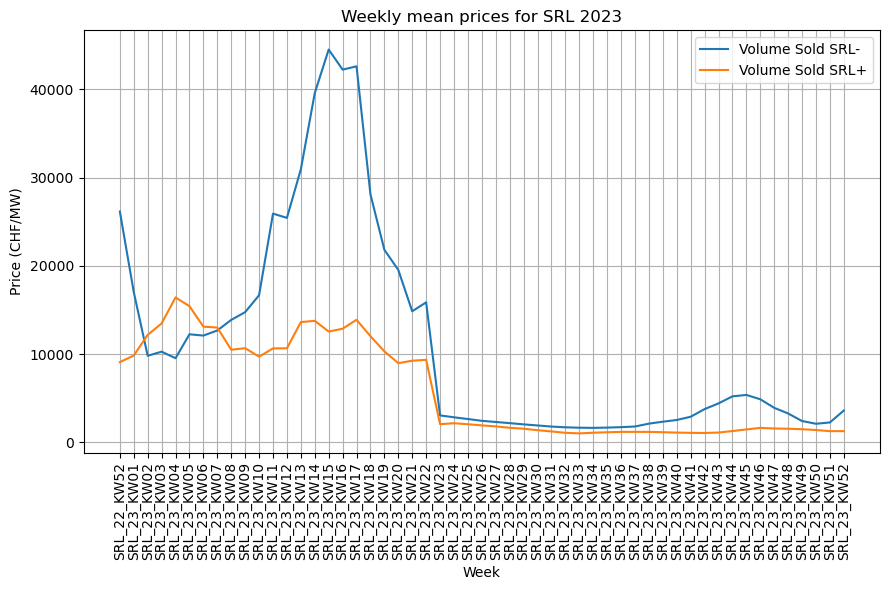

desription of SRL- prices:
 count       53.000000
mean     11118.847874
std      12144.851575
min       1645.713333
25%       2313.259259
50%       4417.619412
75%      15869.388372
max      44518.745227
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count       53.000000
mean      5920.096551
std       5384.289179
min       1018.852500
25%       1273.620000
50%       1927.644444
75%      10661.565714
max      16427.243846
Name: Prix_prestation, dtype: float64


In [160]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL23m.index, grouped_SRL23m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2023')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL23p.index, grouped_SRL23p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2023')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2023', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL23m.index, grouped_SRL23m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL23p.index, grouped_SRL23p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2023')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2023/Weekly_SRL_Prices_combined_2023.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL23m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL23p["Prix_prestation"].describe()}')

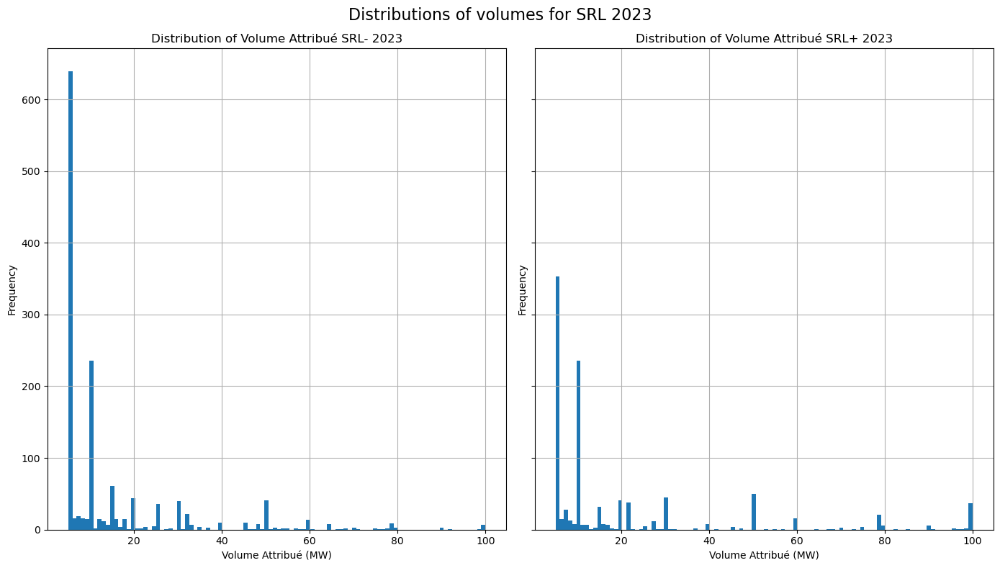

In [161]:
fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL23m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2023')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL23p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2023')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of volumes for SRL 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/SRL_dist_2023.pdf', format='pdf')
plt.show()

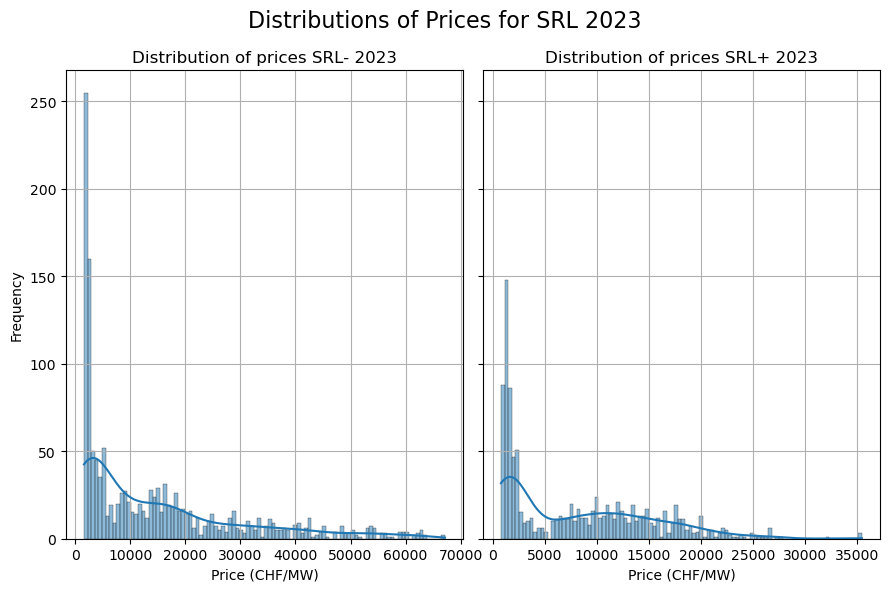

In [162]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL23m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2023')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL23p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2023')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/SRL_dist_prices_2023.pdf', format='pdf')
plt.show()

In [163]:
SRL23m['Volume_attribué'].value_counts().head(10)

Volume_attribué
5     639
10    236
15     61
20     44
50     41
30     40
25     36
32     22
7      19
8      16
Name: count, dtype: int64

In [164]:
SRL23p['Volume_attribué'].value_counts().head(10)

Volume_attribué
5      353
10     236
50      50
30      45
20      41
22      38
100     37
15      32
7       28
79      21
Name: count, dtype: int64

### plotting results

max_volume=507, min volume= 399
max_cost=16399488.95, min cost= 436225.72


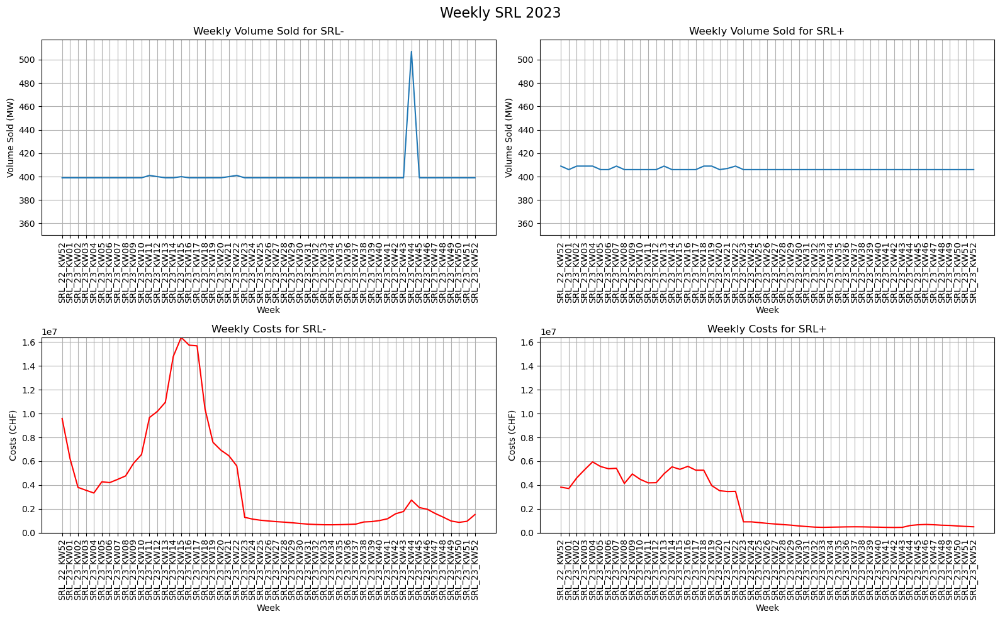

In [165]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL23])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL23])
min_cost = min([data['Coûts'].min() for data in grouped_SRL23])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL23m.index, grouped_SRL23m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL23p.index, grouped_SRL23p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL23m.index, grouped_SRL23m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL23p.index, grouped_SRL23p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2023', fontsize=16)
plt.tight_layout()
plt.show()


## Tertiary control auction 2023

In [166]:
# Create DataFrame for Tertiary control
res23_CH_t = res23_CH[res23_CH['Description'].str.contains('Tertiary Power')].copy()

print(res23_CH_t['Description'].unique())

['Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


In [167]:
res23_CH_t

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
527787,TRL-_22_KW52,Tertiary Power DOWN,5,MW,5,MW,7971.00,CHF/MW,39855.00,CHF,47.45,CHF/MWh*,CH,47.45,CHF/MWh*,NaN
527788,TRL-_22_KW52,Tertiary Power DOWN,5,MW,0,MW,23456.00,CHF/MW,0.00,CHF,139.62,CHF/MWh*,CH,139.62,CHF/MWh*,NaN
527789,TRL-_22_KW52,Tertiary Power DOWN,8,MW,8,MW,3874.00,CHF/MW,30992.00,CHF,23.06,CHF/MWh*,CH,23.06,CHF/MWh*,NaN
527790,TRL-_22_KW52,Tertiary Power DOWN,65,MW,64,MW,7778.40,CHF/MW,497817.60,CHF,46.30,CHF/MWh*,CH,46.30,CHF/MWh*,NaN
527791,TRL-_22_KW52,Tertiary Power DOWN,28,MW,28,MW,3837.00,CHF/MW,107436.00,CHF,22.84,CHF/MWh*,CH,22.84,CHF/MWh*,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
577553,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577554,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577555,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,5,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN
577556,TRL+_23_12_31,Tertiary Power UP 20:00 bis 24:00,7,MW,0,MW,1.64,CHF/MW,0.00,CHF,0.41,CHF/MWh*,CH,0.41,CHF/MWh*,NaN


In [168]:
res23_CH_t= res23_CH_t[res23_CH_t['Volume_attribué'] != 0]

TPDW23=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW23=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP'].copy()

TPD23_00_04=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD23_04_08=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD23_08_12=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD23_12_16=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD23_16_20=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD23_20_24=res23_CH_t[res23_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU23_00_04=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU23_04_08=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU23_08_12=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU23_12_16=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU23_16_20=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU23_20_24=res23_CH_t[res23_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()


TPDW23['Week']=TPDW23['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW23['Week']=TPUW23['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]


grouped_TPDW23=TPDW23.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPUW23=TPUW23.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})


TPD23_00_04['date'] = pd.to_datetime(TPD23_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_04_08['date'] = pd.to_datetime(TPD23_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_08_12['date'] = pd.to_datetime(TPD23_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_12_16['date'] = pd.to_datetime(TPD23_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_16_20['date'] = pd.to_datetime(TPD23_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD23_20_24['date'] = pd.to_datetime(TPD23_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU23_00_04['date'] = pd.to_datetime(TPU23_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_04_08['date'] = pd.to_datetime(TPU23_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_08_12['date'] = pd.to_datetime(TPU23_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_12_16['date'] = pd.to_datetime(TPU23_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_16_20['date'] = pd.to_datetime(TPU23_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU23_20_24['date'] = pd.to_datetime(TPU23_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')


grouped_TPD23_00_04=TPD23_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_04_08=TPD23_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_08_12=TPD23_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_12_16=TPD23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_16_20=TPD23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPD23_20_24=TPD23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_TPU23_00_04=TPU23_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_04_08=TPU23_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_08_12=TPU23_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_12_16=TPU23_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_16_20=TPU23_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_TPU23_20_24=TPU23_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

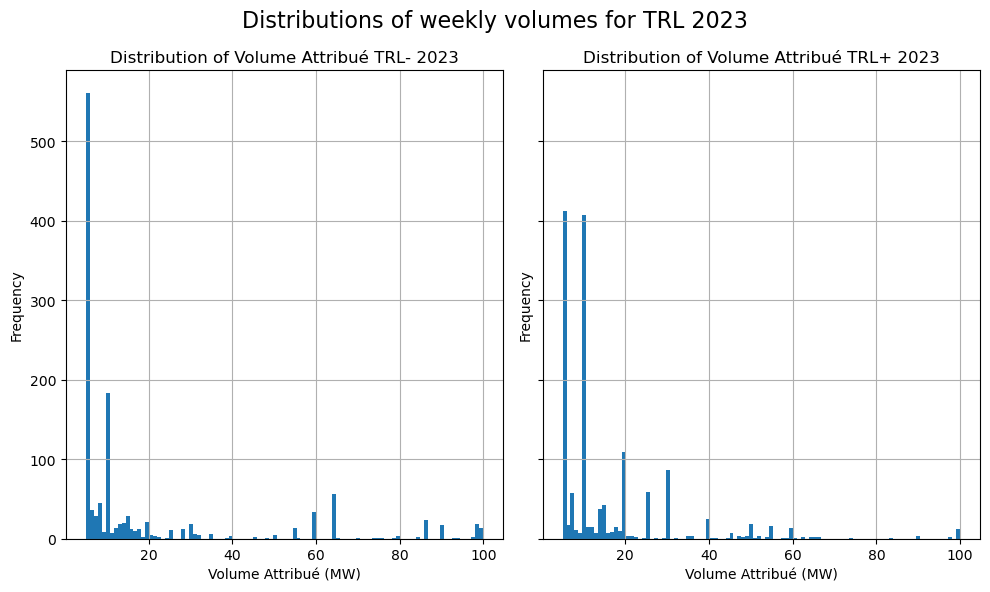

In [169]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW23['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2023')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(TPUW23['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2023')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of weekly volumes for TRL 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL_dist_2023.pdf', format='pdf')
plt.show()


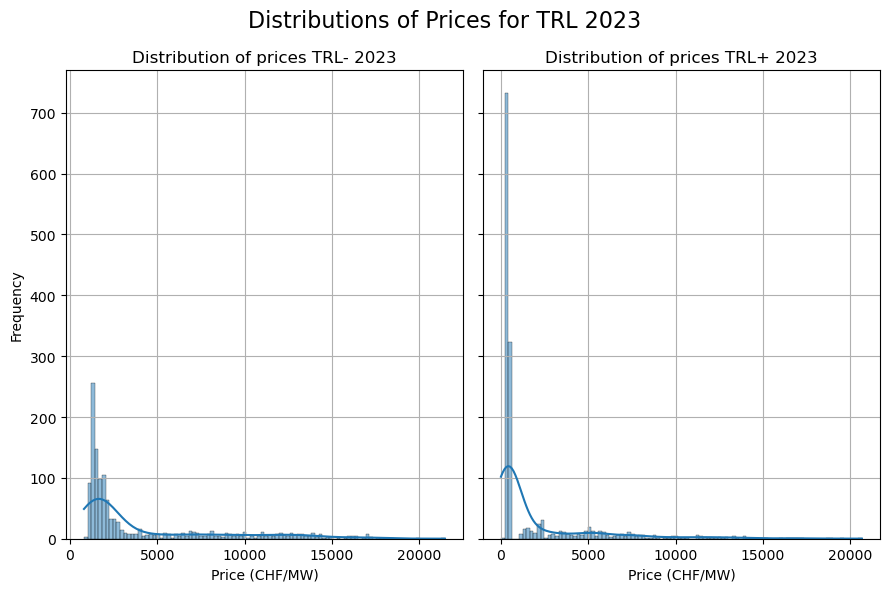

In [170]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW23['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2023')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW23['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2023')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL_dist_prices_2023.pdf', format='pdf')
plt.show()

In [171]:
TPDW23['Volume_attribué'].value_counts().head(10)

Volume_attribué
5     561
10    183
64     56
8      45
6      36
60     34
7      29
15     28
86     23
20     21
Name: count, dtype: int64

In [172]:
TPUW23['Volume_attribué'].value_counts().head(10)

Volume_attribué
5     412
10    407
20    109
30     87
25     59
7      57
15     42
14     37
40     25
50     19
Name: count, dtype: int64

In [173]:
# Grouped data list and labels
grouped_TPD23 = [grouped_TPD23_00_04, grouped_TPD23_04_08, grouped_TPD23_08_12, grouped_TPD23_12_16, grouped_TPD23_16_20, grouped_TPD23_20_24]

grouped_TPU23 = [grouped_TPU23_00_04, grouped_TPU23_04_08, grouped_TPU23_08_12, grouped_TPU23_12_16, grouped_TPU23_16_20, grouped_TPU23_20_24]

grouped_TPW23=[grouped_TPDW23, grouped_TPUW23]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

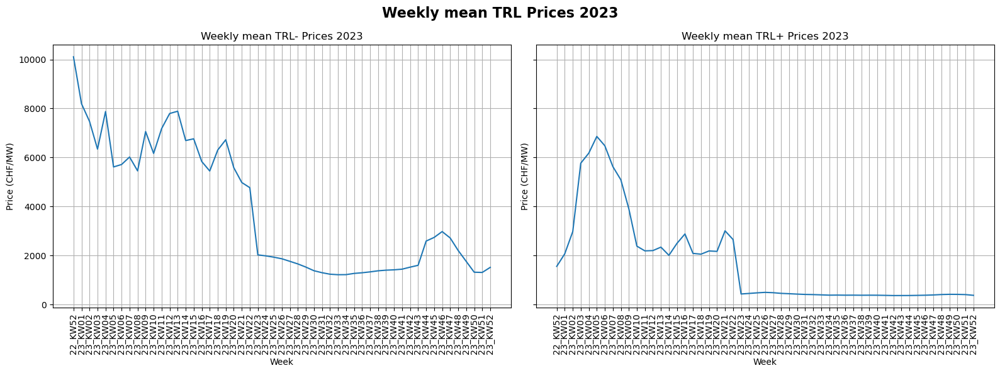

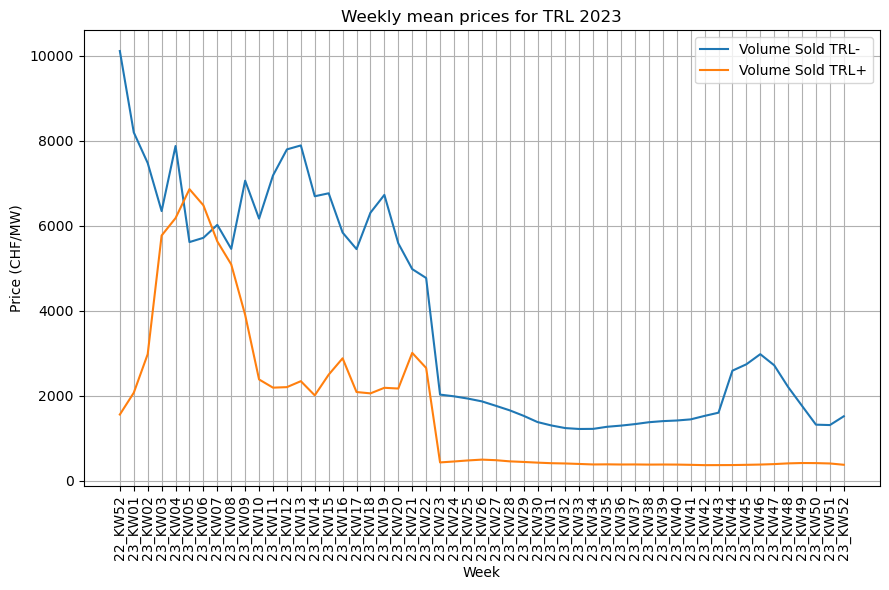

desription of TRL- prices:
 count       53.000000
mean      3830.713337
std       2611.263913
min       1220.801905
25%       1446.577143
50%       2592.130000
75%       6168.152222
max      10108.536000
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean     1689.355797
std      1842.710980
min       370.461500
25%       389.234118
50%       459.499167
75%      2344.977143
max      6860.415128
Name: Prix_prestation, dtype: float64


In [174]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW23.index, grouped_TPDW23['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2023')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW23.index, grouped_TPUW23['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2023')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2023', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW23.index, grouped_TPDW23['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW23.index, grouped_TPUW23['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2023')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2023/Weekly_TRL_Prices_combined_2023.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW23["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW23["Prix_prestation"].describe()}')

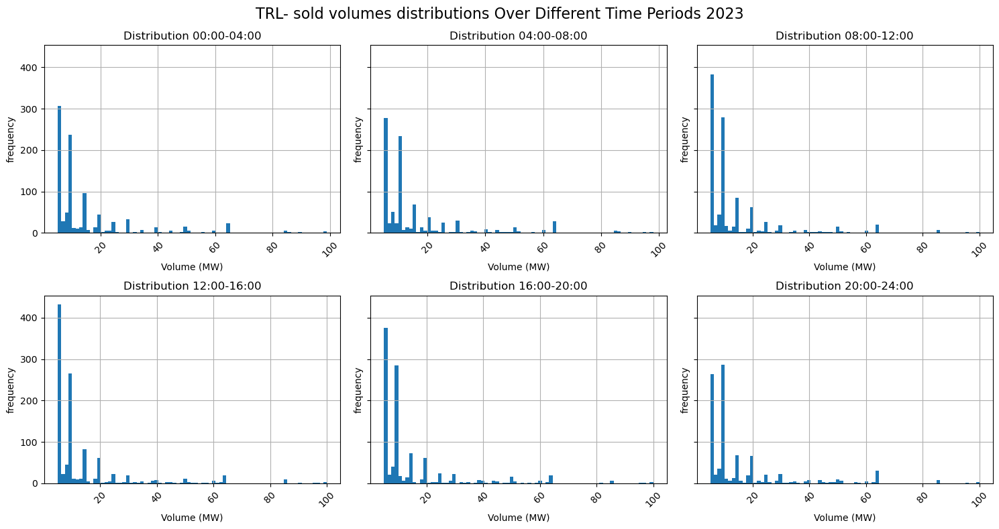

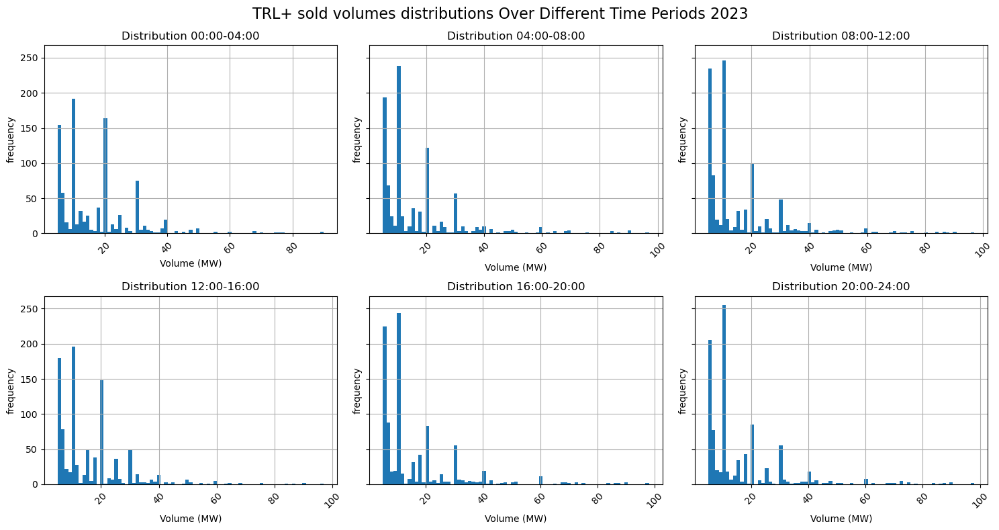

In [175]:
list_TPD23 = [TPD23_00_04, TPD23_04_08, TPD23_08_12, TPD23_12_16, TPD23_16_20, TPD23_20_24]

list_TPU23 = [TPU23_00_04, TPU23_04_08, TPU23_08_12, TPU23_12_16, TPU23_16_20, TPU23_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL-_dist_daily_2023.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL+_dist_daily_2023.pdf', format='pdf')
plt.show()

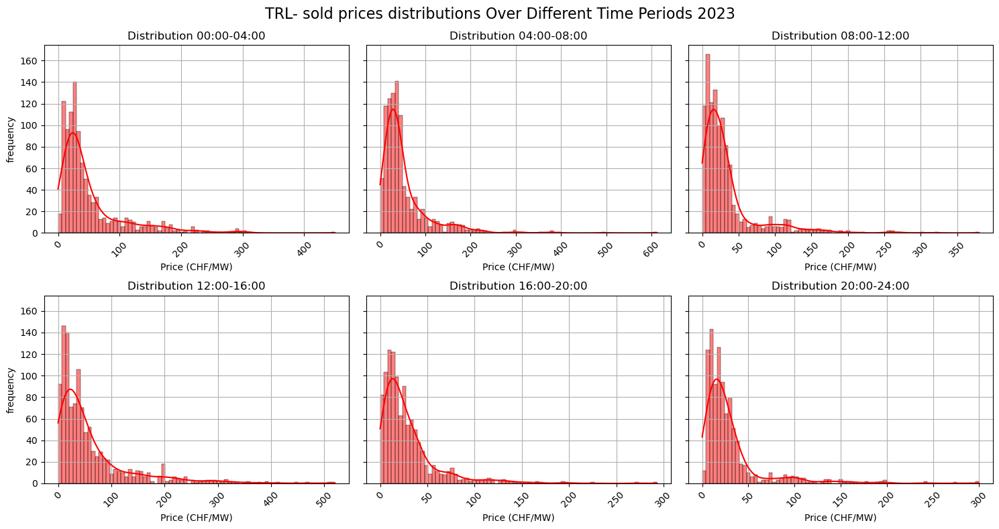

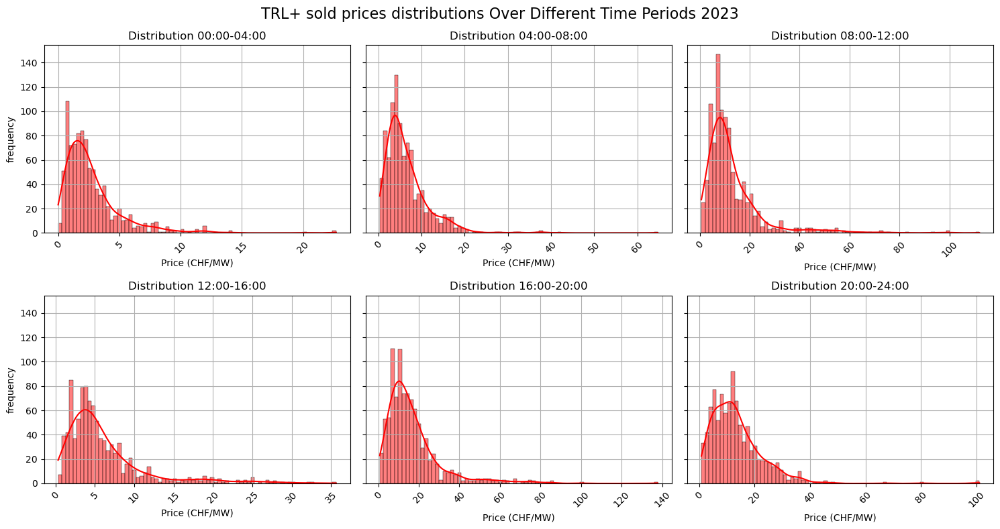

In [176]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL-_dist_prices_daily_2023.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL+_dist_prices_daily_2023.pdf', format='pdf')
plt.show()

max_volume=219
max_cost=47295.2


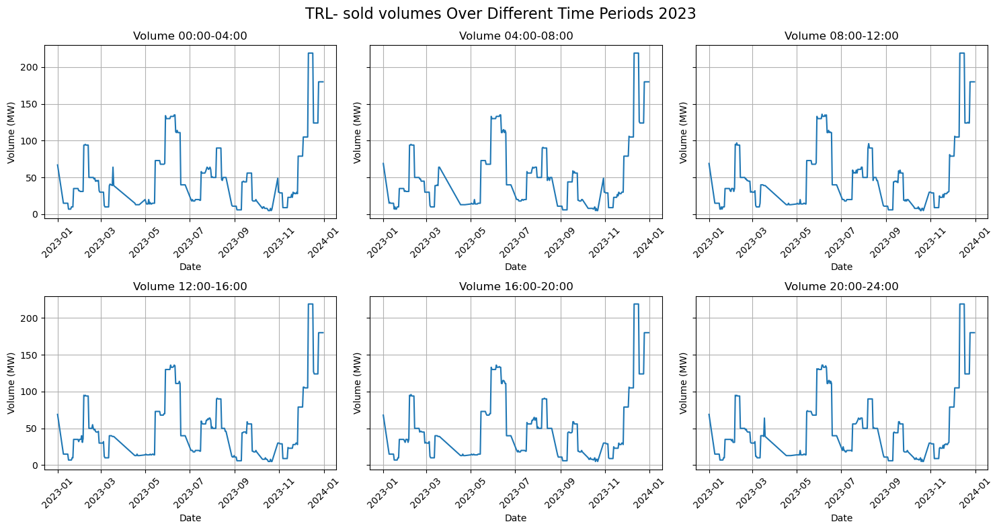

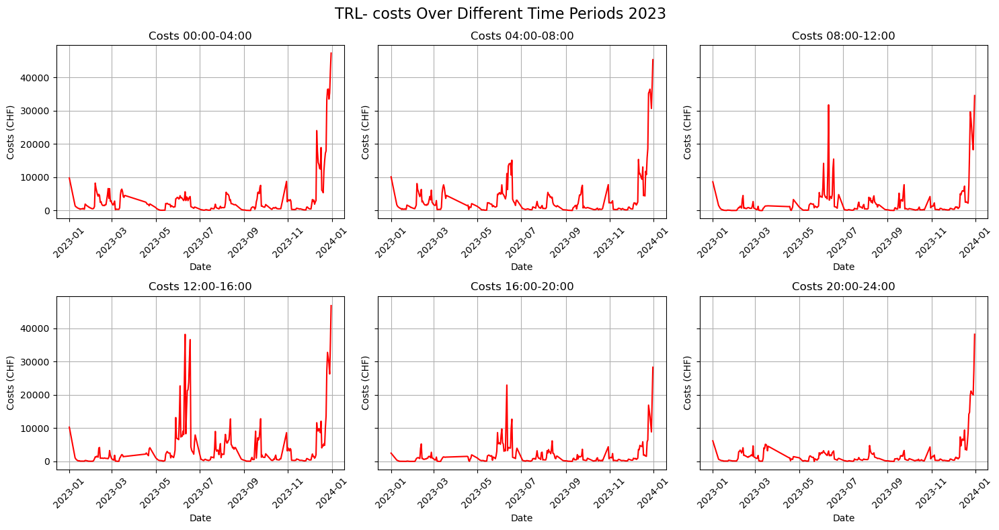

In [177]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


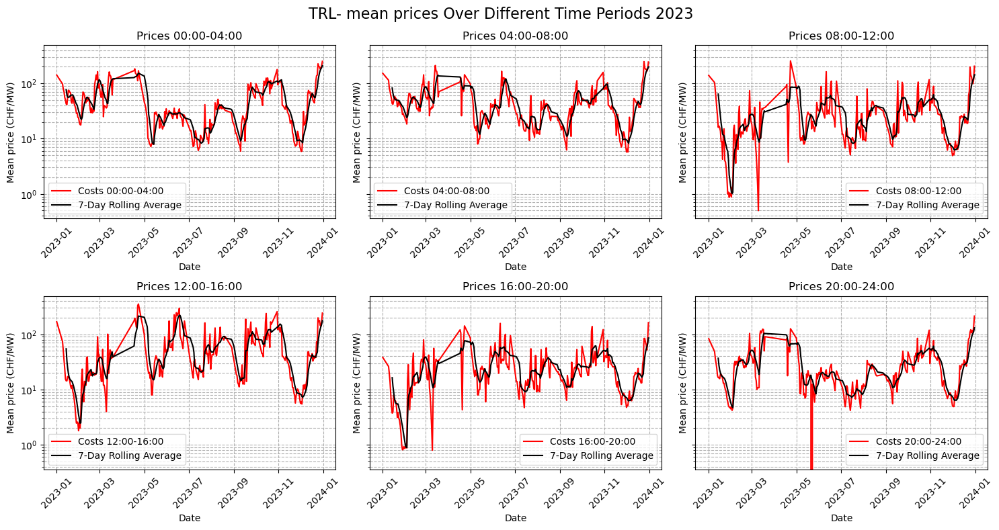

count    295.000000
mean      49.642736
std       46.085846
min        5.880000
25%       18.000000
50%       32.900000
75%       66.748667
max      251.520000
Name: Prix_prestation, dtype: float64

count    295.000000
mean      48.934482
std       41.912418
min        5.740000
25%       20.145556
50%       38.000000
75%       57.751190
max      248.262222
Name: Prix_prestation, dtype: float64

count    295.000000
mean      30.645366
std       33.951431
min        0.500000
25%       10.285000
50%       21.000000
75%       35.770000
max      256.000000
Name: Prix_prestation, dtype: float64

count    295.000000
mean      57.497775
std       61.415711
min        1.800000
25%       16.530000
50%       36.533333
75%       76.163333
max      354.000000
Name: Prix_prestation, dtype: float64

count    295.000000
mean      26.634962
std       26.098933
min        0.800000
25%       10.807692
50%       19.093333
75%       32.985000
max      163.313333
Name: Prix_prestation, dtype: float64

count

In [178]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
   # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')


# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL-_mean_prices_periods_2023.pdf', format='pdf')
plt.show()

for group in grouped_TPD23:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=118
max_cost=6743.95


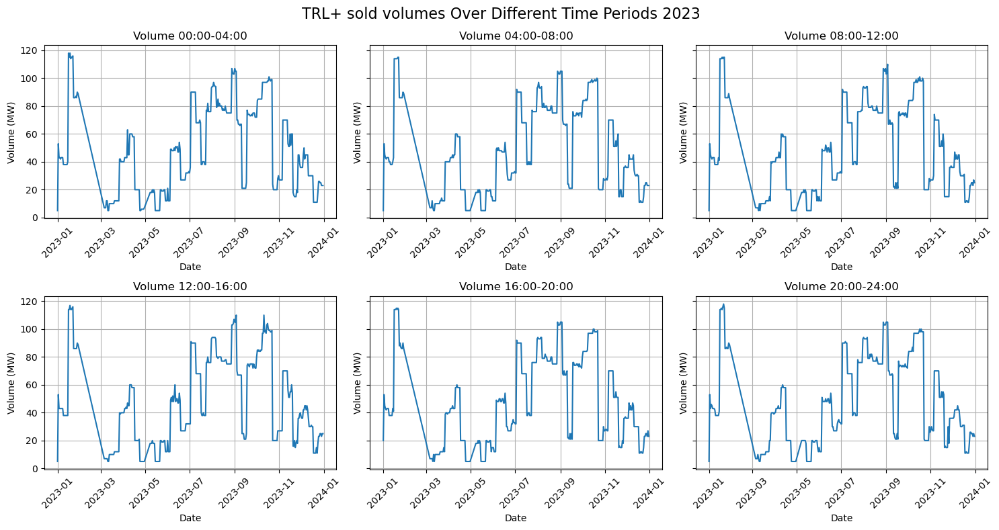

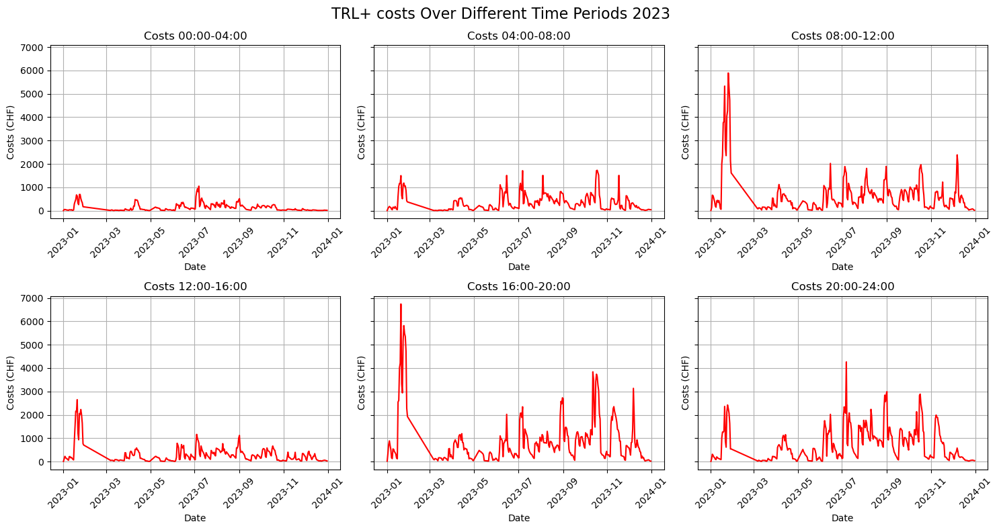

In [179]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.show()


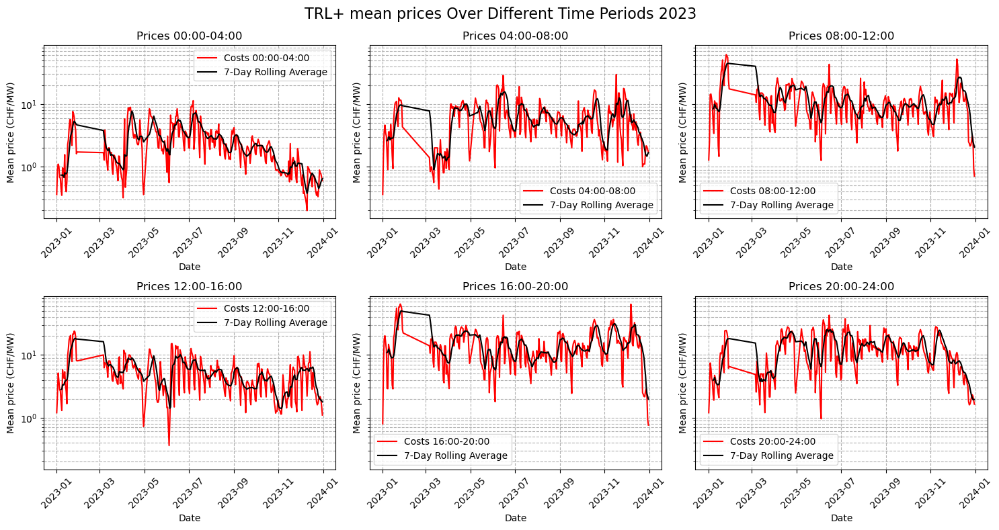

count    323.000000
mean       2.482102
std        2.026194
min        0.200000
25%        0.930000
50%        1.920000
75%        3.213000
max       11.315000
Name: Prix_prestation, dtype: float64

count    323.000000
mean       6.008604
std        4.457171
min        0.360000
25%        2.925000
50%        4.723333
75%        8.016667
max       29.632500
Name: Prix_prestation, dtype: float64

count    323.000000
mean      11.936063
std        8.934544
min        0.710000
25%        6.590000
50%       10.220000
75%       14.930000
max       61.643333
Name: Prix_prestation, dtype: float64

count    323.000000
mean       5.394985
std        3.873928
min        0.360000
25%        2.710000
50%        4.413333
75%        6.900000
max       24.031429
Name: Prix_prestation, dtype: float64

count    323.000000
mean      15.322032
std       10.414693
min        0.760000
25%        8.295000
50%       13.950000
75%       19.400000
max       64.916000
Name: Prix_prestation, dtype: float64

count

In [180]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU23):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
     # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2023', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2023/TRL+_mean_prices_periods_2023.pdf', format='pdf')
plt.show()

for group in grouped_TPU23:
    print(f'{group["Prix_prestation"].describe()}\n')

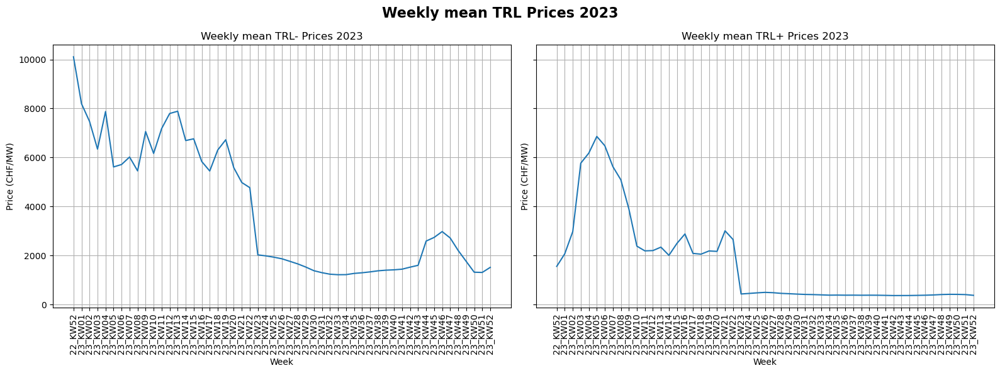

desription of TRL- prices:
 count       53.000000
mean      3830.713337
std       2611.263913
min       1220.801905
25%       1446.577143
50%       2592.130000
75%       6168.152222
max      10108.536000
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count      53.000000
mean     1689.355797
std      1842.710980
min       370.461500
25%       389.234118
50%       459.499167
75%      2344.977143
max      6860.415128
Name: Prix_prestation, dtype: float64


In [181]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW23.index, grouped_TPDW23['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2023')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW23.index, grouped_TPUW23['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2023')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2023', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW23["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW23["Prix_prestation"].describe()}')

max_volume=508
max_cost=4474750.6


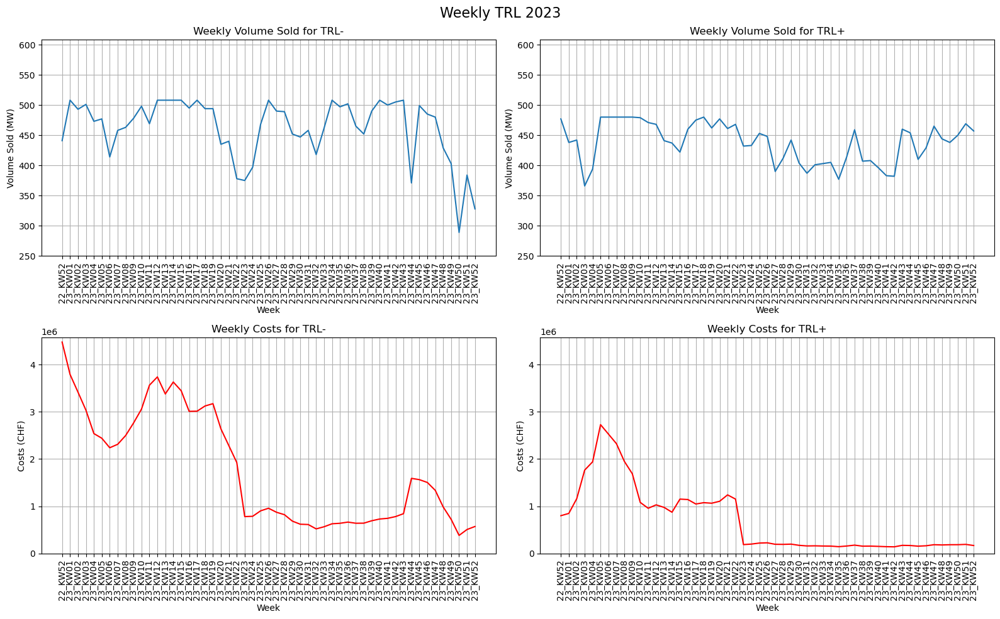

In [182]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW23])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW23])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW23.index, grouped_TPDW23['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW23.index, grouped_TPUW23['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW23.index, grouped_TPDW23['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW23.index, grouped_TPUW23['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2023', fontsize=16)
plt.tight_layout()
plt.show()


---
# Data 2024

In [183]:
res24=pd.read_csv('https://www.swissgrid.ch/content/dam/dataimport/prl-srl/2024-PRL-SRL-TRL-Ergebnis.csv',sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'] )
res24_CH=res24[res24.Pays=='CH']
print(res24_CH.Description.unique())
res24_CH

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\299254801.py:1: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  res24=pd.read_csv('https://www.swissgrid.ch/content/dam/dataimport/prl-srl/2024-PRL-SRL-TRL-Ergebnis.csv',sep=';',header=0, names=['Appel_offres', 'Description', 'Volume_offert', 'Unité1','Volume_attribué','Unité2', 'Prix_prestation','Unité3','Coûts','Unité4','Prix','Unité5','Pays', 'Prix_offert','Unité6', 'Divisibilité'] )


['Primary control Auction 00:00 bis 04:00'
 'Primary control Auction 04:00 bis 08:00'
 'Primary control Auction 08:00 bis 12:00'
 'Primary control Auction 12:00 bis 16:00'
 'Primary control Auction 16:00 bis 20:00'
 'Primary control Auction 20:00 bis 24:00'
 'Secondary control Auction SRL+' 'Secondary control Auction SRL-'
 'Tertiary Power DOWN' 'Tertiary Power UP'
 'Tertiary Power DOWN 00:00 bis 04:00'
 'Tertiary Power DOWN 04:00 bis 08:00'
 'Tertiary Power DOWN 08:00 bis 12:00'
 'Tertiary Power DOWN 12:00 bis 16:00'
 'Tertiary Power DOWN 16:00 bis 20:00'
 'Tertiary Power DOWN 20:00 bis 24:00' 'Tertiary Power UP 00:00 bis 04:00'
 'Tertiary Power UP 04:00 bis 08:00' 'Tertiary Power UP 08:00 bis 12:00'
 'Tertiary Power UP 12:00 bis 16:00' 'Tertiary Power UP 16:00 bis 20:00'
 'Tertiary Power UP 20:00 bis 24:00']


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité
0,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,1,MW,1,MW,10.00,EUR/MW,10.00,EUR,28.7,EUR/MWh*,CH,2.50,EUR/MWh*,Ja
1,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,96.00,EUR/MW,288.00,EUR,28.7,EUR/MWh*,CH,24.00,EUR/MWh*,Ja
2,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,2,MW,2,MW,3.96,EUR/MW,7.92,EUR,28.7,EUR/MWh*,CH,0.99,EUR/MWh*,Ja
3,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,105.00,EUR/MW,315.00,EUR,28.7,EUR/MWh*,CH,26.25,EUR/MWh*,Ja
4,PRL_24_01_01,Primary control Auction 00:00 bis 04:00,3,MW,3,MW,102.00,EUR/MW,306.00,EUR,28.7,EUR/MWh*,CH,25.50,EUR/MWh*,Ja
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
640530,TRL+_24_12_31,Tertiary Power UP 20:00 bis 24:00,100,MW,0,MW,500.00,CHF/MW,0.00,CHF,125.0,CHF/MWh*,CH,125.00,CHF/MWh*,NaN
640531,TRL+_24_12_31,Tertiary Power UP 20:00 bis 24:00,30,MW,0,MW,12.00,CHF/MW,0.00,CHF,3.0,CHF/MWh*,CH,3.00,CHF/MWh*,NaN
640532,TRL+_24_12_31,Tertiary Power UP 20:00 bis 24:00,55,MW,0,MW,632.00,CHF/MW,0.00,CHF,158.0,CHF/MWh*,CH,158.00,CHF/MWh*,NaN
640533,TRL+_24_12_31,Tertiary Power UP 20:00 bis 24:00,55,MW,50,MW,14.00,CHF/MW,700.00,CHF,3.5,CHF/MWh*,CH,3.50,CHF/MWh*,NaN


## primary control auction 2024

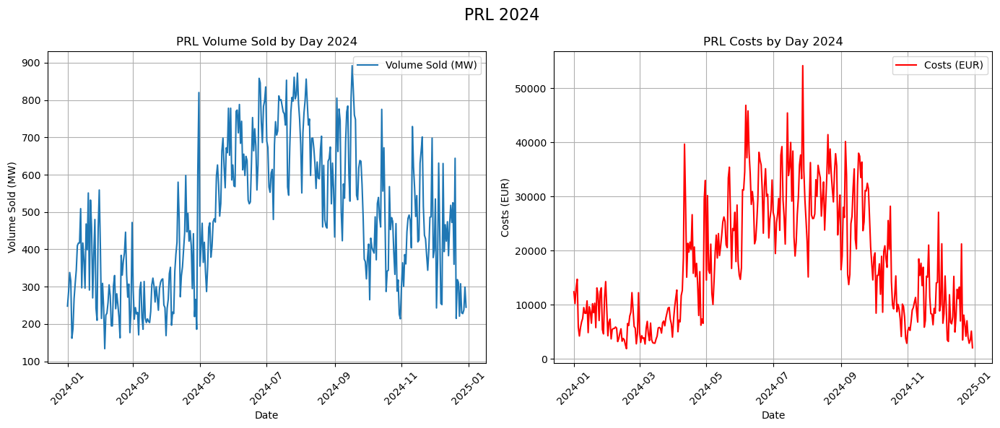

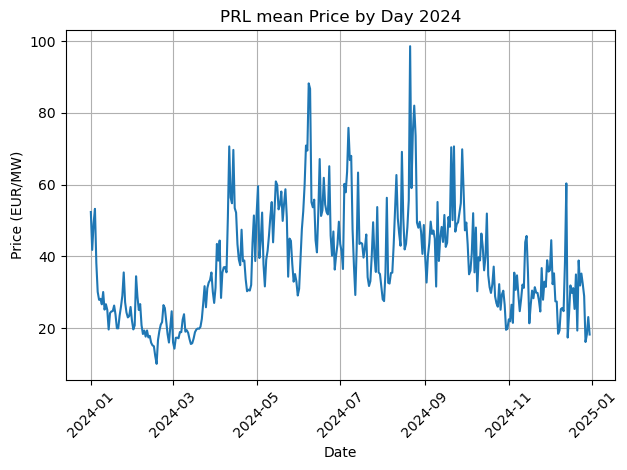

desription of PRL prices:
 count    365.000000
mean      37.855798
std       14.846109
min       10.063704
25%       26.534021
50%       35.553411
75%       47.586838
max       98.559898
Name: Prix_prestation, dtype: float64



In [184]:
res24_CH_p=res24_CH[res24_CH['Description'].str.contains('Primary control')].copy()

res24_CH_p['date'] = pd.to_datetime(res24_CH_p['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

# Grouping by 'date' and summing the volume sold and costs
grouped_p24 = res24_CH_p.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Creating subplots: 1 row, 2 columns
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))  # Adjust figsize to control overall plot size

# Plotting Volume Sold by Day on the first subplot
ax1.plot(grouped_p24.index, grouped_p24['Volume_attribué'], label='Volume Sold (MW)')
ax1.set_title('PRL Volume Sold by Day 2024')
ax1.set_xlabel('Date')
ax1.set_ylabel('Volume Sold (MW)')
ax1.tick_params(axis='x', rotation=45)
ax1.grid(True)
ax1.legend()

# Plotting Costs by Day on the second subplot
ax2.plot(grouped_p24.index, grouped_p24['Coûts'], label='Costs (EUR)', color='red')
ax2.set_title('PRL Costs by Day 2024')
ax2.set_xlabel('Date')
ax2.set_ylabel('Costs (EUR)')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True)
ax2.legend()

# Automatically adjust the layout for better spacing
plt.suptitle('PRL 2024', fontsize=16)
plt.tight_layout()
plt.show()


plt.plot(grouped_p24.index, grouped_p24['Prix_prestation'], label='Price (EUR)')
plt.title('PRL mean Price by Day 2024')
plt.xlabel('Date')
plt.ylabel('Price (EUR/MW)')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('./gfx/2024/PRL_mean_price_2024.pdf', format='pdf')
plt.show()

print(f'desription of PRL prices:\n {grouped_p24["Prix_prestation"].describe()}\n')



In [185]:
PRL24_0_4=res24_CH_p[res24_CH_p.Description=='Primary control Auction 00:00 bis 04:00']
PRL24_4_8=res24_CH_p[res24_CH_p.Description=='Primary control Auction 04:00 bis 08:00']
PRL24_8_12=res24_CH_p[res24_CH_p.Description=='Primary control Auction 08:00 bis 12:00']
PRL24_12_16=res24_CH_p[res24_CH_p.Description=='Primary control Auction 12:00 bis 16:00']
PRL24_16_20=res24_CH_p[res24_CH_p.Description=='Primary control Auction 16:00 bis 20:00']
PRL24_20_24=res24_CH_p[res24_CH_p.Description=='Primary control Auction 20:00 bis 24:00']

grouped_PRL24_0_4=PRL24_0_4.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_4_8=PRL24_4_8.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_8_12=PRL24_8_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_12_16=PRL24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_16_20=PRL24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_PRL24_20_24=PRL24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})



max_volume=167, min volume= 19
max_cost=23335.579999999998, min cost= 83.1


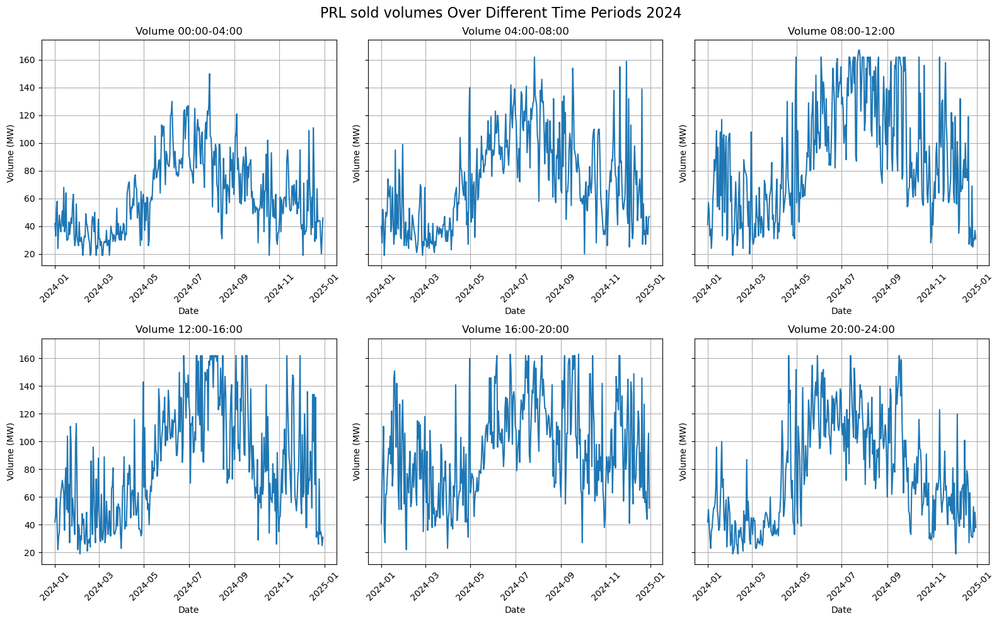

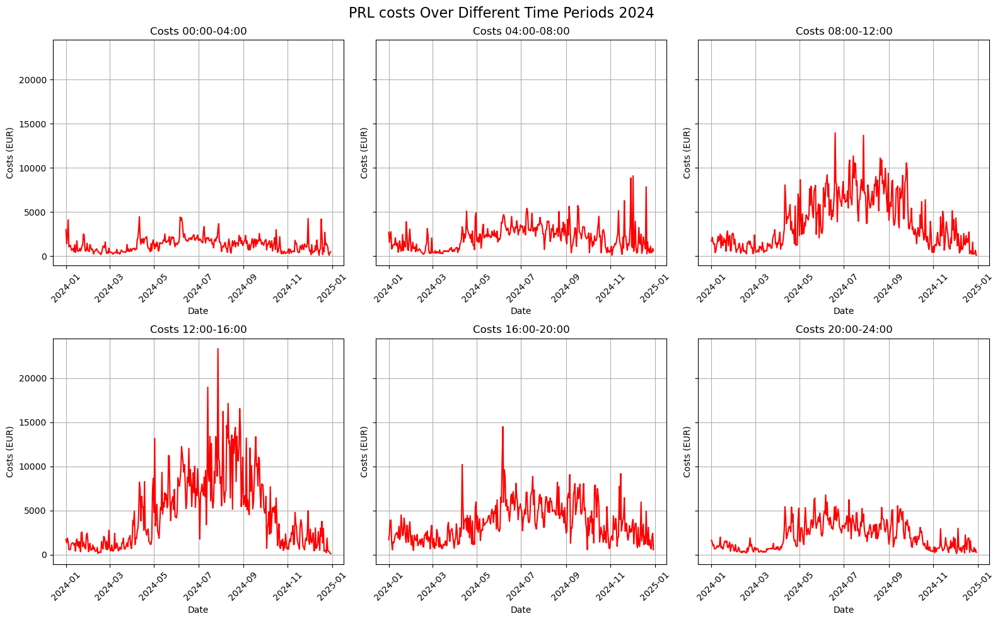

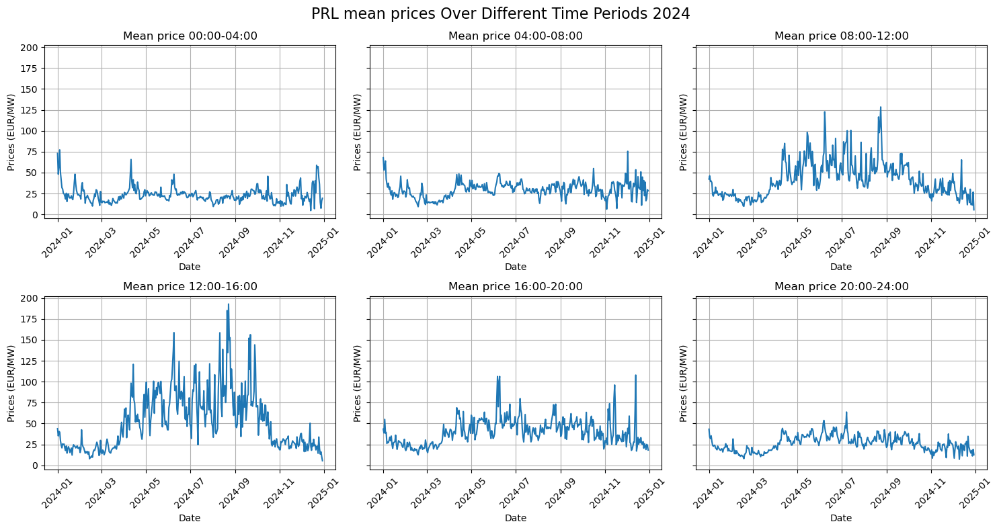

count    365.000000
mean      23.308298
std        9.448312
min        4.620000
25%       17.692308
50%       21.947059
75%       26.345714
max       77.177073
Name: Prix_prestation, dtype: float64
count    365.000000
mean      29.625369
std        9.565007
min        6.250000
25%       23.456667
50%       29.998889
75%       35.372000
max       75.485000
Name: Prix_prestation, dtype: float64
count    365.000000
mean      41.875699
std       21.345148
min        5.525000
25%       24.924211
50%       38.687500
75%       54.730000
max      128.484375
Name: Prix_prestation, dtype: float64
count    365.000000
mean      52.719554
std       34.629318
min        5.525000
25%       23.250769
50%       45.705000
75%       74.064516
max      192.818182
Name: Prix_prestation, dtype: float64
count    365.000000
mean      40.114309
std       15.714499
min       12.553333
25%       27.729000
50%       38.056296
75%       49.022951
max      107.911351
Name: Prix_prestation, dtype: float64
count    3

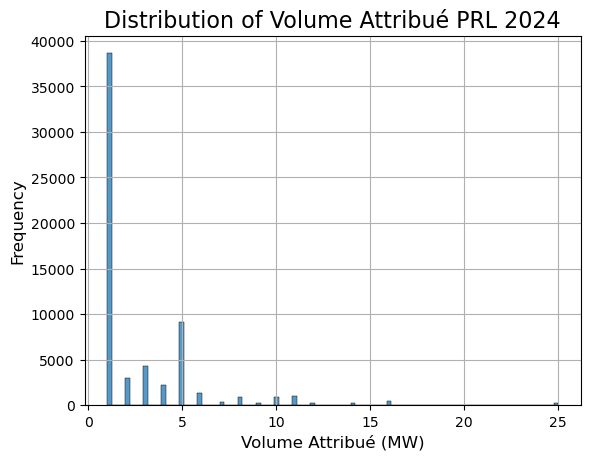

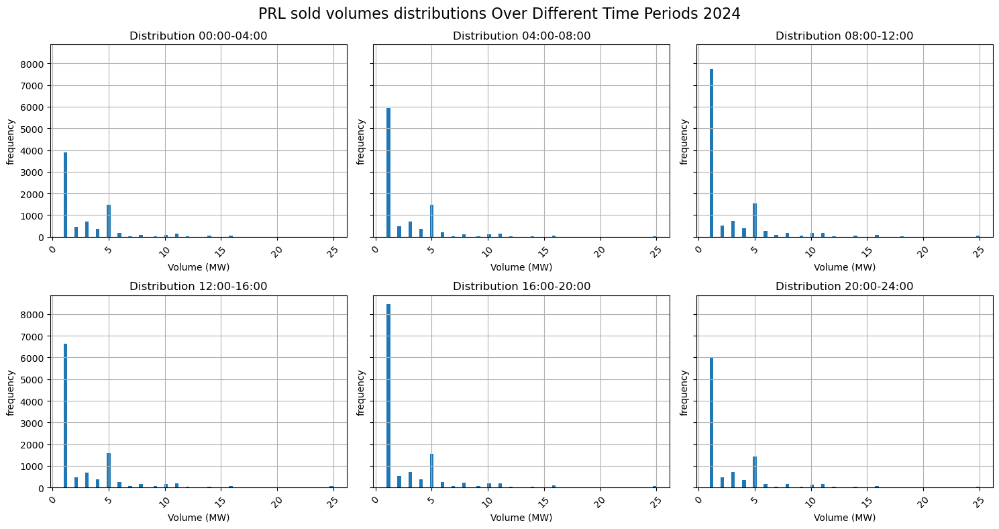

In [186]:
# Grouped data list and labels
grouped_p24 = [grouped_PRL24_0_4, grouped_PRL24_4_8, grouped_PRL24_8_12, grouped_PRL24_12_16, grouped_PRL24_16_20, grouped_PRL24_20_24]
time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']


# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_p24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_p24])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_p24])
min_cost = min([data['Coûts'].min() for data in grouped_p24])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost )  # Add a small buffer to the max value for clarity


# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(16, 10), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_p24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (EUR)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('PRL costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()




fig_volume, axes_volume = plt.subplots(2, 3, sharey=True, figsize=(15, 8))

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_p24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Mean price {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Prices (EUR/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()#(rect=[0, 0, 1, 0.95])
plt.savefig('./gfx/2024/PRL_mean_prices_periods_2024.pdf', format='pdf')
plt.show()

for group in grouped_p24:
    print(group['Prix_prestation'].describe())
    
    
    
    
#plt.figure(figsize=(10, 6))
sns.histplot(res24_CH_p['Volume_attribué'], bins=100)#, kde=True, color='blue')
plt.title('Distribution of Volume Attribué PRL 2024', fontsize=16)
plt.xlabel('Volume Attribué (MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2024/PRL_volume_2024.pdf', format='pdf')
plt.show()




list_PRL24 = [PRL24_0_4, PRL24_4_8, PRL24_8_12, PRL24_12_16, PRL24_16_20, PRL24_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/PRL_volume_distributions_2024.pdf', format='pdf')
plt.show()




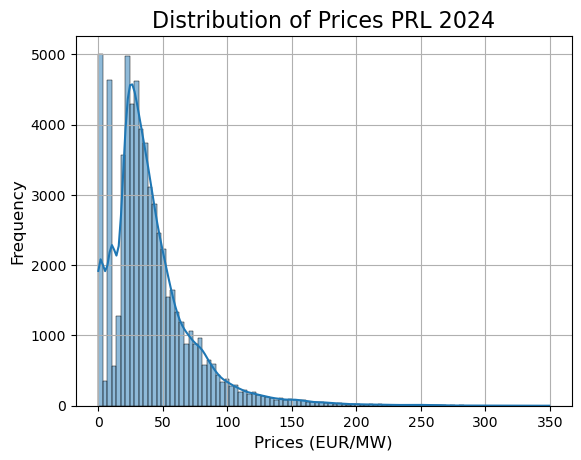

In [187]:
#plt.figure(figsize=(10, 6))
sns.histplot(res24_CH_p['Prix_prestation'], bins=100, kde=True)#, color='blue')
plt.title('Distribution of Prices PRL 2024', fontsize=16)
plt.xlabel('Prices (EUR/MW)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True)
plt.savefig('./gfx/2024/PRL_price_dist_2024.pdf', format='pdf')
plt.show()

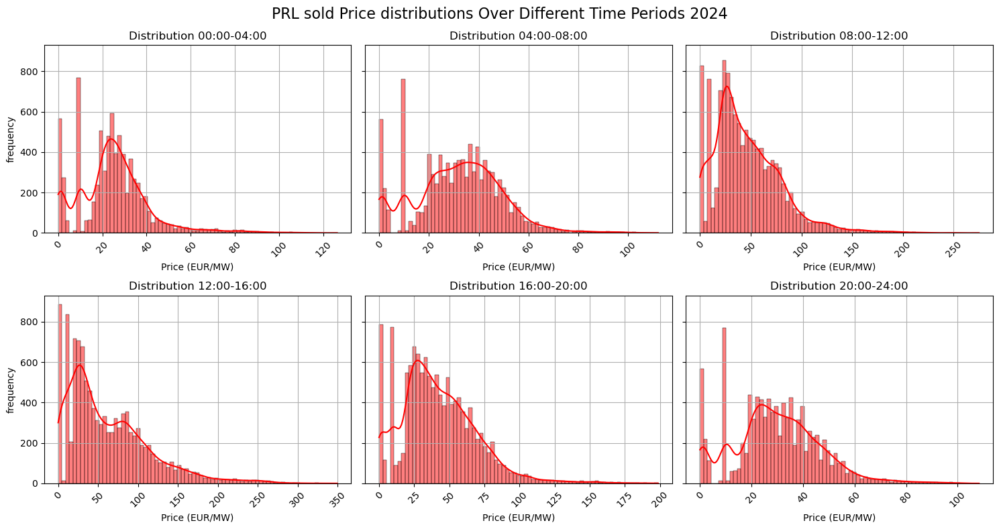

In [188]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_PRL24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, ax=ax, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (EUR/MW)')
    ax.set_ylabel('frequency')
    #ax.set_ylim(0, 6500)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('PRL sold Price distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/PRL_prices_distributions_2024.pdf', format='pdf')
plt.show()

## Secondary control auction 2024

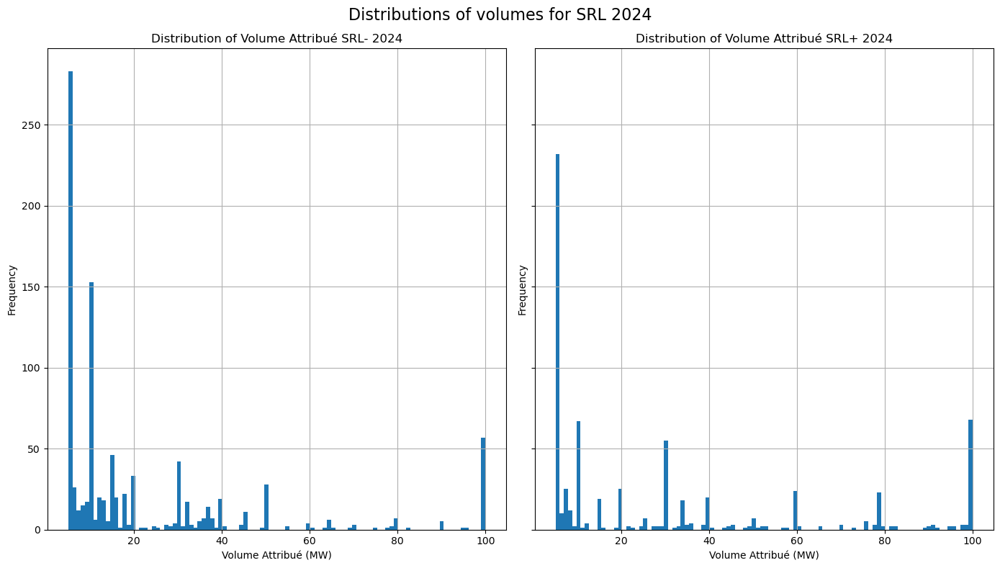

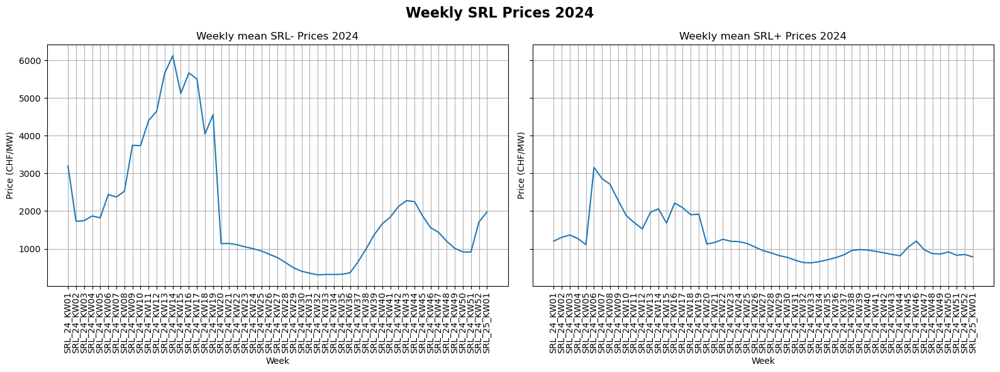

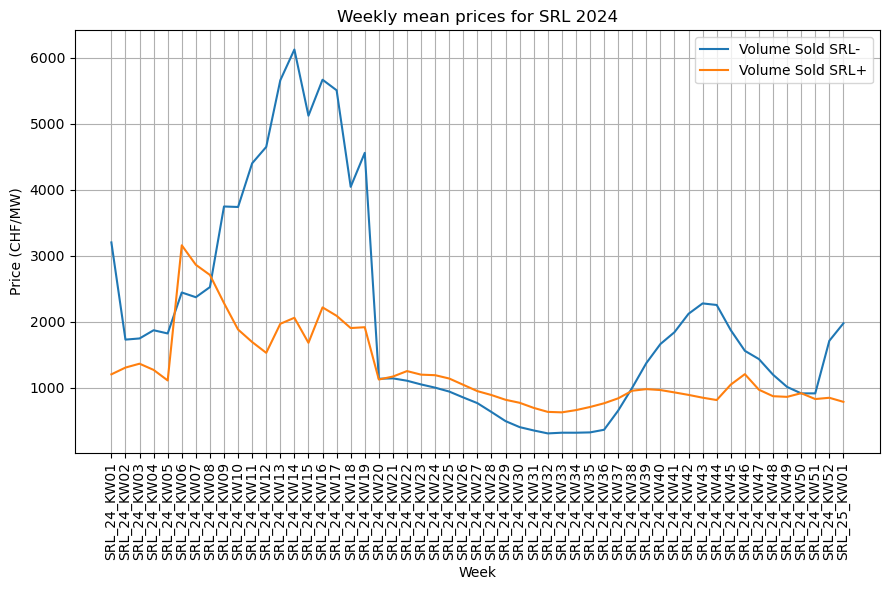

desription of SRL- prices:
 count      53.000000
mean     2041.489308
std      1624.776313
min       307.684444
25%       914.227143
50%      1661.806000
75%      2442.832941
max      6124.475200
Name: Prix_prestation, dtype: float64

desription of SRL+ prices:
 count      53.000000
mean     1271.375994
std       600.372963
min       626.698000
25%       848.793333
50%      1047.218333
75%      1528.649200
max      3158.179000
Name: Prix_prestation, dtype: float64
max_volume=450, min volume= 399
max_cost=2239401.08, min cost= 129124.28


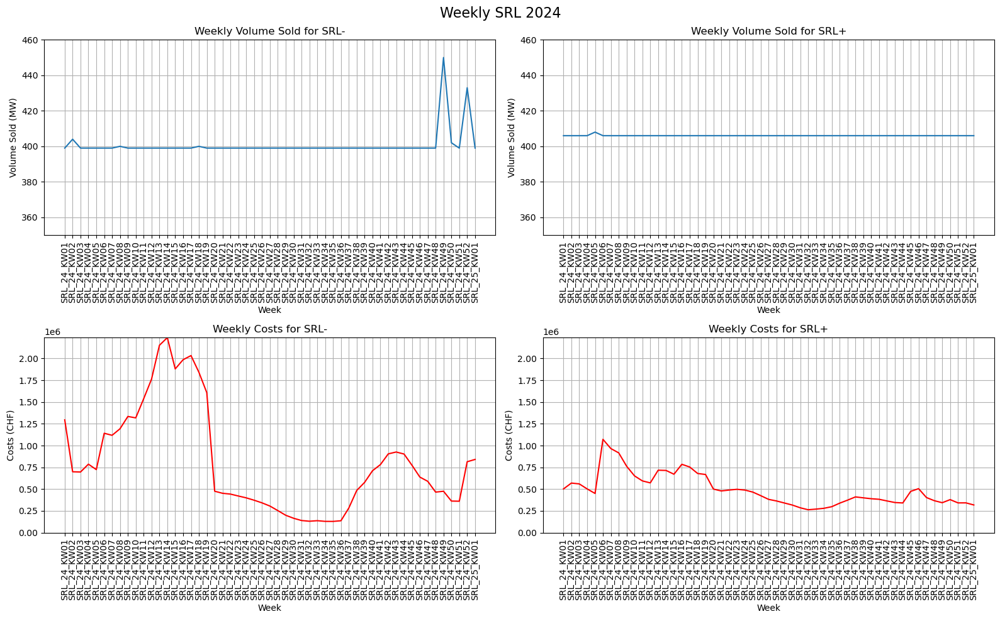

In [189]:
# Create DataFrame for Secondary control
res24_CH_s = res24_CH[res24_CH['Description'].str.contains('Secondary control')].copy()

res24_CH_s['Week'] = res24_CH_s['Appel_offres'].str.extract(r'(SRL_\d{2}_KW\d{2})')[0]

SRL24m=res24_CH_s[res24_CH_s.Description=='Secondary control Auction SRL-'].copy()
SRL24p=res24_CH_s[res24_CH_s.Description=='Secondary control Auction SRL+'].copy()

grouped_SRL24m=SRL24m.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})
grouped_SRL24p=SRL24p.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum', 'Prix_prestation':'mean'})

grouped_SRL24=[grouped_SRL24m, grouped_SRL24p]



fig, axes = plt.subplots(1, 2, figsize=(14, 8), sharey=True)
axes[0].hist(SRL24m['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué SRL- 2024')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

axes[1].hist(SRL24p['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué SRL+ 2024')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

#plt.ylim(0, 700)
plt.suptitle('Distributions of volumes for SRL 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/SRL_dist_2024.pdf', format='pdf')
plt.show()


fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_SRL24m.index, grouped_SRL24m['Prix_prestation'], label='Volume Sold SRL-')
axes[0].set_title('Weekly mean SRL- Prices 2024')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_SRL24p.index, grouped_SRL24p['Prix_prestation'], label='Volume Sold SRL+')
axes[1].set_title('Weekly mean SRL+ Prices 2024')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly SRL Prices 2024', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

plt.figure(figsize=(9, 6))
plt.plot(grouped_SRL24m.index, grouped_SRL24m['Prix_prestation'], label='Volume Sold SRL-')
plt.plot(grouped_SRL24p.index, grouped_SRL24p['Prix_prestation'], label='Volume Sold SRL+')
plt.title('Weekly mean prices for SRL 2024')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2024/Weekly_SRL_Prices_combined_2024.pdf', format='pdf')
plt.show()

print(f'desription of SRL- prices:\n {grouped_SRL24m["Prix_prestation"].describe()}\n')
print(f'desription of SRL+ prices:\n {grouped_SRL24p["Prix_prestation"].describe()}')



# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_SRL24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_SRL24])  # Get the maximum cost across all time periods
min_volume=min([data['Volume_attribué'].min() for data in grouped_SRL24])
min_cost = min([data['Coûts'].min() for data in grouped_SRL24])

print(f'max_volume={max_volume}, min volume= {min_volume}')
print(f'max_cost={max_cost}, min cost= {min_cost}')

# Define dynamic y-limits
volume_ylim = (350, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Plotting Volume Sold
# Plot for SRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_SRL24m.index, grouped_SRL24m['Volume_attribué'], label='SRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for SRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)

# Plot for SRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_SRL24p.index, grouped_SRL24p['Volume_attribué'], label='SRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for SRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)

# Plotting Costs
# Plot for SRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_SRL24m.index, grouped_SRL24m['Coûts'], label='SRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for SRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)

# Plot for SRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_SRL24p.index, grouped_SRL24p['Coûts'], label='SRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for SRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)

# Automatically adjust layout for better spacing
plt.suptitle('Weekly SRL 2024', fontsize=16)
plt.tight_layout()
plt.show()


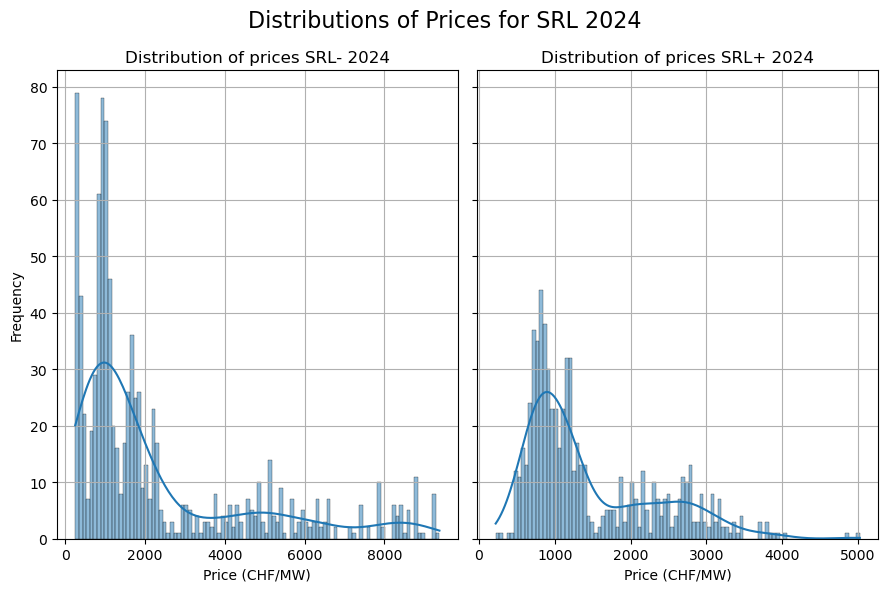

In [190]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(SRL24m['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices SRL- 2024')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(SRL24p['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices SRL+ 2024')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for SRL 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/SRL_dist_prices_2024.pdf', format='pdf')
plt.show()

In [191]:
SRL24m['Volume_attribué'].value_counts().head(10)

Volume_attribué
5      283
10     153
100     57
15      46
30      42
20      33
50      28
6       26
18      22
12      20
Name: count, dtype: int64

In [192]:
SRL24p['Volume_attribué'].value_counts().head(10)

Volume_attribué
5      232
100     68
10      67
30      55
20      25
7       25
60      24
79      23
40      20
15      19
Name: count, dtype: int64

## Tertiary control auction 2024

In [193]:
# Create DataFrame for Tertiary control
res24_CH_t = res24_CH[res24_CH['Description'].str.contains('Tertiary Power')].copy()
res24_CH_t= res24_CH_t[res24_CH_t['Volume_attribué'] != 0]

TPDW24=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN'].copy()
TPUW24=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP'].copy()
TPD24_00_04=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 00:00 bis 04:00'].copy()
TPD24_04_08=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 04:00 bis 08:00'].copy()
TPD24_08_12=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 08:00 bis 12:00'].copy()
TPD24_12_16=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 12:00 bis 16:00'].copy()
TPD24_16_20=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 16:00 bis 20:00'].copy()
TPD24_20_24=res24_CH_t[res24_CH_t.Description=='Tertiary Power DOWN 20:00 bis 24:00'].copy()

TPU24_00_04=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 00:00 bis 04:00'].copy()
TPU24_04_08=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 04:00 bis 08:00'].copy()
TPU24_08_12=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 08:00 bis 12:00'].copy()
TPU24_12_16=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 12:00 bis 16:00'].copy()
TPU24_16_20=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 16:00 bis 20:00'].copy()
TPU24_20_24=res24_CH_t[res24_CH_t.Description=='Tertiary Power UP 20:00 bis 24:00'].copy()

TPDW24['Week']=TPDW24['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]
TPUW24['Week']=TPUW24['Appel_offres'].str.extract(r'(\d{2}_KW\d{2})')[0]

grouped_TPDW24=TPDW24.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPUW24=TPUW24.groupby('Week').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

TPD24_00_04['date'] = pd.to_datetime(TPD24_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_04_08['date'] = pd.to_datetime(TPD24_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_08_12['date'] = pd.to_datetime(TPD24_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_12_16['date'] = pd.to_datetime(TPD24_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_16_20['date'] = pd.to_datetime(TPD24_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPD24_20_24['date'] = pd.to_datetime(TPD24_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

TPU24_00_04['date'] = pd.to_datetime(TPU24_00_04['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_04_08['date'] = pd.to_datetime(TPU24_04_08['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_08_12['date'] = pd.to_datetime(TPU24_08_12['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_12_16['date'] = pd.to_datetime(TPU24_12_16['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_16_20['date'] = pd.to_datetime(TPU24_16_20['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')
TPU24_20_24['date'] = pd.to_datetime(TPU24_20_24['Appel_offres'].str.extract(r'(\d{2}_\d{2}_\d{2})')[0], format='%y_%m_%d')

grouped_TPD24_00_04=TPD24_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_04_08=TPD24_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_08_12=TPD24_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_12_16=TPD24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_16_20=TPD24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPD24_20_24=TPD24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

grouped_TPU24_00_04=TPU24_00_04.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_04_08=TPU24_04_08.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_08_12=TPU24_08_12.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_12_16=TPU24_12_16.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_16_20=TPU24_16_20.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})
grouped_TPU24_20_24=TPU24_20_24.groupby('date').agg({'Volume_attribué': 'sum', 'Coûts': 'sum','Prix_prestation':'mean'})

# Grouped data list and labels
grouped_TPD24 = [grouped_TPD24_00_04, grouped_TPD24_04_08, grouped_TPD24_08_12, grouped_TPD24_12_16, grouped_TPD24_16_20, grouped_TPD24_20_24]

grouped_TPU24 = [grouped_TPU24_00_04, grouped_TPU24_04_08, grouped_TPU24_08_12, grouped_TPU24_12_16, grouped_TPU24_16_20, grouped_TPU24_20_24]

grouped_TPW24=[grouped_TPDW24, grouped_TPUW24]

time_labels = ['00:00-04:00', '04:00-08:00', '08:00-12:00', '12:00-16:00', '16:00-20:00', '20:00-24:00']

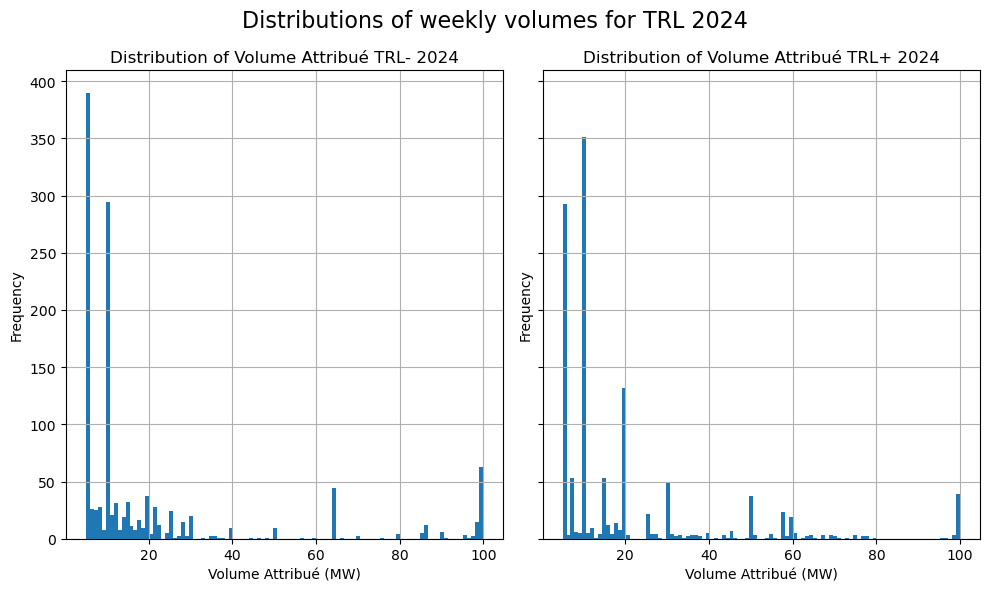

In [194]:
fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharey=True)  

axes[0].hist(TPDW24['Volume_attribué'], bins=100)
axes[0].set_title('Distribution of Volume Attribué TRL- 2024')
axes[0].set_xlabel('Volume Attribué (MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)
#axes[0].set_ylim(0, 2500)

axes[1].hist(TPUW24['Volume_attribué'], bins=100)
axes[1].set_title('Distribution of Volume Attribué TRL+ 2024')
axes[1].set_xlabel('Volume Attribué (MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)
#axes[1].set_ylim(0, 2500)

plt.suptitle('Distributions of weekly volumes for TRL 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL_dist_2024.pdf', format='pdf')
plt.show()

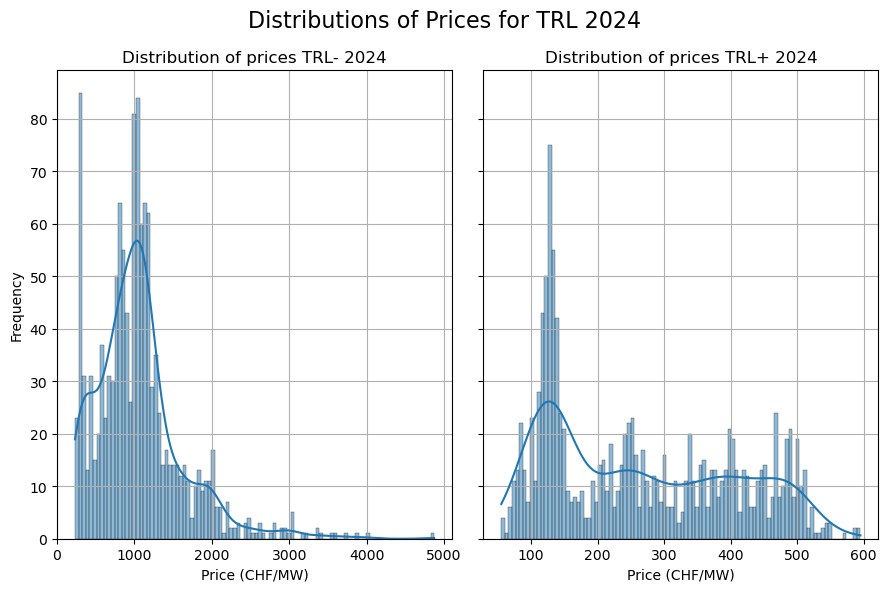

In [195]:
fig, axes = plt.subplots(1, 2, figsize=(9, 6), sharey=True)

sns.histplot(TPDW24['Prix_prestation'], bins=100, kde=True, ax=axes[0])
axes[0].set_title('Distribution of prices TRL- 2024')
axes[0].set_xlabel('Price (CHF/MW)')
axes[0].set_ylabel('Frequency')
axes[0].grid(True)

sns.histplot(TPUW24['Prix_prestation'], bins=100, kde=True, ax=axes[1])
axes[1].set_title('Distribution of prices TRL+ 2024')
axes[1].set_xlabel('Price (CHF/MW)')
axes[1].set_ylabel('Frequency')
axes[1].grid(True)

plt.suptitle('Distributions of Prices for TRL 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL_dist_prices_2024.pdf', format='pdf')
plt.show()

In [196]:
TPD24_08_12

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,date
632695,TRL-_24_12_02,Tertiary Power DOWN 08:00 bis 12:00,5,MW,5,MW,25.0,CHF/MW,125.0,CHF,6.25,CHF/MWh*,CH,6.25,CHF/MWh*,NaN,2024-12-02
632696,TRL-_24_12_02,Tertiary Power DOWN 08:00 bis 12:00,50,MW,35,MW,40.0,CHF/MW,1400.0,CHF,10.00,CHF/MWh*,CH,10.00,CHF/MWh*,NaN,2024-12-02
632700,TRL-_24_12_02,Tertiary Power DOWN 08:00 bis 12:00,10,MW,10,MW,25.0,CHF/MW,250.0,CHF,6.25,CHF/MWh*,CH,6.25,CHF/MWh*,NaN,2024-12-02
632734,TRL-_24_12_03,Tertiary Power DOWN 08:00 bis 12:00,55,MW,50,MW,30.0,CHF/MW,1500.0,CHF,7.50,CHF/MWh*,CH,7.50,CHF/MWh*,NaN,2024-12-03
632774,TRL-_24_12_04,Tertiary Power DOWN 08:00 bis 12:00,55,MW,50,MW,20.0,CHF/MW,1000.0,CHF,5.00,CHF/MWh*,CH,5.00,CHF/MWh*,NaN,2024-12-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
633882,TRL-_24_12_30,Tertiary Power DOWN 08:00 bis 12:00,5,MW,5,MW,420.0,CHF/MW,2100.0,CHF,105.00,CHF/MWh*,CH,105.00,CHF/MWh*,NaN,2024-12-30
633903,TRL-_24_12_31,Tertiary Power DOWN 08:00 bis 12:00,60,MW,24,MW,484.0,CHF/MW,11616.0,CHF,121.00,CHF/MWh*,CH,121.00,CHF/MWh*,NaN,2024-12-31
633904,TRL-_24_12_31,Tertiary Power DOWN 08:00 bis 12:00,100,MW,25,MW,560.7,CHF/MW,14017.5,CHF,140.18,CHF/MWh*,CH,140.18,CHF/MWh*,NaN,2024-12-31
633905,TRL-_24_12_31,Tertiary Power DOWN 08:00 bis 12:00,6,MW,5,MW,444.0,CHF/MW,2220.0,CHF,111.00,CHF/MWh*,CH,111.00,CHF/MWh*,NaN,2024-12-31


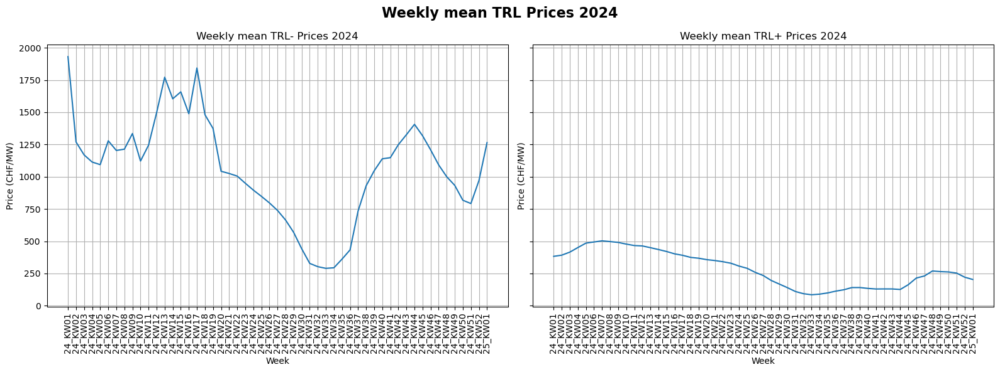

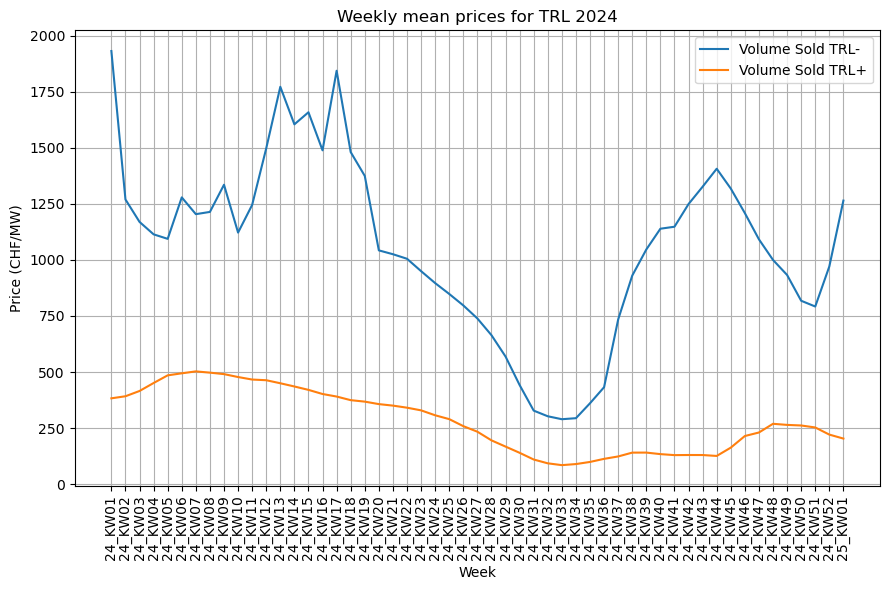

desription of TRL- prices:
 count      53.000000
mean     1057.580706
std       399.835824
min       289.653103
25%       817.740000
50%      1093.747368
75%      1278.593043
max      1931.012500
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count     53.000000
mean     284.081051
std      137.913029
min       84.907778
25%      140.696857
50%      264.326250
75%      402.063846
max      502.870000
Name: Prix_prestation, dtype: float64


In [197]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW24.index, grouped_TPDW24['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2024')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW24.index, grouped_TPUW24['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2024')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2024', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()


plt.figure(figsize=(9, 6))
plt.plot(grouped_TPDW24.index, grouped_TPDW24['Prix_prestation'], label='Volume Sold TRL-')
plt.plot(grouped_TPUW24.index, grouped_TPUW24['Prix_prestation'], label='Volume Sold TRL+')
plt.title('Weekly mean prices for TRL 2024')
plt.xlabel('Week')
plt.ylabel('Price (CHF/MW)')
plt.grid(True)
plt.xticks(rotation=90)
plt.tight_layout()
plt.legend()
plt.savefig('./gfx/2024/Weekly_TRL_Prices_combined_2024.pdf', format='pdf')
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW24["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW24["Prix_prestation"].describe()}')

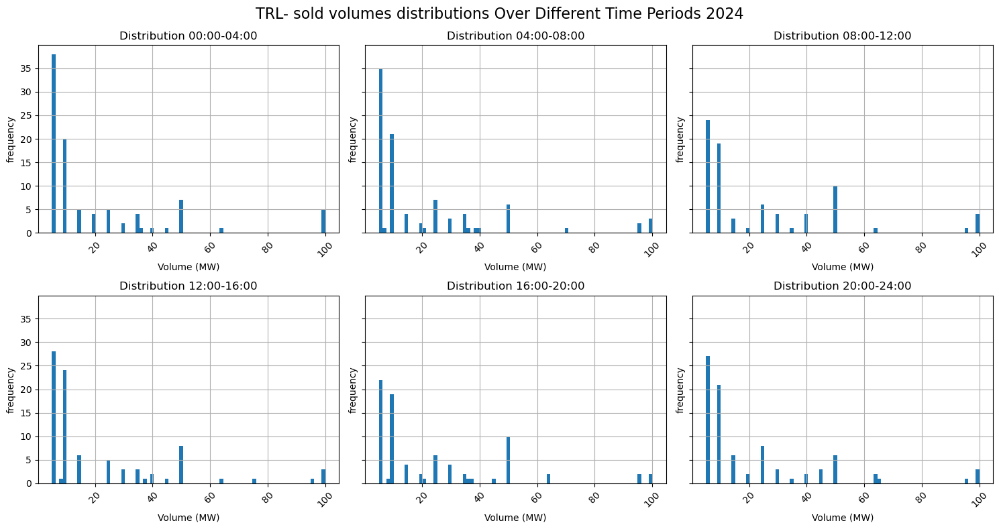

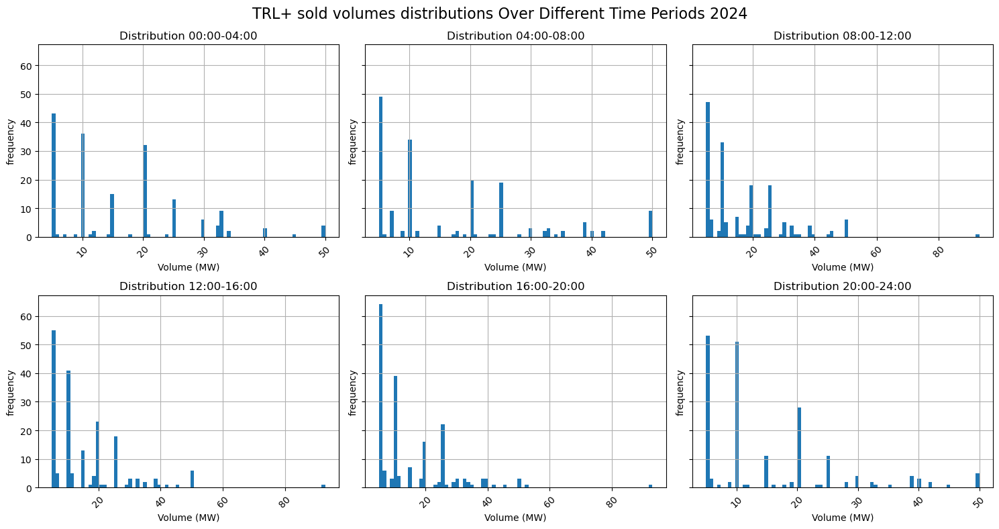

In [198]:
list_TPD24 = [TPD24_00_04, TPD24_04_08, TPD24_08_12, TPD24_12_16, TPD24_16_20, TPD24_20_24]

list_TPU24 = [TPU24_00_04, TPU24_04_08, TPU24_08_12, TPU24_12_16, TPU24_16_20, TPU24_20_24]

fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL-_dist_daily_2024.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.hist(data['Volume_attribué'],bins=75)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Volume (MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold volumes distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL+_dist_daily_2024.pdf', format='pdf')
plt.show()

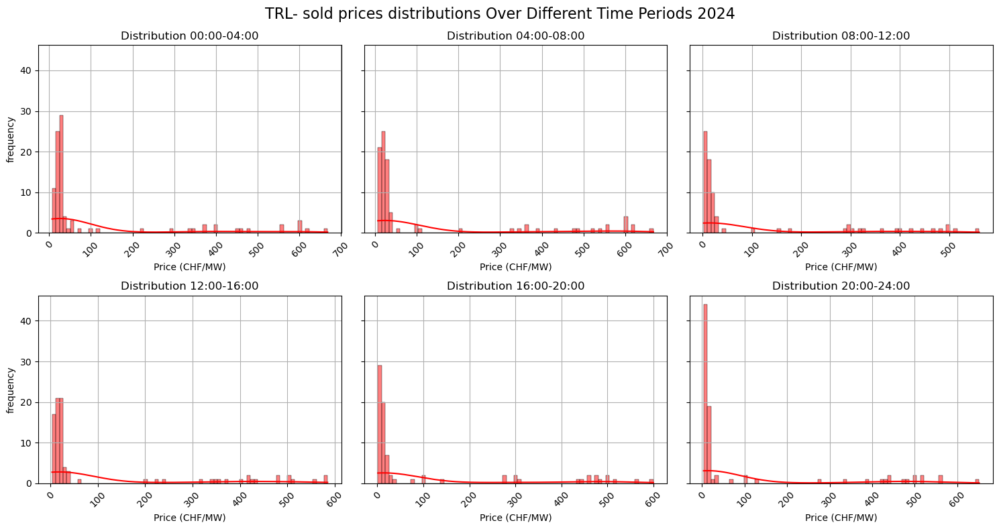

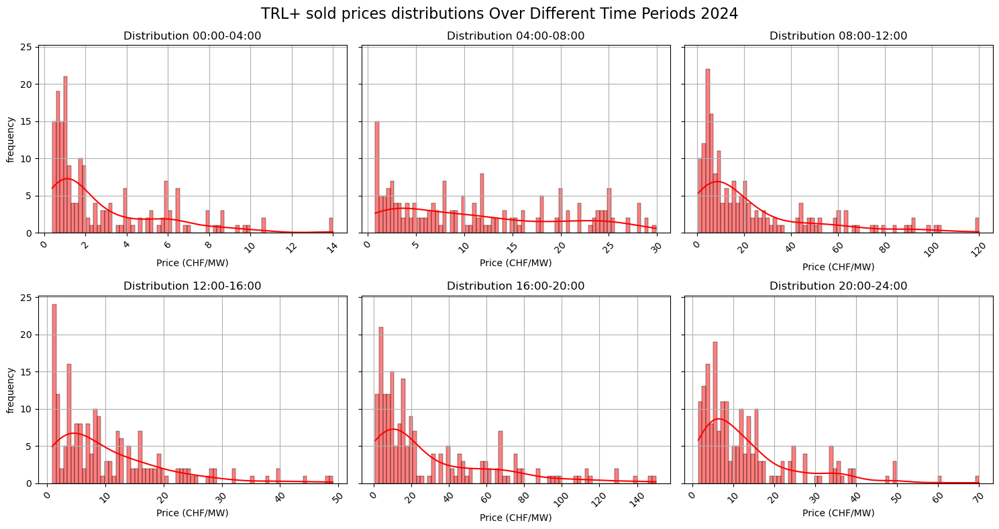

In [199]:
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)
# Loop through the data and plot each volume graph
for i, data in enumerate(list_TPD24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, ax=ax, kde=True, color='red')
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold prices distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL-_dist_prices_daily_2024.pdf', format='pdf')
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(list_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    sns.histplot(data['Prix_prestation'],bins=75, kde=True, color='red', ax=ax)
    ax.set_title(f'Distribution {time_labels[i]}')
    ax.set_xlabel('Price (CHF/MW)')
    ax.set_ylabel('frequency')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ sold prices distributions Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL+_dist_prices_daily_2024.pdf', format='pdf')
plt.show()

max_volume=104
max_cost=61680.0


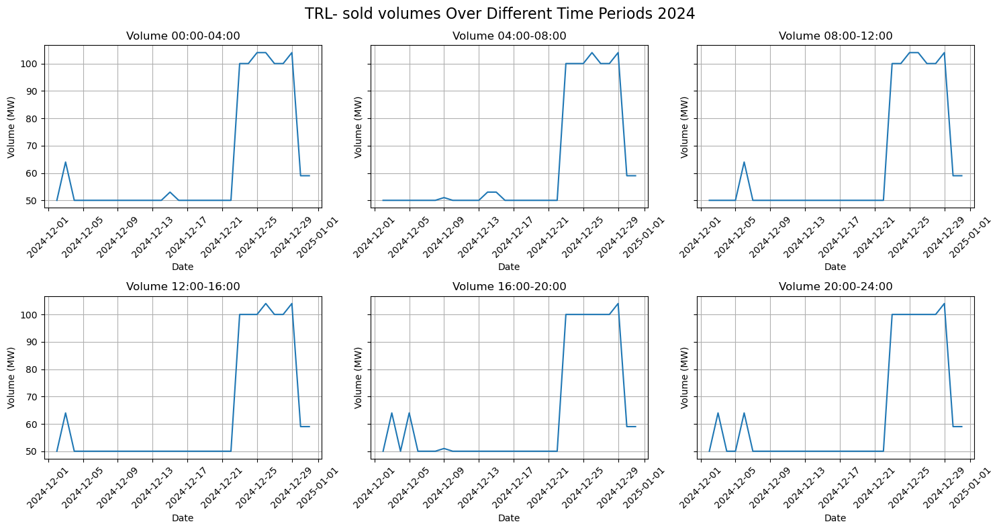

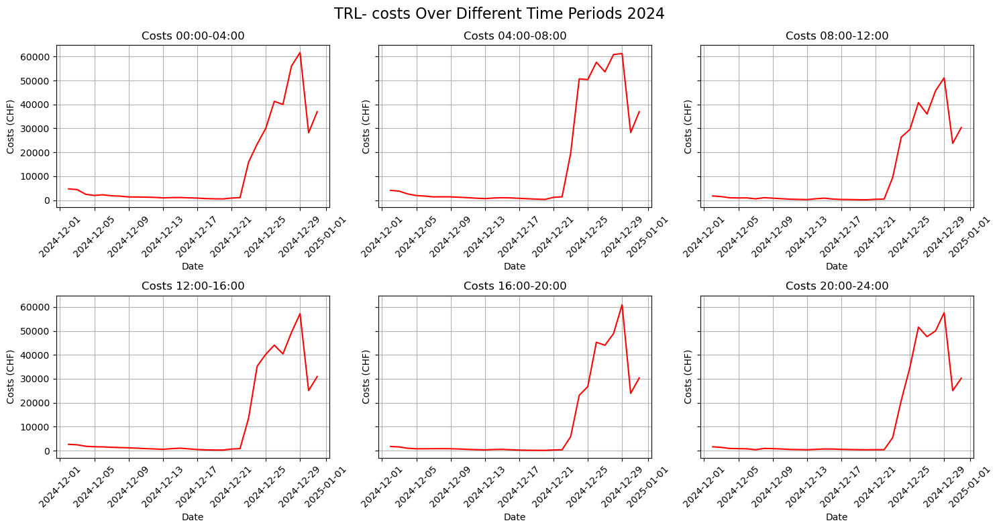

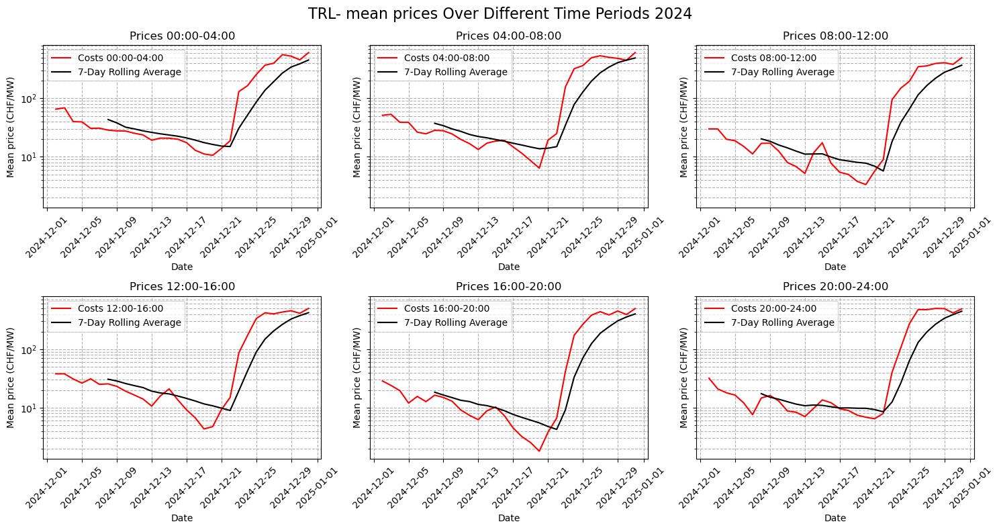

count     30.000000
mean     134.883311
std      190.257033
min       10.600000
25%       20.206000
50%       29.645000
75%      156.456250
max      606.975000
Name: Prix_prestation, dtype: float64

count     30.000000
mean     147.513567
std      204.794604
min        6.400000
25%       18.725000
50%       27.168333
75%      280.768750
max      606.975000
Name: Prix_prestation, dtype: float64

count     30.000000
mean     103.091567
std      157.867647
min        3.350000
25%        7.828750
50%       17.053333
75%      135.662500
max      497.175000
Name: Prix_prestation, dtype: float64

count     30.000000
mean     120.741567
std      174.175224
min        4.333333
25%       14.325000
50%       25.360000
75%      151.656750
max      500.350000
Name: Prix_prestation, dtype: float64

count     30.000000
mean     108.834283
std      171.054751
min        1.800000
25%        7.325000
50%       13.936000
75%      140.740625
max      497.175000
Name: Prix_prestation, dtype: float64

count

In [200]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPD24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPD24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 3000)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL- sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPD24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
    
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL- mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL-_mean_prices_periods_2024.pdf', format='pdf')
plt.show()

for group in grouped_TPD24:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=100
max_cost=10778.98


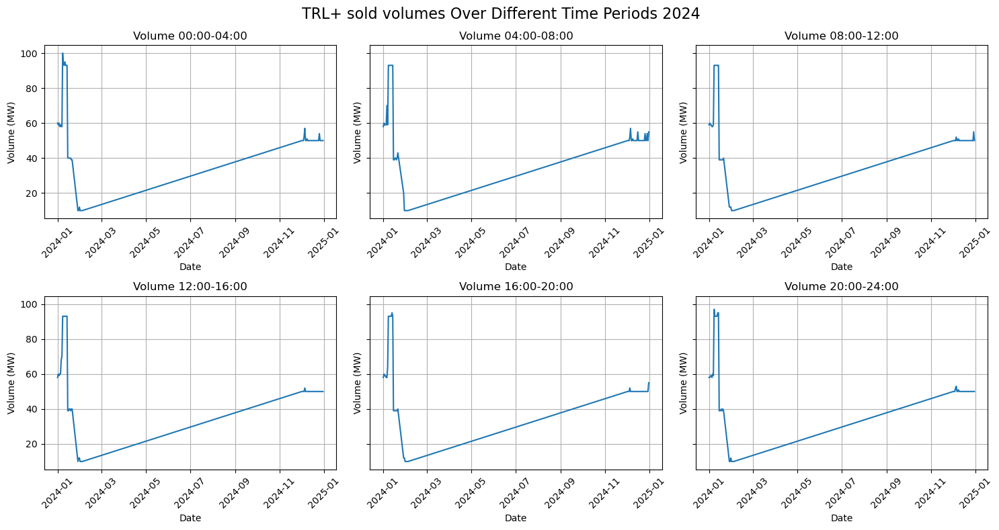

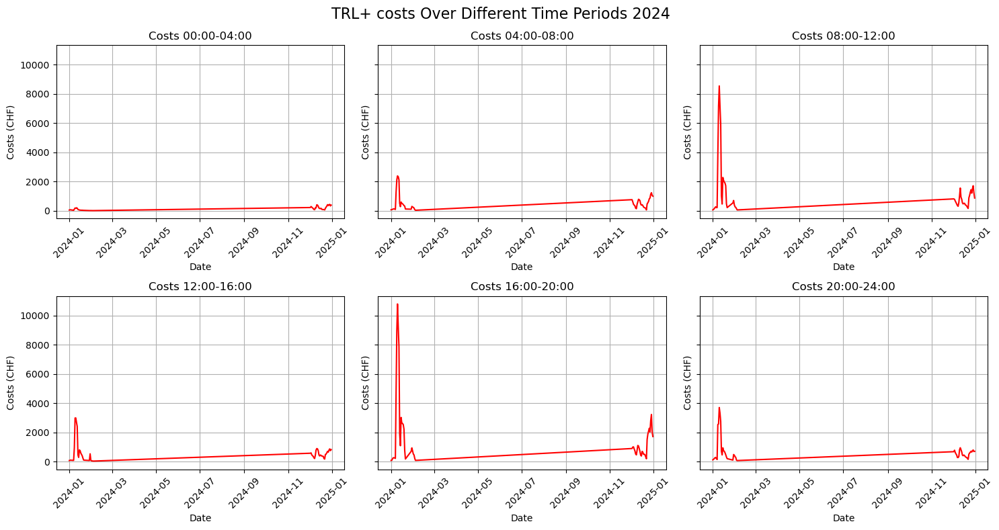

In [201]:
# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPU24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPU24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (0, max_volume + 10)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 300)  # Add a small buffer to the max value for clarity

# Plotting Volume: Create 2 rows, 3 columns for the volume plots
fig_volume, axes_volume = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each volume graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_volume[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Volume_attribué'], label=f'Volume {time_labels[i]}')
    ax.set_title(f'Volume {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Volume (MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(volume_ylim)  # Apply consistent y-limits for volume

# Automatically adjust the layout for better spacing
fig_volume.suptitle('TRL+ sold volumes Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

# Plotting Costs: Create 2 rows, 3 columns for the cost plots
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Coûts'], color='red', label=f'Costs {time_labels[i]}')
    ax.set_title(f'Costs {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Costs (CHF)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True)
    #ax.set_ylim(cost_ylim)  # Apply consistent y-limits for costs

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ costs Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.show()

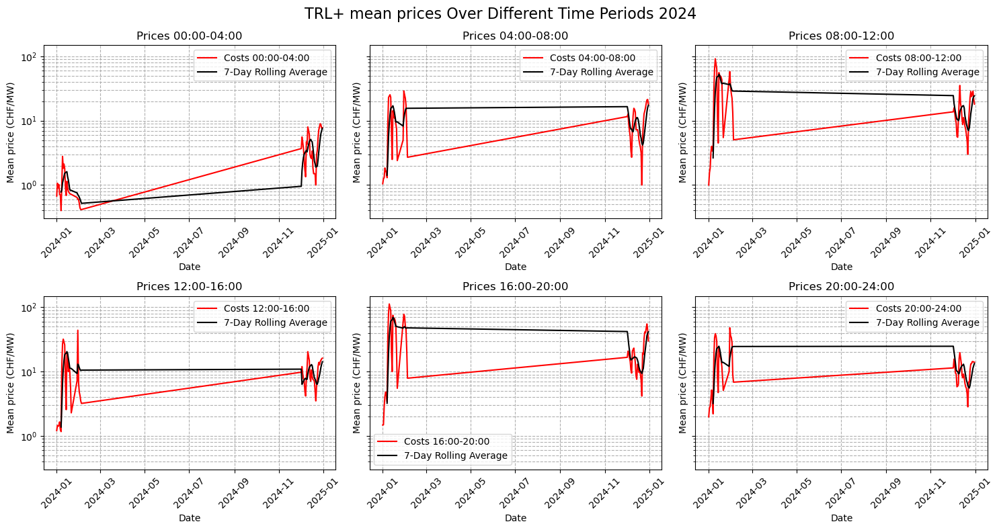

count    58.000000
mean      2.727250
std       2.537493
min       0.400000
25%       0.740000
50%       1.595000
75%       3.686625
max       8.980000
Name: Prix_prestation, dtype: float64

count    58.000000
mean     10.302889
std       7.591042
min       1.000000
25%       4.000000
50%       8.210000
75%      14.833750
max      29.000000
Name: Prix_prestation, dtype: float64

count    58.000000
mean     21.839336
std      20.713251
min       1.000000
25%       6.393750
50%      14.192500
75%      28.535000
max      91.877500
Name: Prix_prestation, dtype: float64

count    58.000000
mean     10.387107
std       8.446713
min       1.166667
25%       4.838333
50%       7.900000
75%      13.621250
max      44.000000
Name: Prix_prestation, dtype: float64

count     58.000000
mean      30.513695
std       27.798700
min        1.476000
25%        9.550000
50%       20.155000
75%       46.698750
max      112.557500
Name: Prix_prestation, dtype: float64

count    58.000000
mean     13.214860

In [202]:
fig_costs, axes_costs = plt.subplots(2, 3, figsize=(15, 8), sharey=True)

# Loop through the data and plot each cost graph
for i, data in enumerate(grouped_TPU24):
    ax = axes_costs[i // 3, i % 3]  # Access the subplot in 2 rows and 3 columns grid
    ax.plot(data.index, data['Prix_prestation'], color='red', label=f'Costs {time_labels[i]}')
   
    # Optionally add a rolling average for better clarity
    rolling_mean = data['Prix_prestation'].rolling(window=7).mean()
    ax.plot(data.index, rolling_mean, color='black', linestyle='-', label='7-Day Rolling Average')
    
    ax.set_title(f'Prices {time_labels[i]}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Mean price (CHF/MW)')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(True, which='both', linestyle='--')#, linewidth=0.7)
    ax.set_yscale('log')
    #ax.set_ylim(1, data['Prix_prestation'].max() * 1.1)  # Avoid log(0)
    ax.legend(loc='best')

# Automatically adjust the layout for better spacing
fig_costs.suptitle('TRL+ mean prices Over Different Time Periods 2024', fontsize=16)
plt.tight_layout()
plt.savefig('./gfx/2024/TRL+_mean_prices_periods_2024.pdf', format='pdf')
plt.show()

for group in grouped_TPU24:
    print(f'{group["Prix_prestation"].describe()}\n')

max_volume=508
max_cost=1140292.0999999999


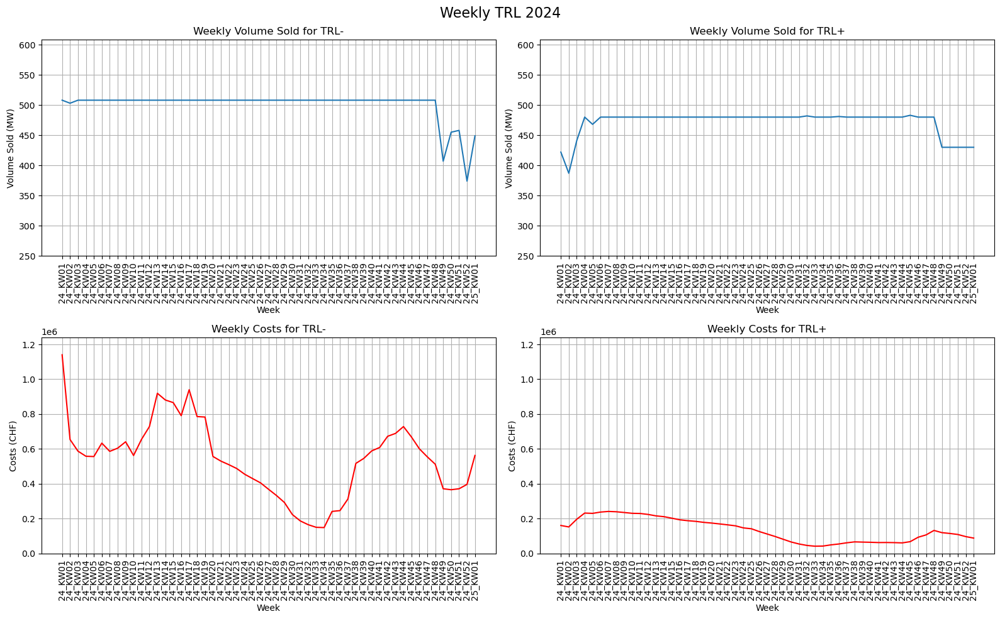

In [203]:
fig, axes = plt.subplots(2, 2, figsize=(16, 10))  # Adjust figure size as needed

# Calculate dynamic y-limits for volumes and costs
max_volume = max([data['Volume_attribué'].max() for data in grouped_TPW24])  # Get the maximum volume across all time periods
max_cost = max([data['Coûts'].max() for data in grouped_TPW24])  # Get the maximum cost across all time periods

print(f'max_volume={max_volume}')
print(f'max_cost={max_cost}')

# Define dynamic y-limits
volume_ylim = (250, max_volume + 100)  # Add a small buffer to the max value for clarity
cost_ylim = (0, max_cost + 100000)  # Add a small buffer to the max value for clarity

# Plotting Volume Sold
# Plot for TRL- Volume Sold (1st row, 1st column)
axes[0, 0].plot(grouped_TPDW24.index, grouped_TPDW24['Volume_attribué'], label='TRL- Volume Sold')
axes[0, 0].set_title('Weekly Volume Sold for TRL-')
axes[0, 0].set_xlabel('Week')
axes[0, 0].set_ylabel('Volume Sold (MW)')
axes[0, 0].grid(True)
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plot for TRL+ Volume Sold (1st row, 2nd column)
axes[0, 1].plot(grouped_TPUW24.index, grouped_TPUW24['Volume_attribué'], label='TRL+ Volume Sold')
axes[0, 1].set_title('Weekly Volume Sold for TRL+')
axes[0, 1].set_xlabel('Week')
axes[0, 1].set_ylabel('Volume Sold (MW)')
axes[0, 1].grid(True)
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_ylim(volume_ylim)  # Set same y-axis limit for volumes

# Plotting Costs
# Plot for TRL- Costs (2nd row, 1st column)
axes[1, 0].plot(grouped_TPDW24.index, grouped_TPDW24['Coûts'], label='TRL- Costs', color='red')
axes[1, 0].set_title('Weekly Costs for TRL-')
axes[1, 0].set_xlabel('Week')
axes[1, 0].set_ylabel('Costs (CHF)')
axes[1, 0].grid(True)
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Plot for TRL+ Costs (2nd row, 2nd column)
axes[1, 1].plot(grouped_TPUW24.index, grouped_TPUW24['Coûts'], label='TRL+ Costs', color='red')
axes[1, 1].set_title('Weekly Costs for TRL+')
axes[1, 1].set_xlabel('Week')
axes[1, 1].set_ylabel('Costs (CHF)')
axes[1, 1].grid(True)
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_ylim(cost_ylim)  # Set same y-axis limit for costs

# Automatically adjust layout for better spacing
plt.suptitle('Weekly TRL 2024', fontsize=16)
plt.tight_layout()
plt.show()

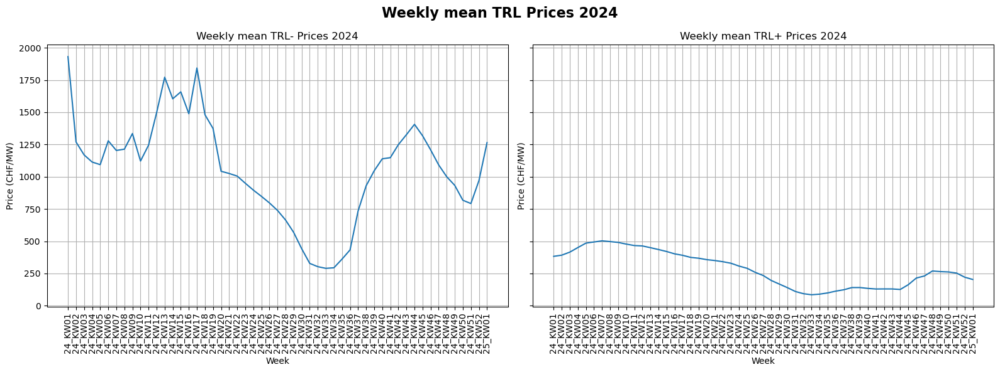

desription of TRL- prices:
 count      53.000000
mean     1057.580706
std       399.835824
min       289.653103
25%       817.740000
50%      1093.747368
75%      1278.593043
max      1931.012500
Name: Prix_prestation, dtype: float64

desription of TRL+ prices:
 count     53.000000
mean     284.081051
std      137.913029
min       84.907778
25%      140.696857
50%      264.326250
75%      402.063846
max      502.870000
Name: Prix_prestation, dtype: float64


In [204]:
fig , axes =plt.subplots(1,2, figsize=(16, 6), sharey=True)

axes[0].plot(grouped_TPDW24.index, grouped_TPDW24['Prix_prestation'], label='Volume Sold TRL-')
axes[0].set_title('Weekly mean TRL- Prices 2024')
axes[0].set_xlabel('Week')
axes[0].set_ylabel('Price (CHF/MW)')
axes[0].grid(True)
axes[0].tick_params(axis='x', rotation=90)

axes[1].plot(grouped_TPUW24.index, grouped_TPUW24['Prix_prestation'], label='Volume Sold TRL+')
axes[1].set_title('Weekly mean TRL+ Prices 2024')
axes[1].set_xlabel('Week')
axes[1].set_ylabel('Price (CHF/MW)')
axes[1].grid(True)
axes[1].tick_params(axis='x', rotation=90)

plt.suptitle('Weekly mean TRL Prices 2024', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print(f'desription of TRL- prices:\n {grouped_TPDW24["Prix_prestation"].describe()}\n')
print(f'desription of TRL+ prices:\n {grouped_TPUW24["Prix_prestation"].describe()}')

# Grouped analysis

### PRL

In [205]:
res19_CH_p.columns

Index(['Appel_offres', 'Description', 'Volume_offert', 'Unité1',
       'Volume_attribué', 'Unité2', 'Prix_prestation', 'Unité3', 'Coûts',
       'Unité4', 'Prix', 'Unité5', 'Pays', 'Prix_offert', 'Unité6',
       'Divisibilité', 'date'],
      dtype='object')

In [206]:
res19_CH_p['Year'] = 2019
res20_CH_p['Year'] = 2020
res21_CH_p['Year'] = 2021
res22_CH_p['Year'] = 2022
res23_CH_p['Year'] = 2023
res24_CH_p['Year'] = 2024

PRL_datasets=[res19_CH_p, res20_CH_p, res21_CH_p, res22_CH_p, res23_CH_p, res24_CH_p]
# for i, dataset in enumerate(PRL_datasets):
#     print(f"Dataset {i} columns: {dataset.columns}")
for dataset in PRL_datasets:
    print(dataset['Prix_prestation'].describe())


count    7742.000000
mean      288.236382
std       460.434636
min         0.000000
25%       104.000000
50%       134.000000
75%       166.000000
max      3343.000000
Name: Prix_prestation, dtype: float64
count    63026.000000
mean        20.078948
std         28.063512
min          0.000000
25%          5.000000
50%         10.600000
75%         20.500000
max        408.000000
Name: Prix_prestation, dtype: float64
count    89939.000000
mean        29.185416
std         35.452253
min          0.000000
25%          7.900000
50%         19.000000
75%         38.000000
max        491.530000
Name: Prix_prestation, dtype: float64
count    66411.000000
mean        46.343797
std         42.313038
min          0.000000
25%         17.300000
50%         35.000000
75%         64.000000
max        435.950000
Name: Prix_prestation, dtype: float64
count    50881.000000
mean        30.420441
std         23.705902
min          0.000000
25%         15.500000
50%         25.000000
75%         40.00000

In [207]:

for i in range(len(PRL_datasets)):
    PRL_datasets[i]['day_of_year'] = PRL_datasets[i]['date'].dt.dayofyear

# Combine all datasets into a single DataFrame
PRL_combined = pd.concat([res19_CH_p, res20_CH_p, res21_CH_p, res22_CH_p, res23_CH_p, res24_CH_p])
# PRL_combined

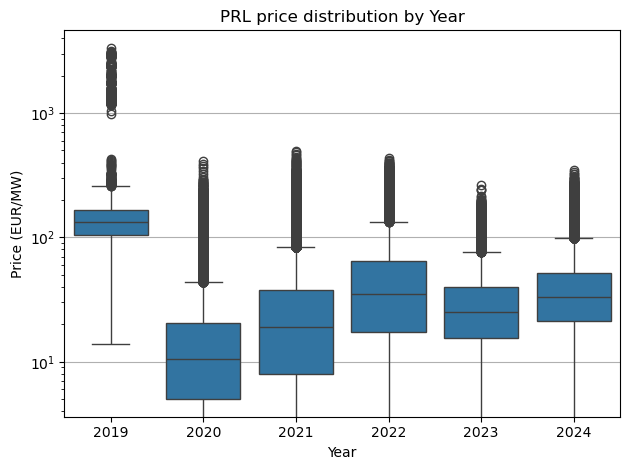

In [208]:

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=PRL_combined)
plt.title('PRL price distribution by Year')
plt.xlabel('Year')
plt.ylabel('Price (EUR/MW)')
plt.yscale('log')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig('./gfx/OA/PRL_price_distribution_by_year.pdf', format='pdf')
plt.show()

In [209]:
# Ensure no missing values in the required columns
PRL_combined = PRL_combined.dropna(subset=['day_of_year', 'Prix_prestation'])

# Regression
import statsmodels.api as sm
X = PRL_combined['day_of_year']
y = PRL_combined['Prix_prestation']
X = sm.add_constant(X)
model = sm.OLS(y, X).fit()
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:        Prix_prestation   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     1042.
Date:                Sun, 29 Dec 2024   Prob (F-statistic):          2.56e-228
Time:                        15:39:21   Log-Likelihood:            -1.7170e+06
No. Observations:              340434   AIC:                         3.434e+06
Df Residuals:                  340432   BIC:                         3.434e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const          31.1162      0.141    220.769      

Key Observations:
R-squared:

The R-squared value is very low (0.003), indicating that the day_of_year variable explains only 0.3% of the variation in the Prix_prestation. This suggests that other factors have a much larger influence on prices than the day of the year.
P-value for day_of_year:

The p-value is effectively 0, which means that the day_of_year variable is statistically significant. However, this does not imply that it has a strong effect; it only suggests that the relationship between day_of_year and Prix_prestation is unlikely to be due to chance.
Coefficient for day_of_year:

The coefficient for day_of_year is 0.0209. This indicates that, on average, the price increases by 0.0209 CHF/MW for each additional day in the year. While statistically significant, this is a small change.
Constant (const):

The constant term (31.0842) represents the estimated price at the start of the year (day 0). This is the baseline price before accounting for the effect of the day of the year.
F-statistic:

The F-statistic is large (1063), and the associated p-value is effectively 0. This indicates that the overall model is statistically significant, but given the low R-squared, the practical explanatory power is limited.
Durbin-Watson:

The Durbin-Watson statistic (0.352) is quite low, suggesting potential autocorrelation in the residuals, which is common with time-series data. This might indicate the need for a more advanced time-series model to capture trends better.

In [210]:
X = PRL_combined['Volume_attribué']
y = PRL_combined['Prix_prestation']
X = sm.add_constant(X)
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:        Prix_prestation   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     86.78
Date:                Sun, 29 Dec 2024   Prob (F-statistic):           1.22e-20
Time:                        15:39:21   Log-Likelihood:            -1.7175e+06
No. Observations:              340434   AIC:                         3.435e+06
Df Residuals:                  340432   BIC:                         3.435e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              35.6341      0.082    4

Key Observations:
R-squared:

The R-squared is 0.000, meaning that Volume_attribué explains almost none of the variation in Prix_prestation. This implies that the relationship between the volume attributed and the price is weak, at least in a linear context.
P-value for Volume_attribué:

The p-value for Volume_attribué is effectively 0, indicating that the variable is statistically significant. However, given the low R-squared, the practical significance is negligible.
Coefficient for Volume_attribué:

The coefficient is -0.1781, meaning that for every additional MW of attributed volume, the price decreases by approximately 0.1781 CHF/MW. While this suggests a negative relationship, the effect is quite small.
Constant (const):

The constant term (35.6343) represents the baseline price when the attributed volume is zero. However, it's important to note that a volume of zero is not practical in this context, so this value is primarily for theoretical interpretation.
F-statistic:

The F-statistic is 82.68, with a p-value of approximately 9.69e-20, indicating that the model is statistically significant. However, the very low R-squared suggests that this significance does not translate to strong explanatory power.
Durbin-Watson:

The Durbin-Watson statistic is 0.352, indicating significant autocorrelation in the residuals, which is common in time-series data and suggests the need for more advanced modeling techniques.
Omnibus and Jarque-Bera:

The high values for these tests indicate that the residuals are not normally distributed, which could impact the validity of the OLS assumptions.


In [211]:
import statsmodels.formula.api as smf

# Define the formula including the interaction term
formula = "Prix_prestation ~ Volume_attribué + day_of_year + Volume_attribué:day_of_year"

# Fit the model using statsmodels' formula API
model_with_interaction = smf.ols(formula=formula, data=PRL_combined).fit()

# Display the summary
print(model_with_interaction.summary())


                            OLS Regression Results                            
Dep. Variable:        Prix_prestation   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.003
Method:                 Least Squares   F-statistic:                     383.0
Date:                Sun, 29 Dec 2024   Prob (F-statistic):          2.32e-248
Time:                        15:39:21   Log-Likelihood:            -1.7170e+06
No. Observations:              340434   AIC:                         3.434e+06
Df Residuals:                  340430   BIC:                         3.434e+06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept         

Key Observations
Intercept (31.5232):

This represents the baseline price when both Volume_attribué and day_of_year are zero. Since day_of_year cannot be zero, this value is more of a reference point rather than a meaningful interpretation.
Effect of Volume_attribué (-0.1837):

The coefficient is negative, indicating that as the attributed volume increases, the price tends to decrease slightly.
This effect is statistically significant as the p-value (0.000) is less than the typical threshold of 0.05.
Effect of day_of_year (0.0213):

The coefficient is positive and statistically significant (p-value = 0.000), suggesting that as the day of the year increases, the price slightly increases.
Interaction Term (Volume_attribué:day_of_year, -6.214e-05):

The interaction term coefficient is not statistically significant (p-value = 0.760), meaning there is no strong evidence to suggest that the interaction between Volume_attribué and day_of_year affects the price.
R-squared (0.003):

The model explains only 0.3% of the variation in the dependent variable (Prix_prestation). This indicates that the current model has very limited explanatory power, and other factors likely influence prices.
Condition Number (2.68e+03):

This indicates potential multicollinearity or numerical instability in the model. While the condition number isn't extremely high, it is worth considering whether the variables Volume_attribué and day_of_year are correlated.

In [212]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Function to assign seasons based on day_of_year
def assign_season(day_of_year):
    if (day_of_year >= 355) or (day_of_year <= 79):
        return 'Winter'
    elif (day_of_year >= 80) and (day_of_year <= 171):
        return 'Spring'
    elif (day_of_year >= 172) and (day_of_year <= 263):
        return 'Summer'
    else:
        return 'Autumn'

# Create 'season' column
PRL_combined['season'] = PRL_combined['day_of_year'].apply(assign_season)
# Encode season as categorical
PRL_combined = pd.get_dummies(PRL_combined, columns=['season'])



In [213]:

# Run regression
formula = "Prix_prestation ~ Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=PRL_combined).fit()

# Print results
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:        Prix_prestation   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     636.2
Date:                Sun, 29 Dec 2024   Prob (F-statistic):               0.00
Time:                        15:39:22   Log-Likelihood:            -1.7163e+06
No. Observations:              340434   AIC:                         3.433e+06
Df Residuals:                  340429   BIC:                         3.433e+06
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept                38.64

In [214]:
# Apply log transformation to Prix_prestation and Volume_attribué
PRL_combined['log_Prix_prestation'] = np.log1p(PRL_combined['Prix_prestation'])  # log1p handles zero values
PRL_combined['log_Volume_attribué'] = np.log1p(PRL_combined['Volume_attribué'])
PRL_combined['season'] = PRL_combined['day_of_year'].apply(assign_season)


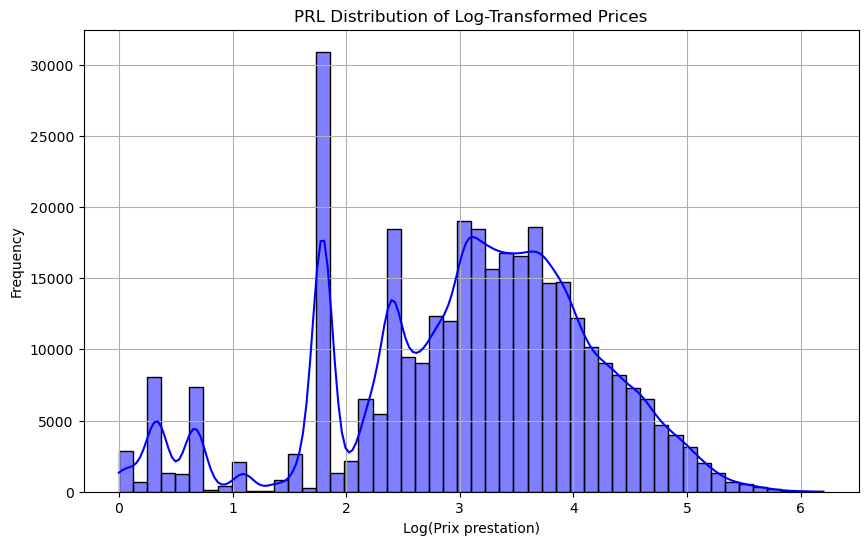

In [215]:
plt.figure(figsize=(10, 6))
sns.histplot(PRL_combined['log_Prix_prestation'], bins=50, kde=True, color='blue')
plt.title('PRL Distribution of Log-Transformed Prices')
plt.xlabel('Log(Prix prestation)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


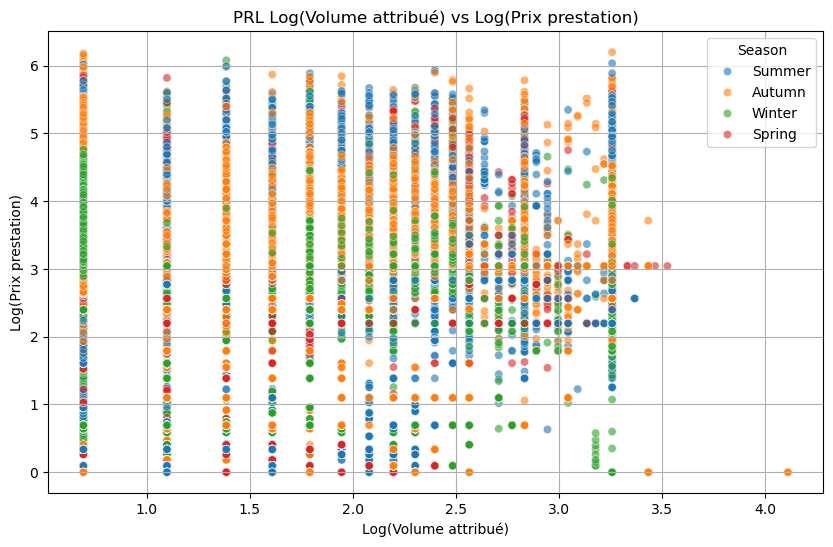

In [216]:
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=PRL_combined['log_Volume_attribué'],
    y=PRL_combined['log_Prix_prestation'],
    hue=PRL_combined['season'],  # Assuming 'season' is already created
    alpha=0.6
)
plt.title('PRL Log(Volume attribué) vs Log(Prix prestation)')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.show()


C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\800628166.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='season', y='log_Prix_prestation', data=PRL_combined, palette='Set2')


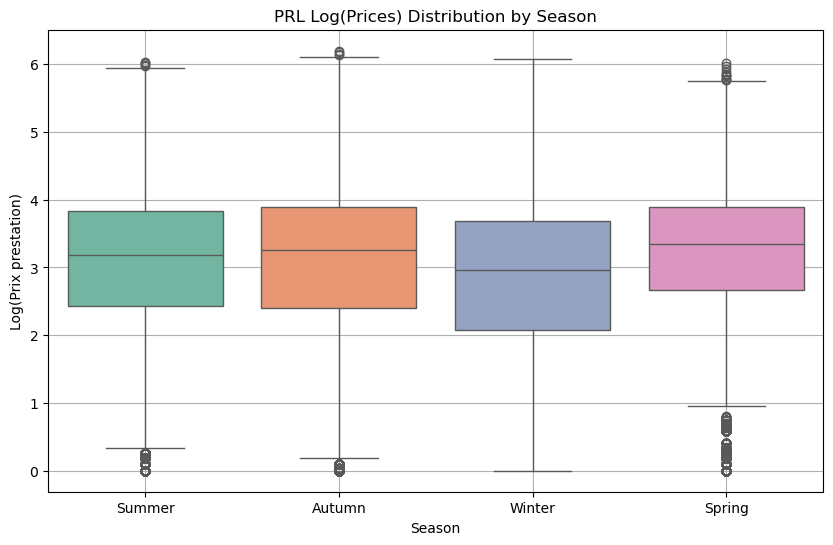

In [217]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='season', y='log_Prix_prestation', data=PRL_combined, palette='Set2')
plt.title('PRL Log(Prices) Distribution by Season')
plt.xlabel('Season')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.savefig('./gfx/OA/PRL_Log_prices_distribution_by_season.pdf', format='pdf')
plt.show()


In [218]:
# Group by season and calculate descriptive statistics
season_stats = PRL_combined.groupby('season')['Prix_prestation'].describe()

# Display the statistics
print(season_stats)


           count       mean        std  min   25%    50%     75%     max
season                                                                  
Autumn   90652.0  38.108327  42.955498  0.0  10.0  25.16  47.700  491.53
Spring   73845.0  36.323646  33.255613  0.0  13.3  27.60  48.300  408.00
Summer  109634.0  35.654292  38.312040  0.0  10.4  23.30  45.400  417.07
Winter   66303.0  29.043938  31.850155  0.0   7.0  18.40  38.795  435.95


In [219]:
# Run regression
formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=PRL_combined).fit()

# Print results
print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.019
Model:                             OLS   Adj. R-squared:                  0.019
Method:                  Least Squares   F-statistic:                     1653.
Date:                 Sun, 29 Dec 2024   Prob (F-statistic):               0.00
Time:                         15:39:31   Log-Likelihood:            -5.1778e+05
No. Observations:               340434   AIC:                         1.036e+06
Df Residuals:                   340429   BIC:                         1.036e+06
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept           

Key Findings:
Intercept (coef = 3.3148):

This represents the baseline log_Prix_prestation when all other variables are at their reference levels (e.g., during Autumn and with a log volume of 0).
In terms of actual prices, the baseline is approximately 
𝑒
3.3148
≈
27.5
 
EUR/MW
e 
3.3148
 ≈27.5EUR/MW.
Seasonality Effects:

Spring (coef = 0.0666):
Prices during Spring are on average 
𝑒
0.0666
≈
1.07
e 
0.0666
 ≈1.07 times higher than Autumn, translating to a 7% increase in price.
Summer (coef = -0.0014):
Prices in Summer are statistically indistinguishable from Autumn (p-value = 0.783).
Winter (coef = -0.2687):
Prices in Winter are on average 
𝑒
−
0.2687
≈
0.765
e 
−0.2687
 ≈0.765 times that of Autumn, representing a 23.5% decrease in price.
Log-Volume Effect (log_Volume_attribué, coef = -0.1880):

A 1% increase in the bid volume corresponds to a 
0.188
%
0.188% decrease in the price. This suggests that larger bid volumes are associated with lower prices, which is expected due to economies of scale or market saturation effects.
Model Fit:

The 
$𝑅^2=0.019$
$R^2=0.019$ suggests that the model explains approximately 1.9% of the variability in log_Prix_prestation. While this is low, it is common in economic models where many unobserved factors influence prices.
Residual Diagnostics:

Skewness and kurtosis values indicate that residuals are closer to normality compared to the raw scale model.


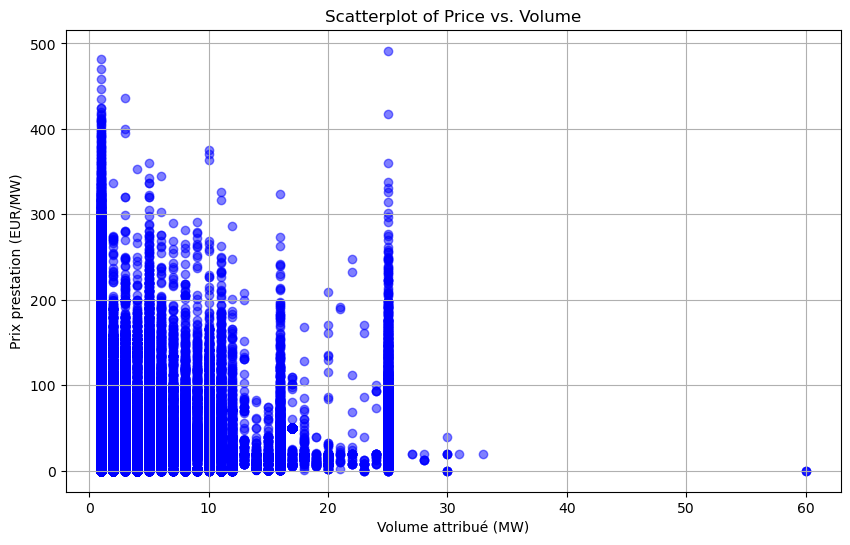

In [220]:
plt.figure(figsize=(10, 6))
plt.scatter(
    PRL_combined['Volume_attribué'], 
    PRL_combined['Prix_prestation'], 
    alpha=0.5, color='blue'
)
plt.title('Scatterplot of Price vs. Volume')
plt.xlabel('Volume attribué (MW)')
plt.ylabel('Prix prestation (EUR/MW)')
plt.grid(True)
plt.show()


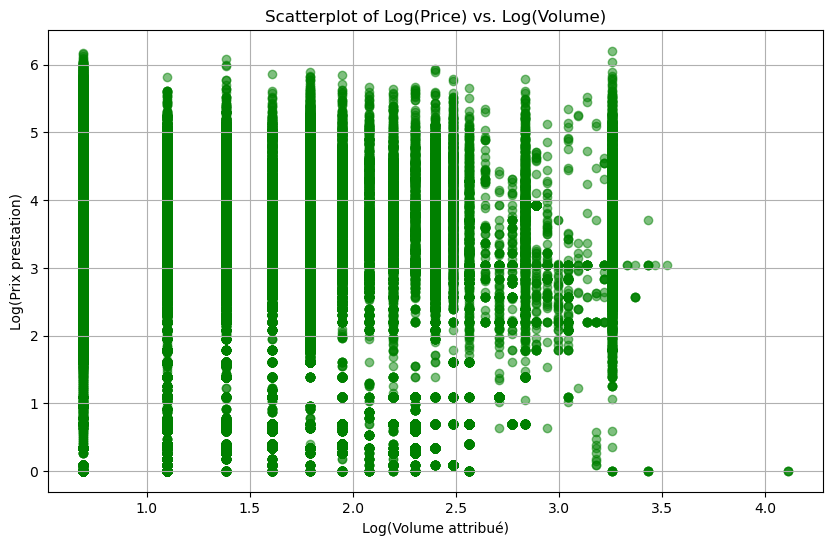

In [221]:
plt.figure(figsize=(10, 6))
plt.scatter(
    PRL_combined['log_Volume_attribué'], 
    PRL_combined['log_Prix_prestation'], 
    alpha=0.5, color='green'
)
plt.title('Scatterplot of Log(Price) vs. Log(Volume)')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.show()


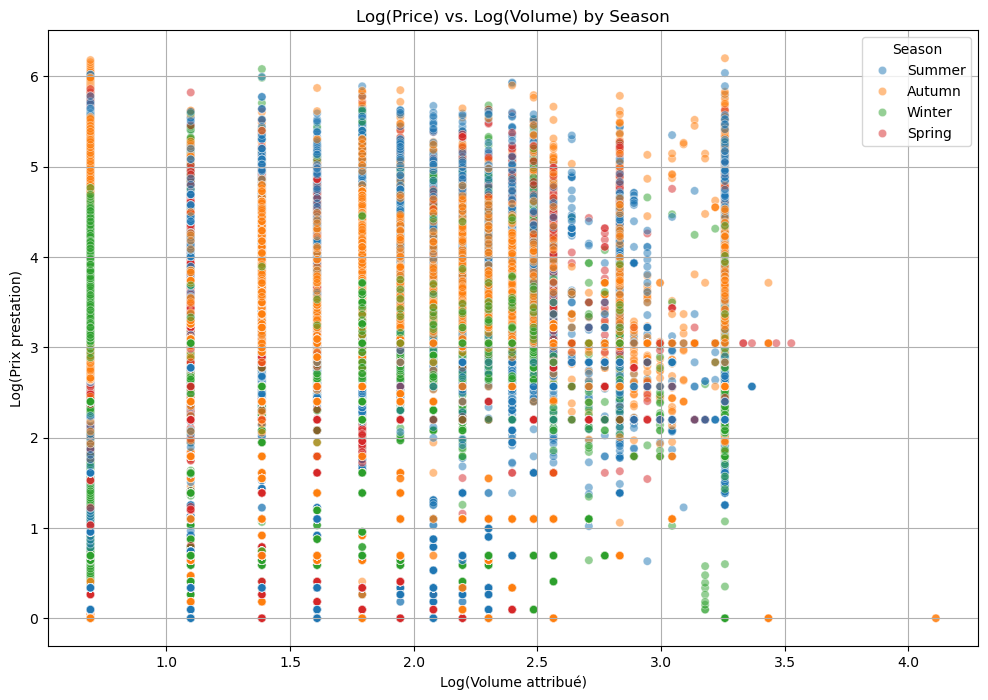

In [222]:
plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=PRL_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5
)
plt.title('Log(Price) vs. Log(Volume) by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.show()


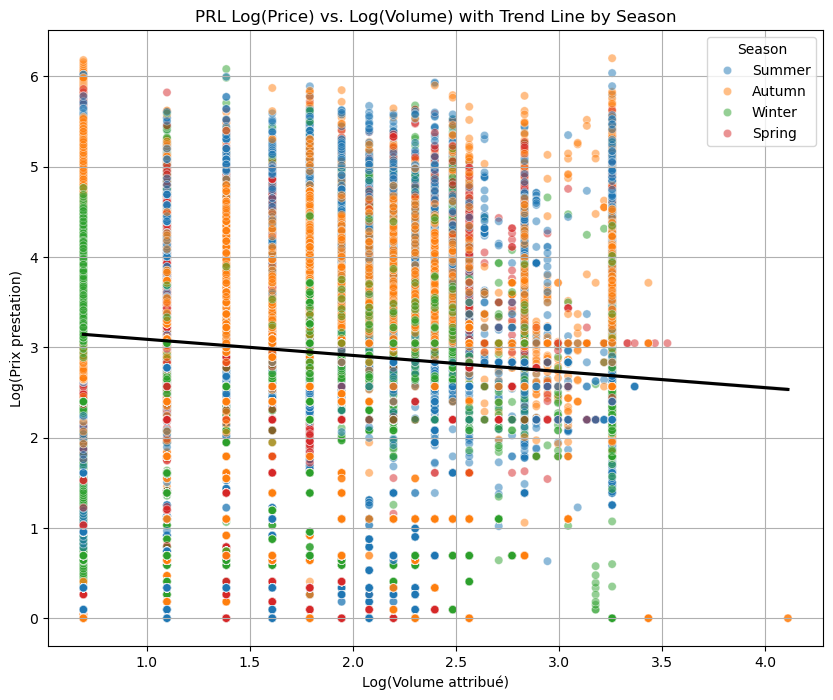

In [223]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=PRL_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=PRL_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('PRL Log(Price) vs. Log(Volume) with Trend Line by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.savefig('./gfx/OA/PRL_Log_price_vs_volume_trendline_by_season.pdf', format='pdf')
plt.show()

# # Density plot for regions with dense data
# plt.figure(figsize=(10, 8))
# sns.kdeplot(
#     data=PRL_combined, 
#     x='log_Volume_attribué', 
#     y='log_Prix_prestation', 
#     cmap='Blues', 
#     fill=True
# )
# plt.title('Density Plot of Log(Price) vs. Log(Volume)')
# plt.xlabel('Log(Volume attribué)')
# plt.ylabel('Log(Prix prestation)')
# plt.grid(True)
# plt.show()

# # Hexbin plot
# plt.figure(figsize=(10, 8))
# plt.hexbin(
#     PRL_combined['log_Volume_attribué'], 
#     PRL_combined['log_Prix_prestation'], 
#     gridsize=50, 
#     cmap='Greens', 
#     mincnt=1
# )
# plt.colorbar(label='Frequency')
# plt.title('Hexbin Plot of Log(Price) vs. Log(Volume)')
# plt.xlabel('Log(Volume attribué)')
# plt.ylabel('Log(Prix prestation)')
# plt.grid(True)
# plt.show()


In [224]:
from statsmodels.tsa.stattools import adfuller

# Function to check stationarity
def check_stationarity(series, name):
    result = adfuller(series.dropna())
    print(f"ADF Test for {name}")
    print(f"ADF Statistic: {result[0]:.4f}")
    print(f"p-value: {result[1]:.4f}")
    print(f"Critical Values: {result[4]}")
    if result[1] <= 0.05:
        print(f"{name} is stationary.\n")
    else:
        print(f"{name} is not stationary. Consider differencing or transformations.\n")

# Check stationarity for price and volume
check_stationarity(PRL_combined['log_Prix_prestation'], 'Log(Price prestation)')
check_stationarity(PRL_combined['log_Volume_attribué'], 'Log(Volume attribué)')


ADF Test for Log(Price prestation)
ADF Statistic: -18.2946
p-value: 0.0000
Critical Values: {'1%': -3.4303692141097364, '5%': -2.8615484924015644, '10%': -2.566774520196666}
Log(Price prestation) is stationary.

ADF Test for Log(Volume attribué)
ADF Statistic: -30.4303
p-value: 0.0000
Critical Values: {'1%': -3.4303692141097364, '5%': -2.8615484924015644, '10%': -2.566774520196666}
Log(Volume attribué) is stationary.



<Figure size 1000x600 with 0 Axes>

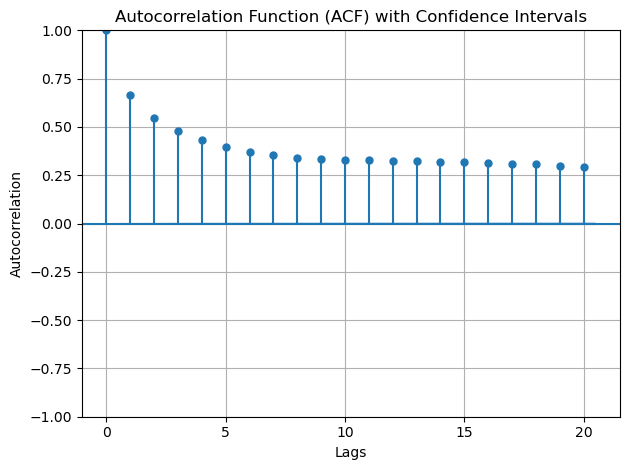

<Figure size 1000x600 with 0 Axes>

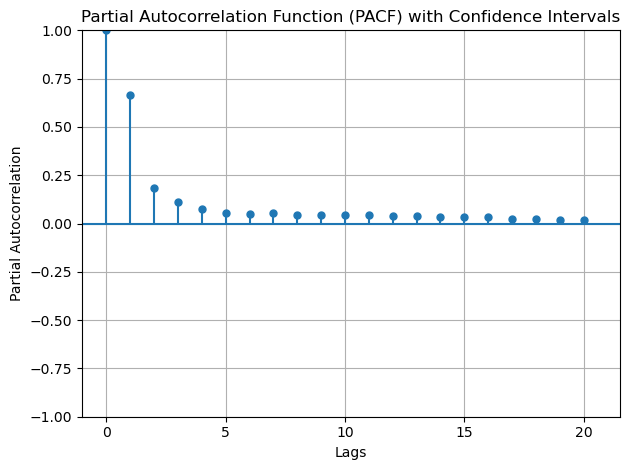

In [253]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt

sample=PRL_combined['log_Prix_prestation'].sample(300000)

# Plot ACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_acf(PRL_combined['log_Prix_prestation'], lags=20, alpha=0.05)
plt.title('Autocorrelation Function (ACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot PACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_pacf(PRL_combined['log_Prix_prestation'], lags=20, alpha=0.05, method='ywm')
plt.title('Partial Autocorrelation Function (PACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Partial Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()


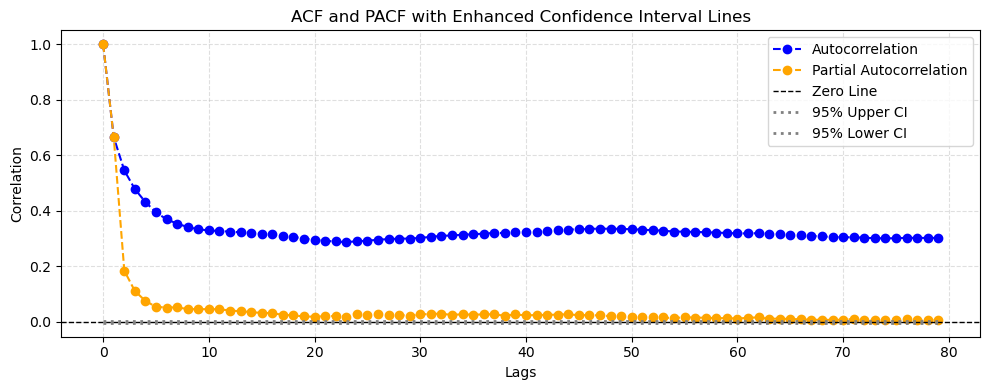

In [243]:
# Updated custom function with more prominent confidence interval lines
import numpy as np
from statsmodels.tsa.stattools import acf, pacf
from scipy import stats
import matplotlib.pyplot as plt

# Function to calculate partial autocorrelation
def calc_partial_autocorr(timeseries, N, cint=0.05):
    partial_autocorr = pacf(timeseries, nlags=N-1, method='ywm')
    variance = 1.0 / len(timeseries)  # Default variance formula
    uncertainty = stats.norm.ppf(1.0 - cint / 2.0) * np.sqrt(variance)
    chigh = np.ones(N) * uncertainty
    clow = -np.ones(N) * uncertainty
    return partial_autocorr, chigh, clow

# Function to calculate autocorrelation
def calc_autocorr(timeseries, N, cint=0.05):
    autocorr = acf(timeseries, nlags=N-1)
    variance = 1.0 / len(timeseries)  # Default variance formula
    uncertainty = stats.norm.ppf(1.0 - cint / 2.0) * np.sqrt(variance)
    chigh = np.ones(N) * uncertainty
    clow = -np.ones(N) * uncertainty
    return autocorr, chigh, clow

# Parameters
N = 80  # Number of lags
timeseries = PRL_combined['log_Prix_prestation'].dropna()  # Ensure no NaN values

# Compute autocorrelation and partial autocorrelation
autocorr, acf_chigh, acf_clow = calc_autocorr(timeseries, N=N)
partial_autocorr, pacf_chigh, pacf_clow = calc_partial_autocorr(timeseries, N=N)

# Plot ACF and PACF on the same figure with enhanced interval visibility
fig, ax = plt.subplots(figsize=(10, 4))
ax.plot(autocorr, '--o', label='Autocorrelation', color='blue')
ax.plot(partial_autocorr, '--o', label='Partial Autocorrelation', color='orange')
ax.axhline(0, color='black', linewidth=1, linestyle='--', label='Zero Line')  # Zero line
ax.plot(acf_chigh, color='grey', linewidth=2, linestyle='dotted', label='95% Upper CI')  # Upper bound
ax.plot(acf_clow, color='grey', linewidth=2, linestyle='dotted', label='95% Lower CI')  # Lower bound
ax.set_title('ACF and PACF with Enhanced Confidence Interval Lines')
ax.set_xlabel('Lags')
ax.set_ylabel('Correlation')
ax.legend()
plt.tight_layout()
plt.grid(alpha=0.4, linestyle='--')
plt.show()


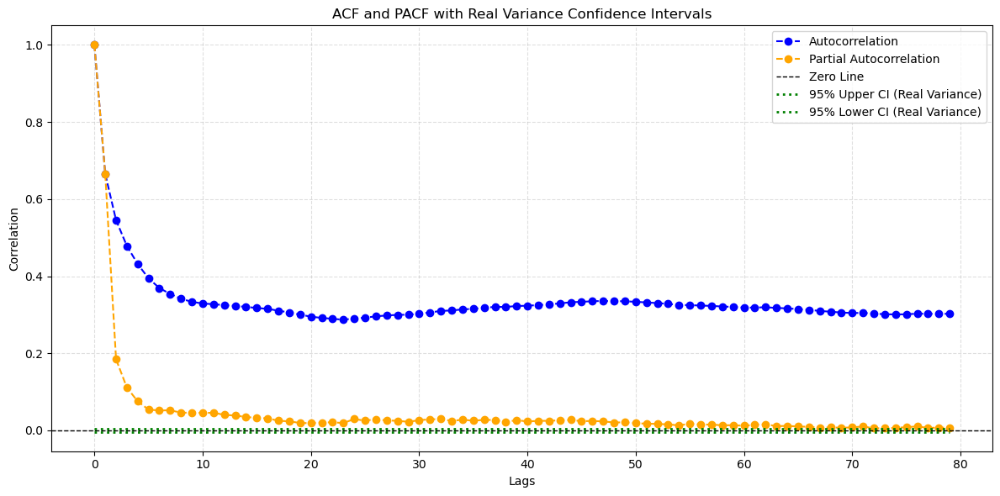

In [244]:
import numpy as np
from statsmodels.tsa.stattools import acf, pacf
from scipy import stats
import matplotlib.pyplot as plt

# Function to calculate autocorrelation with real variance
def calc_autocorr_with_real_variance(timeseries, N, cint=0.05):
    autocorr = acf(timeseries, nlags=N-1)
    real_variance = np.var(timeseries)  # Calculate the real variance of the series
    uncertainty = stats.norm.ppf(1.0 - cint / 2.0) * np.sqrt(real_variance / len(timeseries))
    chigh = np.ones(N) * uncertainty
    clow = -np.ones(N) * uncertainty
    return autocorr, chigh, clow

# Function to calculate partial autocorrelation with real variance
def calc_partial_autocorr_with_real_variance(timeseries, N, cint=0.05):
    partial_autocorr = pacf(timeseries, nlags=N-1, method='ywm')
    real_variance = np.var(timeseries)  # Calculate the real variance of the series
    uncertainty = stats.norm.ppf(1.0 - cint / 2.0) * np.sqrt(real_variance / len(timeseries))
    chigh = np.ones(N) * uncertainty
    clow = -np.ones(N) * uncertainty
    return partial_autocorr, chigh, clow

# Parameters
N = 80  # Number of lags
timeseries = PRL_combined['log_Prix_prestation'].dropna()  # Ensure no NaN values

# Compute autocorrelation and partial autocorrelation with real variance
autocorr_real, acf_chigh_real, acf_clow_real = calc_autocorr_with_real_variance(timeseries, N=N)
partial_autocorr_real, pacf_chigh_real, pacf_clow_real = calc_partial_autocorr_with_real_variance(timeseries, N=N)

# Plot ACF and PACF with real variance confidence intervals
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(autocorr_real, '--o', label='Autocorrelation', color='blue')
ax.plot(partial_autocorr_real, '--o', label='Partial Autocorrelation', color='orange')
ax.axhline(0, color='black', linewidth=1, linestyle='--', label='Zero Line')  # Zero line
ax.plot(acf_chigh_real, color='green', linewidth=2, linestyle='dotted', label='95% Upper CI (Real Variance)')  # Upper bound
ax.plot(acf_clow_real, color='green', linewidth=2, linestyle='dotted', label='95% Lower CI (Real Variance)')  # Lower bound
ax.set_title('ACF and PACF with Real Variance Confidence Intervals')
ax.set_xlabel('Lags')
ax.set_ylabel('Correlation')
ax.legend()
plt.tight_layout()
plt.grid(alpha=0.4, linestyle='--')
plt.show()


In [247]:
PRL_combined['lag1_log_Prix_prestation'] = PRL_combined['log_Prix_prestation'].shift(1)

formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter + lag1_log_Prix_prestation"
model = smf.ols(formula=formula, data=PRL_combined).fit()

print(model.summary())

                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.446
Model:                             OLS   Adj. R-squared:                  0.446
Method:                  Least Squares   F-statistic:                 5.476e+04
Date:                 Sun, 29 Dec 2024   Prob (F-statistic):               0.00
Time:                         18:26:51   Log-Likelihood:            -4.2059e+05
No. Observations:               340433   AIC:                         8.412e+05
Df Residuals:                   340427   BIC:                         8.413e+05
Df Model:                            5                                         
Covariance Type:             nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
Intercept     

## SRL-

In [305]:
SRL19m['Year'] = 2019
SRL20m['Year'] = 2020
SRL21m['Year'] = 2021
SRL22m['Year'] = 2022
SRL23m['Year'] = 2023
SRL24m['Year'] = 2024

SRLm_datasets=[SRL19m, SRL20m, SRL21m, SRL22m, SRL23m, SRL24m]
for dataset in SRLm_datasets:
    print(dataset['Prix_prestation'].describe())


count     804.000000
mean     1832.937935
std      1339.000257
min       386.400000
25%       756.000000
50%      1495.200000
75%      2350.500000
max      6400.000000
Name: Prix_prestation, dtype: float64
count     906.000000
mean     1363.621909
std       908.256335
min       274.000000
25%       695.130000
50%      1081.000000
75%      1627.190000
max      4417.000000
Name: Prix_prestation, dtype: float64
count     1102.000000
mean      2597.839628
std       2235.807286
min        430.000000
25%        965.000000
50%       1867.000000
75%       3488.000000
max      17700.000000
Name: Prix_prestation, dtype: float64
count     1104.000000
mean     10029.511866
std       8792.911540
min       2178.960000
25%       3685.675000
50%       5362.600000
75%      14950.500000
max      41776.000000
Name: Prix_prestation, dtype: float64
count     1392.000000
mean     14625.814167
std      15045.993184
min       1588.000000
25%       2505.720000
50%       9142.000000
75%      20423.750000
max   

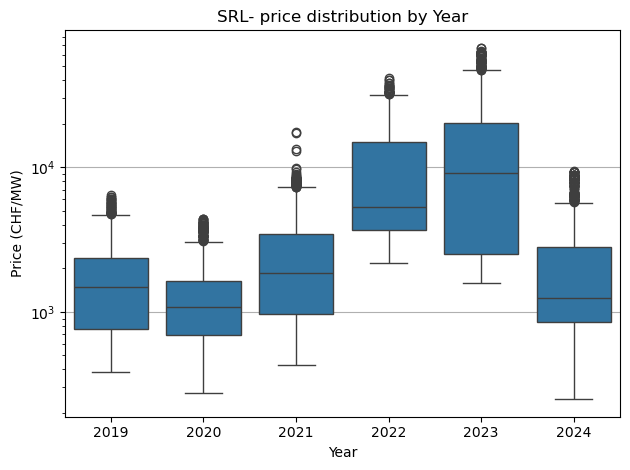

In [307]:
# Combine all datasets into a single DataFrame
SRLm_combined = pd.concat([SRL19m, SRL20m, SRL21m, SRL22m, SRL23m, SRL24m])

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=SRLm_combined)
plt.title('SRL- price distribution by Year')
plt.xlabel('Year')
plt.ylabel('Price (CHF/MW)')
plt.yscale('log')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig('./gfx/OA/SRL-_price_distribution_by_year.pdf', format='pdf')
plt.show()

In [308]:
SRLm_combined

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,Week,Year
151726,SRL_19_KW01,Secondary control Auction SRL-,8,MW,8,MW,3175.20,CHF/MW,25401.6,CHF,18.90,CHF/MWh*,CH,18.90,CHF/MWh*,NaN,SRL_19_KW01,2019
151727,SRL_19_KW01,Secondary control Auction SRL-,5,MW,5,MW,4284.00,CHF/MW,21420.0,CHF,25.50,CHF/MWh*,CH,25.50,CHF/MWh*,NaN,SRL_19_KW01,2019
151728,SRL_19_KW01,Secondary control Auction SRL-,20,MW,20,MW,3334.80,CHF/MW,66696.0,CHF,19.85,CHF/MWh*,CH,19.85,CHF/MWh*,NaN,SRL_19_KW01,2019
151729,SRL_19_KW01,Secondary control Auction SRL-,30,MW,30,MW,4620.00,CHF/MW,138600.0,CHF,27.50,CHF/MWh*,CH,27.50,CHF/MWh*,NaN,SRL_19_KW01,2019
151730,SRL_19_KW01,Secondary control Auction SRL-,30,MW,30,MW,3720.00,CHF/MW,111600.0,CHF,22.14,CHF/MWh*,CH,22.14,CHF/MWh*,NaN,SRL_19_KW01,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624206,SRL_25_KW01,Secondary control Auction SRL-,40,MW,40,MW,2012.60,CHF/MW,80504.0,CHF,11.98,CHF/MWh*,CH,11.98,CHF/MWh*,NaN,SRL_25_KW01,2024
624207,SRL_25_KW01,Secondary control Auction SRL-,5,MW,5,MW,1781.00,CHF/MW,8905.0,CHF,10.60,CHF/MWh*,CH,10.60,CHF/MWh*,NaN,SRL_25_KW01,2024
624208,SRL_25_KW01,Secondary control Auction SRL-,61,MW,61,MW,2335.20,CHF/MW,142447.2,CHF,13.90,CHF/MWh*,CH,13.90,CHF/MWh*,NaN,SRL_25_KW01,2024
624209,SRL_25_KW01,Secondary control Auction SRL-,15,MW,15,MW,1678.32,CHF/MW,25174.8,CHF,9.99,CHF/MWh*,CH,9.99,CHF/MWh*,NaN,SRL_25_KW01,2024


In [309]:
SRLm_combined['week_of_the_year']=SRLm_combined['Week'].str.extract(r'(\d{2})$').astype(int)
SRLm_combined

,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,Week,Year,week_of_the_year
151726,SRL_19_KW01,Secondary control Auction SRL-,8,MW,8,MW,3175.20,CHF/MW,25401.6,CHF,18.90,CHF/MWh*,CH,18.90,CHF/MWh*,NaN,SRL_19_KW01,2019,1
151727,SRL_19_KW01,Secondary control Auction SRL-,5,MW,5,MW,4284.00,CHF/MW,21420.0,CHF,25.50,CHF/MWh*,CH,25.50,CHF/MWh*,NaN,SRL_19_KW01,2019,1
151728,SRL_19_KW01,Secondary control Auction SRL-,20,MW,20,MW,3334.80,CHF/MW,66696.0,CHF,19.85,CHF/MWh*,CH,19.85,CHF/MWh*,NaN,SRL_19_KW01,2019,1
151729,SRL_19_KW01,Secondary control Auction SRL-,30,MW,30,MW,4620.00,CHF/MW,138600.0,CHF,27.50,CHF/MWh*,CH,27.50,CHF/MWh*,NaN,SRL_19_KW01,2019,1
151730,SRL_19_KW01,Secondary control Auction SRL-,30,MW,30,MW,3720.00,CHF/MW,111600.0,CHF,22.14,CHF/MWh*,CH,22.14,CHF/MWh*,NaN,SRL_19_KW01,2019,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624206,SRL_25_KW01,Secondary control Auction SRL-,40,MW,40,MW,2012.60,CHF/MW,80504.0,CHF,11.98,CHF/MWh*,CH,11.98,CHF/MWh*,NaN,SRL_25_KW01,2024,1
624207,SRL_25_KW01,Secondary control Auction SRL-,5,MW,5,MW,1781.00,CHF/MW,8905.0,CHF,10.60,CHF/MWh*,CH,10.60,CHF/MWh*,NaN,SRL_25_KW01,2024,1
624208,SRL_25_KW01,Secondary control Auction SRL-,61,MW,61,MW,2335.20,CHF/MW,142447.2,CHF,13.90,CHF/MWh*,CH,13.90,CHF/MWh*,NaN,SRL_25_KW01,2024,1
624209,SRL_25_KW01,Secondary control Auction SRL-,15,MW,15,MW,1678.32,CHF/MW,25174.8,CHF,9.99,CHF/MWh*,CH,9.99,CHF/MWh*,NaN,SRL_25_KW01,2024,1


In [310]:
def determine_season(week_number):
    """
    Determines the season based on the week number of the year.
    Seasons are defined as:
    - Winter: Week 1–8, 49–52
    - Spring: Week 9–21
    - Summer: Week 22–35
    - Autumn: Week 36–48

    Args:
        week_number (int): Week number of the year (1–52).

    Returns:
        str: The season ('Winter', 'Spring', 'Summer', 'Autumn').
    """
    if 1 <= week_number <= 8 or 49 <= week_number <= 53:
        return "Winter"
    elif 9 <= week_number <= 21:
        return "Spring"
    elif 22 <= week_number <= 35:
        return "Summer"
    elif 36 <= week_number <= 48:
        return "Autumn"
    else:
        print(f"Invalid week number: {week_number}")
        raise ValueError("Week number must be between 1 and 52.")

# Example usage with a DataFrame column
SRLm_combined['season'] = SRLm_combined['week_of_the_year'].apply(determine_season)
SRLm_combined.sample(30)


,Appel_offres,Description,Volume_offert,Unité1,Volume_attribué,Unité2,Prix_prestation,Unité3,Coûts,Unité4,Prix,Unité5,Pays,Prix_offert,Unité6,Divisibilité,Week,Year,week_of_the_year,season
152036,SRL_19_KW13_S1,Secondary control Auction SRL-,5,MW,5,MW,2750.00,CHF/MW,13750.0,CHF,16.47,CHF/MWh*,CH,16.47,CHF/MWh*,NaN,SRL_19_KW13,2019,13,Spring
817776,SRL_20_KW10_S1,Secondary control Auction SRL-,20,MW,20,MW,2282.00,CHF/MW,45640.0,CHF,13.58,CHF/MWh*,CH,13.58,CHF/MWh*,NaN,SRL_20_KW10,2020,10,Spring
527003,SRL_23_KW27,Secondary control Auction SRL-,5,MW,5,MW,2333.52,CHF/MW,11667.6,CHF,13.89,CHF/MWh*,CH,13.89,CHF/MWh*,NaN,SRL_23_KW27,2023,27,Summer
527552,SRL_23_KW44,Secondary control Auction SRL-,5,MW,5,MW,4500.00,CHF/MW,22500.0,CHF,26.79,CHF/MWh*,CH,26.79,CHF/MWh*,NaN,SRL_23_KW44,2023,44,Autumn
152148,SRL_19_KW16_S1,Secondary control Auction SRL-,10,MW,10,MW,3423.00,CHF/MW,34230.0,CHF,20.38,CHF/MWh*,CH,20.38,CHF/MWh*,NaN,SRL_19_KW16,2019,16,Spring
526887,SRL_23_KW24,Secondary control Auction SRL-,5,MW,5,MW,3135.00,CHF/MW,15675.0,CHF,18.66,CHF/MWh*,CH,18.66,CHF/MWh*,NaN,SRL_23_KW24,2023,24,Summer
520462,SRL_22_KW29,Secondary control Auction SRL-,20,MW,20,MW,3145.00,CHF/MW,62900.0,CHF,18.72,CHF/MWh*,CH,18.72,CHF/MWh*,NaN,SRL_22_KW29,2022,29,Summer
526774,SRL_23_KW22_S1,Secondary control Auction SRL-,10,MW,10,MW,14104.00,CHF/MW,141040.0,CHF,83.95,CHF/MWh*,CH,83.95,CHF/MWh*,NaN,SRL_23_KW22,2023,22,Summer
758163,SRL_21_KW28,Secondary control Auction SRL-,20,MW,20,MW,450.00,CHF/MW,9000.0,CHF,2.68,CHF/MWh*,CH,2.68,CHF/MWh*,NaN,SRL_21_KW28,2021,28,Summer
624078,SRL_24_KW48,Secondary control Auction SRL-,100,MW,100,MW,1164.24,CHF/MW,116424.0,CHF,6.93,CHF/MWh*,CH,6.93,CHF/MWh*,NaN,SRL_24_KW48,2024,48,Autumn


In [311]:
# Encode Season as categorical
SRLm_combined = pd.get_dummies(SRLm_combined, columns=['season'])

# Apply log transformation to Prix_prestation and Volume_attribué
SRLm_combined['log_Prix_prestation'] = np.log1p(SRLm_combined['Prix_prestation'])  # log1p handles zero values
SRLm_combined['log_Volume_attribué'] = np.log1p(SRLm_combined['Volume_attribué'])


# Run regression
formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=SRLm_combined).fit()

# Print results 
print(model.summary())


                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.227
Model:                             OLS   Adj. R-squared:                  0.227
Method:                  Least Squares   F-statistic:                     459.5
Date:                 Mon, 30 Dec 2024   Prob (F-statistic):               0.00
Time:                         10:05:15   Log-Likelihood:                -9274.9
No. Observations:                 6260   AIC:                         1.856e+04
Df Residuals:                     6255   BIC:                         1.859e+04
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept           

In [301]:
SRLm_combined.columns

Index(['Appel_offres', 'Description', 'Volume_offert', 'Unité1',
       'Volume_attribué', 'Unité2', 'Prix_prestation', 'Unité3', 'Coûts',
       'Unité4', 'Prix', 'Unité5', 'Pays', 'Prix_offert', 'Unité6',
       'Divisibilité', 'Week', 'Year', 'week_of_the_year', 'season_Autumn',
       'season_Spring', 'season_Summer', 'season_Winter',
       'log_Prix_prestation', 'log_Volume_attribué'],
      dtype='object')

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\3895757159.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='season', y='log_Prix_prestation', data=SRLm_combined, palette='Set2')


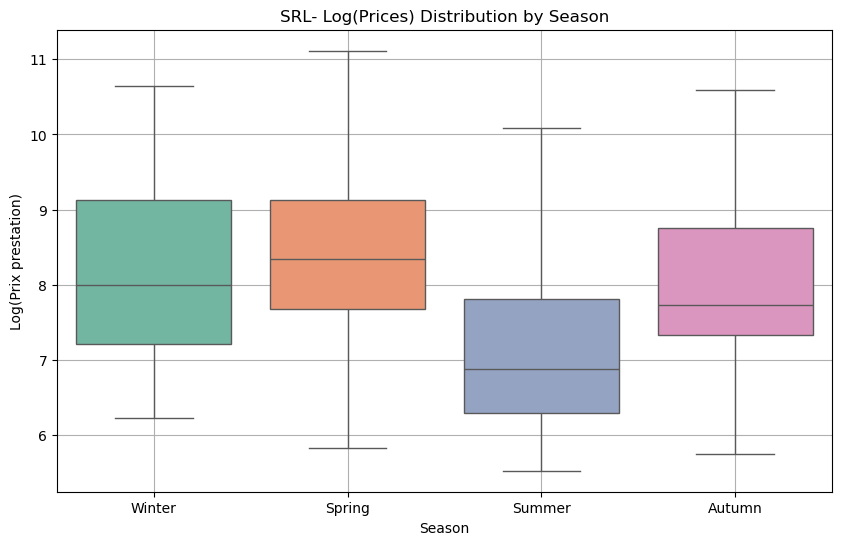

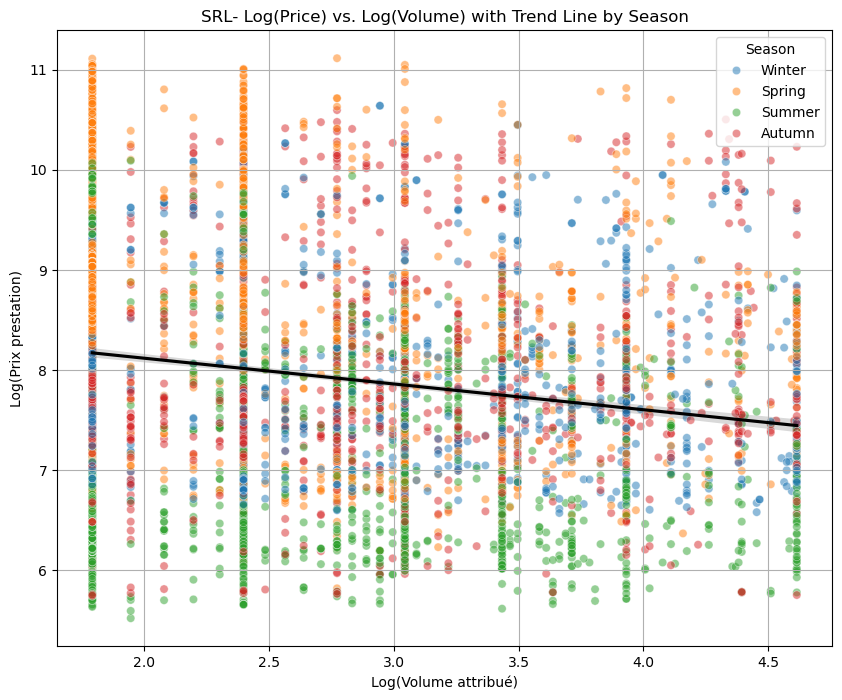

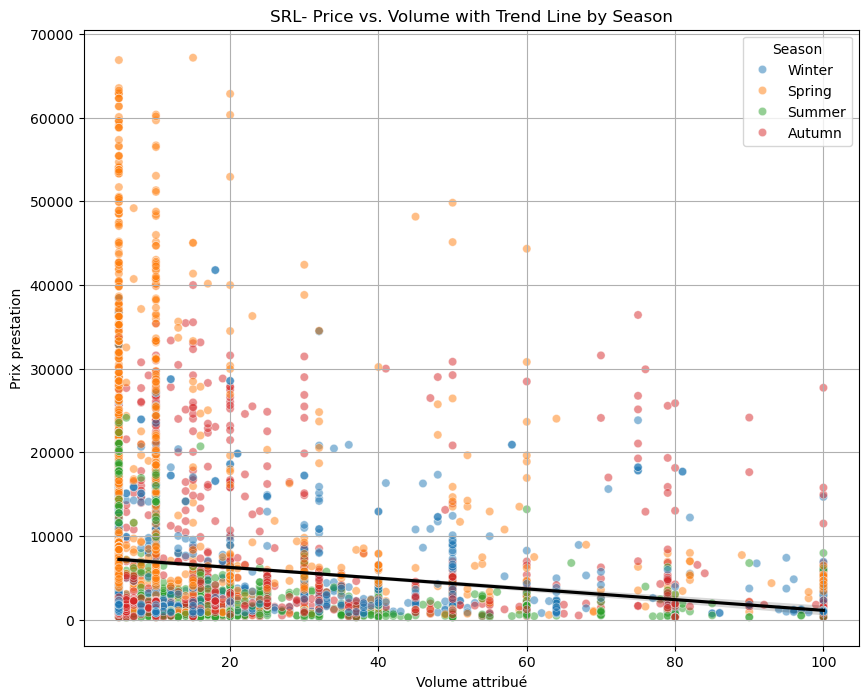

In [312]:
SRLm_combined['season'] = SRLm_combined['week_of_the_year'].apply(determine_season)

plt.figure(figsize=(10, 6))
sns.boxplot(x='season', y='log_Prix_prestation', data=SRLm_combined, palette='Set2')
plt.title('SRL- Log(Prices) Distribution by Season')
plt.xlabel('Season')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.savefig('./gfx/OA/SRL-_Log_prices_distribution_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=SRLm_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=SRLm_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('SRL- Log(Price) vs. Log(Volume) with Trend Line by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.savefig('./gfx/OA/SRL-_Log_price_vs_volume_trendline_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=SRLm_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=SRLm_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('SRL- Price vs. Volume with Trend Line by Season')
plt.xlabel('Volume attribué')
plt.ylabel('Prix prestation')
plt.legend(title='Season')
plt.grid(True)
plt.show()


In [304]:
print(SRLm_combined.groupby('season')['Prix_prestation'].describe())

         count          mean           std     min     25%      50%       75%  \
season                                                                          
Autumn  1414.0   6160.984689   8085.282262  312.48  1528.8  2266.00  6341.250   
Spring  1890.0  10187.530392  13855.844385  336.00  2155.0  4188.24  9254.475   
Summer  1669.0   1960.804290   2745.990139  249.00   537.6   968.00  2473.000   
Winter  1287.0   6168.618345   7144.217600  504.00  1350.5  2956.80  9218.500   

            max  
season           
Autumn  39988.1  
Spring  67144.0  
Summer  24136.0  
Winter  41776.0  


ADF Test for Log(Price prestation)
ADF Statistic: -2.1005
p-value: 0.2443
Critical Values: {'1%': -3.431399911088992, '5%': -2.8620039673466513, '10%': -2.567016966909078}
Log(Price prestation) is not stationary. Consider differencing or transformations.

ADF Test for Log(Volume attribué)
ADF Statistic: -6.5255
p-value: 0.0000
Critical Values: {'1%': -3.4314007546036405, '5%': -2.862004340039245, '10%': -2.5670171653023615}
Log(Volume attribué) is stationary.



<Figure size 1000x600 with 0 Axes>

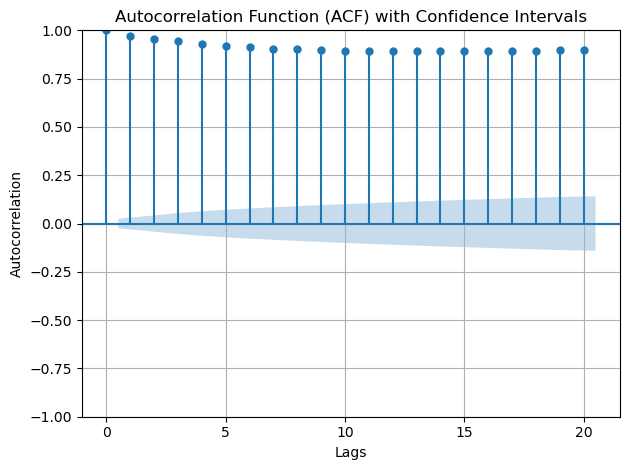

<Figure size 1000x600 with 0 Axes>

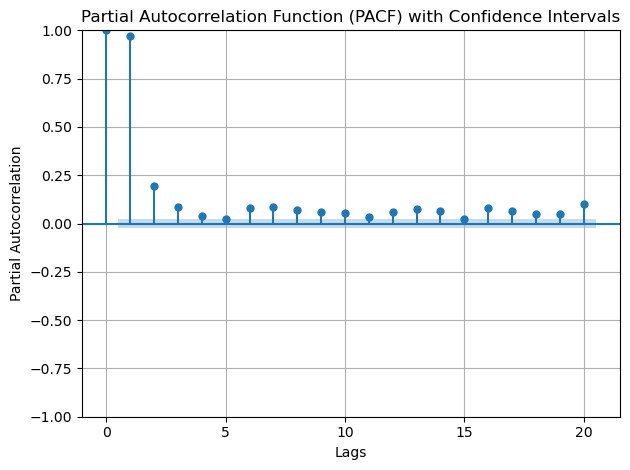

In [282]:
check_stationarity(SRLm_combined['log_Prix_prestation'], 'Log(Price prestation)')
check_stationarity(SRLm_combined['log_Volume_attribué'], 'Log(Volume attribué)')


# Plot ACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_acf(SRLm_combined['log_Prix_prestation'], lags=20, alpha=0.05)
plt.title('Autocorrelation Function (ACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot PACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_pacf(SRLm_combined['log_Prix_prestation'], lags=20, alpha=0.05, method='ywm')
plt.title('Partial Autocorrelation Function (PACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Partial Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()

In [283]:
# Apply differencing to make Log(Price prestation) stationary
SRLm_combined['diff_log_Prix_prestation'] = SRLm_combined['log_Prix_prestation'].diff()

check_stationarity(SRLm_combined['diff_log_Prix_prestation'], 'SRLm_combined[diff_log_Prix_prestation]')


ADF Test for SRLm_combined[diff_log_Prix_prestation]
ADF Statistic: -19.1863
p-value: 0.0000
Critical Values: {'1%': -3.4314007546036405, '5%': -2.862004340039245, '10%': -2.5670171653023615}
SRLm_combined[diff_log_Prix_prestation] is stationary.



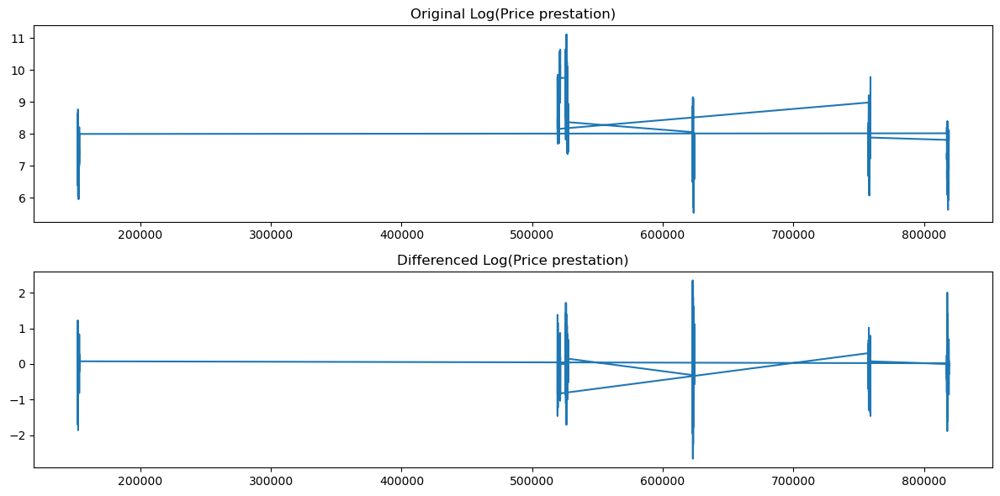

In [284]:
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Plot original and differenced series
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
SRLm_combined['log_Prix_prestation'].plot(title='Original Log(Price prestation)')
plt.subplot(2, 1, 2)
SRLm_combined['diff_log_Prix_prestation'].dropna().plot(title='Differenced Log(Price prestation)')
plt.tight_layout()
plt.show()



<Figure size 1000x600 with 0 Axes>

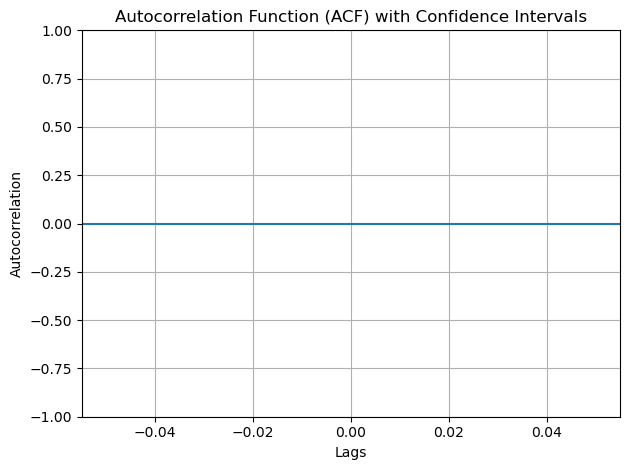

<Figure size 1000x600 with 0 Axes>

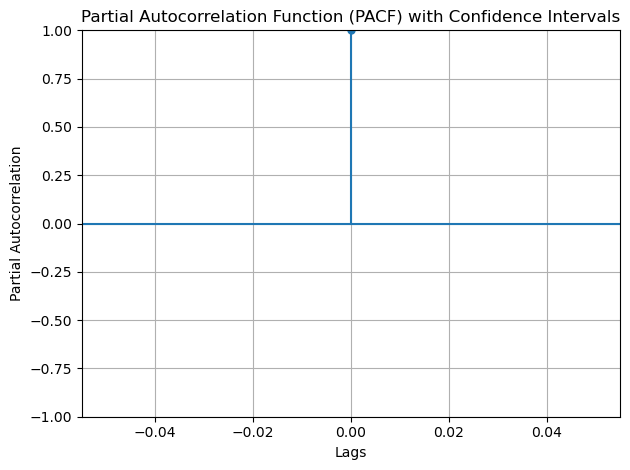

In [285]:
# Plot ACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_acf(SRLm_combined['diff_log_Prix_prestation'], lags=20, alpha=0.05)
plt.title('Autocorrelation Function (ACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot PACF with confidence intervals
plt.figure(figsize=(10, 6))
plot_pacf(SRLm_combined['diff_log_Prix_prestation'], lags=20, alpha=0.05, method='ywm')
plt.title('Partial Autocorrelation Function (PACF) with Confidence Intervals')
plt.xlabel('Lags')
plt.ylabel('Partial Autocorrelation')
plt.grid(True)
plt.tight_layout()
plt.show()

## SRL+

In [317]:
SRL19p['Year'] = 2019
SRL20p['Year'] = 2020
SRL21p['Year'] = 2021
SRL22p['Year'] = 2022
SRL23p['Year'] = 2023
SRL24p['Year'] = 2024

SRLp_datasets=[SRL19p, SRL20p, SRL21p, SRL22p, SRL23p, SRL24p]

for dataset in SRLp_datasets:
    print(dataset['Prix_prestation'].describe())

SRLp_combined=pd.concat(SRLp_datasets)


count     657.000000
mean      942.397778
std       460.455442
min       302.400000
25%       597.000000
50%       719.000000
75%      1310.400000
max      2872.800000
Name: Prix_prestation, dtype: float64
count     678.000000
mean      666.251062
std       315.650506
min       159.000000
25%       452.400000
50%       587.500000
75%       755.160000
max      1718.000000
Name: Prix_prestation, dtype: float64
count     846.000000
mean     1665.954102
std      1291.644064
min       436.800000
25%       889.250000
50%      1164.000000
75%      2000.000000
max      8971.000000
Name: Prix_prestation, dtype: float64
count     1003.000000
mean      5062.002293
std       3753.375834
min        594.000000
25%       2009.000000
50%       3582.000000
75%       7820.000000
max      20064.800000
Name: Prix_prestation, dtype: float64
count     1044.000000
mean      7981.936466
std       6972.076611
min        768.000000
25%       1543.500000
50%       6720.000000
75%      13058.750000
max      35448

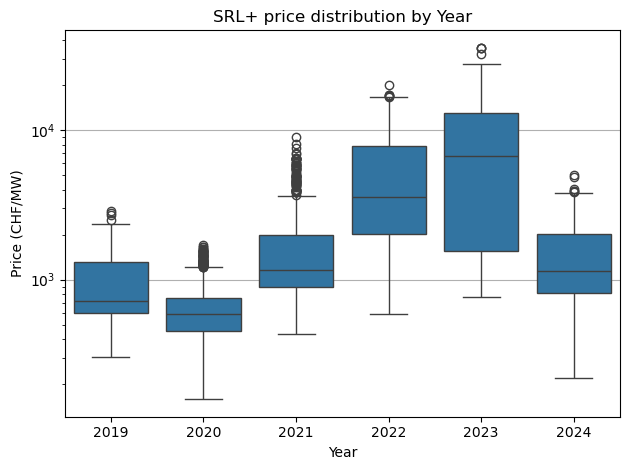

In [318]:

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=SRLp_combined)
plt.title('SRL+ price distribution by Year')
plt.xlabel('Year')
plt.ylabel('Price (CHF/MW)')
plt.yscale('log')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig('./gfx/OA/SRL+_price_distribution_by_year.pdf', format='pdf')
plt.show()

                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.076
Model:                             OLS   Adj. R-squared:                  0.076
Method:                  Least Squares   F-statistic:                     101.8
Date:                 Mon, 30 Dec 2024   Prob (F-statistic):           2.28e-83
Time:                         10:36:08   Log-Likelihood:                -7085.8
No. Observations:                 4929   AIC:                         1.418e+04
Df Residuals:                     4924   BIC:                         1.421e+04
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept           

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1109949552.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='season', y='log_Prix_prestation', data=SRLp_combined, palette='Set2')


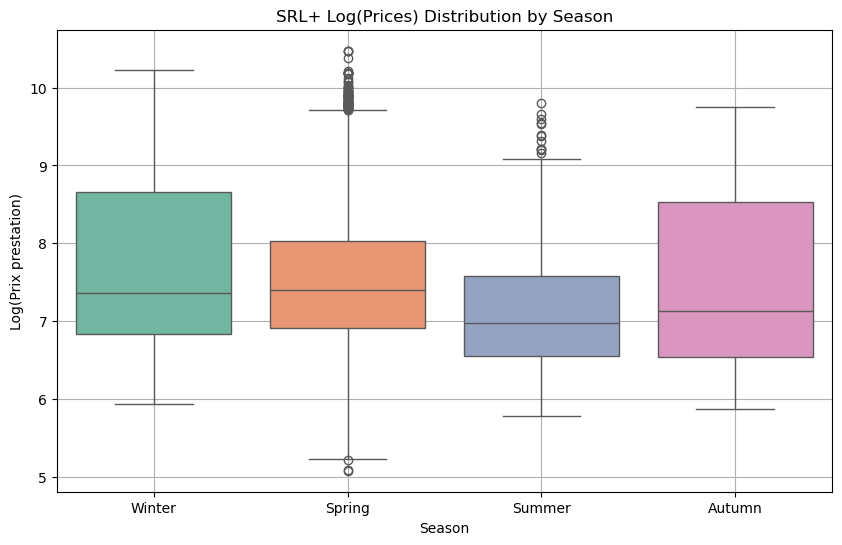

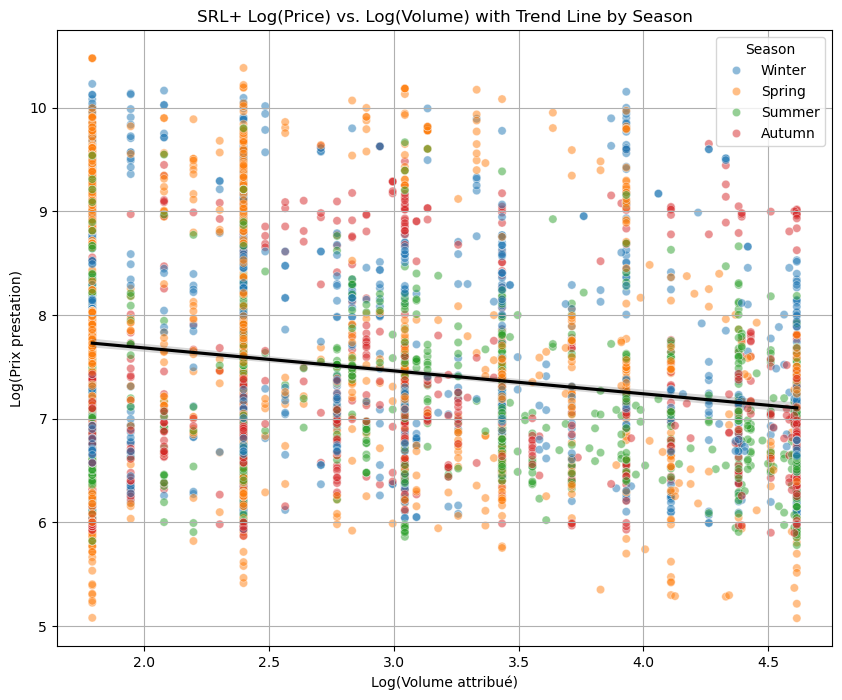

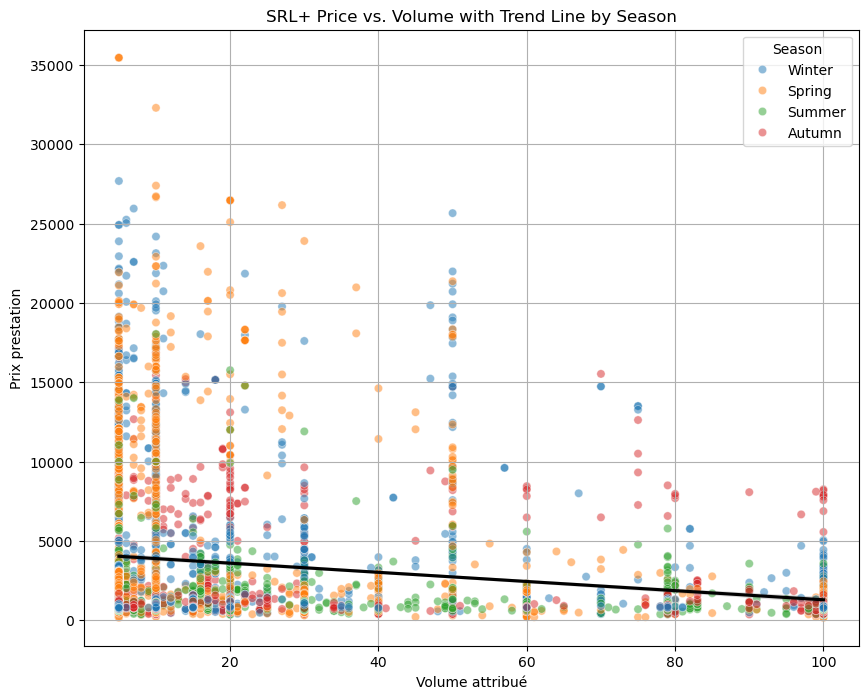

In [319]:
SRLp_combined['week_of_the_year']=SRLp_combined['Week'].str.extract(r'(\d{2})$').astype(int)
SRLp_combined

SRLp_combined['season'] = SRLp_combined['week_of_the_year'].apply(determine_season)

# Encode Season as categorical
SRLp_combined = pd.get_dummies(SRLp_combined, columns=['season'])

# Apply log transformation to Prix_prestation and Volume_attribué
SRLp_combined['log_Prix_prestation'] = np.log1p(SRLp_combined['Prix_prestation'])  # log1p handles zero values
SRLp_combined['log_Volume_attribué'] = np.log1p(SRLp_combined['Volume_attribué'])


# Run regression
formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=SRLp_combined).fit()

# Print results 
print(model.summary())


SRLp_combined['season'] = SRLp_combined['week_of_the_year'].apply(determine_season)

plt.figure(figsize=(10, 6))
sns.boxplot(x='season', y='log_Prix_prestation', data=SRLp_combined, palette='Set2')
plt.title('SRL+ Log(Prices) Distribution by Season')
plt.xlabel('Season')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.savefig('./gfx/OA/SRL+_Log_prices_distribution_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=SRLp_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=SRLp_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('SRL+ Log(Price) vs. Log(Volume) with Trend Line by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.savefig('./gfx/OA/SRL+_Log_price_vs_volume_trendline_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=SRLp_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=SRLp_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('SRL+ Price vs. Volume with Trend Line by Season')
plt.xlabel('Volume attribué')
plt.ylabel('Prix prestation')
plt.legend(title='Season')
plt.grid(True)
plt.show()


In [321]:
print(SRLp_combined.groupby('season')['Prix_prestation'].describe())

         count         mean          std     min     25%      50%      75%  \
season                                                                       
Autumn  1158.0  3083.569093  3517.448400  352.80  693.00  1244.04  5057.25   
Spring  1535.0  3979.012130  5442.990018  159.00  996.28  1639.68  3070.50   
Summer  1008.0  1615.856230  1702.194731  323.00  698.00  1068.00  1964.34   
Winter  1228.0  4561.895651  5542.034076  376.32  923.00  1564.50  5759.00   

             max  
season            
Autumn  17150.56  
Spring  35448.00  
Summer  18041.00  
Winter  27679.20  


## TRL-

In [322]:
TPDW19['Year'] = 2019
TPDW20['Year'] = 2020
TPDW21['Year'] = 2021
TPDW22['Year'] = 2022
TPDW23['Year'] = 2023
TPDW24['Year'] = 2024

TPDW_datasets=[TPDW19, TPDW20, TPDW21, TPDW22, TPDW23, TPDW24]

for dataset in TPDW_datasets:
    print(dataset['Prix_prestation'].describe())
    
# Combine all datasets into a single DataFrame
TPDW_combined = pd.concat(TPDW_datasets)

count    611.000000
mean     156.065188
std      111.143699
min        0.710000
25%       78.000000
50%      133.000000
75%      178.500000
max      555.000000
Name: Prix_prestation, dtype: float64
count     778.000000
mean      316.955617
std       126.121103
min        78.960000
25%       226.242500
50%       344.000000
75%       397.000000
max      1015.100000
Name: Prix_prestation, dtype: float64
count    1095.000000
mean     1646.528639
std      1535.483173
min       168.000000
25%       537.600000
50%       980.000000
75%      2211.000000
max      9999.000000
Name: Prix_prestation, dtype: float64
count     1172.000000
mean      5139.414684
std       3488.361908
min        420.000000
25%       2221.250000
50%       4092.000000
75%       7096.500000
max      21465.000000
Name: Prix_prestation, dtype: float64
count     1279.000000
mean      4102.370203
std       4233.607892
min        800.000000
25%       1396.500000
50%       1945.000000
75%       5500.000000
max      21465.000000


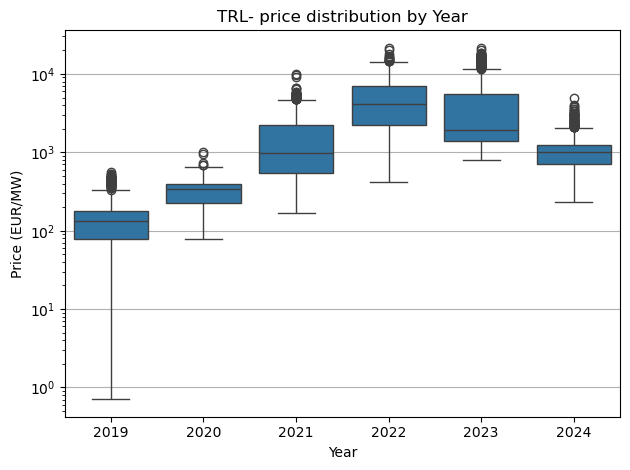

In [323]:

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=TPDW_combined)
plt.title('TRL- price distribution by Year')
plt.xlabel('Year')
plt.ylabel('Price (EUR/MW)')
plt.yscale('log')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig('./gfx/OA/TRL-_price_distribution_by_year.pdf', format='pdf')
plt.show()

                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.056
Model:                             OLS   Adj. R-squared:                  0.055
Method:                  Least Squares   F-statistic:                     91.78
Date:                 Mon, 30 Dec 2024   Prob (F-statistic):           6.24e-76
Time:                         10:50:28   Log-Likelihood:                -10272.
No. Observations:                 6201   AIC:                         2.055e+04
Df Residuals:                     6196   BIC:                         2.059e+04
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept           

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1574650598.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='season', y='log_Prix_prestation', data=TPDW_combined, palette='Set2')


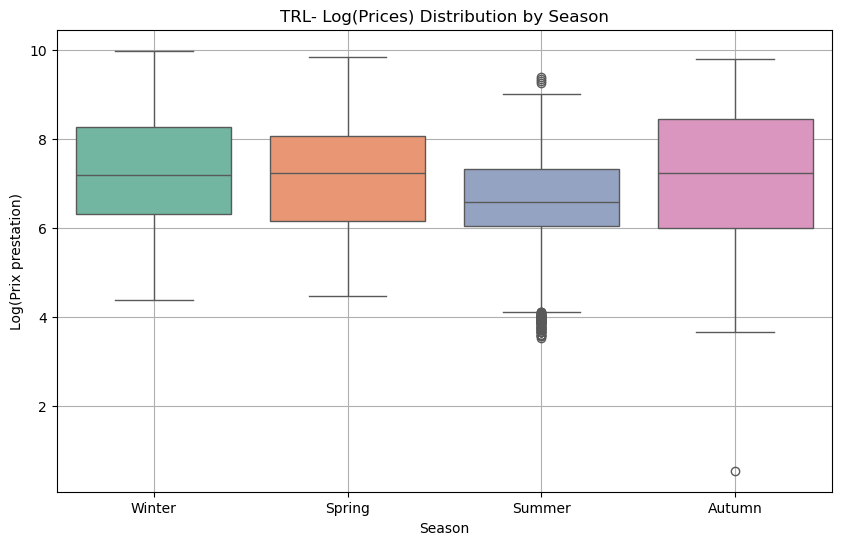

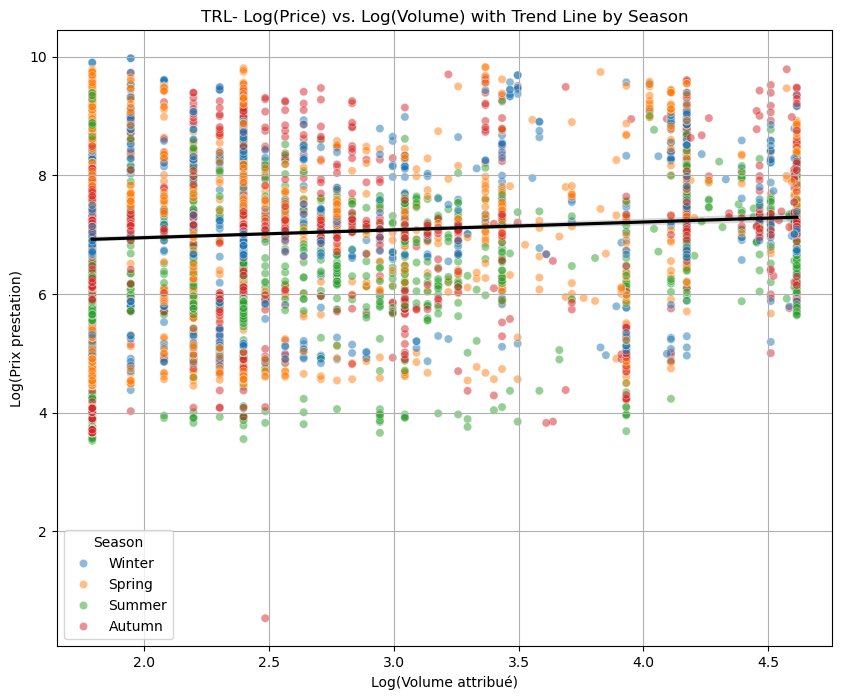

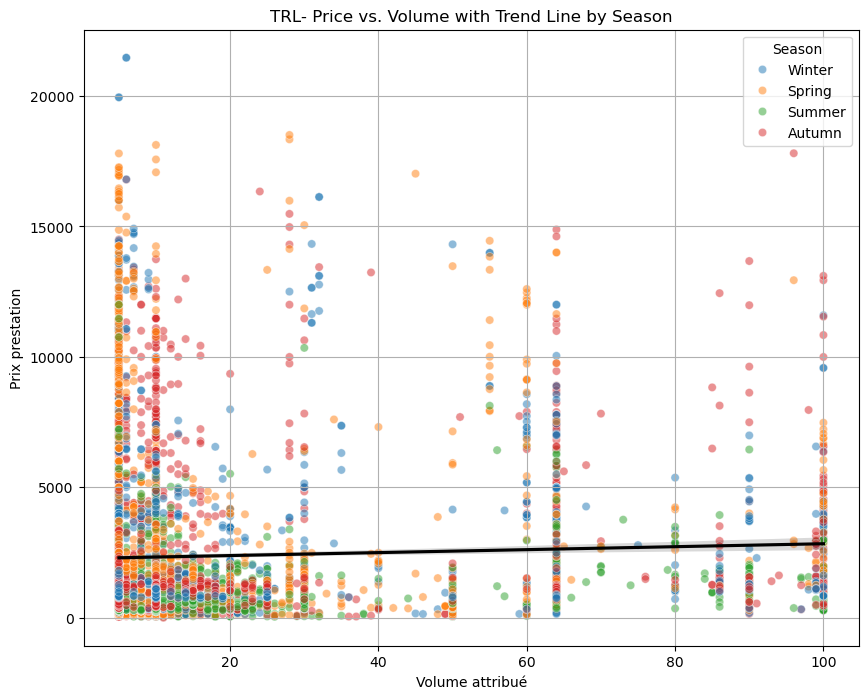

In [324]:
TPDW_combined['week_of_the_year']=TPDW_combined['Week'].str.extract(r'(\d{2})$').astype(int)

TPDW_combined['season'] = TPDW_combined['week_of_the_year'].apply(determine_season)

# Encode Season as categorical
TPDW_combined = pd.get_dummies(TPDW_combined, columns=['season'])

# Apply log transformation to Prix_prestation and Volume_attribué
TPDW_combined['log_Prix_prestation'] = np.log1p(TPDW_combined['Prix_prestation'])  # log1p handles zero values
TPDW_combined['log_Volume_attribué'] = np.log1p(TPDW_combined['Volume_attribué'])


# Run regression
formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=TPDW_combined).fit()

# Print results 
print(model.summary())


TPDW_combined['season'] = TPDW_combined['week_of_the_year'].apply(determine_season)

plt.figure(figsize=(10, 6))
sns.boxplot(x='season', y='log_Prix_prestation', data=TPDW_combined, palette='Set2')
plt.title('TRL- Log(Prices) Distribution by Season')
plt.xlabel('Season')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.savefig('./gfx/OA/TRL-_Log_prices_distribution_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=TPDW_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=TPDW_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('TRL- Log(Price) vs. Log(Volume) with Trend Line by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.savefig('./gfx/OA/TRL-_Log_price_vs_volume_trendline_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=TPDW_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=TPDW_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('TRL- Price vs. Volume with Trend Line by Season')
plt.xlabel('Volume attribué')
plt.ylabel('Prix prestation')
plt.legend(title='Season')
plt.grid(True)
plt.show()


In [326]:
print(TPDW_combined.groupby('season')['Prix_prestation'].describe())

         count         mean          std    min    25%      50%        75%  \
season                                                                       
Autumn  1435.0  3099.088585  3546.517241   0.71  400.0  1377.60  4624.5000   
Spring  1728.0  2796.235573  3620.635969  85.00  468.5  1362.08  3184.4675   
Summer  1775.0  1099.877375  1123.752931  33.00  415.0   708.96  1500.0000   
Winter  1263.0  2785.454553  3443.057570  78.96  548.0  1327.20  3831.5000   

            max  
season           
Autumn  17802.7  
Spring  18504.0  
Summer  12000.0  
Winter  21465.0  


## TRL +

In [327]:
TPUW19['Year'] = 2019
TPUW20['Year'] = 2020
TPUW21['Year'] = 2021
TPUW22['Year'] = 2022
TPUW23['Year'] = 2023
TPUW24['Year'] = 2024

TPUW_datasets=[TPUW19, TPUW20, TPUW21, TPUW22, TPUW23, TPUW24]

for dataset in TPUW_datasets:
    print(dataset['Prix_prestation'].describe())
    
# Combine all datasets into a single DataFrame
TPUW_combined = pd.concat(TPUW_datasets)


count    904.000000
mean     134.856361
std       47.641836
min        0.500000
25%      100.800000
50%      143.000000
75%      154.000000
max      309.120000
Name: Prix_prestation, dtype: float64
count    855.000000
mean     113.029602
std       90.709710
min       19.000000
25%       54.200000
50%       75.600000
75%      185.900000
max      730.000000
Name: Prix_prestation, dtype: float64
count    1192.000000
mean      947.819589
std       754.629869
min       123.000000
25%       499.000000
50%       680.000000
75%      1000.000000
max      4000.000000
Name: Prix_prestation, dtype: float64
count    1281.000000
mean     1370.558220
std       916.356818
min       349.000000
25%       698.000000
50%      1209.600000
75%      1646.000000
max      8825.000000
Name: Prix_prestation, dtype: float64
count     1469.000000
mean      1913.542253
std       3201.481737
min          3.440000
25%        383.040000
50%        417.000000
75%       1721.500000
max      20664.000000
Name: Prix_prest

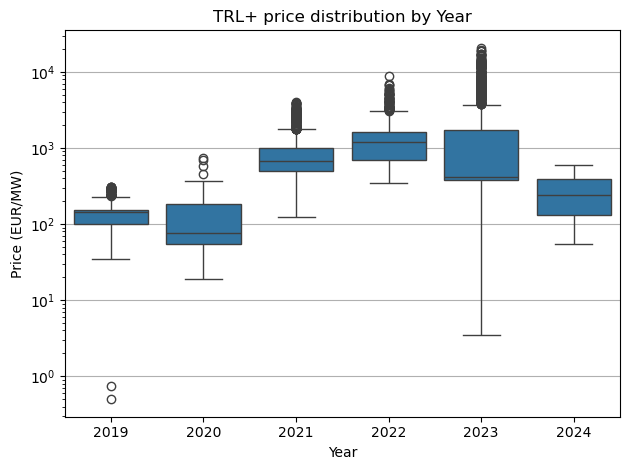

In [328]:

plt.figure() #figsize=(12, 6)
sns.boxplot(x='Year', y='Prix_prestation', data=TPUW_combined)
plt.title('TRL+ price distribution by Year')
plt.xlabel('Year')
plt.ylabel('Price (EUR/MW)')
plt.yscale('log')
plt.grid(axis='y')
plt.tight_layout()
plt.savefig('./gfx/OA/TRL+_price_distribution_by_year.pdf', format='pdf')
plt.show()

                             OLS Regression Results                            
Dep. Variable:     log_Prix_prestation   R-squared:                       0.057
Model:                             OLS   Adj. R-squared:                  0.057
Method:                  Least Squares   F-statistic:                     105.7
Date:                 Mon, 30 Dec 2024   Prob (F-statistic):           1.43e-87
Time:                         10:57:40   Log-Likelihood:                -10967.
No. Observations:                 6940   AIC:                         2.194e+04
Df Residuals:                     6935   BIC:                         2.198e+04
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept           

C:\Users\Yass La Menace\AppData\Local\Temp\ipykernel_21684\1551329601.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='season', y='log_Prix_prestation', data=TPUW_combined, palette='Set2')


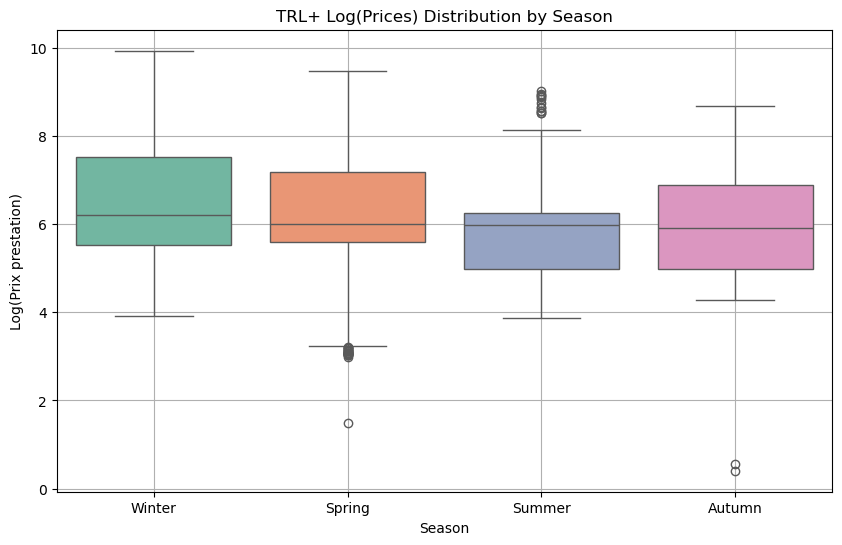

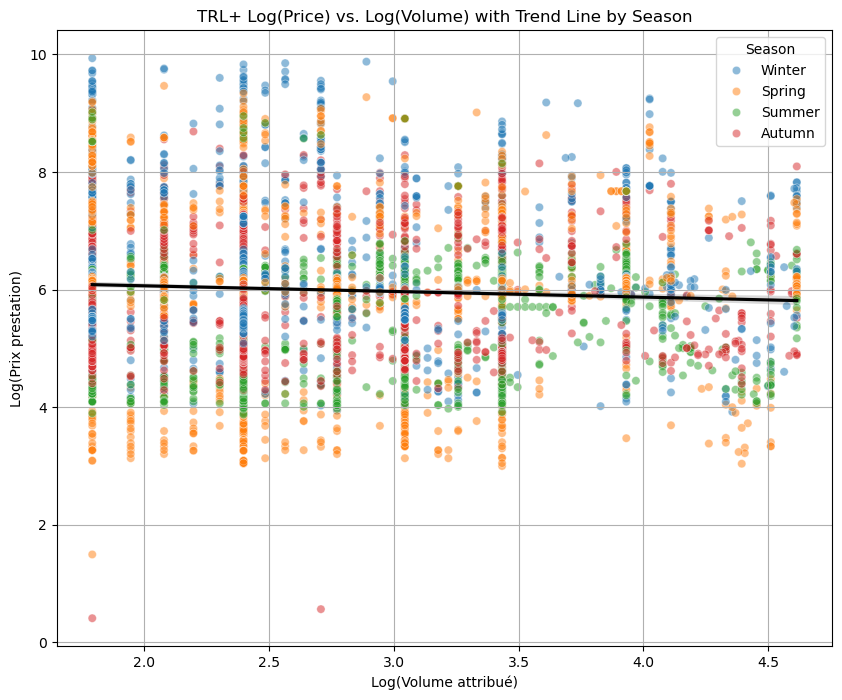

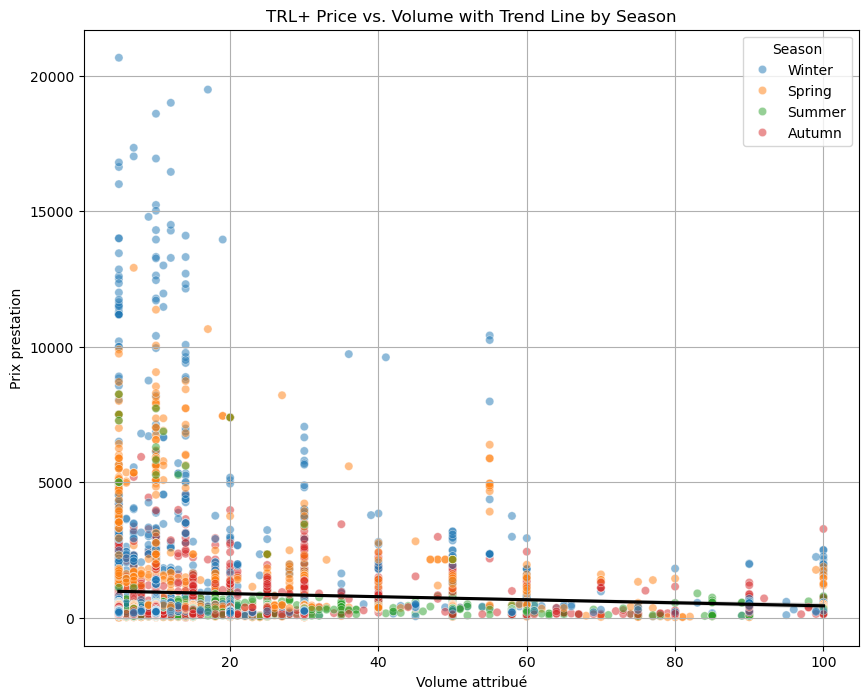

In [329]:
TPUW_combined['week_of_the_year']=TPUW_combined['Week'].str.extract(r'(\d{2})$').astype(int)

TPUW_combined['season'] = TPUW_combined['week_of_the_year'].apply(determine_season)

# Encode Season as categorical
TPUW_combined = pd.get_dummies(TPUW_combined, columns=['season'])

# Apply log transformation to Prix_prestation and Volume_attribué
TPUW_combined['log_Prix_prestation'] = np.log1p(TPUW_combined['Prix_prestation'])  # log1p handles zero values
TPUW_combined['log_Volume_attribué'] = np.log1p(TPUW_combined['Volume_attribué'])


# Run regression
formula = "log_Prix_prestation ~ log_Volume_attribué + season_Spring + season_Summer + season_Winter"
model = smf.ols(formula=formula, data=TPUW_combined).fit()

# Print results 
print(model.summary())


TPUW_combined['season'] = TPUW_combined['week_of_the_year'].apply(determine_season)

plt.figure(figsize=(10, 6))
sns.boxplot(x='season', y='log_Prix_prestation', data=TPUW_combined, palette='Set2')
plt.title('TRL+ Log(Prices) Distribution by Season')
plt.xlabel('Season')
plt.ylabel('Log(Prix prestation)')
plt.grid(True)
plt.savefig('./gfx/OA/TRL+_Log_prices_distribution_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=TPUW_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=TPUW_combined, 
    x='log_Volume_attribué', 
    y='log_Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('TRL+ Log(Price) vs. Log(Volume) with Trend Line by Season')
plt.xlabel('Log(Volume attribué)')
plt.ylabel('Log(Prix prestation)')
plt.legend(title='Season')
plt.grid(True)
plt.savefig('./gfx/OA/TRL+_Log_price_vs_volume_trendline_by_season.pdf', format='pdf')
plt.show()


# Scatterplot with trend lines for log-transformed data
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=TPUW_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    hue='season', 
    alpha=0.5, 
    palette='tab10'
)
sns.regplot(
    data=TPUW_combined, 
    x='Volume_attribué', 
    y='Prix_prestation', 
    scatter=False, 
    color='black', 
    line_kws={'label': 'Linear Fit'}
)
plt.title('TRL+ Price vs. Volume with Trend Line by Season')
plt.xlabel('Volume attribué')
plt.ylabel('Prix prestation')
plt.legend(title='Season')
plt.grid(True)
plt.show()


In [330]:
print(TPUW_combined.groupby('season')['Prix_prestation'].describe())

         count         mean          std    min     25%     50%      75%  \
season                                                                     
Autumn  1846.0   650.235888   729.760355   0.50  145.00  370.00   979.25   
Spring  1657.0  1058.201756  1683.396630   3.44  269.00  403.00  1321.00   
Summer  1813.0   398.233889   570.130572  47.00  144.48  395.00   520.00   
Winter  1624.0  1580.534655  2781.624430  49.30  250.00  498.96  1831.20   

            max  
season           
Autumn   5936.0  
Spring  12913.0  
Summer   8248.0  
Winter  20664.0  
